<a href="https://colab.research.google.com/github/MarshaGomez/F5-MOEA-Variations/blob/main/examples/Brachistocrone_Reinforcement_Learning.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Drive Permissions

In [1]:
from google.colab import drive
drive.mount('/content/gdrive', force_remount=True)

Mounted at /content/gdrive


#Imports and Global Values

In [ ]:
!apt-get install ffmpeg freeglut3-dev xvfb  # For visualization
!pip install stable-baselines3[extra]

In [7]:
import sys
import math
import numpy as np 
import gym
import os
import stable_baselines3
from datetime import datetime, date

# Reinforcement Learning Algorithms
from gym import spaces

# Reinforcement Learning. Stable Baseline
from stable_baselines3.common.env_util import make_vec_env
from stable_baselines3.ddpg.policies import MlpPolicy
from stable_baselines3 import DDPG
from stable_baselines3.common.env_util import make_vec_env
from stable_baselines3.ddpg.policies import MlpPolicy
from stable_baselines3.common.noise import NormalActionNoise, OrnsteinUhlenbeckActionNoise
from stable_baselines3.common.callbacks import EvalCallback

# Math Algorithms
from scipy.optimize import newton
from scipy.integrate import quad

# Render Functions 
from matplotlib.animation import FuncAnimation
from IPython import display

date_string = date.today()
sys.path.append('..')
base_path = "/content/gdrive/My Drive/Brachistochrone_RL/"
models_path = os.path.join(base_path, "models/" + f'{date_string}')

best_model_path = os.path.join(models_path, "best")
log_path = os.path.join(models_path, "logs")

try:
  os.makedirs(best_model_path)
except OSError:
  for f in os.listdir(best_model_path):
    os.remove(os.path.join(best_model_path, f))

try:
  os.makedirs(log_path)
except OSError:
  for f in os.listdir(log_path):
    os.remove(os.path.join(log_path, f))

print("Done")

Done


# Common functions

# Genetic Algorithm

In [8]:
class Brachistochrone_Env(gym.Env):
    
    dt = 0.01 #HYP
    renderOnReset = True #set to false to speed up training
    
    def __init__(self):

        super(Brachistochrone_Env, self).__init__()
        self.states = np.array([0.0, 0.0, 0.0 ,-45.0]) #pos_x, pos_y, vel, #theta from +ve x axis
        self.target_pos = np.array([+8.0, -6.0])
        self.g = -10.0
        self.reward = 0.0
        self.time_steps = 0
        self.target_steps = 200
        self.action_seq = []
        
        #for rendering purpose
        self.x_ep = [0]
        self.y_ep = [0]
        self.video = [(0,0)]


        act_val_high = np.array([0.0])
        act_val_low = np.array([-90.0])
        self.action_space = spaces.Box(low = act_val_low, high = act_val_high, shape = (1,), dtype=np.float32)

        obs_val_high = np.array([100.0, 100.0, 1000.0, 0.0])
        obs_val_low = np.array([-100.0, -100.0, -1000.0,-90.0])
        self.observation_space = spaces.Box(low= obs_val_low, high = obs_val_high, shape=(4,), dtype=np.float32)

    def step(self, action):
        dt = Brachistochrone_Env.dt
        # action corresponds to theta
        final_theta = action
        original_theta = self.states[3]

        original_vel = self.states[2]
        initial_vel_x = original_vel*math.cos(math.radians(original_theta))
        initial_vel_y = original_vel*math.sin(math.radians(original_theta))

        acceleration = self.g*math.sin(math.radians(final_theta)) # always positive
        acceleration_x = acceleration*math.cos(math.radians(final_theta)) #always positive
        acceleration_y = acceleration*math.sin(math.radians(final_theta)) # always negative

        displacement_x = (initial_vel_x*dt) + (0.5*acceleration_x*(dt**2))
        displacement_y = (initial_vel_y*dt) + (0.5*acceleration_y*(dt**2))
        displacement = math.sqrt(displacement_x**2 + displacement_y**2)

        final_vel_x = initial_vel_x + acceleration_x*dt
        final_vel_y = initial_vel_y + acceleration_y*dt

        final_x = self.states[0] + displacement_x
        final_y = self.states[1] + displacement_y
        final_vel = math.sqrt(final_vel_x**2 + final_vel_y**2)

        self.states[0] = final_x
        self.states[1] = final_y
        self.states[2] = final_vel
        self.states[3] = final_theta
        
        #updating path
        self.x_ep.append(final_x)
        self.y_ep.append(final_y)
        self.video.append((final_x,final_y))

        """APPLY POLICY"""
        err_position = math.sqrt((self.states[0] - self.target_pos[0])**2 + (self.states[1] - self.target_pos[1])**2)
        self.reward = -0.1*err_position

        done=False	
        self.time_steps+=1
        if self.time_steps>=self.target_steps or err_position<=0.05:
            done = True
        if err_position<=0.05:
            self.reward  = 0.1*(self.target_steps  - self.time_steps)
        if self.states[0]>8.0 or self.states[0]<0.0 or self.states[1]>0.0 or self.states[1]<-6.0:
            self.reward = -2*(self.target_steps - self.time_steps)
            done = True

        info = {'g_component':acceleration}
        return self.states, self.reward, done, info

    def reset(self):
                #render and reset trace
        if (Brachistochrone_Env.renderOnReset== True):
            print("EP_REWARD:"+str(self.reward))
            self.render(mode="auto")
        self.x_ep.clear()
        self.y_ep.clear()
        self.render()
        self.time_steps = 0
        self.reward = 0.0
        self.states = np.array([0.0, 0.0, 0.0 ,-45.0])

        return self.states
    
    def animate(self,frame_num):
        """
        x,y = zip(*self.video)
        x = list(x)
        y = list(y)
        """
        x = (x[0] for x in self.video[0])
        y = (x[1] for x in self.video[0])
        line.set_data((x, y))
        return line
    
    def render(self,mode='human'):
        
        """call it at the end of an episode"""
        """
        fig, ax = plt.subplots()
        line, = ax.plot([])     # A tuple unpacking to unpack the only plot
        x_goal = self.target_pos[0]
        y_goal = self.target_pos[1]
        #setting plot boundary
        ax.set_xlim(0, x_goal +1)
        ax.set_ylim(y_goal -1,1)
        anim = FuncAnimation(fig, self.animate, frames=100, interval=20)

        video = anim.to_html5_video()
        html = display.HTML(video)
        display.display(html)
        plt.close()
        """
        if (len(self.x_ep)!=0):
            time_taken = self.time_steps/100
            x = np.array(self.x_ep)
            y = np.array(self.y_ep)
            plt.plot(x,y , label = 'Path by RL agent, time taken =  %fs' %time_taken)
            goal = self.target_pos
            plt.scatter(x[-1], y[-1], color = 'green', s = 100.0)
            plt.scatter(x[0], y[0], color = 'red', s = 100.0)
            plt.scatter(goal[0], goal[1], color = 'blue', s=100.0)
            plt.annotate('Start', (x[0], y[0]))
            plt.annotate('End', (x[-1], y[-1]))
            plt.annotate('Goal', goal)
            plt.legend()
            plt.xlabel('X-COORDINATE(m)')
            plt.ylabel('Y-COORDINATE(m)')
            plt.title('TRAJECTORY')
            plt.show()

print("Done Class Brachistochrone")

Done Class Brachistochrone


[ 8. -6.]
Using cpu device
EP_REWARD:0.0


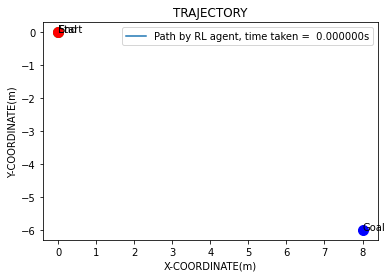

Logging to ./barchistostrone_ddpg_tensorboard/generalized_6\DDPG_2
EP_REWARD:-42


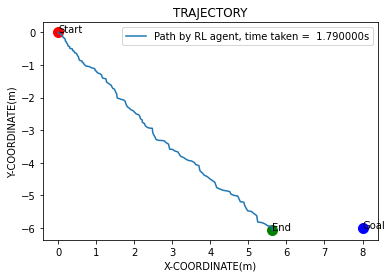

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 179      |
|    ep_rew_mean     | -174     |
| time/              |          |
|    episodes        | 1        |
|    fps             | 328      |
|    time_elapsed    | 0        |
|    total_timesteps | 179      |
---------------------------------
EP_REWARD:-30


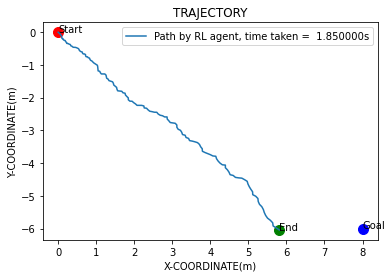

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 182      |
|    ep_rew_mean     | -168     |
| time/              |          |
|    episodes        | 2        |
|    fps             | 440      |
|    time_elapsed    | 0        |
|    total_timesteps | 364      |
---------------------------------
EP_REWARD:-34


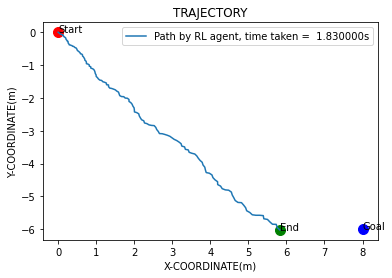

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 182      |
|    ep_rew_mean     | -168     |
| time/              |          |
|    episodes        | 3        |
|    fps             | 465      |
|    time_elapsed    | 1        |
|    total_timesteps | 547      |
---------------------------------
EP_REWARD:-20


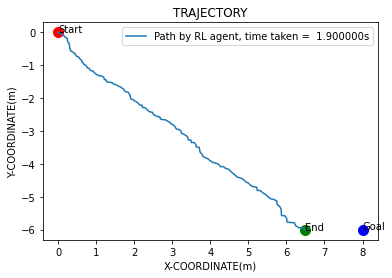

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 184      |
|    ep_rew_mean     | -165     |
| time/              |          |
|    episodes        | 4        |
|    fps             | 490      |
|    time_elapsed    | 1        |
|    total_timesteps | 737      |
---------------------------------
EP_REWARD:-44


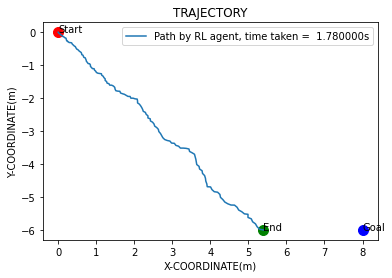

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 183      |
|    ep_rew_mean     | -167     |
| time/              |          |
|    episodes        | 5        |
|    fps             | 523      |
|    time_elapsed    | 1        |
|    total_timesteps | 915      |
---------------------------------
EP_REWARD:-8


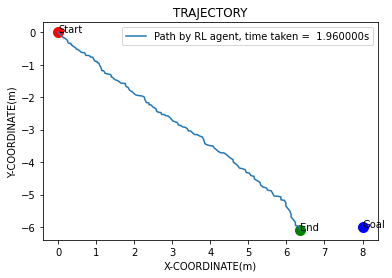

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 185      |
|    ep_rew_mean     | -163     |
| time/              |          |
|    episodes        | 6        |
|    fps             | 519      |
|    time_elapsed    | 2        |
|    total_timesteps | 1111     |
---------------------------------
EP_REWARD:-36


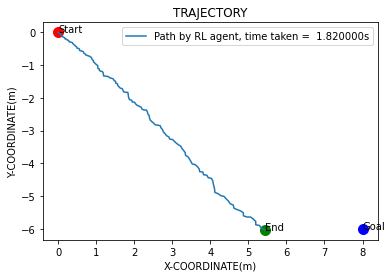

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 185      |
|    ep_rew_mean     | -164     |
| time/              |          |
|    episodes        | 7        |
|    fps             | 522      |
|    time_elapsed    | 2        |
|    total_timesteps | 1293     |
---------------------------------
EP_REWARD:-14


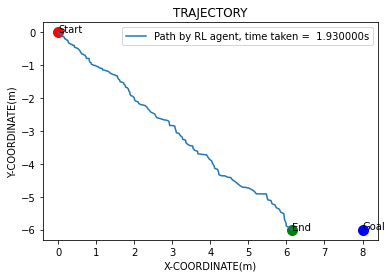

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 186      |
|    ep_rew_mean     | -163     |
| time/              |          |
|    episodes        | 8        |
|    fps             | 392      |
|    time_elapsed    | 3        |
|    total_timesteps | 1486     |
---------------------------------
EP_REWARD:-14


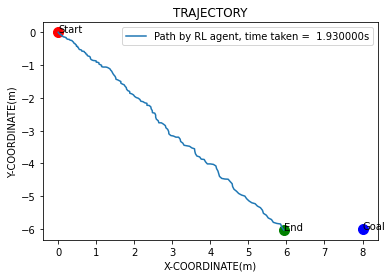

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 187      |
|    ep_rew_mean     | -162     |
| time/              |          |
|    episodes        | 9        |
|    fps             | 415      |
|    time_elapsed    | 4        |
|    total_timesteps | 1679     |
---------------------------------
EP_REWARD:-20


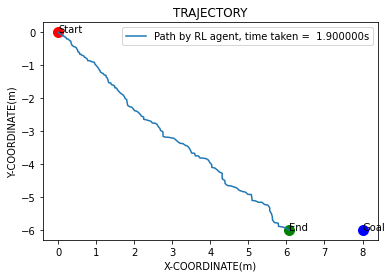

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 187      |
|    ep_rew_mean     | -161     |
| time/              |          |
|    episodes        | 10       |
|    fps             | 430      |
|    time_elapsed    | 4        |
|    total_timesteps | 1869     |
---------------------------------
EP_REWARD:-26


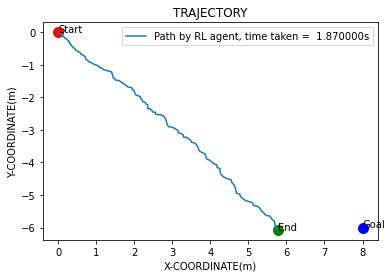

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 187      |
|    ep_rew_mean     | -161     |
| time/              |          |
|    episodes        | 11       |
|    fps             | 438      |
|    time_elapsed    | 4        |
|    total_timesteps | 2056     |
---------------------------------
EP_REWARD:-26


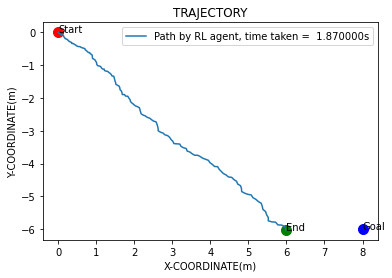

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 187      |
|    ep_rew_mean     | -161     |
| time/              |          |
|    episodes        | 12       |
|    fps             | 443      |
|    time_elapsed    | 5        |
|    total_timesteps | 2243     |
---------------------------------
EP_REWARD:-0.17060606460037417


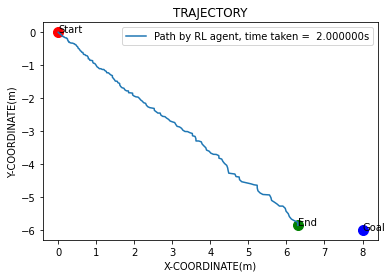

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 188      |
|    ep_rew_mean     | -160     |
| time/              |          |
|    episodes        | 13       |
|    fps             | 447      |
|    time_elapsed    | 5        |
|    total_timesteps | 2443     |
---------------------------------
EP_REWARD:-8


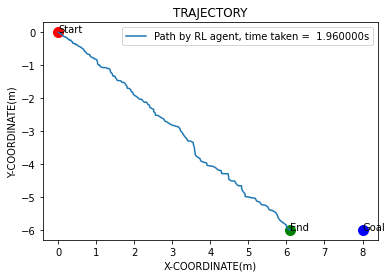

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 188      |
|    ep_rew_mean     | -159     |
| time/              |          |
|    episodes        | 14       |
|    fps             | 447      |
|    time_elapsed    | 5        |
|    total_timesteps | 2639     |
---------------------------------
EP_REWARD:-0.12467521685796586


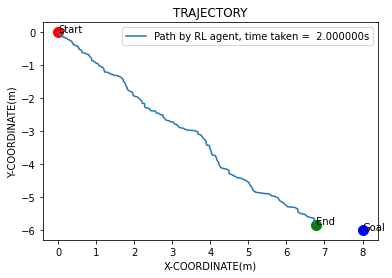

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 15       |
|    fps             | 457      |
|    time_elapsed    | 6        |
|    total_timesteps | 2839     |
---------------------------------
EP_REWARD:-2


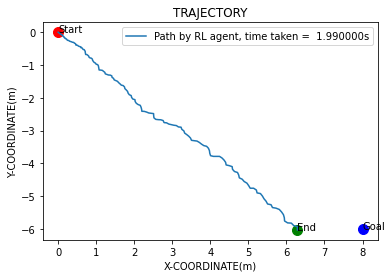

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 16       |
|    fps             | 466      |
|    time_elapsed    | 6        |
|    total_timesteps | 3038     |
---------------------------------
EP_REWARD:-10


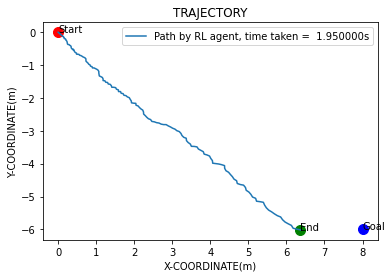

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 17       |
|    fps             | 470      |
|    time_elapsed    | 6        |
|    total_timesteps | 3233     |
---------------------------------
EP_REWARD:-48


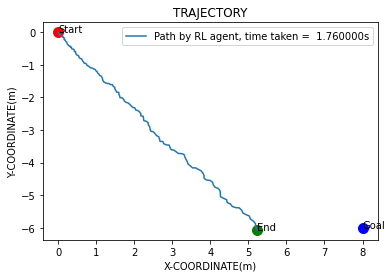

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 18       |
|    fps             | 468      |
|    time_elapsed    | 7        |
|    total_timesteps | 3409     |
---------------------------------
EP_REWARD:-10


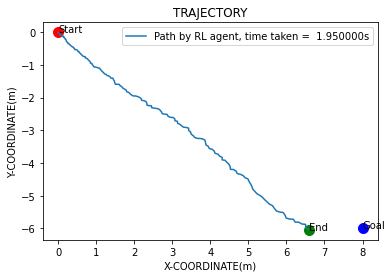

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 19       |
|    fps             | 472      |
|    time_elapsed    | 7        |
|    total_timesteps | 3604     |
---------------------------------
EP_REWARD:-26


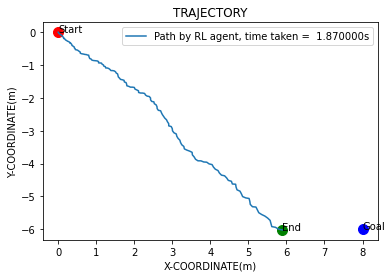

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 20       |
|    fps             | 474      |
|    time_elapsed    | 7        |
|    total_timesteps | 3791     |
---------------------------------
EP_REWARD:-6


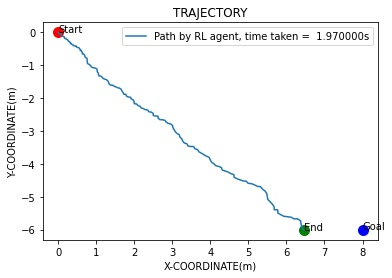

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 21       |
|    fps             | 478      |
|    time_elapsed    | 8        |
|    total_timesteps | 3988     |
---------------------------------
EP_REWARD:-0.1395127347006772


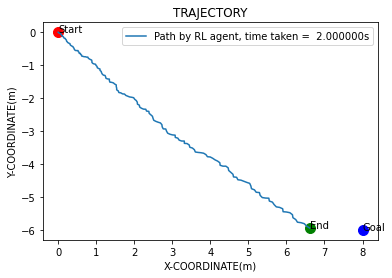

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -156     |
| time/              |          |
|    episodes        | 22       |
|    fps             | 482      |
|    time_elapsed    | 8        |
|    total_timesteps | 4188     |
---------------------------------
EP_REWARD:-0.153284499538771


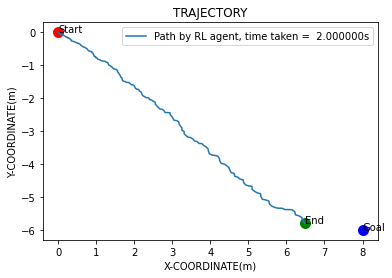

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 191      |
|    ep_rew_mean     | -155     |
| time/              |          |
|    episodes        | 23       |
|    fps             | 486      |
|    time_elapsed    | 9        |
|    total_timesteps | 4388     |
---------------------------------
EP_REWARD:-40


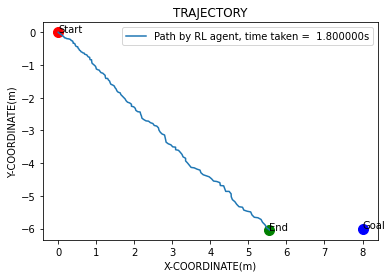

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -156     |
| time/              |          |
|    episodes        | 24       |
|    fps             | 492      |
|    time_elapsed    | 9        |
|    total_timesteps | 4568     |
---------------------------------
EP_REWARD:-24


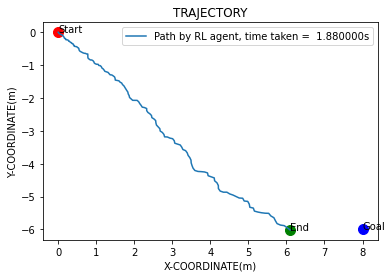

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -156     |
| time/              |          |
|    episodes        | 25       |
|    fps             | 500      |
|    time_elapsed    | 9        |
|    total_timesteps | 4756     |
---------------------------------
EP_REWARD:-2


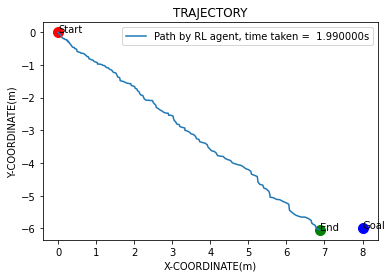

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 191      |
|    ep_rew_mean     | -156     |
| time/              |          |
|    episodes        | 26       |
|    fps             | 507      |
|    time_elapsed    | 9        |
|    total_timesteps | 4955     |
---------------------------------
EP_REWARD:-0.9480903370883592


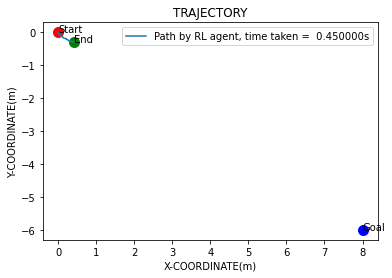

EP_REWARD:-148


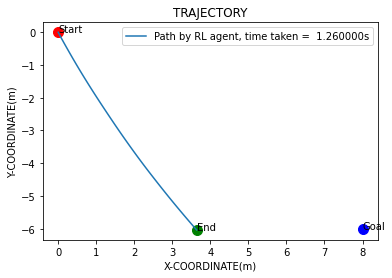

EP_REWARD:-148


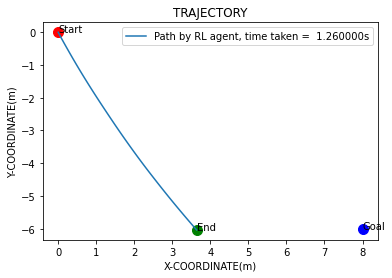

EP_REWARD:-148


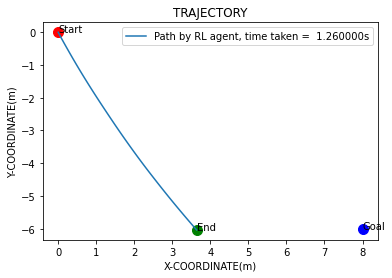

EP_REWARD:-148


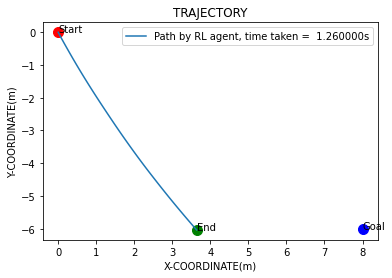

EP_REWARD:-148


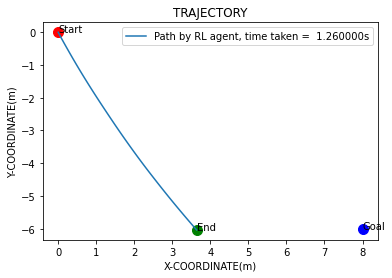

Eval num_timesteps=5000, episode_reward=-247.99 +/- 0.00
Episode length: 126.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 126      |
|    mean_reward     | -248     |
| time/              |          |
|    total_timesteps | 5000     |
---------------------------------
New best mean reward!
EP_REWARD:-50


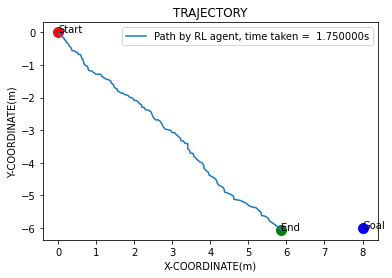

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -156     |
| time/              |          |
|    episodes        | 27       |
|    fps             | 441      |
|    time_elapsed    | 11       |
|    total_timesteps | 5175     |
---------------------------------
EP_REWARD:-4


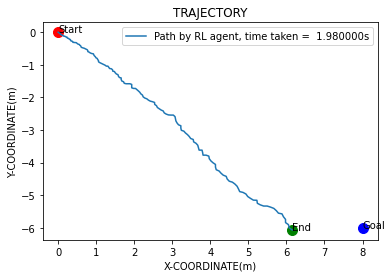

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -156     |
| time/              |          |
|    episodes        | 28       |
|    fps             | 441      |
|    time_elapsed    | 12       |
|    total_timesteps | 5373     |
---------------------------------
EP_REWARD:-38


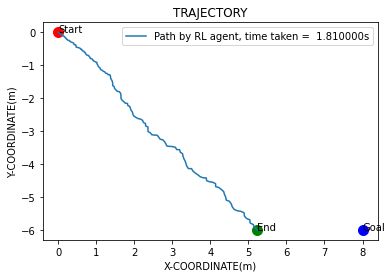

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 29       |
|    fps             | 436      |
|    time_elapsed    | 12       |
|    total_timesteps | 5554     |
---------------------------------
EP_REWARD:-22


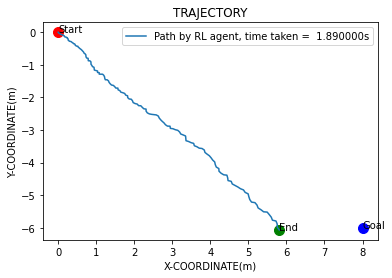

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 30       |
|    fps             | 437      |
|    time_elapsed    | 13       |
|    total_timesteps | 5743     |
---------------------------------
EP_REWARD:-0.17941451868249397


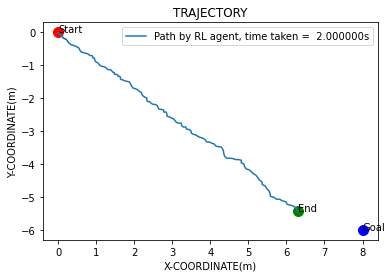

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -156     |
| time/              |          |
|    episodes        | 31       |
|    fps             | 442      |
|    time_elapsed    | 13       |
|    total_timesteps | 5943     |
---------------------------------
EP_REWARD:-38


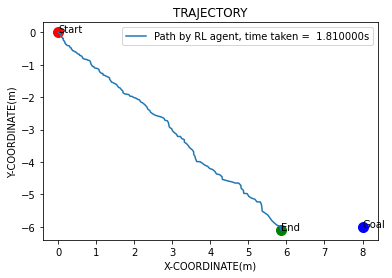

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 32       |
|    fps             | 447      |
|    time_elapsed    | 13       |
|    total_timesteps | 6124     |
---------------------------------
EP_REWARD:-4


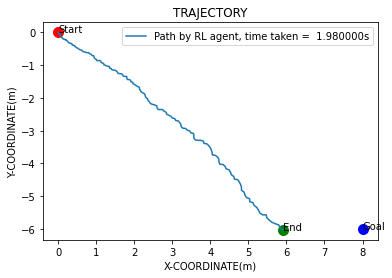

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -156     |
| time/              |          |
|    episodes        | 33       |
|    fps             | 454      |
|    time_elapsed    | 13       |
|    total_timesteps | 6322     |
---------------------------------
EP_REWARD:-42


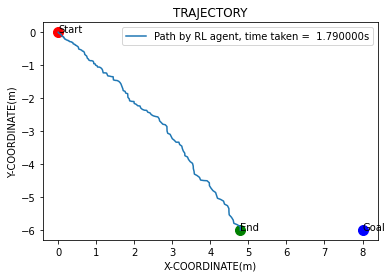

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 34       |
|    fps             | 459      |
|    time_elapsed    | 14       |
|    total_timesteps | 6501     |
---------------------------------
EP_REWARD:-22


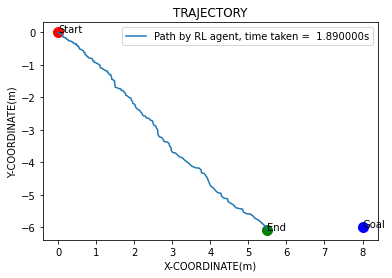

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 35       |
|    fps             | 465      |
|    time_elapsed    | 14       |
|    total_timesteps | 6690     |
---------------------------------
EP_REWARD:-28


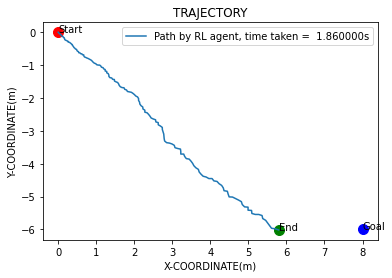

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 36       |
|    fps             | 471      |
|    time_elapsed    | 14       |
|    total_timesteps | 6876     |
---------------------------------
EP_REWARD:-2


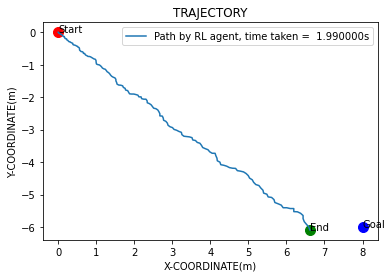

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 37       |
|    fps             | 476      |
|    time_elapsed    | 14       |
|    total_timesteps | 7075     |
---------------------------------
EP_REWARD:-20


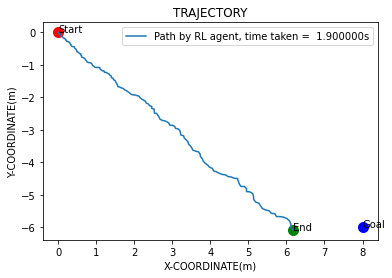

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 38       |
|    fps             | 480      |
|    time_elapsed    | 15       |
|    total_timesteps | 7265     |
---------------------------------
EP_REWARD:-34


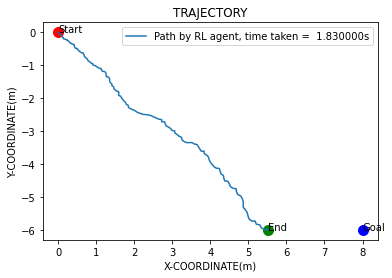

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 39       |
|    fps             | 484      |
|    time_elapsed    | 15       |
|    total_timesteps | 7448     |
---------------------------------
EP_REWARD:-50


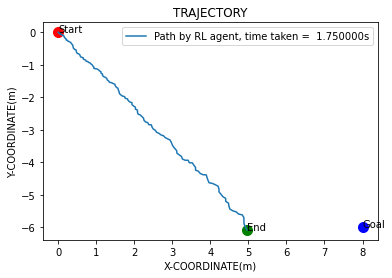

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 40       |
|    fps             | 487      |
|    time_elapsed    | 15       |
|    total_timesteps | 7623     |
---------------------------------
EP_REWARD:-10


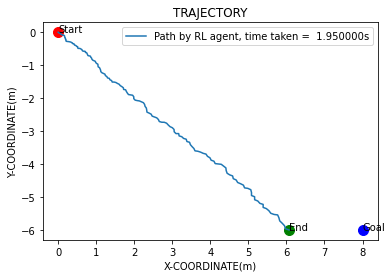

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 41       |
|    fps             | 491      |
|    time_elapsed    | 15       |
|    total_timesteps | 7818     |
---------------------------------
EP_REWARD:-36


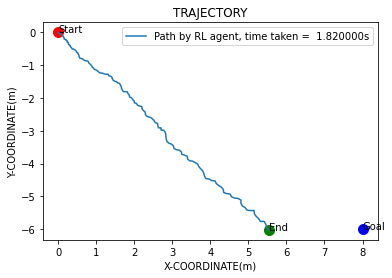

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 42       |
|    fps             | 494      |
|    time_elapsed    | 16       |
|    total_timesteps | 8000     |
---------------------------------
EP_REWARD:-20


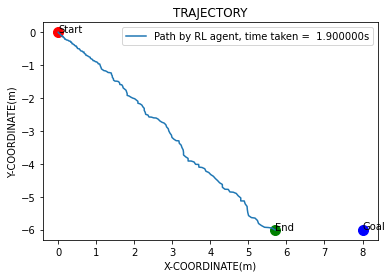

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 43       |
|    fps             | 498      |
|    time_elapsed    | 16       |
|    total_timesteps | 8190     |
---------------------------------
EP_REWARD:-10


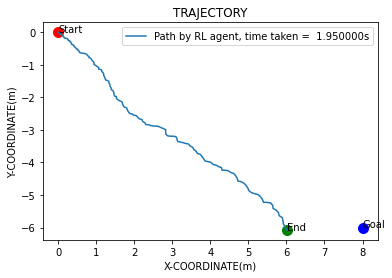

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 44       |
|    fps             | 499      |
|    time_elapsed    | 16       |
|    total_timesteps | 8385     |
---------------------------------
EP_REWARD:-32


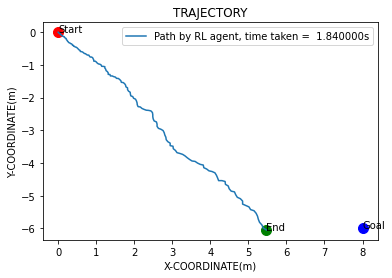

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 45       |
|    fps             | 504      |
|    time_elapsed    | 16       |
|    total_timesteps | 8569     |
---------------------------------
EP_REWARD:-22


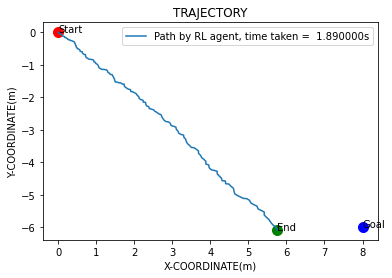

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 46       |
|    fps             | 506      |
|    time_elapsed    | 17       |
|    total_timesteps | 8758     |
---------------------------------
EP_REWARD:0


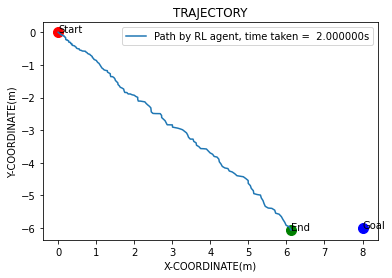

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 47       |
|    fps             | 509      |
|    time_elapsed    | 17       |
|    total_timesteps | 8958     |
---------------------------------
EP_REWARD:-44


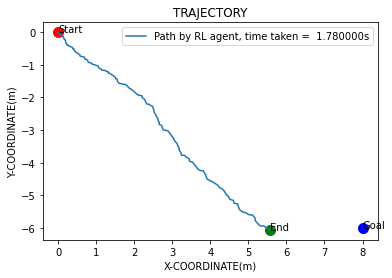

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 48       |
|    fps             | 512      |
|    time_elapsed    | 17       |
|    total_timesteps | 9136     |
---------------------------------
EP_REWARD:-14


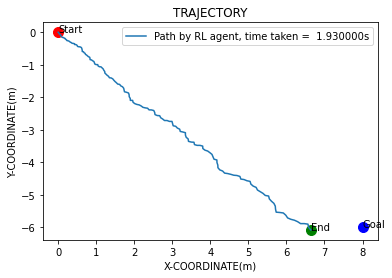

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 49       |
|    fps             | 516      |
|    time_elapsed    | 18       |
|    total_timesteps | 9329     |
---------------------------------
EP_REWARD:-42


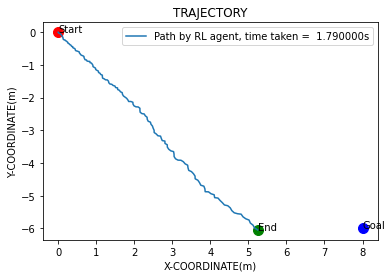

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 50       |
|    fps             | 520      |
|    time_elapsed    | 18       |
|    total_timesteps | 9508     |
---------------------------------
EP_REWARD:-4


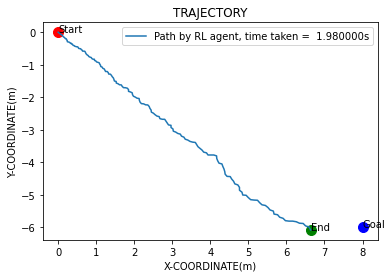

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 51       |
|    fps             | 521      |
|    time_elapsed    | 18       |
|    total_timesteps | 9706     |
---------------------------------
EP_REWARD:-0.2178829959347633


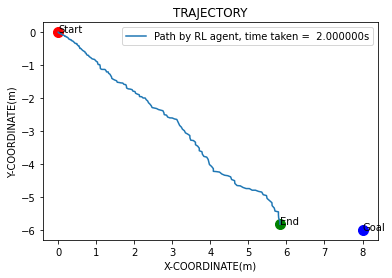

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 52       |
|    fps             | 521      |
|    time_elapsed    | 19       |
|    total_timesteps | 9906     |
---------------------------------
EP_REWARD:-0.7879285575744153


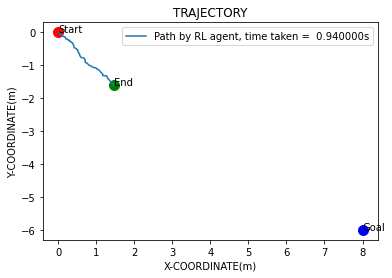

EP_REWARD:-148


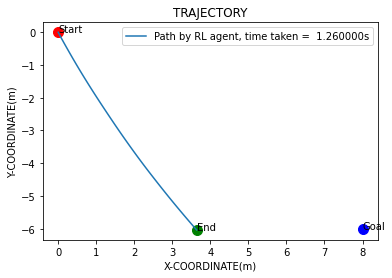

EP_REWARD:-148


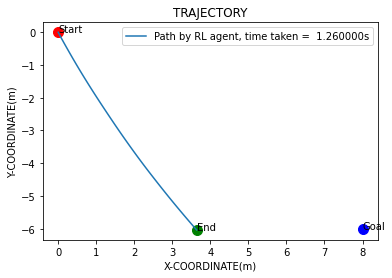

EP_REWARD:-148


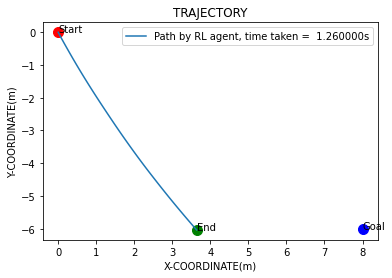

EP_REWARD:-148


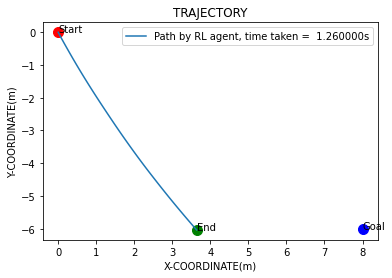

EP_REWARD:-148


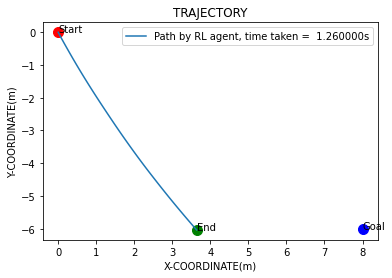

Eval num_timesteps=10000, episode_reward=-247.99 +/- 0.00
Episode length: 126.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 126      |
|    mean_reward     | -248     |
| time/              |          |
|    total_timesteps | 10000    |
---------------------------------
EP_REWARD:-16


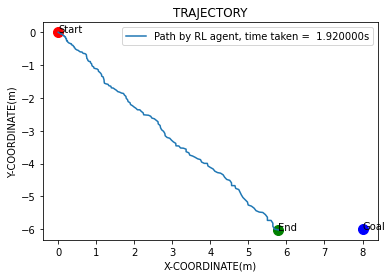

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 53       |
|    fps             | 486      |
|    time_elapsed    | 20       |
|    total_timesteps | 10192    |
---------------------------------
EP_REWARD:-10


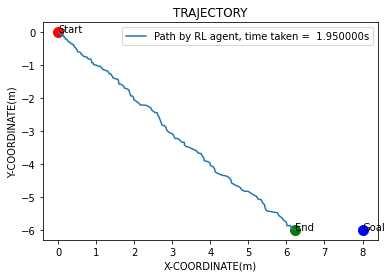

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 54       |
|    fps             | 488      |
|    time_elapsed    | 21       |
|    total_timesteps | 10387    |
---------------------------------
EP_REWARD:-0.16766743745112112


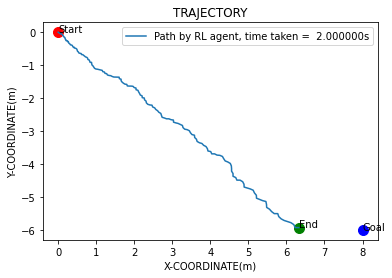

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 55       |
|    fps             | 492      |
|    time_elapsed    | 21       |
|    total_timesteps | 10587    |
---------------------------------
EP_REWARD:-14


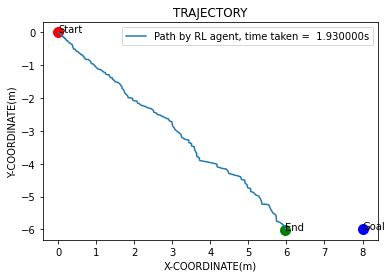

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 56       |
|    fps             | 494      |
|    time_elapsed    | 21       |
|    total_timesteps | 10780    |
---------------------------------
EP_REWARD:-28


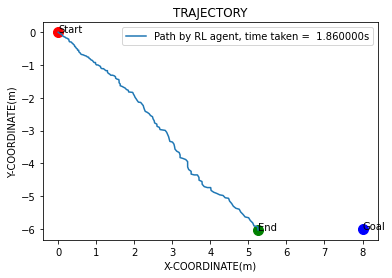

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 57       |
|    fps             | 495      |
|    time_elapsed    | 22       |
|    total_timesteps | 10966    |
---------------------------------
EP_REWARD:-8


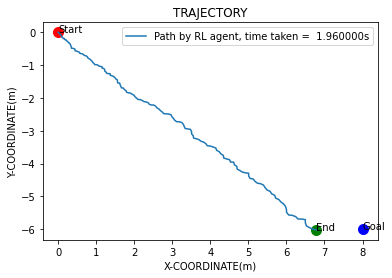

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 58       |
|    fps             | 497      |
|    time_elapsed    | 22       |
|    total_timesteps | 11162    |
---------------------------------
EP_REWARD:-30


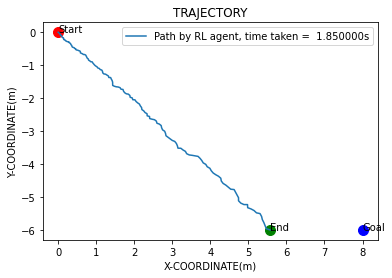

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 59       |
|    fps             | 501      |
|    time_elapsed    | 22       |
|    total_timesteps | 11347    |
---------------------------------
EP_REWARD:-34


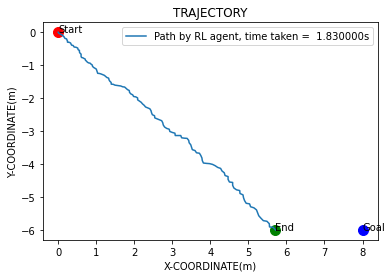

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 60       |
|    fps             | 502      |
|    time_elapsed    | 22       |
|    total_timesteps | 11530    |
---------------------------------
EP_REWARD:-32


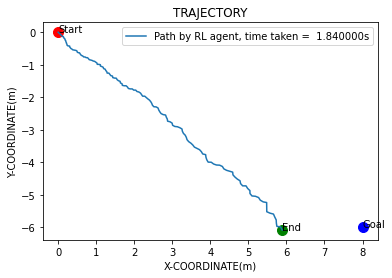

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 61       |
|    fps             | 504      |
|    time_elapsed    | 23       |
|    total_timesteps | 11714    |
---------------------------------
EP_REWARD:-22


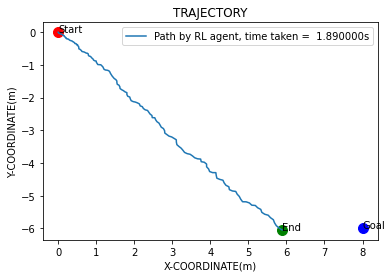

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 62       |
|    fps             | 506      |
|    time_elapsed    | 23       |
|    total_timesteps | 11903    |
---------------------------------
EP_REWARD:-14


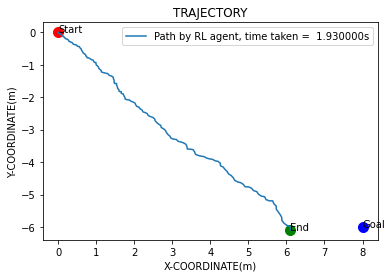

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 63       |
|    fps             | 508      |
|    time_elapsed    | 23       |
|    total_timesteps | 12096    |
---------------------------------
EP_REWARD:-26


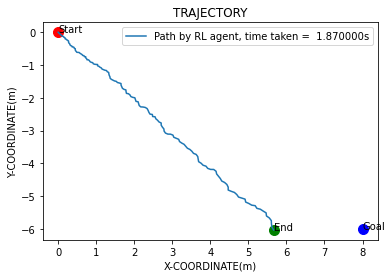

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 64       |
|    fps             | 511      |
|    time_elapsed    | 24       |
|    total_timesteps | 12283    |
---------------------------------
EP_REWARD:-0.1479548930914478


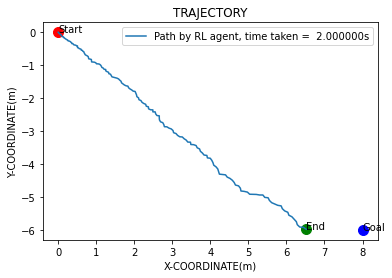

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 65       |
|    fps             | 514      |
|    time_elapsed    | 24       |
|    total_timesteps | 12483    |
---------------------------------
EP_REWARD:-26


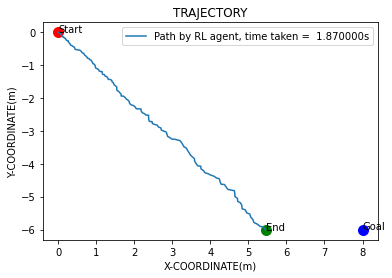

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 66       |
|    fps             | 516      |
|    time_elapsed    | 24       |
|    total_timesteps | 12670    |
---------------------------------
EP_REWARD:-34


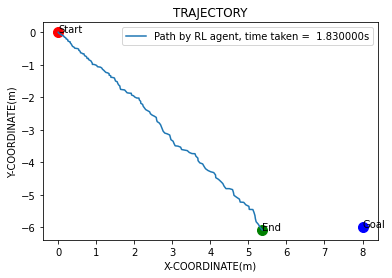

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 67       |
|    fps             | 518      |
|    time_elapsed    | 24       |
|    total_timesteps | 12853    |
---------------------------------
EP_REWARD:-16


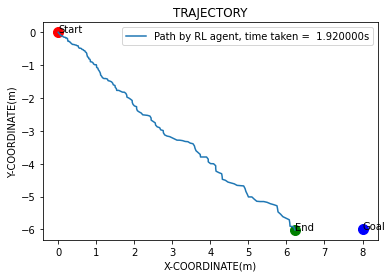

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 68       |
|    fps             | 521      |
|    time_elapsed    | 25       |
|    total_timesteps | 13045    |
---------------------------------
EP_REWARD:-6


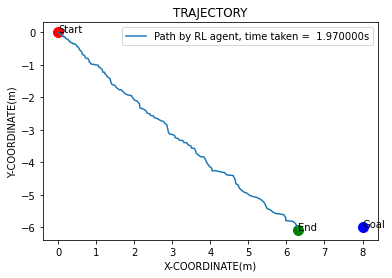

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 69       |
|    fps             | 521      |
|    time_elapsed    | 25       |
|    total_timesteps | 13242    |
---------------------------------
EP_REWARD:-0.2068211671840967


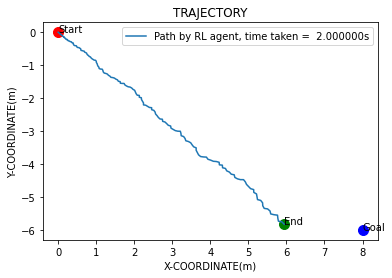

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 70       |
|    fps             | 523      |
|    time_elapsed    | 25       |
|    total_timesteps | 13442    |
---------------------------------
EP_REWARD:0


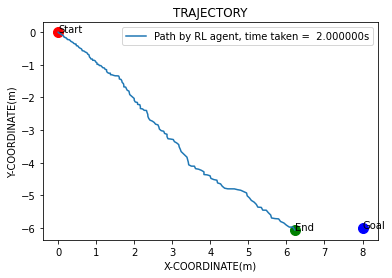

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 71       |
|    fps             | 524      |
|    time_elapsed    | 25       |
|    total_timesteps | 13642    |
---------------------------------
EP_REWARD:-18


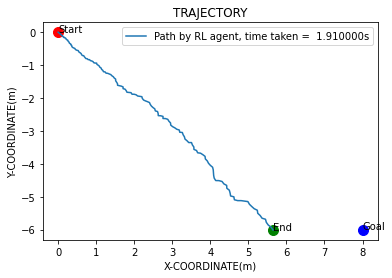

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 72       |
|    fps             | 524      |
|    time_elapsed    | 26       |
|    total_timesteps | 13833    |
---------------------------------
EP_REWARD:-32


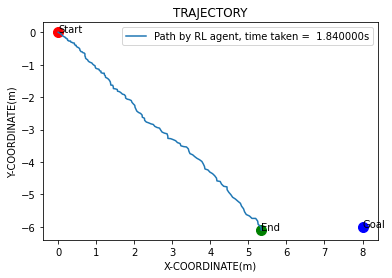

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 73       |
|    fps             | 524      |
|    time_elapsed    | 26       |
|    total_timesteps | 14017    |
---------------------------------
EP_REWARD:-40


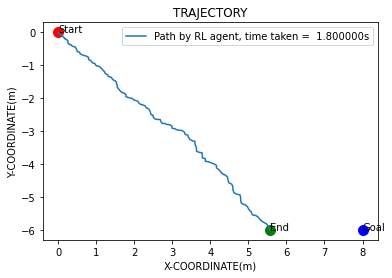

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 74       |
|    fps             | 526      |
|    time_elapsed    | 26       |
|    total_timesteps | 14197    |
---------------------------------
EP_REWARD:0


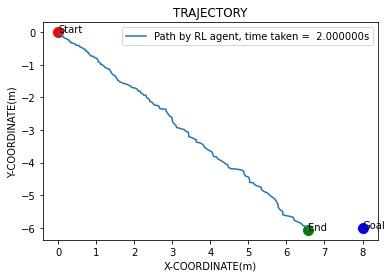

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 75       |
|    fps             | 527      |
|    time_elapsed    | 27       |
|    total_timesteps | 14397    |
---------------------------------
EP_REWARD:-34


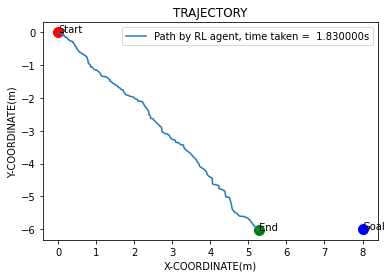

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 76       |
|    fps             | 529      |
|    time_elapsed    | 27       |
|    total_timesteps | 14580    |
---------------------------------
EP_REWARD:0


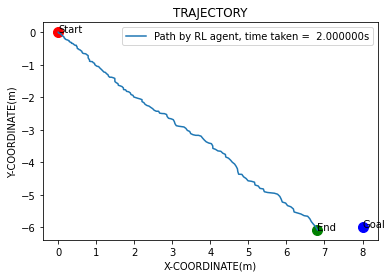

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 77       |
|    fps             | 528      |
|    time_elapsed    | 27       |
|    total_timesteps | 14780    |
---------------------------------
EP_REWARD:-0.14773351911749738


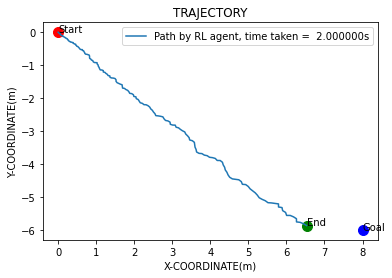

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 78       |
|    fps             | 530      |
|    time_elapsed    | 28       |
|    total_timesteps | 14980    |
---------------------------------
EP_REWARD:-0.9878820567748362


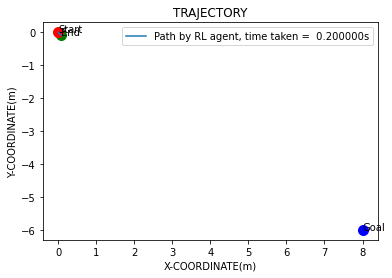

EP_REWARD:-148


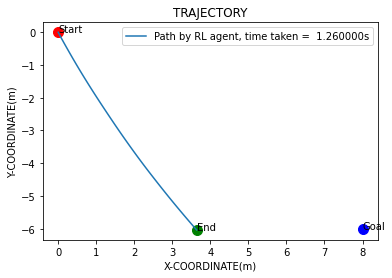

EP_REWARD:-148


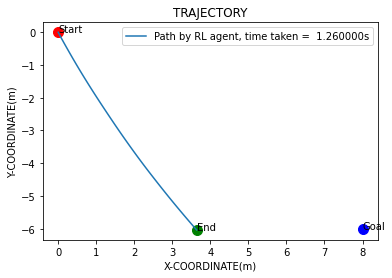

EP_REWARD:-148


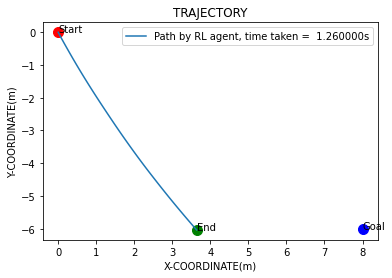

EP_REWARD:-148


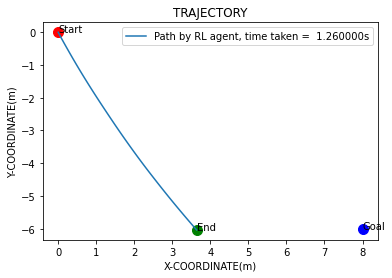

EP_REWARD:-148


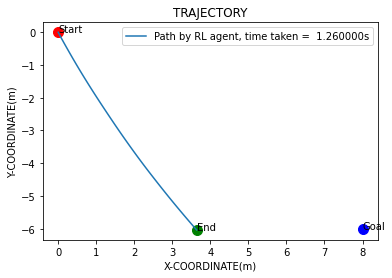

Eval num_timesteps=15000, episode_reward=-247.99 +/- 0.00
Episode length: 126.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 126      |
|    mean_reward     | -248     |
| time/              |          |
|    total_timesteps | 15000    |
---------------------------------
EP_REWARD:-24


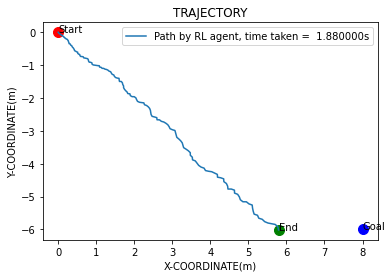

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 79       |
|    fps             | 502      |
|    time_elapsed    | 30       |
|    total_timesteps | 15188    |
---------------------------------
EP_REWARD:-18


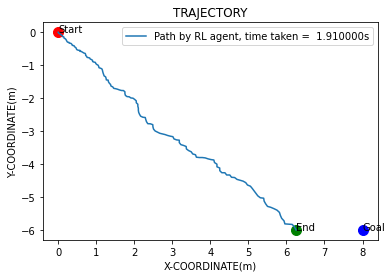

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 80       |
|    fps             | 502      |
|    time_elapsed    | 30       |
|    total_timesteps | 15379    |
---------------------------------
EP_REWARD:-28


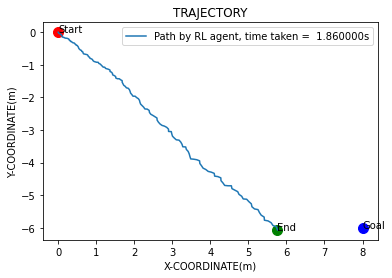

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 81       |
|    fps             | 504      |
|    time_elapsed    | 30       |
|    total_timesteps | 15565    |
---------------------------------
EP_REWARD:-40


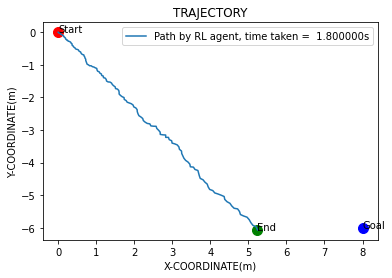

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 82       |
|    fps             | 505      |
|    time_elapsed    | 31       |
|    total_timesteps | 15745    |
---------------------------------
EP_REWARD:-8


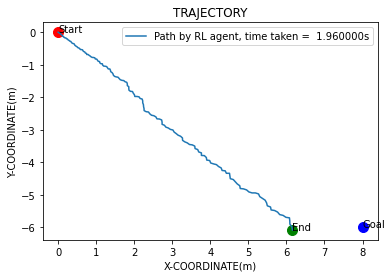

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 83       |
|    fps             | 507      |
|    time_elapsed    | 31       |
|    total_timesteps | 15941    |
---------------------------------
EP_REWARD:-10


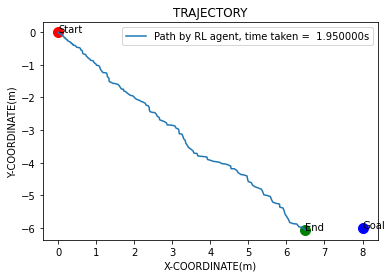

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 84       |
|    fps             | 507      |
|    time_elapsed    | 31       |
|    total_timesteps | 16136    |
---------------------------------
EP_REWARD:-20


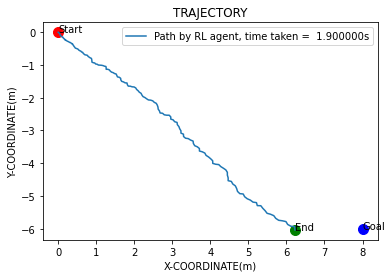

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 85       |
|    fps             | 508      |
|    time_elapsed    | 32       |
|    total_timesteps | 16326    |
---------------------------------
EP_REWARD:-2


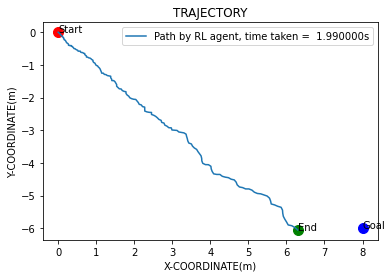

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 86       |
|    fps             | 510      |
|    time_elapsed    | 32       |
|    total_timesteps | 16525    |
---------------------------------
EP_REWARD:-44


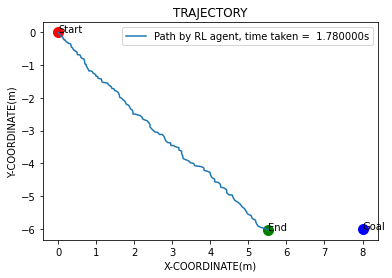

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 87       |
|    fps             | 511      |
|    time_elapsed    | 32       |
|    total_timesteps | 16703    |
---------------------------------
EP_REWARD:-8


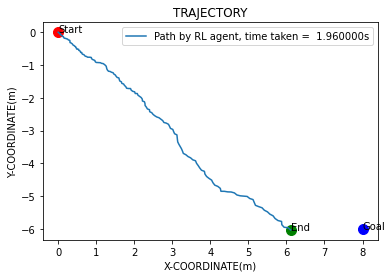

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 88       |
|    fps             | 512      |
|    time_elapsed    | 32       |
|    total_timesteps | 16899    |
---------------------------------
EP_REWARD:-24


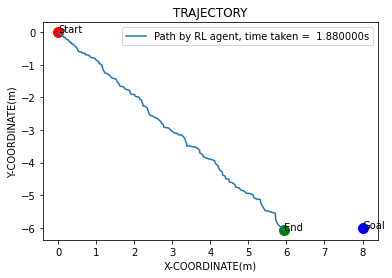

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 89       |
|    fps             | 513      |
|    time_elapsed    | 33       |
|    total_timesteps | 17087    |
---------------------------------
EP_REWARD:-0.16839727483002054


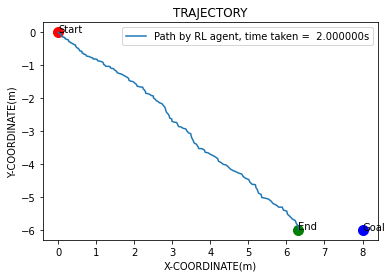

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 90       |
|    fps             | 515      |
|    time_elapsed    | 33       |
|    total_timesteps | 17287    |
---------------------------------
EP_REWARD:-22


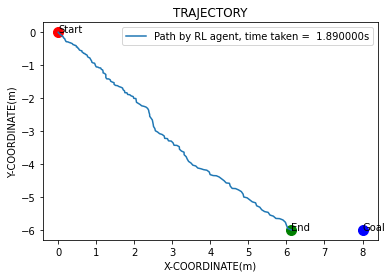

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 91       |
|    fps             | 517      |
|    time_elapsed    | 33       |
|    total_timesteps | 17476    |
---------------------------------
EP_REWARD:-4


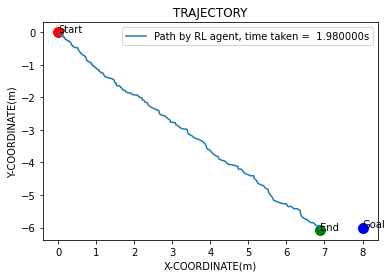

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 92       |
|    fps             | 518      |
|    time_elapsed    | 34       |
|    total_timesteps | 17674    |
---------------------------------
EP_REWARD:-0.18631350028853796


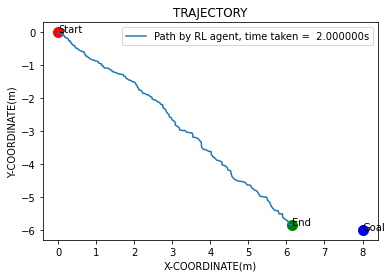

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -156     |
| time/              |          |
|    episodes        | 93       |
|    fps             | 519      |
|    time_elapsed    | 34       |
|    total_timesteps | 17874    |
---------------------------------
EP_REWARD:-20


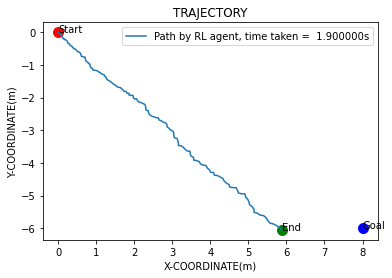

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -156     |
| time/              |          |
|    episodes        | 94       |
|    fps             | 521      |
|    time_elapsed    | 34       |
|    total_timesteps | 18064    |
---------------------------------
EP_REWARD:-30


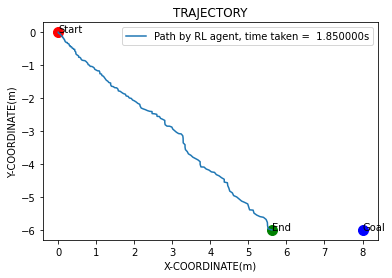

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -156     |
| time/              |          |
|    episodes        | 95       |
|    fps             | 522      |
|    time_elapsed    | 34       |
|    total_timesteps | 18249    |
---------------------------------
EP_REWARD:-32


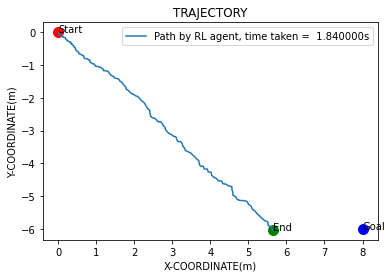

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 96       |
|    fps             | 523      |
|    time_elapsed    | 35       |
|    total_timesteps | 18433    |
---------------------------------
EP_REWARD:-6


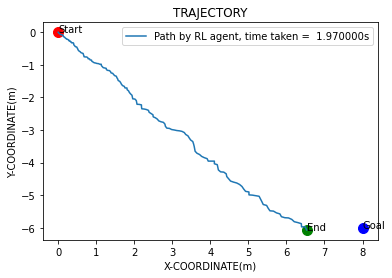

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -156     |
| time/              |          |
|    episodes        | 97       |
|    fps             | 525      |
|    time_elapsed    | 35       |
|    total_timesteps | 18630    |
---------------------------------
EP_REWARD:-14


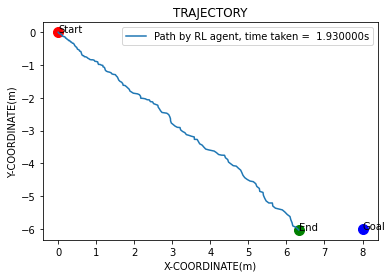

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -156     |
| time/              |          |
|    episodes        | 98       |
|    fps             | 522      |
|    time_elapsed    | 36       |
|    total_timesteps | 18823    |
---------------------------------
EP_REWARD:-16


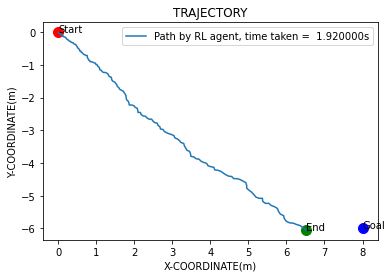

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -156     |
| time/              |          |
|    episodes        | 99       |
|    fps             | 521      |
|    time_elapsed    | 36       |
|    total_timesteps | 19015    |
---------------------------------
EP_REWARD:-18


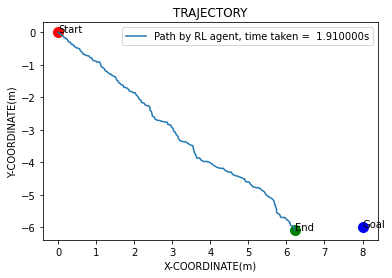

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -156     |
| time/              |          |
|    episodes        | 100      |
|    fps             | 523      |
|    time_elapsed    | 36       |
|    total_timesteps | 19206    |
---------------------------------
EP_REWARD:-36


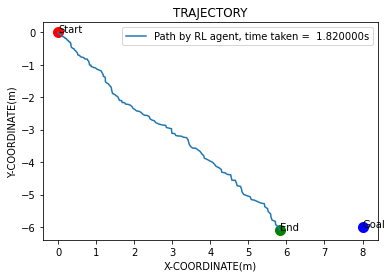

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -156     |
| time/              |          |
|    episodes        | 101      |
|    fps             | 523      |
|    time_elapsed    | 37       |
|    total_timesteps | 19388    |
---------------------------------
EP_REWARD:-38


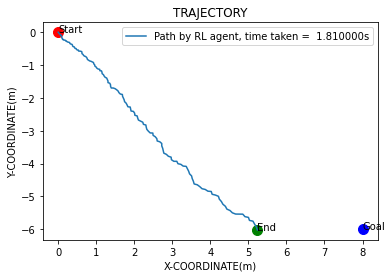

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -156     |
| time/              |          |
|    episodes        | 102      |
|    fps             | 523      |
|    time_elapsed    | 37       |
|    total_timesteps | 19569    |
---------------------------------
EP_REWARD:-42


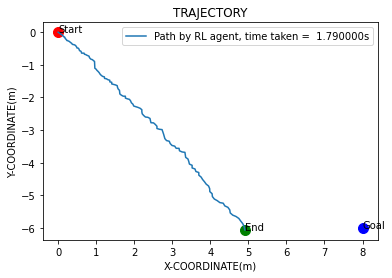

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -156     |
| time/              |          |
|    episodes        | 103      |
|    fps             | 523      |
|    time_elapsed    | 37       |
|    total_timesteps | 19748    |
---------------------------------
EP_REWARD:-34


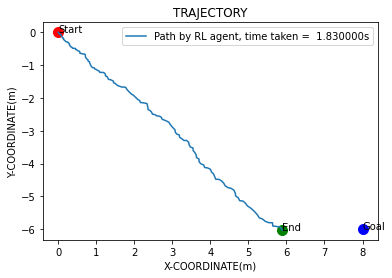

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 104      |
|    fps             | 523      |
|    time_elapsed    | 38       |
|    total_timesteps | 19931    |
---------------------------------
EP_REWARD:-0.8917142407790384


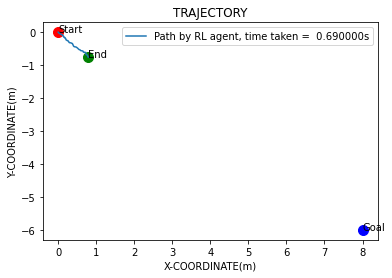

EP_REWARD:-148


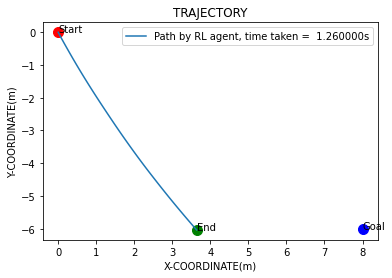

EP_REWARD:-148


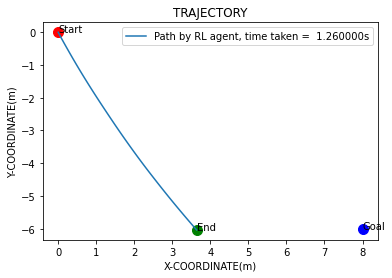

EP_REWARD:-148


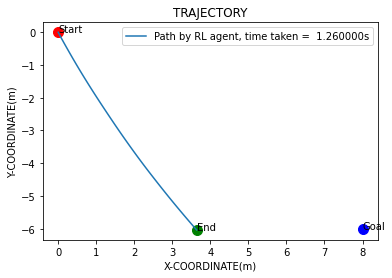

EP_REWARD:-148


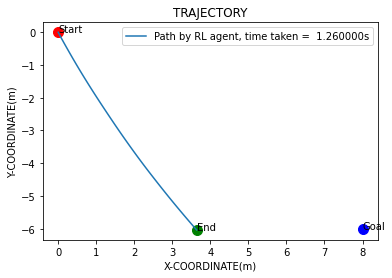

EP_REWARD:-148


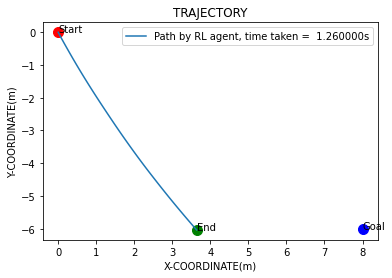

Eval num_timesteps=20000, episode_reward=-247.99 +/- 0.00
Episode length: 126.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 126      |
|    mean_reward     | -248     |
| time/              |          |
|    total_timesteps | 20000    |
---------------------------------
EP_REWARD:-22


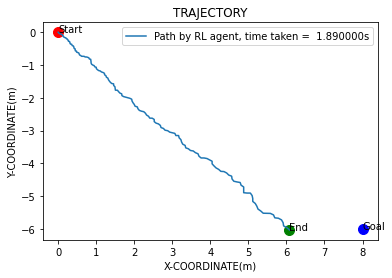

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -156     |
| time/              |          |
|    episodes        | 105      |
|    fps             | 507      |
|    time_elapsed    | 39       |
|    total_timesteps | 20189    |
---------------------------------
EP_REWARD:-44


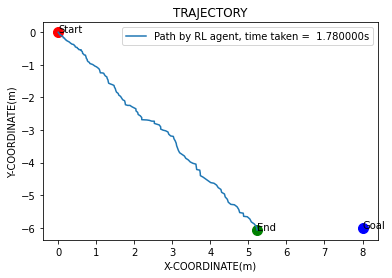

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 106      |
|    fps             | 507      |
|    time_elapsed    | 40       |
|    total_timesteps | 20367    |
---------------------------------
EP_REWARD:-28


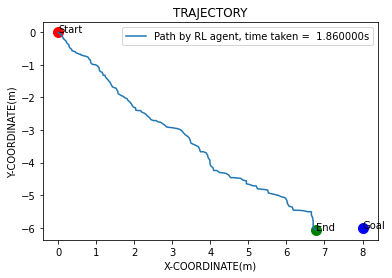

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 107      |
|    fps             | 508      |
|    time_elapsed    | 40       |
|    total_timesteps | 20553    |
---------------------------------
EP_REWARD:-24


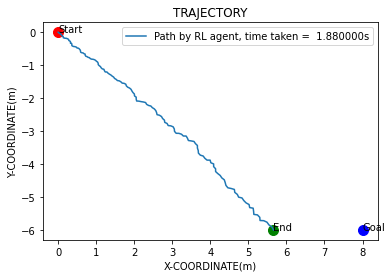

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 108      |
|    fps             | 510      |
|    time_elapsed    | 40       |
|    total_timesteps | 20741    |
---------------------------------
EP_REWARD:-28


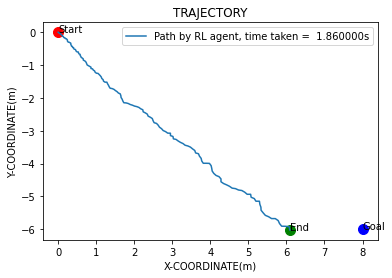

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 109      |
|    fps             | 512      |
|    time_elapsed    | 40       |
|    total_timesteps | 20927    |
---------------------------------
EP_REWARD:-12


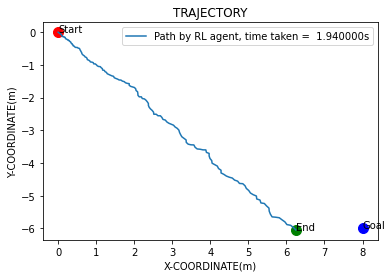

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 110      |
|    fps             | 513      |
|    time_elapsed    | 41       |
|    total_timesteps | 21121    |
---------------------------------
EP_REWARD:-8


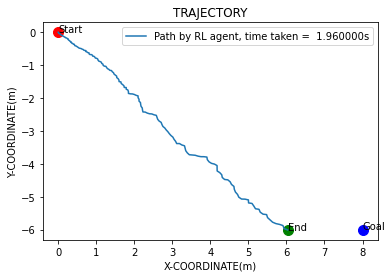

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 111      |
|    fps             | 514      |
|    time_elapsed    | 41       |
|    total_timesteps | 21317    |
---------------------------------
EP_REWARD:-6


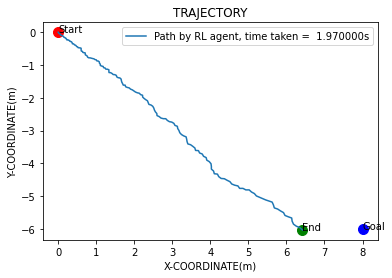

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -156     |
| time/              |          |
|    episodes        | 112      |
|    fps             | 516      |
|    time_elapsed    | 41       |
|    total_timesteps | 21514    |
---------------------------------
EP_REWARD:-34


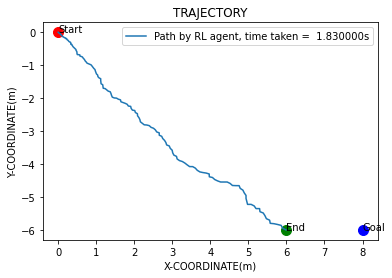

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 113      |
|    fps             | 517      |
|    time_elapsed    | 41       |
|    total_timesteps | 21697    |
---------------------------------
EP_REWARD:-38


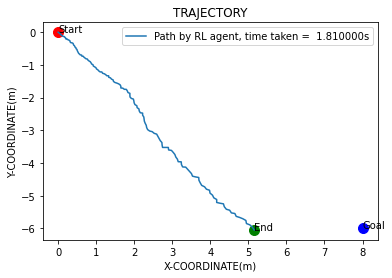

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 114      |
|    fps             | 518      |
|    time_elapsed    | 42       |
|    total_timesteps | 21878    |
---------------------------------
EP_REWARD:-2


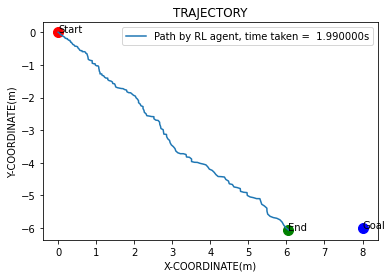

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 115      |
|    fps             | 519      |
|    time_elapsed    | 42       |
|    total_timesteps | 22077    |
---------------------------------
EP_REWARD:-36


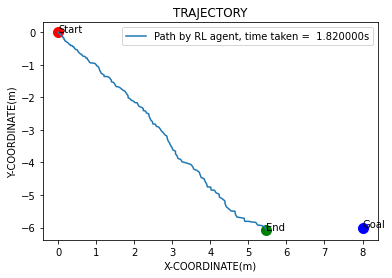

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 116      |
|    fps             | 520      |
|    time_elapsed    | 42       |
|    total_timesteps | 22259    |
---------------------------------
EP_REWARD:-46


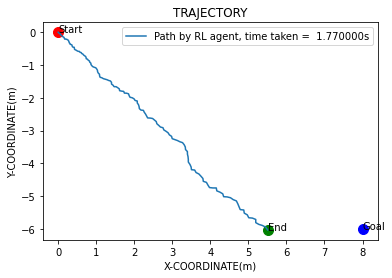

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 117      |
|    fps             | 521      |
|    time_elapsed    | 42       |
|    total_timesteps | 22436    |
---------------------------------
EP_REWARD:-24


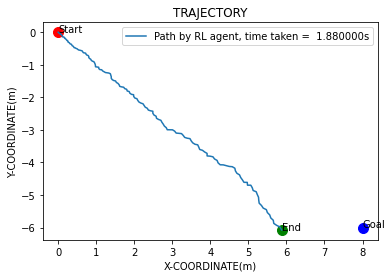

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 118      |
|    fps             | 522      |
|    time_elapsed    | 43       |
|    total_timesteps | 22624    |
---------------------------------
EP_REWARD:-0.14708734408717813


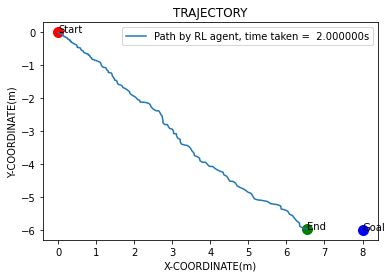

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 119      |
|    fps             | 520      |
|    time_elapsed    | 43       |
|    total_timesteps | 22824    |
---------------------------------
EP_REWARD:-46


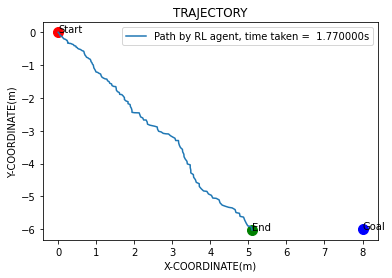

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 120      |
|    fps             | 521      |
|    time_elapsed    | 44       |
|    total_timesteps | 23001    |
---------------------------------
EP_REWARD:-0.16586625877821426


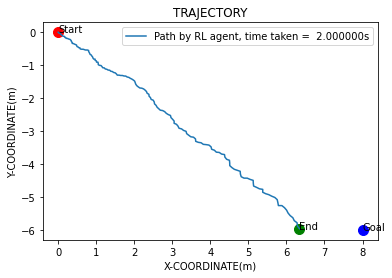

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 121      |
|    fps             | 523      |
|    time_elapsed    | 44       |
|    total_timesteps | 23201    |
---------------------------------
EP_REWARD:-10


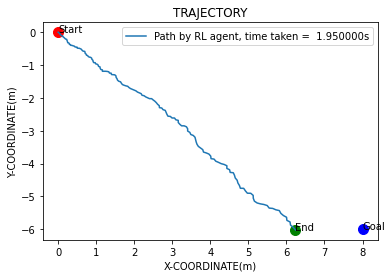

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 122      |
|    fps             | 524      |
|    time_elapsed    | 44       |
|    total_timesteps | 23396    |
---------------------------------
EP_REWARD:-0.19891232623009847


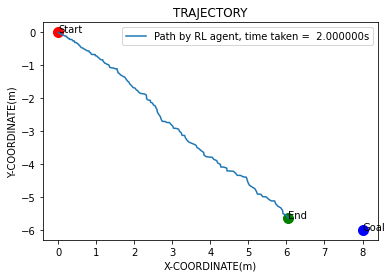

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 123      |
|    fps             | 526      |
|    time_elapsed    | 44       |
|    total_timesteps | 23596    |
---------------------------------
EP_REWARD:-36


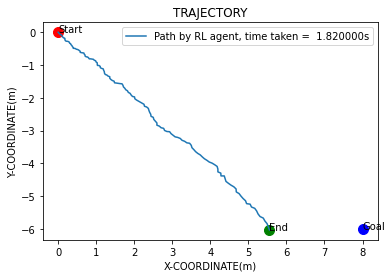

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 124      |
|    fps             | 527      |
|    time_elapsed    | 45       |
|    total_timesteps | 23778    |
---------------------------------
EP_REWARD:-32


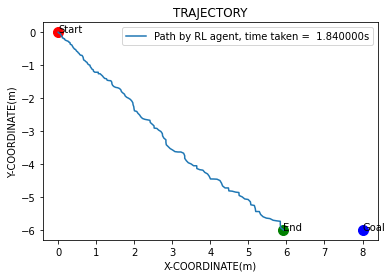

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 125      |
|    fps             | 528      |
|    time_elapsed    | 45       |
|    total_timesteps | 23962    |
---------------------------------
EP_REWARD:-38


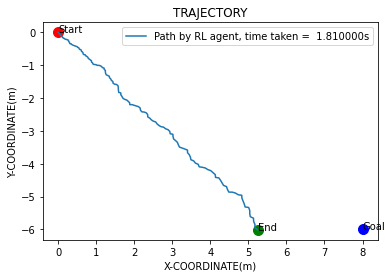

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 126      |
|    fps             | 529      |
|    time_elapsed    | 45       |
|    total_timesteps | 24143    |
---------------------------------
EP_REWARD:-16


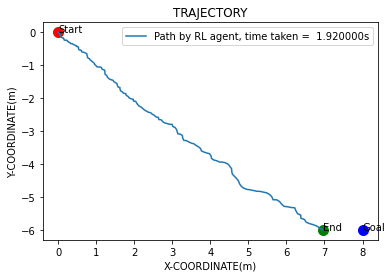

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 127      |
|    fps             | 530      |
|    time_elapsed    | 45       |
|    total_timesteps | 24335    |
---------------------------------
EP_REWARD:-34


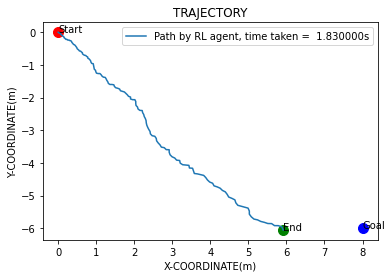

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 128      |
|    fps             | 532      |
|    time_elapsed    | 46       |
|    total_timesteps | 24518    |
---------------------------------
EP_REWARD:-0.17932108966652271


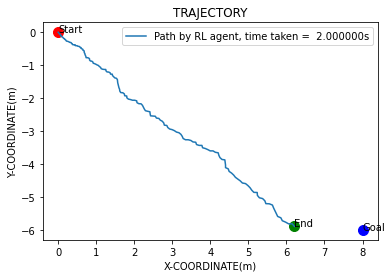

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 129      |
|    fps             | 534      |
|    time_elapsed    | 46       |
|    total_timesteps | 24718    |
---------------------------------
EP_REWARD:-8


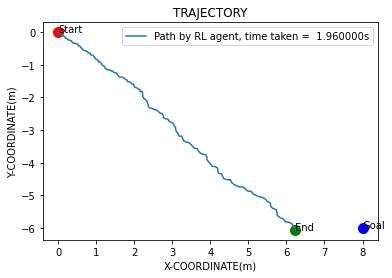

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 130      |
|    fps             | 535      |
|    time_elapsed    | 46       |
|    total_timesteps | 24914    |
---------------------------------
EP_REWARD:-0.8243182632234783


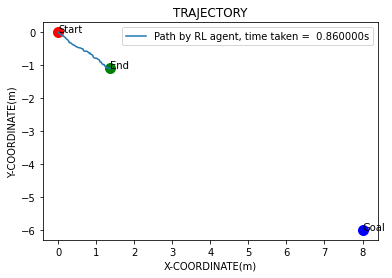

EP_REWARD:-148


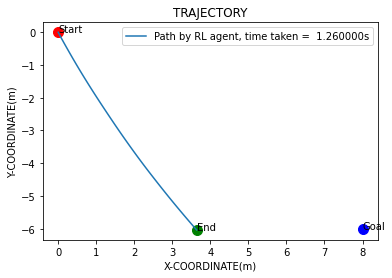

EP_REWARD:-148


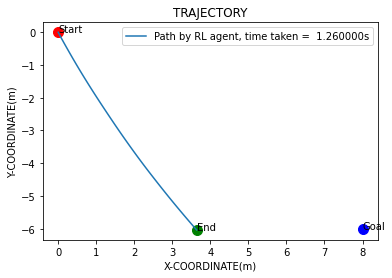

EP_REWARD:-148


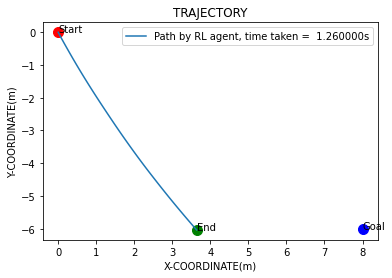

EP_REWARD:-148


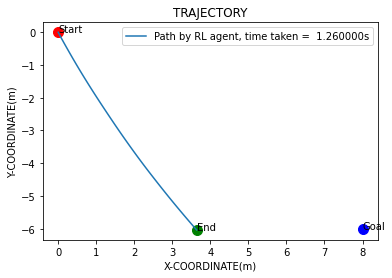

EP_REWARD:-148


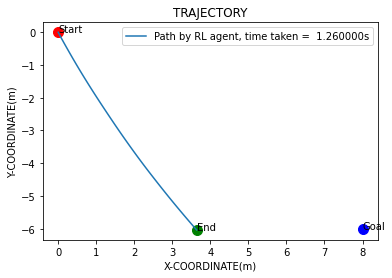

Eval num_timesteps=25000, episode_reward=-247.99 +/- 0.00
Episode length: 126.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 126      |
|    mean_reward     | -248     |
| time/              |          |
|    total_timesteps | 25000    |
---------------------------------
EP_REWARD:-12


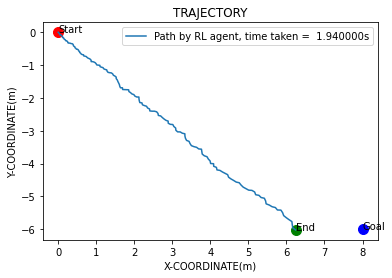

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 131      |
|    fps             | 521      |
|    time_elapsed    | 48       |
|    total_timesteps | 25194    |
---------------------------------
EP_REWARD:-18


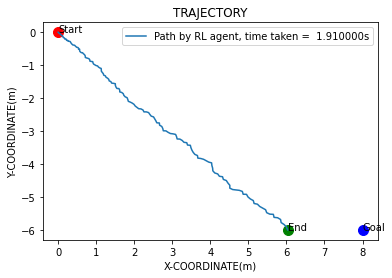

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 132      |
|    fps             | 522      |
|    time_elapsed    | 48       |
|    total_timesteps | 25385    |
---------------------------------
EP_REWARD:-30


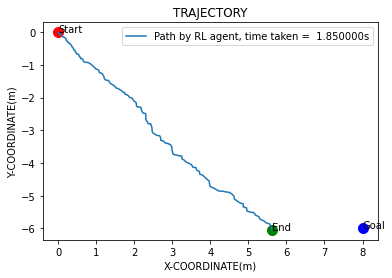

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 133      |
|    fps             | 522      |
|    time_elapsed    | 48       |
|    total_timesteps | 25570    |
---------------------------------
EP_REWARD:-18


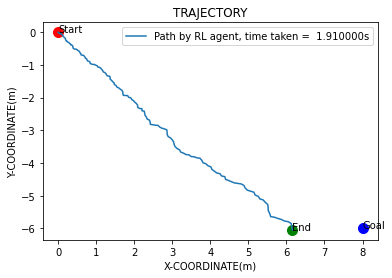

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 134      |
|    fps             | 523      |
|    time_elapsed    | 49       |
|    total_timesteps | 25761    |
---------------------------------
EP_REWARD:-30


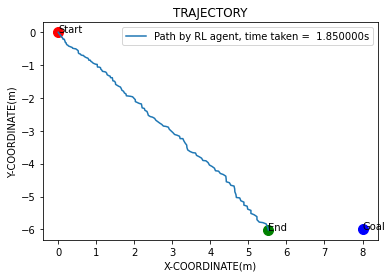

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 135      |
|    fps             | 523      |
|    time_elapsed    | 49       |
|    total_timesteps | 25946    |
---------------------------------
EP_REWARD:-36


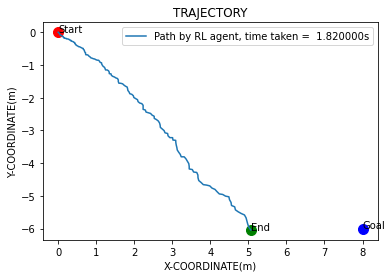

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 136      |
|    fps             | 523      |
|    time_elapsed    | 49       |
|    total_timesteps | 26128    |
---------------------------------
EP_REWARD:-0.1455383002486006


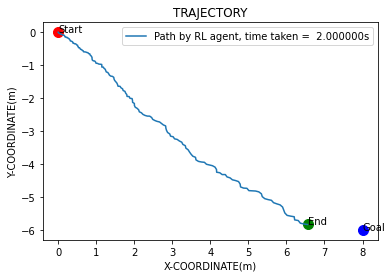

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 137      |
|    fps             | 523      |
|    time_elapsed    | 50       |
|    total_timesteps | 26328    |
---------------------------------
EP_REWARD:-28


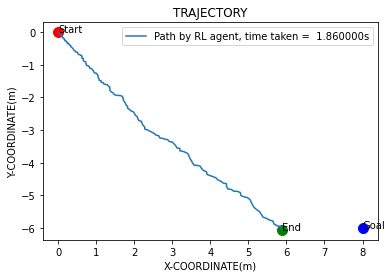

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 138      |
|    fps             | 524      |
|    time_elapsed    | 50       |
|    total_timesteps | 26514    |
---------------------------------
EP_REWARD:-10


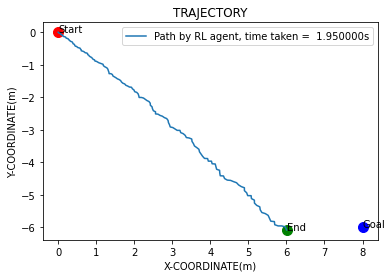

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 139      |
|    fps             | 526      |
|    time_elapsed    | 50       |
|    total_timesteps | 26709    |
---------------------------------
EP_REWARD:-22


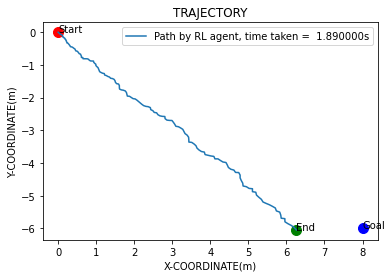

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 140      |
|    fps             | 524      |
|    time_elapsed    | 51       |
|    total_timesteps | 26898    |
---------------------------------
EP_REWARD:-30


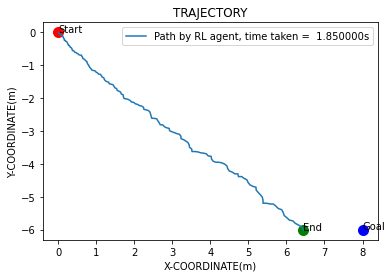

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 141      |
|    fps             | 523      |
|    time_elapsed    | 51       |
|    total_timesteps | 27083    |
---------------------------------
EP_REWARD:-20


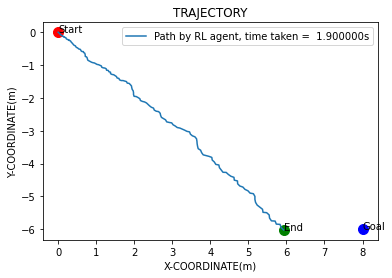

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 142      |
|    fps             | 524      |
|    time_elapsed    | 52       |
|    total_timesteps | 27273    |
---------------------------------
EP_REWARD:-0.24776955695015657


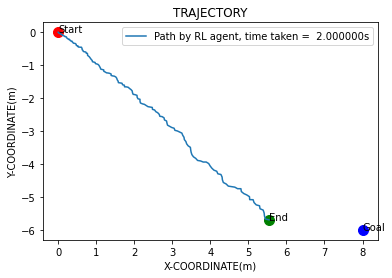

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 143      |
|    fps             | 524      |
|    time_elapsed    | 52       |
|    total_timesteps | 27473    |
---------------------------------
EP_REWARD:-30


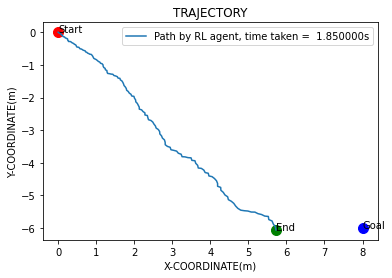

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 144      |
|    fps             | 526      |
|    time_elapsed    | 52       |
|    total_timesteps | 27658    |
---------------------------------
EP_REWARD:-22


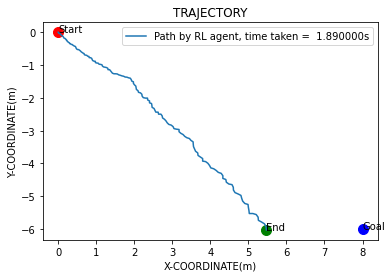

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 145      |
|    fps             | 526      |
|    time_elapsed    | 52       |
|    total_timesteps | 27847    |
---------------------------------
EP_REWARD:-40


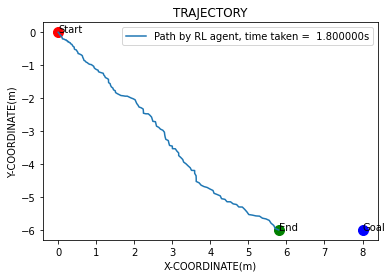

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 146      |
|    fps             | 526      |
|    time_elapsed    | 53       |
|    total_timesteps | 28027    |
---------------------------------
EP_REWARD:-16


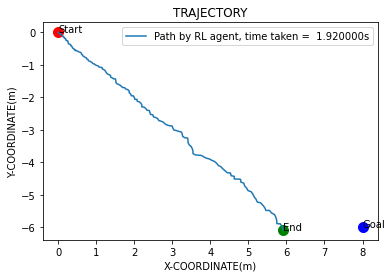

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 147      |
|    fps             | 526      |
|    time_elapsed    | 53       |
|    total_timesteps | 28219    |
---------------------------------
EP_REWARD:-36


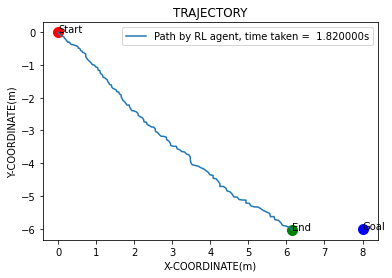

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 148      |
|    fps             | 527      |
|    time_elapsed    | 53       |
|    total_timesteps | 28401    |
---------------------------------
EP_REWARD:-40


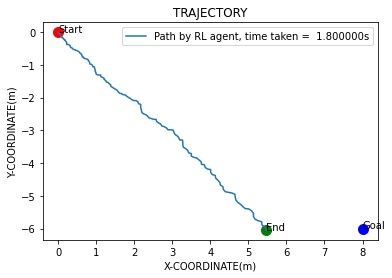

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 149      |
|    fps             | 528      |
|    time_elapsed    | 54       |
|    total_timesteps | 28581    |
---------------------------------
EP_REWARD:-26


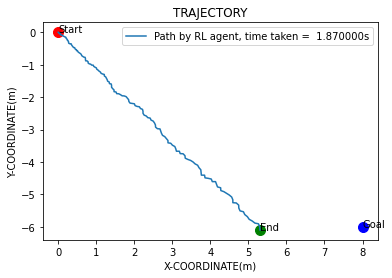

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 150      |
|    fps             | 528      |
|    time_elapsed    | 54       |
|    total_timesteps | 28768    |
---------------------------------
EP_REWARD:-30


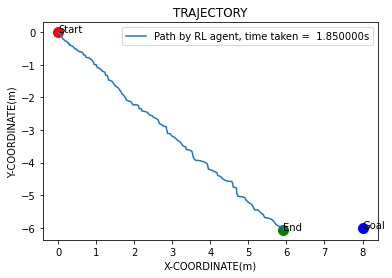

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 151      |
|    fps             | 528      |
|    time_elapsed    | 54       |
|    total_timesteps | 28953    |
---------------------------------
EP_REWARD:-6


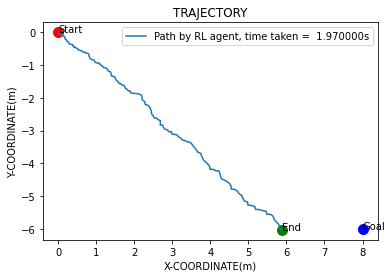

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 152      |
|    fps             | 529      |
|    time_elapsed    | 55       |
|    total_timesteps | 29150    |
---------------------------------
EP_REWARD:-22


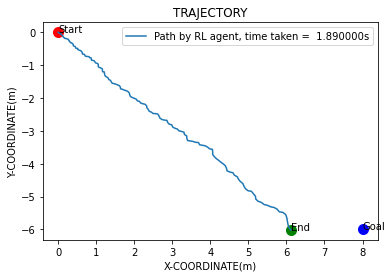

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 153      |
|    fps             | 530      |
|    time_elapsed    | 55       |
|    total_timesteps | 29339    |
---------------------------------
EP_REWARD:-8


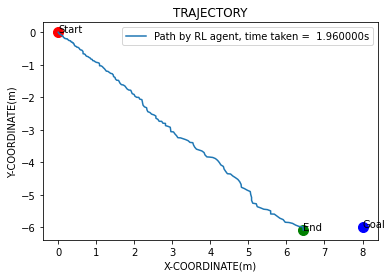

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 154      |
|    fps             | 530      |
|    time_elapsed    | 55       |
|    total_timesteps | 29535    |
---------------------------------
EP_REWARD:-22


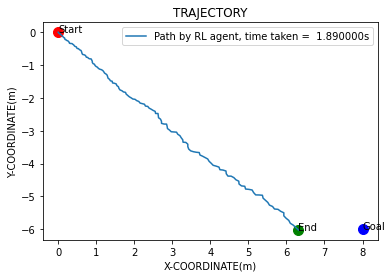

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 155      |
|    fps             | 530      |
|    time_elapsed    | 56       |
|    total_timesteps | 29724    |
---------------------------------
EP_REWARD:-10


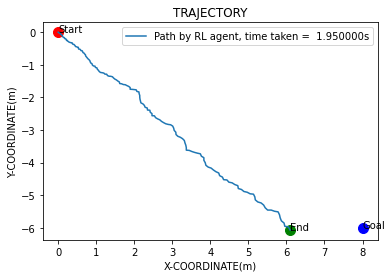

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 156      |
|    fps             | 531      |
|    time_elapsed    | 56       |
|    total_timesteps | 29919    |
---------------------------------
EP_REWARD:-0.8390693646858186


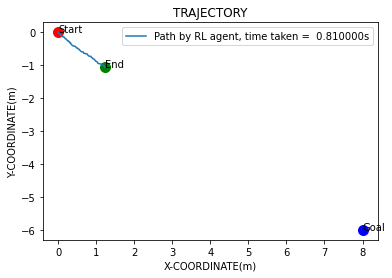

EP_REWARD:-148


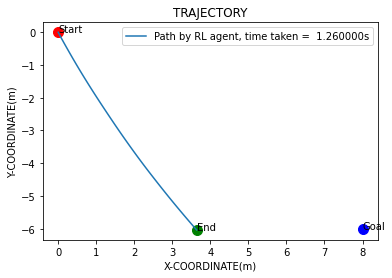

EP_REWARD:-148


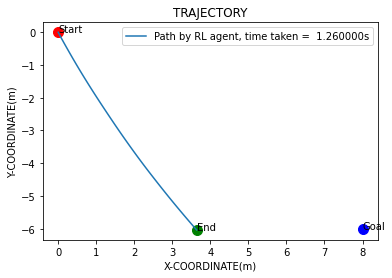

EP_REWARD:-148


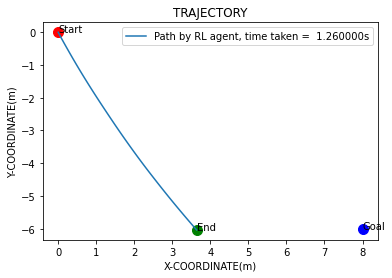

EP_REWARD:-148


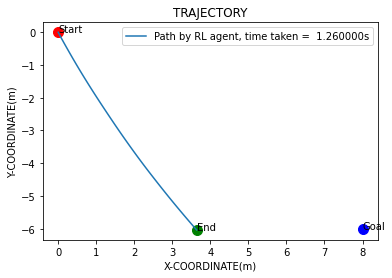

EP_REWARD:-148


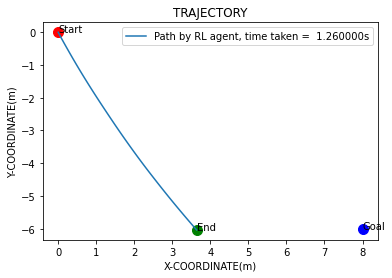

Eval num_timesteps=30000, episode_reward=-247.99 +/- 0.00
Episode length: 126.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 126      |
|    mean_reward     | -248     |
| time/              |          |
|    total_timesteps | 30000    |
---------------------------------
EP_REWARD:-26


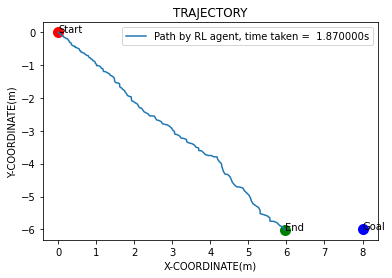

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 157      |
|    fps             | 517      |
|    time_elapsed    | 58       |
|    total_timesteps | 30187    |
---------------------------------
EP_REWARD:-28


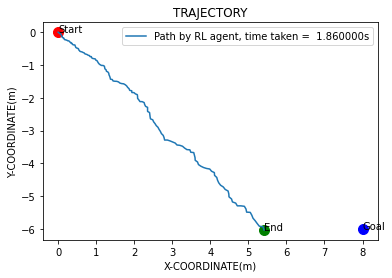

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 158      |
|    fps             | 518      |
|    time_elapsed    | 58       |
|    total_timesteps | 30373    |
---------------------------------
EP_REWARD:-4


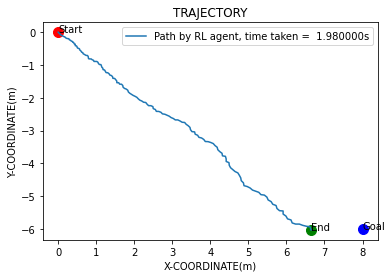

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 159      |
|    fps             | 519      |
|    time_elapsed    | 58       |
|    total_timesteps | 30571    |
---------------------------------
EP_REWARD:-56


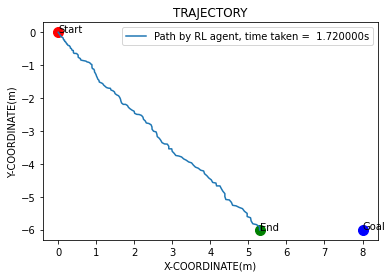

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 160      |
|    fps             | 519      |
|    time_elapsed    | 59       |
|    total_timesteps | 30743    |
---------------------------------
EP_REWARD:-20


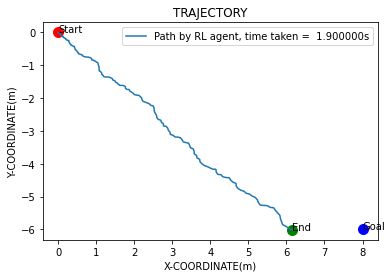

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 161      |
|    fps             | 518      |
|    time_elapsed    | 59       |
|    total_timesteps | 30933    |
---------------------------------
EP_REWARD:-18


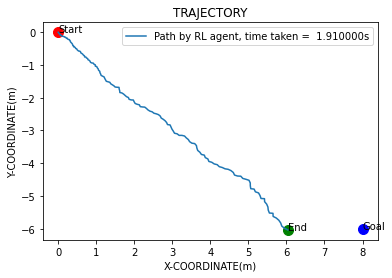

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 162      |
|    fps             | 518      |
|    time_elapsed    | 59       |
|    total_timesteps | 31124    |
---------------------------------
EP_REWARD:-20


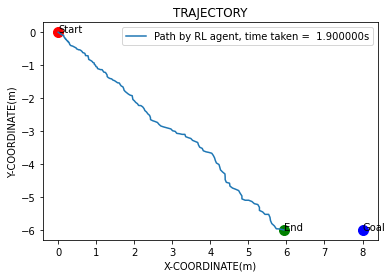

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 163      |
|    fps             | 519      |
|    time_elapsed    | 60       |
|    total_timesteps | 31314    |
---------------------------------
EP_REWARD:-2


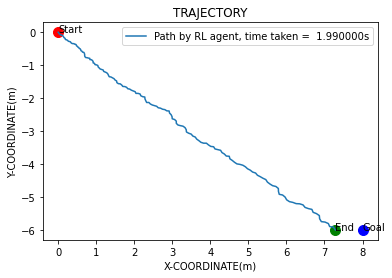

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 164      |
|    fps             | 520      |
|    time_elapsed    | 60       |
|    total_timesteps | 31513    |
---------------------------------
EP_REWARD:-30


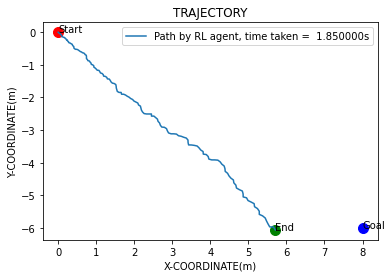

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 165      |
|    fps             | 522      |
|    time_elapsed    | 60       |
|    total_timesteps | 31698    |
---------------------------------
EP_REWARD:0


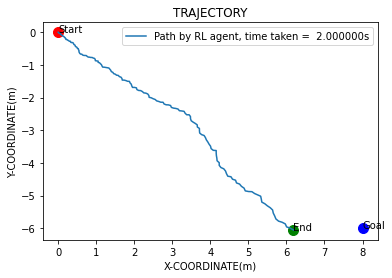

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 166      |
|    fps             | 523      |
|    time_elapsed    | 60       |
|    total_timesteps | 31898    |
---------------------------------
EP_REWARD:-40


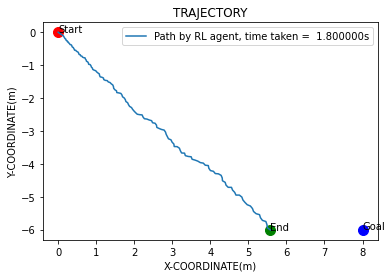

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 167      |
|    fps             | 524      |
|    time_elapsed    | 61       |
|    total_timesteps | 32078    |
---------------------------------
EP_REWARD:-42


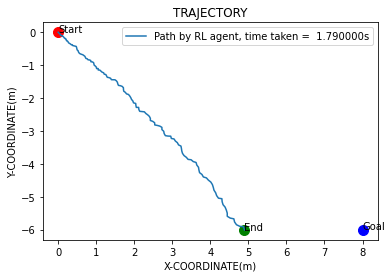

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 168      |
|    fps             | 524      |
|    time_elapsed    | 61       |
|    total_timesteps | 32257    |
---------------------------------
EP_REWARD:-0.11593547577414774


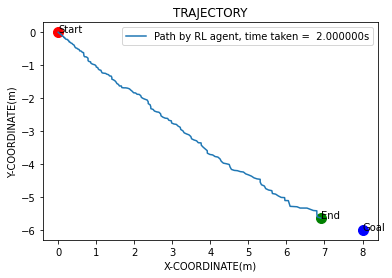

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 169      |
|    fps             | 525      |
|    time_elapsed    | 61       |
|    total_timesteps | 32457    |
---------------------------------
EP_REWARD:-6


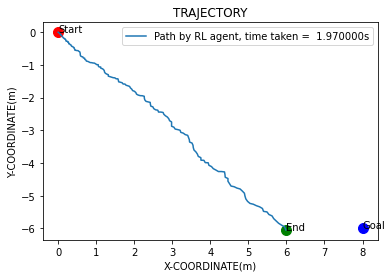

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 170      |
|    fps             | 526      |
|    time_elapsed    | 62       |
|    total_timesteps | 32654    |
---------------------------------
EP_REWARD:-22


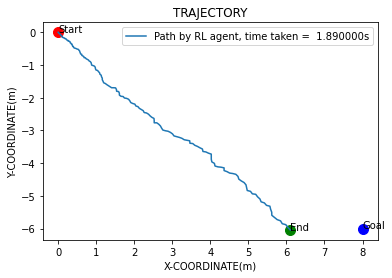

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 171      |
|    fps             | 526      |
|    time_elapsed    | 62       |
|    total_timesteps | 32843    |
---------------------------------
EP_REWARD:-34


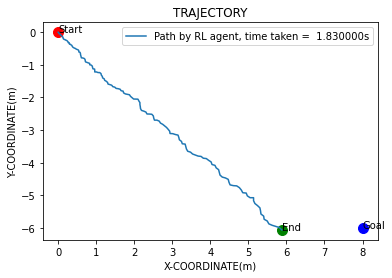

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 172      |
|    fps             | 526      |
|    time_elapsed    | 62       |
|    total_timesteps | 33026    |
---------------------------------
EP_REWARD:-16


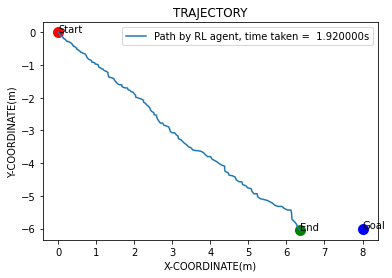

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 173      |
|    fps             | 526      |
|    time_elapsed    | 63       |
|    total_timesteps | 33218    |
---------------------------------
EP_REWARD:-6


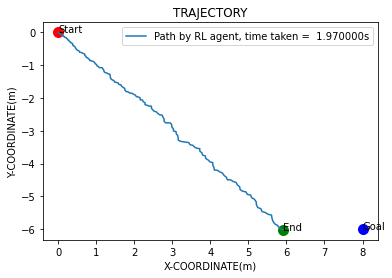

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 174      |
|    fps             | 526      |
|    time_elapsed    | 63       |
|    total_timesteps | 33415    |
---------------------------------
EP_REWARD:-16


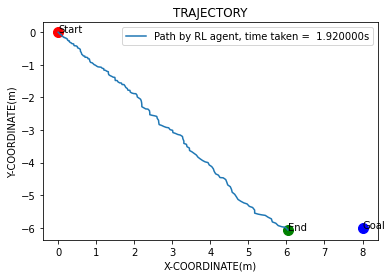

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 175      |
|    fps             | 527      |
|    time_elapsed    | 63       |
|    total_timesteps | 33607    |
---------------------------------
EP_REWARD:-20


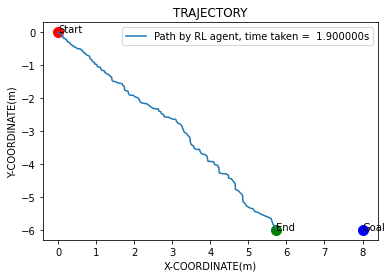

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 176      |
|    fps             | 527      |
|    time_elapsed    | 64       |
|    total_timesteps | 33797    |
---------------------------------
EP_REWARD:-8


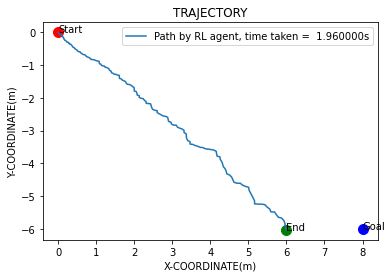

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 177      |
|    fps             | 528      |
|    time_elapsed    | 64       |
|    total_timesteps | 33993    |
---------------------------------
EP_REWARD:-28


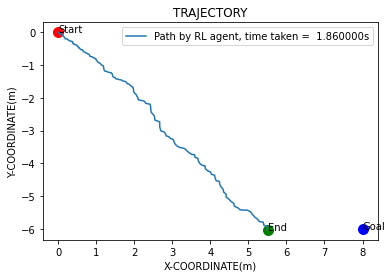

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 178      |
|    fps             | 528      |
|    time_elapsed    | 64       |
|    total_timesteps | 34179    |
---------------------------------
EP_REWARD:-18


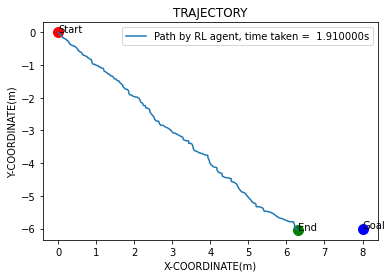

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 179      |
|    fps             | 528      |
|    time_elapsed    | 65       |
|    total_timesteps | 34370    |
---------------------------------
EP_REWARD:-4


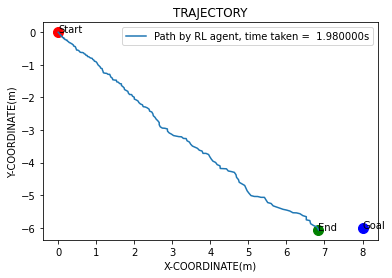

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 180      |
|    fps             | 528      |
|    time_elapsed    | 65       |
|    total_timesteps | 34568    |
---------------------------------
EP_REWARD:-18


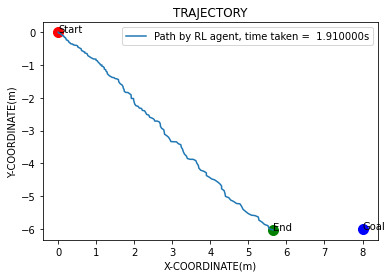

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 181      |
|    fps             | 529      |
|    time_elapsed    | 65       |
|    total_timesteps | 34759    |
---------------------------------
EP_REWARD:-22


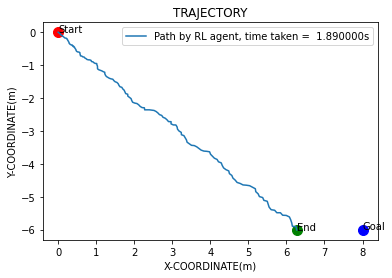

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 182      |
|    fps             | 530      |
|    time_elapsed    | 65       |
|    total_timesteps | 34948    |
---------------------------------
EP_REWARD:-0.936227146969301


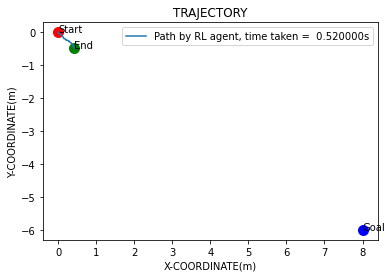

EP_REWARD:-148


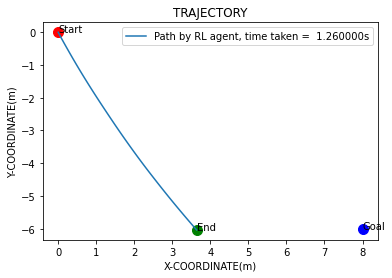

EP_REWARD:-148


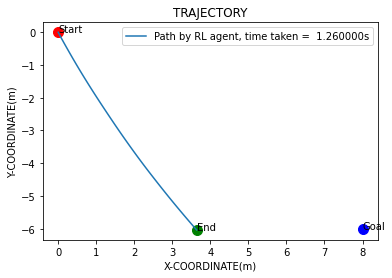

EP_REWARD:-148


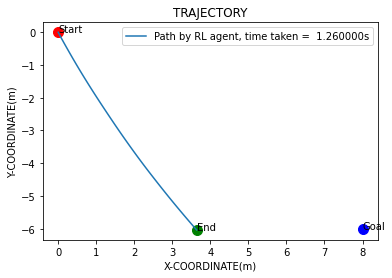

EP_REWARD:-148


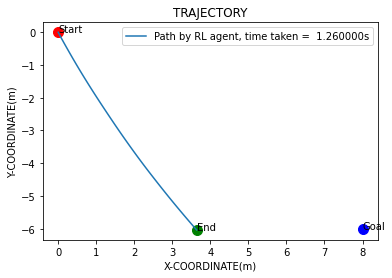

EP_REWARD:-148


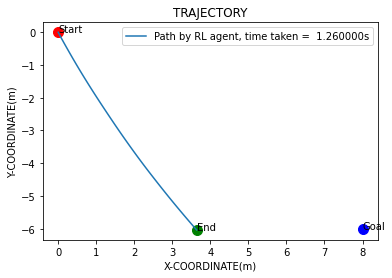

Eval num_timesteps=35000, episode_reward=-247.99 +/- 0.00
Episode length: 126.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 126      |
|    mean_reward     | -248     |
| time/              |          |
|    total_timesteps | 35000    |
---------------------------------
EP_REWARD:-18


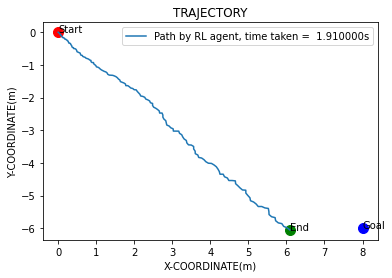

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 183      |
|    fps             | 519      |
|    time_elapsed    | 67       |
|    total_timesteps | 35191    |
---------------------------------
EP_REWARD:-48


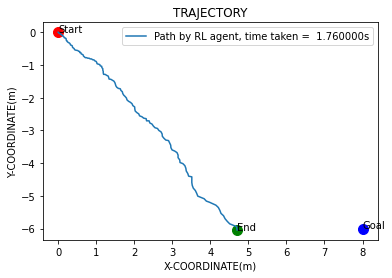

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 184      |
|    fps             | 520      |
|    time_elapsed    | 67       |
|    total_timesteps | 35367    |
---------------------------------
EP_REWARD:-24


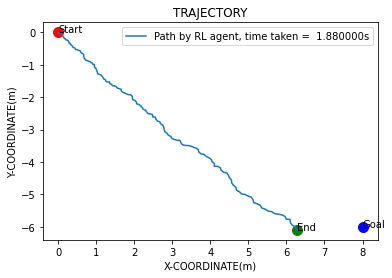

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 185      |
|    fps             | 520      |
|    time_elapsed    | 68       |
|    total_timesteps | 35555    |
---------------------------------
EP_REWARD:-34


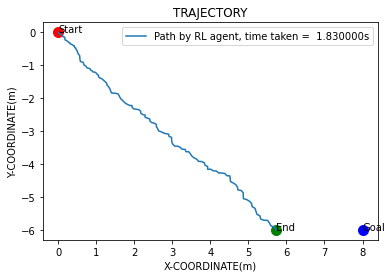

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 186      |
|    fps             | 521      |
|    time_elapsed    | 68       |
|    total_timesteps | 35738    |
---------------------------------
EP_REWARD:-38


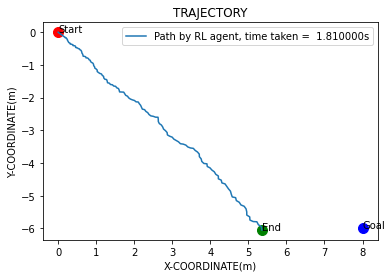

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 187      |
|    fps             | 522      |
|    time_elapsed    | 68       |
|    total_timesteps | 35919    |
---------------------------------
EP_REWARD:-20


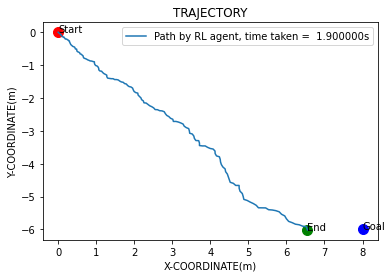

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 188      |
|    fps             | 523      |
|    time_elapsed    | 69       |
|    total_timesteps | 36109    |
---------------------------------
EP_REWARD:-10


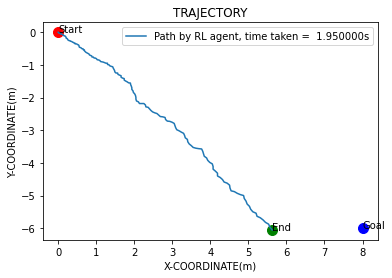

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 189      |
|    fps             | 523      |
|    time_elapsed    | 69       |
|    total_timesteps | 36304    |
---------------------------------
EP_REWARD:-18


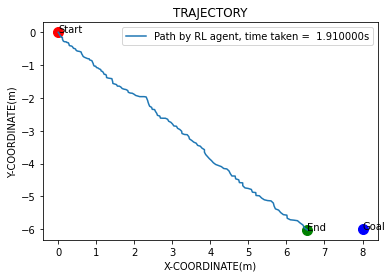

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 190      |
|    fps             | 524      |
|    time_elapsed    | 69       |
|    total_timesteps | 36495    |
---------------------------------
EP_REWARD:-18


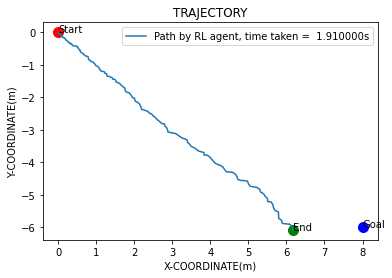

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 191      |
|    fps             | 524      |
|    time_elapsed    | 69       |
|    total_timesteps | 36686    |
---------------------------------
EP_REWARD:-2


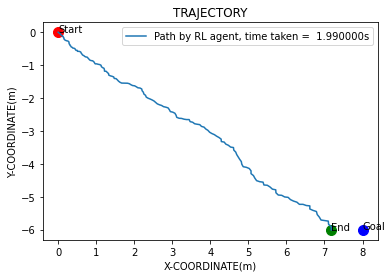

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 192      |
|    fps             | 525      |
|    time_elapsed    | 70       |
|    total_timesteps | 36885    |
---------------------------------
EP_REWARD:-38


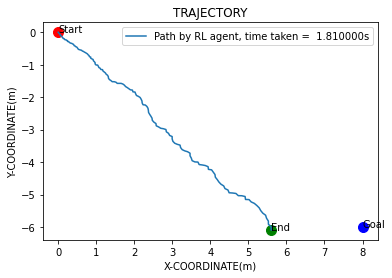

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 193      |
|    fps             | 524      |
|    time_elapsed    | 70       |
|    total_timesteps | 37066    |
---------------------------------
EP_REWARD:-36


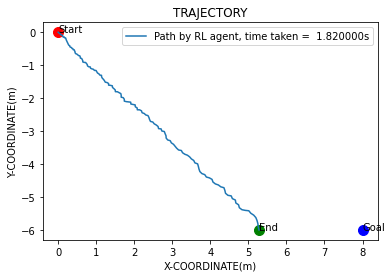

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 194      |
|    fps             | 525      |
|    time_elapsed    | 70       |
|    total_timesteps | 37248    |
---------------------------------
EP_REWARD:-38


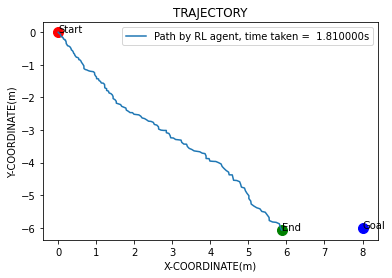

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 195      |
|    fps             | 526      |
|    time_elapsed    | 71       |
|    total_timesteps | 37429    |
---------------------------------
EP_REWARD:-20


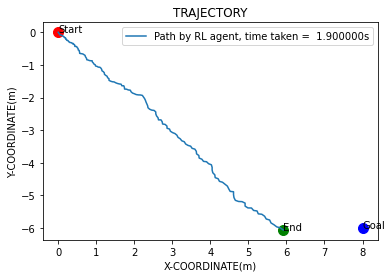

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 196      |
|    fps             | 526      |
|    time_elapsed    | 71       |
|    total_timesteps | 37619    |
---------------------------------
EP_REWARD:-26


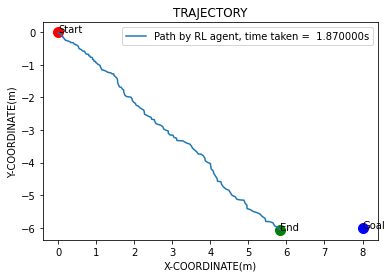

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 197      |
|    fps             | 527      |
|    time_elapsed    | 71       |
|    total_timesteps | 37806    |
---------------------------------
EP_REWARD:-40


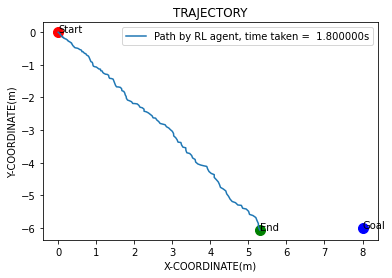

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -159     |
| time/              |          |
|    episodes        | 198      |
|    fps             | 528      |
|    time_elapsed    | 71       |
|    total_timesteps | 37986    |
---------------------------------
EP_REWARD:-26


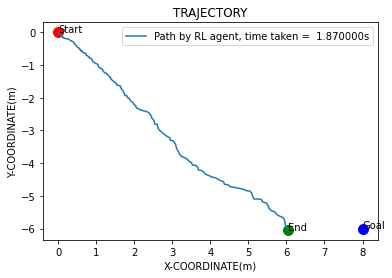

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -159     |
| time/              |          |
|    episodes        | 199      |
|    fps             | 528      |
|    time_elapsed    | 72       |
|    total_timesteps | 38173    |
---------------------------------
EP_REWARD:-32


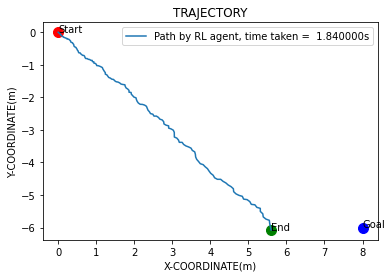

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -159     |
| time/              |          |
|    episodes        | 200      |
|    fps             | 529      |
|    time_elapsed    | 72       |
|    total_timesteps | 38357    |
---------------------------------
EP_REWARD:-26


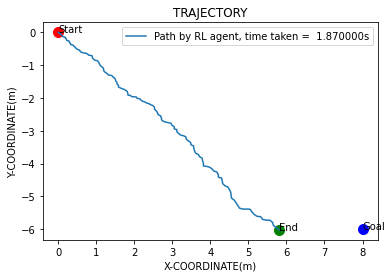

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -159     |
| time/              |          |
|    episodes        | 201      |
|    fps             | 530      |
|    time_elapsed    | 72       |
|    total_timesteps | 38544    |
---------------------------------
EP_REWARD:-8


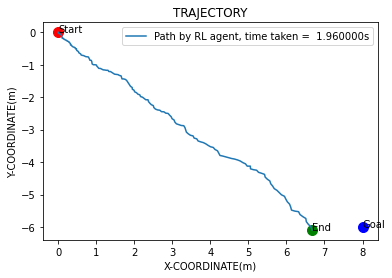

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 202      |
|    fps             | 530      |
|    time_elapsed    | 72       |
|    total_timesteps | 38740    |
---------------------------------
EP_REWARD:-6


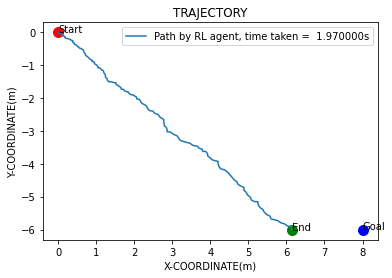

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 203      |
|    fps             | 531      |
|    time_elapsed    | 73       |
|    total_timesteps | 38937    |
---------------------------------
EP_REWARD:-38


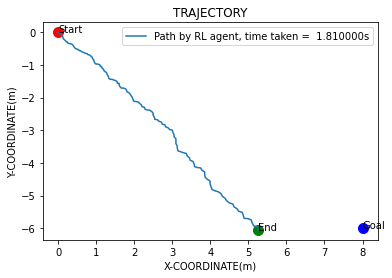

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 204      |
|    fps             | 532      |
|    time_elapsed    | 73       |
|    total_timesteps | 39118    |
---------------------------------
EP_REWARD:-36


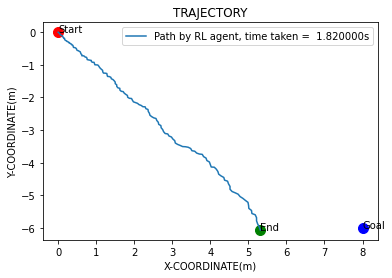

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 205      |
|    fps             | 532      |
|    time_elapsed    | 73       |
|    total_timesteps | 39300    |
---------------------------------
EP_REWARD:-52


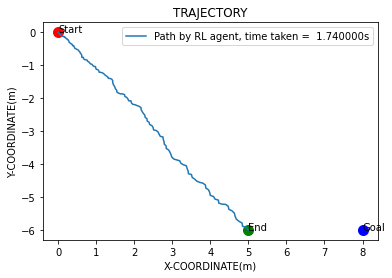

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 206      |
|    fps             | 533      |
|    time_elapsed    | 74       |
|    total_timesteps | 39474    |
---------------------------------
EP_REWARD:-22


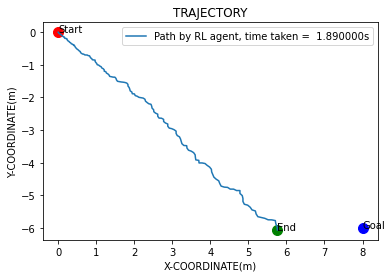

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 207      |
|    fps             | 533      |
|    time_elapsed    | 74       |
|    total_timesteps | 39663    |
---------------------------------
EP_REWARD:-12


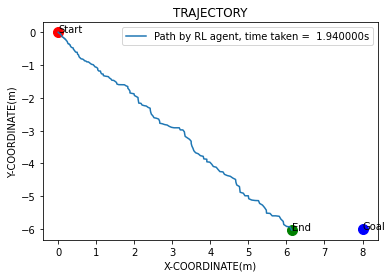

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 208      |
|    fps             | 533      |
|    time_elapsed    | 74       |
|    total_timesteps | 39857    |
---------------------------------
EP_REWARD:-0.5600510288629306


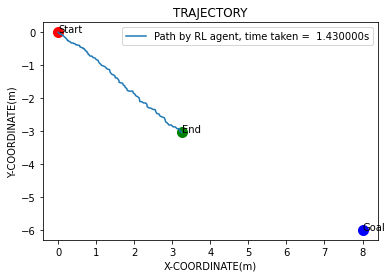

EP_REWARD:-148


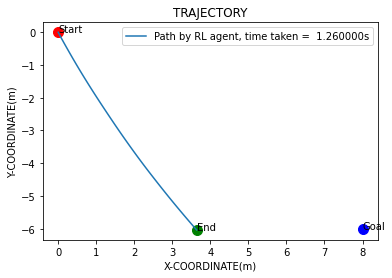

EP_REWARD:-148


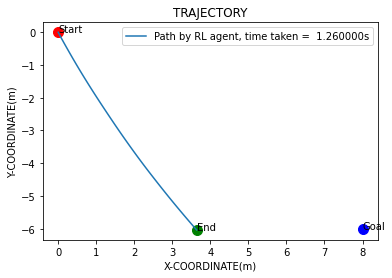

EP_REWARD:-148


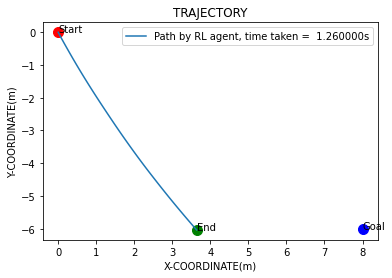

EP_REWARD:-148


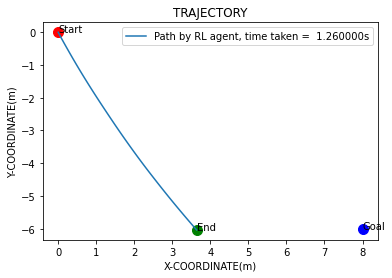

EP_REWARD:-148


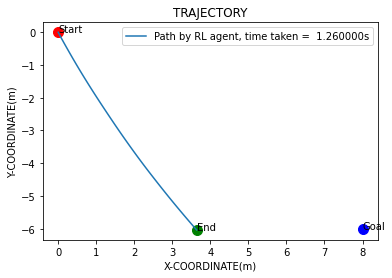

Eval num_timesteps=40000, episode_reward=-247.99 +/- 0.00
Episode length: 126.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 126      |
|    mean_reward     | -248     |
| time/              |          |
|    total_timesteps | 40000    |
---------------------------------
EP_REWARD:-6


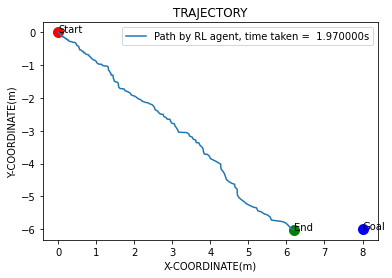

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 209      |
|    fps             | 524      |
|    time_elapsed    | 76       |
|    total_timesteps | 40197    |
---------------------------------
EP_REWARD:-6


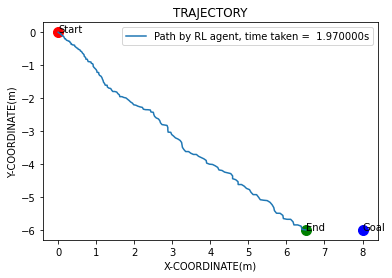

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 210      |
|    fps             | 525      |
|    time_elapsed    | 76       |
|    total_timesteps | 40394    |
---------------------------------
EP_REWARD:-56


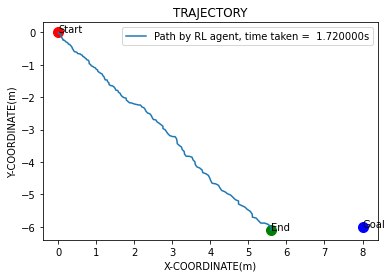

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -159     |
| time/              |          |
|    episodes        | 211      |
|    fps             | 526      |
|    time_elapsed    | 77       |
|    total_timesteps | 40566    |
---------------------------------
EP_REWARD:-24


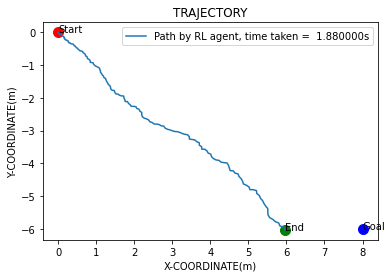

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -159     |
| time/              |          |
|    episodes        | 212      |
|    fps             | 527      |
|    time_elapsed    | 77       |
|    total_timesteps | 40754    |
---------------------------------
EP_REWARD:-8


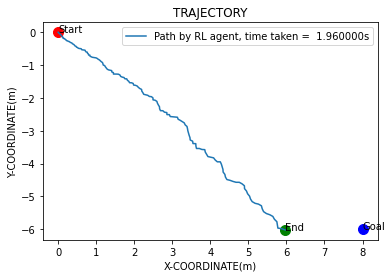

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 213      |
|    fps             | 527      |
|    time_elapsed    | 77       |
|    total_timesteps | 40950    |
---------------------------------
EP_REWARD:-2


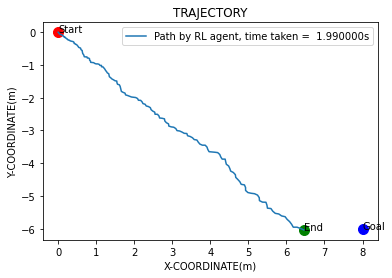

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 214      |
|    fps             | 528      |
|    time_elapsed    | 77       |
|    total_timesteps | 41149    |
---------------------------------
EP_REWARD:-8


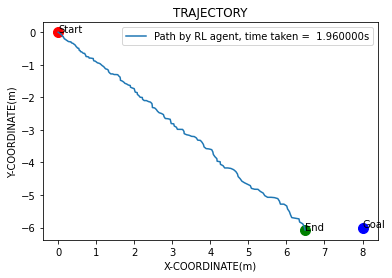

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 215      |
|    fps             | 529      |
|    time_elapsed    | 78       |
|    total_timesteps | 41345    |
---------------------------------
EP_REWARD:-0.2314688699416939


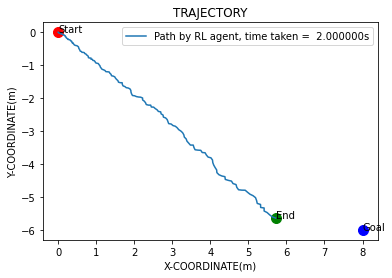

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 216      |
|    fps             | 530      |
|    time_elapsed    | 78       |
|    total_timesteps | 41545    |
---------------------------------
EP_REWARD:-16


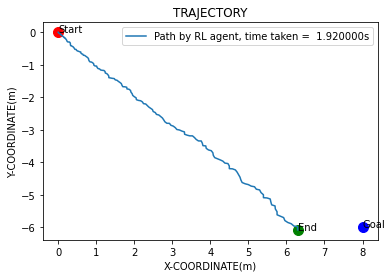

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 217      |
|    fps             | 531      |
|    time_elapsed    | 78       |
|    total_timesteps | 41737    |
---------------------------------
EP_REWARD:-24


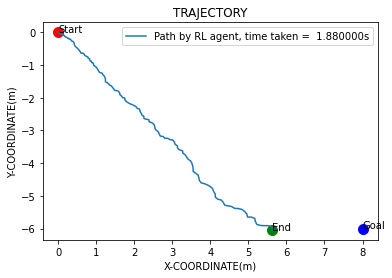

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 218      |
|    fps             | 532      |
|    time_elapsed    | 78       |
|    total_timesteps | 41925    |
---------------------------------
EP_REWARD:-32


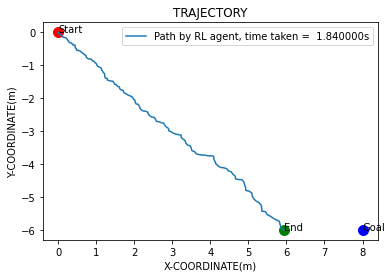

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 219      |
|    fps             | 532      |
|    time_elapsed    | 79       |
|    total_timesteps | 42109    |
---------------------------------
EP_REWARD:-46


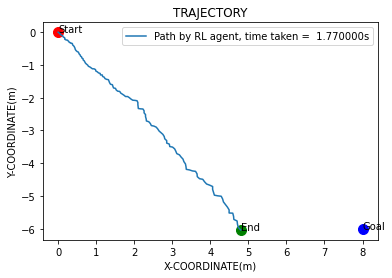

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 220      |
|    fps             | 532      |
|    time_elapsed    | 79       |
|    total_timesteps | 42286    |
---------------------------------
EP_REWARD:-32


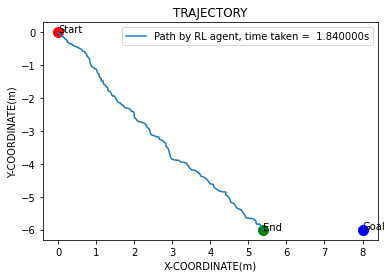

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 221      |
|    fps             | 533      |
|    time_elapsed    | 79       |
|    total_timesteps | 42470    |
---------------------------------
EP_REWARD:-20


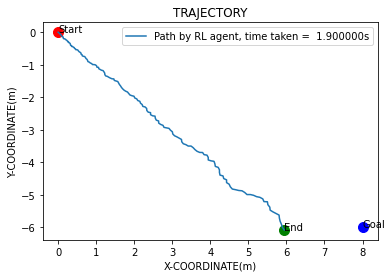

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 222      |
|    fps             | 533      |
|    time_elapsed    | 79       |
|    total_timesteps | 42660    |
---------------------------------
EP_REWARD:-48


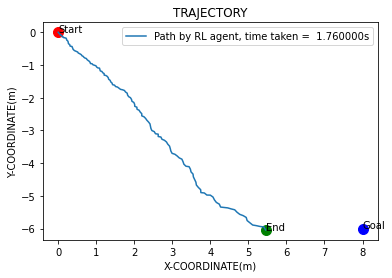

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -159     |
| time/              |          |
|    episodes        | 223      |
|    fps             | 534      |
|    time_elapsed    | 80       |
|    total_timesteps | 42836    |
---------------------------------
EP_REWARD:-20


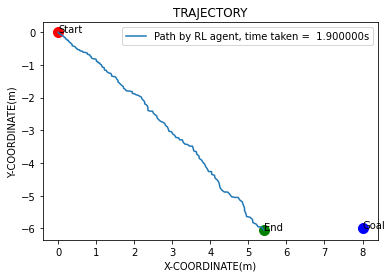

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -159     |
| time/              |          |
|    episodes        | 224      |
|    fps             | 535      |
|    time_elapsed    | 80       |
|    total_timesteps | 43026    |
---------------------------------
EP_REWARD:-28


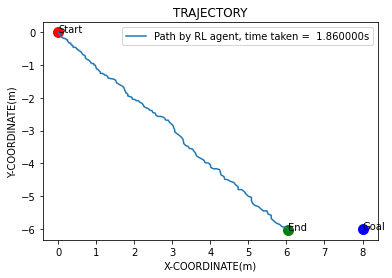

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 225      |
|    fps             | 536      |
|    time_elapsed    | 80       |
|    total_timesteps | 43212    |
---------------------------------
EP_REWARD:-24


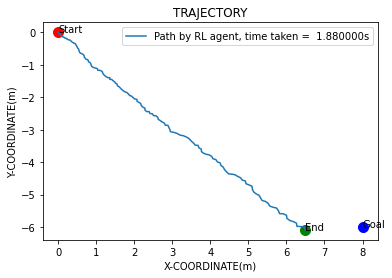

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 226      |
|    fps             | 536      |
|    time_elapsed    | 80       |
|    total_timesteps | 43400    |
---------------------------------
EP_REWARD:-38


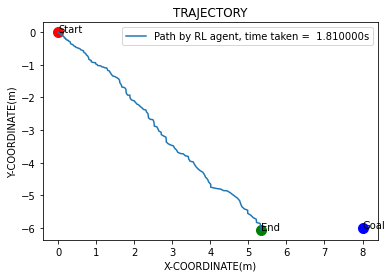

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -159     |
| time/              |          |
|    episodes        | 227      |
|    fps             | 536      |
|    time_elapsed    | 81       |
|    total_timesteps | 43581    |
---------------------------------
EP_REWARD:-20


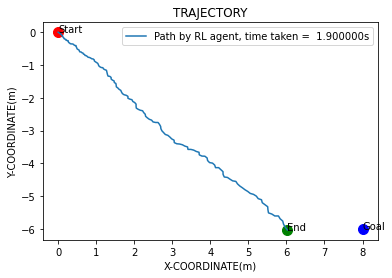

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 228      |
|    fps             | 537      |
|    time_elapsed    | 81       |
|    total_timesteps | 43771    |
---------------------------------
EP_REWARD:-26


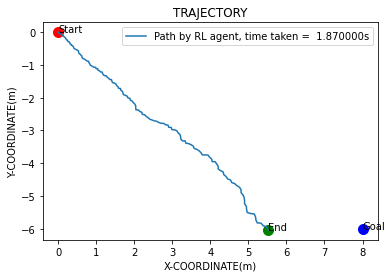

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -159     |
| time/              |          |
|    episodes        | 229      |
|    fps             | 537      |
|    time_elapsed    | 81       |
|    total_timesteps | 43958    |
---------------------------------
EP_REWARD:-44


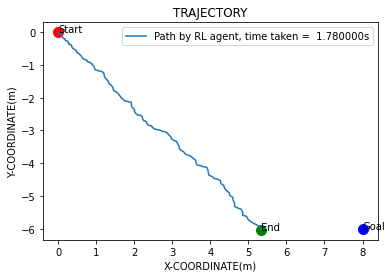

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -159     |
| time/              |          |
|    episodes        | 230      |
|    fps             | 536      |
|    time_elapsed    | 82       |
|    total_timesteps | 44136    |
---------------------------------
EP_REWARD:-38


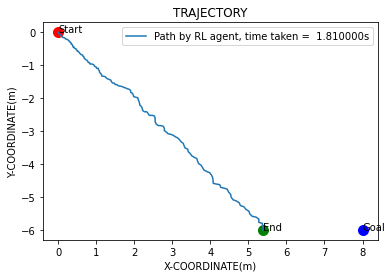

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 188      |
|    ep_rew_mean     | -159     |
| time/              |          |
|    episodes        | 231      |
|    fps             | 536      |
|    time_elapsed    | 82       |
|    total_timesteps | 44317    |
---------------------------------
EP_REWARD:-20


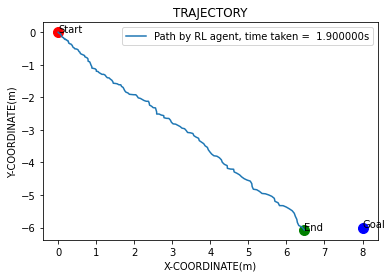

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 188      |
|    ep_rew_mean     | -159     |
| time/              |          |
|    episodes        | 232      |
|    fps             | 536      |
|    time_elapsed    | 82       |
|    total_timesteps | 44507    |
---------------------------------
EP_REWARD:-40


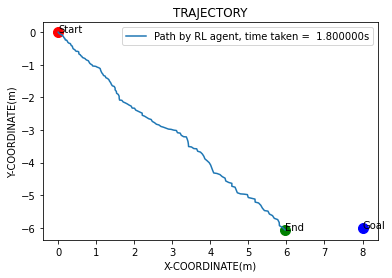

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 188      |
|    ep_rew_mean     | -159     |
| time/              |          |
|    episodes        | 233      |
|    fps             | 537      |
|    time_elapsed    | 83       |
|    total_timesteps | 44687    |
---------------------------------
EP_REWARD:-42


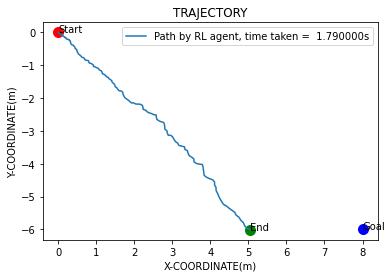

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 188      |
|    ep_rew_mean     | -159     |
| time/              |          |
|    episodes        | 234      |
|    fps             | 538      |
|    time_elapsed    | 83       |
|    total_timesteps | 44866    |
---------------------------------
EP_REWARD:-0.5755715684766556


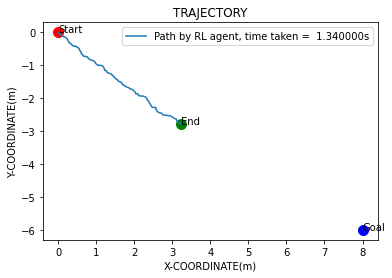

EP_REWARD:-148


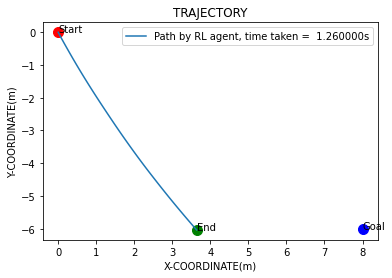

EP_REWARD:-148


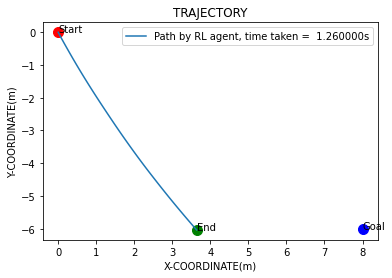

EP_REWARD:-148


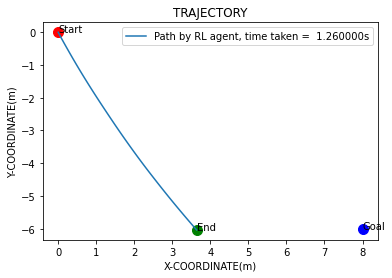

EP_REWARD:-148


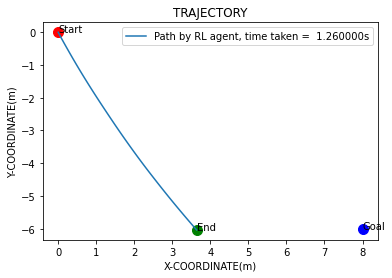

EP_REWARD:-148


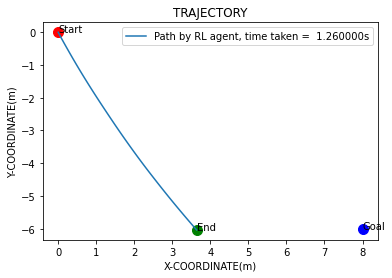

Eval num_timesteps=45000, episode_reward=-247.99 +/- 0.00
Episode length: 126.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 126      |
|    mean_reward     | -248     |
| time/              |          |
|    total_timesteps | 45000    |
---------------------------------
EP_REWARD:-22


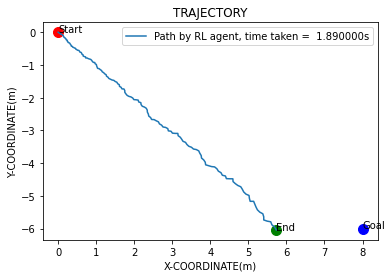

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 188      |
|    ep_rew_mean     | -159     |
| time/              |          |
|    episodes        | 235      |
|    fps             | 530      |
|    time_elapsed    | 85       |
|    total_timesteps | 45189    |
---------------------------------
EP_REWARD:-22


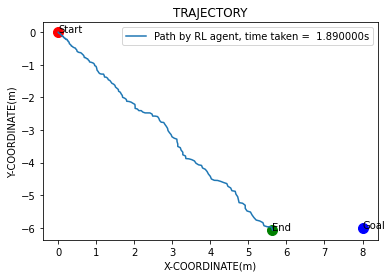

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 188      |
|    ep_rew_mean     | -159     |
| time/              |          |
|    episodes        | 236      |
|    fps             | 531      |
|    time_elapsed    | 85       |
|    total_timesteps | 45378    |
---------------------------------
EP_REWARD:-16


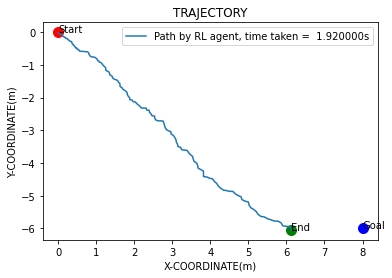

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 188      |
|    ep_rew_mean     | -159     |
| time/              |          |
|    episodes        | 237      |
|    fps             | 530      |
|    time_elapsed    | 85       |
|    total_timesteps | 45570    |
---------------------------------
EP_REWARD:-24


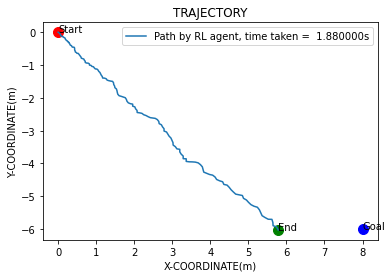

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 188      |
|    ep_rew_mean     | -159     |
| time/              |          |
|    episodes        | 238      |
|    fps             | 531      |
|    time_elapsed    | 86       |
|    total_timesteps | 45758    |
---------------------------------
EP_REWARD:-36


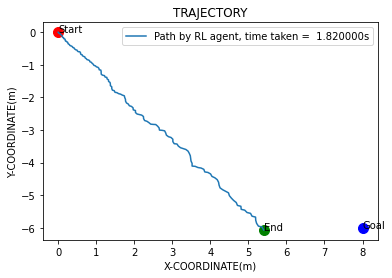

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 188      |
|    ep_rew_mean     | -160     |
| time/              |          |
|    episodes        | 239      |
|    fps             | 531      |
|    time_elapsed    | 86       |
|    total_timesteps | 45940    |
---------------------------------
EP_REWARD:-32


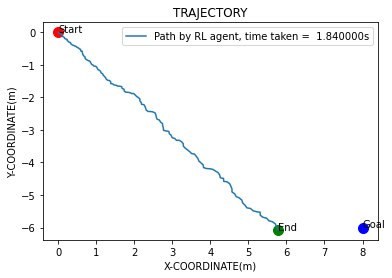

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 188      |
|    ep_rew_mean     | -160     |
| time/              |          |
|    episodes        | 240      |
|    fps             | 532      |
|    time_elapsed    | 86       |
|    total_timesteps | 46124    |
---------------------------------
EP_REWARD:-12


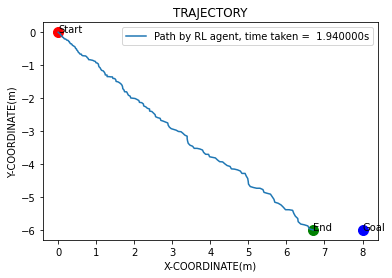

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 188      |
|    ep_rew_mean     | -160     |
| time/              |          |
|    episodes        | 241      |
|    fps             | 533      |
|    time_elapsed    | 86       |
|    total_timesteps | 46318    |
---------------------------------
EP_REWARD:-0.13935008949596692


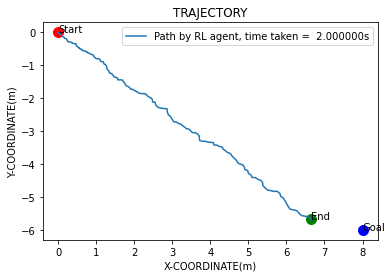

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 188      |
|    ep_rew_mean     | -159     |
| time/              |          |
|    episodes        | 242      |
|    fps             | 534      |
|    time_elapsed    | 87       |
|    total_timesteps | 46518    |
---------------------------------
EP_REWARD:-28


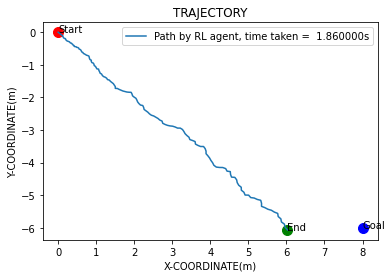

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 188      |
|    ep_rew_mean     | -159     |
| time/              |          |
|    episodes        | 243      |
|    fps             | 534      |
|    time_elapsed    | 87       |
|    total_timesteps | 46704    |
---------------------------------
EP_REWARD:-28


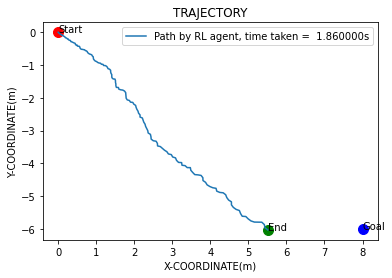

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 188      |
|    ep_rew_mean     | -159     |
| time/              |          |
|    episodes        | 244      |
|    fps             | 535      |
|    time_elapsed    | 87       |
|    total_timesteps | 46890    |
---------------------------------
EP_REWARD:-22


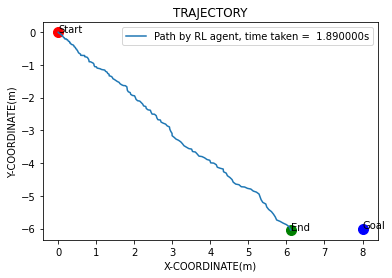

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 188      |
|    ep_rew_mean     | -159     |
| time/              |          |
|    episodes        | 245      |
|    fps             | 535      |
|    time_elapsed    | 87       |
|    total_timesteps | 47079    |
---------------------------------
EP_REWARD:-46


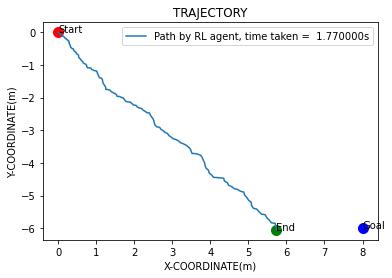

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 188      |
|    ep_rew_mean     | -160     |
| time/              |          |
|    episodes        | 246      |
|    fps             | 535      |
|    time_elapsed    | 88       |
|    total_timesteps | 47256    |
---------------------------------
EP_REWARD:-28


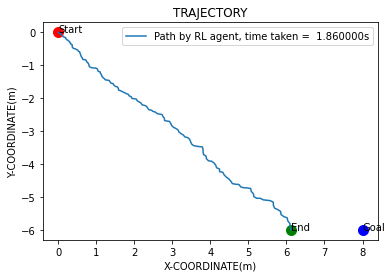

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 188      |
|    ep_rew_mean     | -160     |
| time/              |          |
|    episodes        | 247      |
|    fps             | 535      |
|    time_elapsed    | 88       |
|    total_timesteps | 47442    |
---------------------------------
EP_REWARD:-16


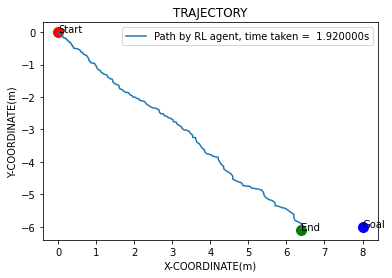

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 188      |
|    ep_rew_mean     | -159     |
| time/              |          |
|    episodes        | 248      |
|    fps             | 536      |
|    time_elapsed    | 88       |
|    total_timesteps | 47634    |
---------------------------------
EP_REWARD:-20


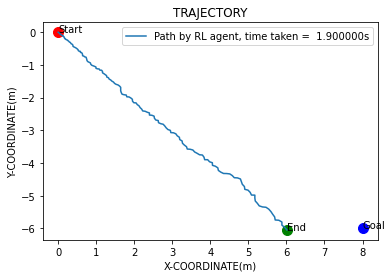

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 188      |
|    ep_rew_mean     | -159     |
| time/              |          |
|    episodes        | 249      |
|    fps             | 537      |
|    time_elapsed    | 89       |
|    total_timesteps | 47824    |
---------------------------------
EP_REWARD:-14


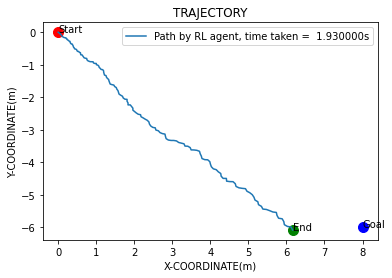

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 188      |
|    ep_rew_mean     | -159     |
| time/              |          |
|    episodes        | 250      |
|    fps             | 537      |
|    time_elapsed    | 89       |
|    total_timesteps | 48017    |
---------------------------------
EP_REWARD:-56


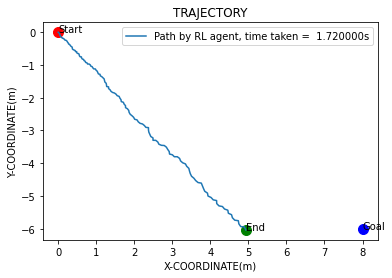

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 188      |
|    ep_rew_mean     | -159     |
| time/              |          |
|    episodes        | 251      |
|    fps             | 537      |
|    time_elapsed    | 89       |
|    total_timesteps | 48189    |
---------------------------------
EP_REWARD:-16


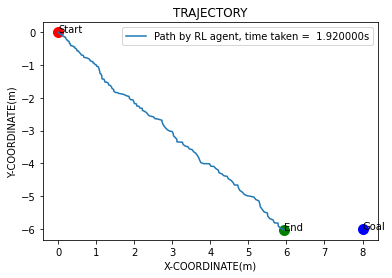

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 188      |
|    ep_rew_mean     | -159     |
| time/              |          |
|    episodes        | 252      |
|    fps             | 538      |
|    time_elapsed    | 89       |
|    total_timesteps | 48381    |
---------------------------------
EP_REWARD:-2


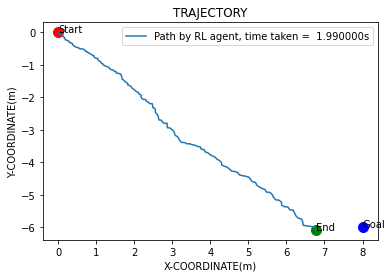

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 188      |
|    ep_rew_mean     | -159     |
| time/              |          |
|    episodes        | 253      |
|    fps             | 538      |
|    time_elapsed    | 90       |
|    total_timesteps | 48580    |
---------------------------------
EP_REWARD:-24


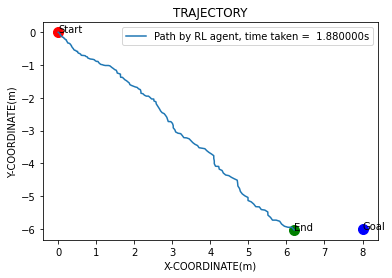

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 188      |
|    ep_rew_mean     | -159     |
| time/              |          |
|    episodes        | 254      |
|    fps             | 539      |
|    time_elapsed    | 90       |
|    total_timesteps | 48768    |
---------------------------------
EP_REWARD:-46


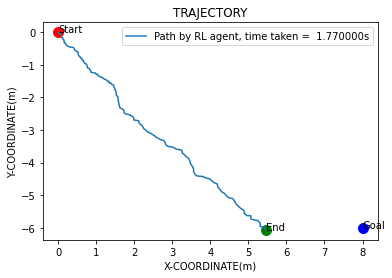

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 188      |
|    ep_rew_mean     | -160     |
| time/              |          |
|    episodes        | 255      |
|    fps             | 539      |
|    time_elapsed    | 90       |
|    total_timesteps | 48945    |
---------------------------------
EP_REWARD:-36


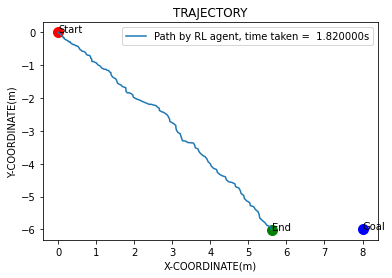

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 188      |
|    ep_rew_mean     | -160     |
| time/              |          |
|    episodes        | 256      |
|    fps             | 538      |
|    time_elapsed    | 91       |
|    total_timesteps | 49127    |
---------------------------------
EP_REWARD:-12


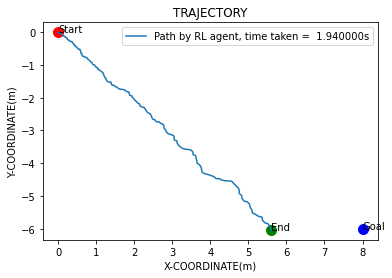

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 188      |
|    ep_rew_mean     | -160     |
| time/              |          |
|    episodes        | 257      |
|    fps             | 539      |
|    time_elapsed    | 91       |
|    total_timesteps | 49321    |
---------------------------------
EP_REWARD:-16


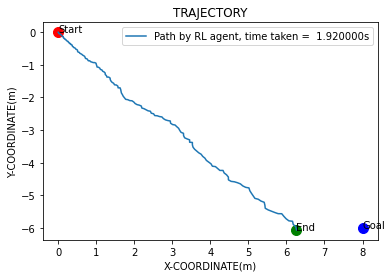

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 188      |
|    ep_rew_mean     | -160     |
| time/              |          |
|    episodes        | 258      |
|    fps             | 540      |
|    time_elapsed    | 91       |
|    total_timesteps | 49513    |
---------------------------------
EP_REWARD:-28


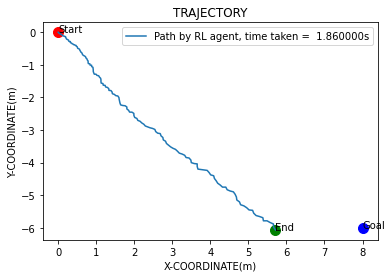

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 188      |
|    ep_rew_mean     | -160     |
| time/              |          |
|    episodes        | 259      |
|    fps             | 540      |
|    time_elapsed    | 91       |
|    total_timesteps | 49699    |
---------------------------------
EP_REWARD:-32


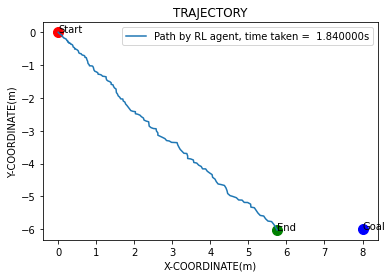

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 188      |
|    ep_rew_mean     | -160     |
| time/              |          |
|    episodes        | 260      |
|    fps             | 541      |
|    time_elapsed    | 92       |
|    total_timesteps | 49883    |
---------------------------------
EP_REWARD:-0.6702978456827341


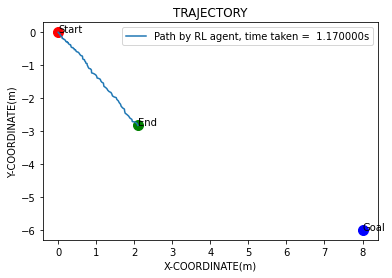

EP_REWARD:-148


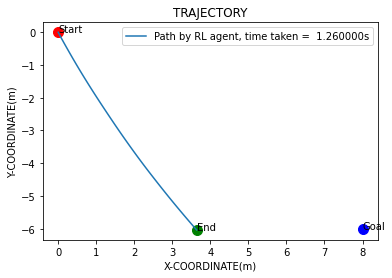

EP_REWARD:-148


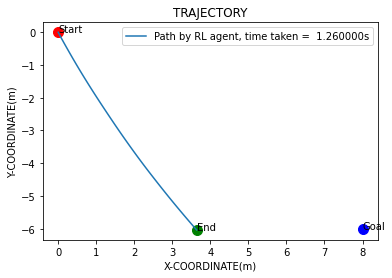

EP_REWARD:-148


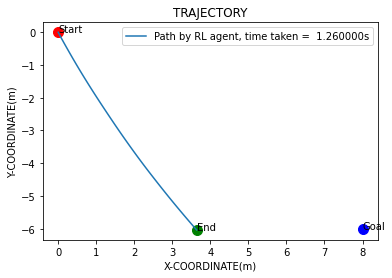

EP_REWARD:-148


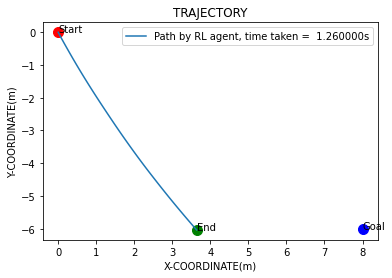

EP_REWARD:-148


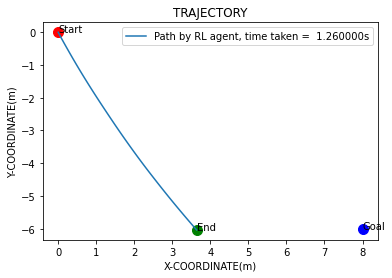

Eval num_timesteps=50000, episode_reward=-247.99 +/- 0.00
Episode length: 126.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 126      |
|    mean_reward     | -248     |
| time/              |          |
|    total_timesteps | 50000    |
---------------------------------
EP_REWARD:-146


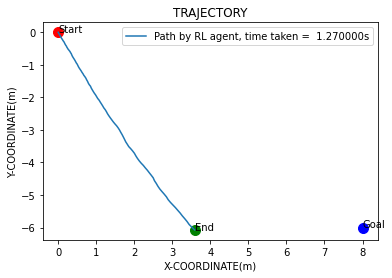

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 187      |
|    ep_rew_mean     | -161     |
| time/              |          |
|    episodes        | 261      |
|    fps             | 533      |
|    time_elapsed    | 93       |
|    total_timesteps | 50127    |
---------------------------------
EP_REWARD:-180


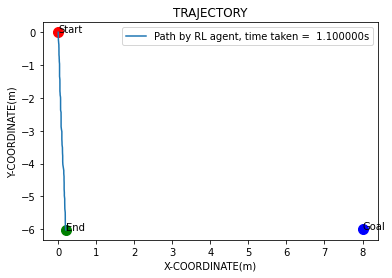

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 187      |
|    ep_rew_mean     | -162     |
| time/              |          |
|    episodes        | 262      |
|    fps             | 512      |
|    time_elapsed    | 98       |
|    total_timesteps | 50237    |
| train/             |          |
|    actor_loss      | 0.385    |
|    critic_loss     | 4.83     |
|    learning_rate   | 0.001    |
|    n_updates       | 244      |
---------------------------------
EP_REWARD:-180


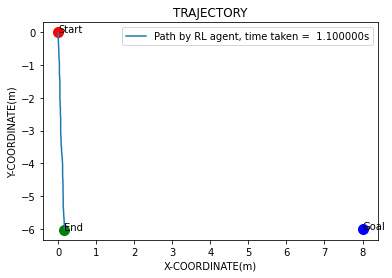

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 186      |
|    ep_rew_mean     | -163     |
| time/              |          |
|    episodes        | 263      |
|    fps             | 503      |
|    time_elapsed    | 99       |
|    total_timesteps | 50347    |
| train/             |          |
|    actor_loss      | 0.739    |
|    critic_loss     | 3.9      |
|    learning_rate   | 0.001    |
|    n_updates       | 354      |
---------------------------------
EP_REWARD:-180


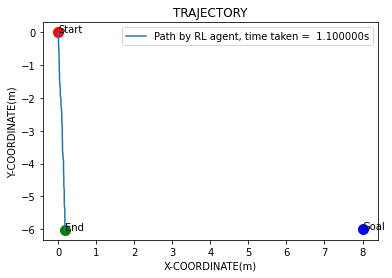

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 185      |
|    ep_rew_mean     | -164     |
| time/              |          |
|    episodes        | 264      |
|    fps             | 494      |
|    time_elapsed    | 101      |
|    total_timesteps | 50457    |
| train/             |          |
|    actor_loss      | 1.3      |
|    critic_loss     | 6.29     |
|    learning_rate   | 0.001    |
|    n_updates       | 464      |
---------------------------------
EP_REWARD:-162


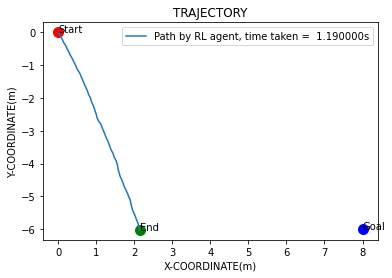

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 184      |
|    ep_rew_mean     | -165     |
| time/              |          |
|    episodes        | 265      |
|    fps             | 486      |
|    time_elapsed    | 103      |
|    total_timesteps | 50576    |
| train/             |          |
|    actor_loss      | 1.53     |
|    critic_loss     | 5.78     |
|    learning_rate   | 0.001    |
|    n_updates       | 574      |
---------------------------------
EP_REWARD:-114


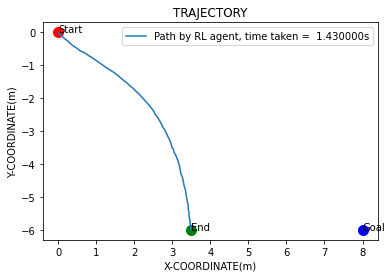

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 184      |
|    ep_rew_mean     | -166     |
| time/              |          |
|    episodes        | 266      |
|    fps             | 477      |
|    time_elapsed    | 106      |
|    total_timesteps | 50719    |
| train/             |          |
|    actor_loss      | 1.71     |
|    critic_loss     | 7.08     |
|    learning_rate   | 0.001    |
|    n_updates       | 693      |
---------------------------------
EP_REWARD:-64


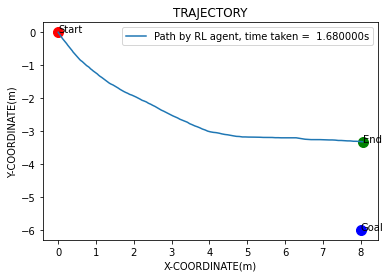

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 184      |
|    ep_rew_mean     | -166     |
| time/              |          |
|    episodes        | 267      |
|    fps             | 465      |
|    time_elapsed    | 109      |
|    total_timesteps | 50887    |
| train/             |          |
|    actor_loss      | 1.89     |
|    critic_loss     | 6.77     |
|    learning_rate   | 0.001    |
|    n_updates       | 836      |
---------------------------------
EP_REWARD:-62


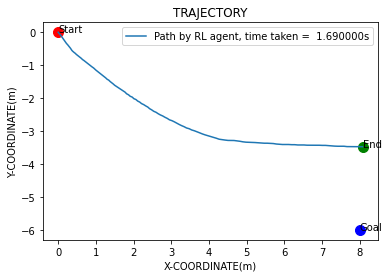

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 184      |
|    ep_rew_mean     | -166     |
| time/              |          |
|    episodes        | 268      |
|    fps             | 452      |
|    time_elapsed    | 112      |
|    total_timesteps | 51056    |
| train/             |          |
|    actor_loss      | 2.19     |
|    critic_loss     | 6.65     |
|    learning_rate   | 0.001    |
|    n_updates       | 1004     |
---------------------------------
EP_REWARD:-64


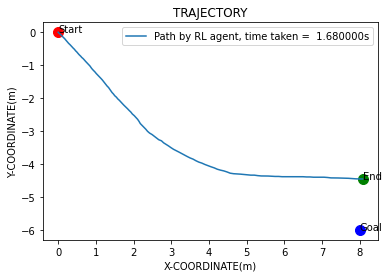

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 183      |
|    ep_rew_mean     | -167     |
| time/              |          |
|    episodes        | 269      |
|    fps             | 438      |
|    time_elapsed    | 116      |
|    total_timesteps | 51224    |
| train/             |          |
|    actor_loss      | 2.49     |
|    critic_loss     | 4.68     |
|    learning_rate   | 0.001    |
|    n_updates       | 1173     |
---------------------------------
EP_REWARD:-50


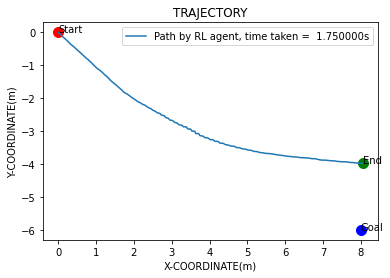

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 183      |
|    ep_rew_mean     | -167     |
| time/              |          |
|    episodes        | 270      |
|    fps             | 425      |
|    time_elapsed    | 120      |
|    total_timesteps | 51399    |
| train/             |          |
|    actor_loss      | 2.83     |
|    critic_loss     | 4.8      |
|    learning_rate   | 0.001    |
|    n_updates       | 1341     |
---------------------------------
EP_REWARD:-58


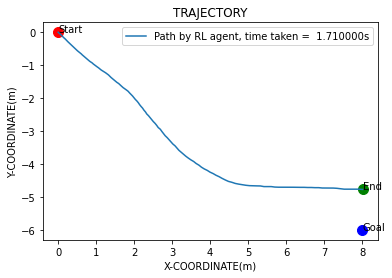

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 183      |
|    ep_rew_mean     | -167     |
| time/              |          |
|    episodes        | 271      |
|    fps             | 412      |
|    time_elapsed    | 124      |
|    total_timesteps | 51570    |
| train/             |          |
|    actor_loss      | 3.28     |
|    critic_loss     | 4.04     |
|    learning_rate   | 0.001    |
|    n_updates       | 1516     |
---------------------------------
EP_REWARD:2.5


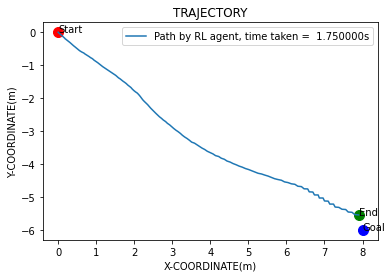

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 183      |
|    ep_rew_mean     | -166     |
| time/              |          |
|    episodes        | 272      |
|    fps             | 401      |
|    time_elapsed    | 128      |
|    total_timesteps | 51745    |
| train/             |          |
|    actor_loss      | 3.8      |
|    critic_loss     | 4.8      |
|    learning_rate   | 0.001    |
|    n_updates       | 1687     |
---------------------------------
EP_REWARD:2.2


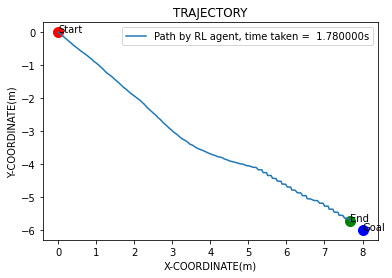

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 183      |
|    ep_rew_mean     | -166     |
| time/              |          |
|    episodes        | 273      |
|    fps             | 389      |
|    time_elapsed    | 133      |
|    total_timesteps | 51923    |
| train/             |          |
|    actor_loss      | 4.23     |
|    critic_loss     | 4.33     |
|    learning_rate   | 0.001    |
|    n_updates       | 1862     |
---------------------------------
EP_REWARD:-46


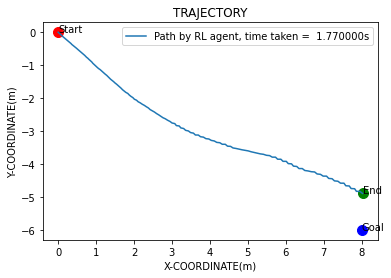

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 182      |
|    ep_rew_mean     | -166     |
| time/              |          |
|    episodes        | 274      |
|    fps             | 379      |
|    time_elapsed    | 137      |
|    total_timesteps | 52100    |
| train/             |          |
|    actor_loss      | 4.59     |
|    critic_loss     | 7.11     |
|    learning_rate   | 0.001    |
|    n_updates       | 2040     |
---------------------------------
EP_REWARD:3.4000000000000004


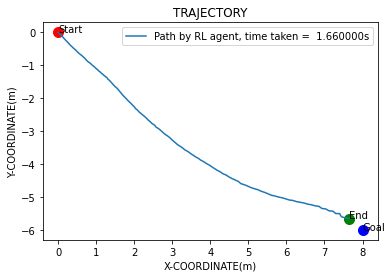

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 182      |
|    ep_rew_mean     | -166     |
| time/              |          |
|    episodes        | 275      |
|    fps             | 369      |
|    time_elapsed    | 141      |
|    total_timesteps | 52266    |
| train/             |          |
|    actor_loss      | 4.89     |
|    critic_loss     | 5.6      |
|    learning_rate   | 0.001    |
|    n_updates       | 2217     |
---------------------------------
EP_REWARD:-58


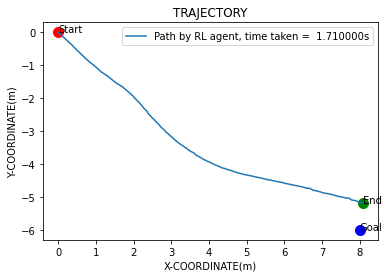

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 182      |
|    ep_rew_mean     | -166     |
| time/              |          |
|    episodes        | 276      |
|    fps             | 360      |
|    time_elapsed    | 145      |
|    total_timesteps | 52437    |
| train/             |          |
|    actor_loss      | 5.34     |
|    critic_loss     | 3.91     |
|    learning_rate   | 0.001    |
|    n_updates       | 2383     |
---------------------------------
EP_REWARD:2.7


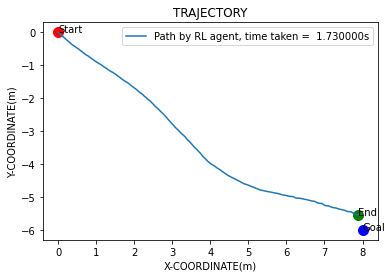

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 182      |
|    ep_rew_mean     | -165     |
| time/              |          |
|    episodes        | 277      |
|    fps             | 351      |
|    time_elapsed    | 149      |
|    total_timesteps | 52610    |
| train/             |          |
|    actor_loss      | 5.78     |
|    critic_loss     | 2.11     |
|    learning_rate   | 0.001    |
|    n_updates       | 2554     |
---------------------------------
EP_REWARD:0.4


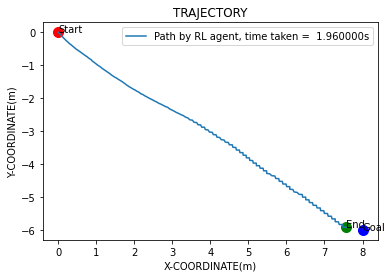

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 182      |
|    ep_rew_mean     | -165     |
| time/              |          |
|    episodes        | 278      |
|    fps             | 343      |
|    time_elapsed    | 153      |
|    total_timesteps | 52806    |
| train/             |          |
|    actor_loss      | 6.25     |
|    critic_loss     | 7.48     |
|    learning_rate   | 0.001    |
|    n_updates       | 2727     |
---------------------------------
EP_REWARD:3.1


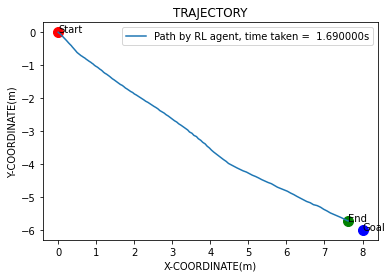

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 182      |
|    ep_rew_mean     | -165     |
| time/              |          |
|    episodes        | 279      |
|    fps             | 333      |
|    time_elapsed    | 158      |
|    total_timesteps | 52975    |
| train/             |          |
|    actor_loss      | 6.76     |
|    critic_loss     | 2.43     |
|    learning_rate   | 0.001    |
|    n_updates       | 2923     |
---------------------------------
EP_REWARD:-50


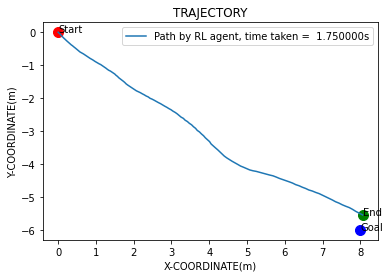

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 181      |
|    ep_rew_mean     | -165     |
| time/              |          |
|    episodes        | 280      |
|    fps             | 325      |
|    time_elapsed    | 163      |
|    total_timesteps | 53150    |
| train/             |          |
|    actor_loss      | 7.24     |
|    critic_loss     | 2.13     |
|    learning_rate   | 0.001    |
|    n_updates       | 3092     |
---------------------------------
EP_REWARD:2.3000000000000003


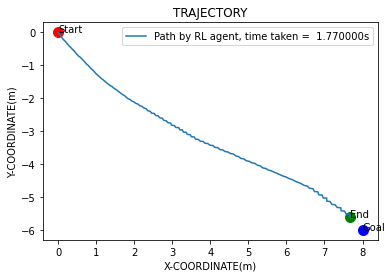

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 181      |
|    ep_rew_mean     | -164     |
| time/              |          |
|    episodes        | 281      |
|    fps             | 318      |
|    time_elapsed    | 167      |
|    total_timesteps | 53327    |
| train/             |          |
|    actor_loss      | 7.64     |
|    critic_loss     | 7.65     |
|    learning_rate   | 0.001    |
|    n_updates       | 3267     |
---------------------------------
EP_REWARD:0.9


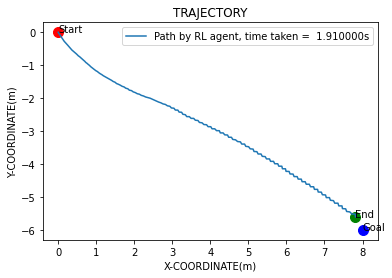

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 181      |
|    ep_rew_mean     | -164     |
| time/              |          |
|    episodes        | 282      |
|    fps             | 312      |
|    time_elapsed    | 171      |
|    total_timesteps | 53518    |
| train/             |          |
|    actor_loss      | 8.07     |
|    critic_loss     | 4.78     |
|    learning_rate   | 0.001    |
|    n_updates       | 3444     |
---------------------------------
EP_REWARD:3.1


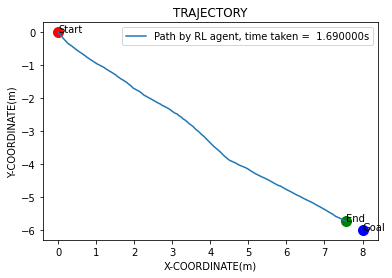

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 181      |
|    ep_rew_mean     | -164     |
| time/              |          |
|    episodes        | 283      |
|    fps             | 305      |
|    time_elapsed    | 175      |
|    total_timesteps | 53687    |
| train/             |          |
|    actor_loss      | 8.54     |
|    critic_loss     | 2.33     |
|    learning_rate   | 0.001    |
|    n_updates       | 3635     |
---------------------------------
EP_REWARD:2.6


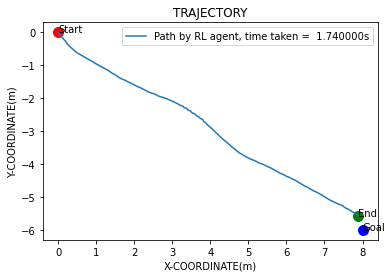

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 181      |
|    ep_rew_mean     | -163     |
| time/              |          |
|    episodes        | 284      |
|    fps             | 299      |
|    time_elapsed    | 179      |
|    total_timesteps | 53861    |
| train/             |          |
|    actor_loss      | 9.04     |
|    critic_loss     | 2.72     |
|    learning_rate   | 0.001    |
|    n_updates       | 3804     |
---------------------------------
EP_REWARD:-0.18157551042391804


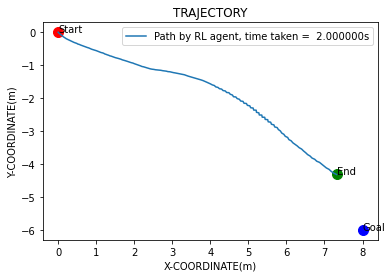

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 181      |
|    ep_rew_mean     | -163     |
| time/              |          |
|    episodes        | 285      |
|    fps             | 294      |
|    time_elapsed    | 183      |
|    total_timesteps | 54061    |
| train/             |          |
|    actor_loss      | 9.57     |
|    critic_loss     | 4.57     |
|    learning_rate   | 0.001    |
|    n_updates       | 3978     |
---------------------------------
EP_REWARD:0.6000000000000001


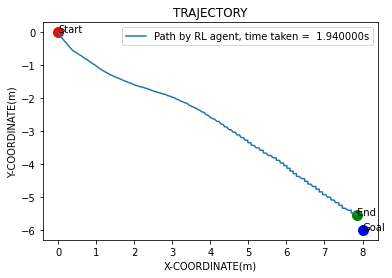

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 181      |
|    ep_rew_mean     | -162     |
| time/              |          |
|    episodes        | 286      |
|    fps             | 288      |
|    time_elapsed    | 188      |
|    total_timesteps | 54255    |
| train/             |          |
|    actor_loss      | 10       |
|    critic_loss     | 4.6      |
|    learning_rate   | 0.001    |
|    n_updates       | 4178     |
---------------------------------
EP_REWARD:1.9000000000000001


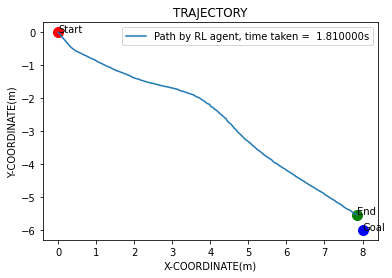

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 181      |
|    ep_rew_mean     | -162     |
| time/              |          |
|    episodes        | 287      |
|    fps             | 282      |
|    time_elapsed    | 192      |
|    total_timesteps | 54436    |
| train/             |          |
|    actor_loss      | 10.6     |
|    critic_loss     | 1.82     |
|    learning_rate   | 0.001    |
|    n_updates       | 4372     |
---------------------------------
EP_REWARD:2.7


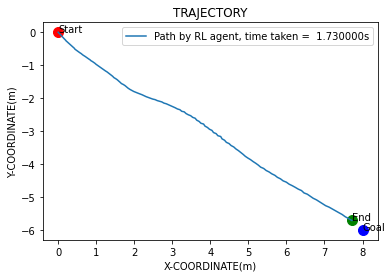

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 181      |
|    ep_rew_mean     | -161     |
| time/              |          |
|    episodes        | 288      |
|    fps             | 277      |
|    time_elapsed    | 197      |
|    total_timesteps | 54609    |
| train/             |          |
|    actor_loss      | 11.1     |
|    critic_loss     | 3.57     |
|    learning_rate   | 0.001    |
|    n_updates       | 4553     |
---------------------------------
EP_REWARD:1.6


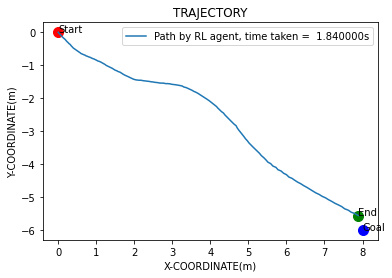

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 181      |
|    ep_rew_mean     | -161     |
| time/              |          |
|    episodes        | 289      |
|    fps             | 272      |
|    time_elapsed    | 201      |
|    total_timesteps | 54793    |
| train/             |          |
|    actor_loss      | 11.6     |
|    critic_loss     | 1.55     |
|    learning_rate   | 0.001    |
|    n_updates       | 4726     |
---------------------------------
EP_REWARD:-26


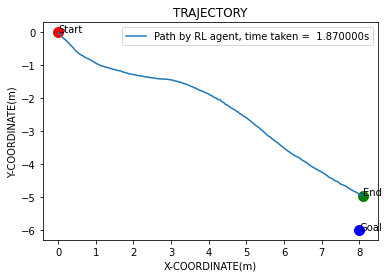

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 181      |
|    ep_rew_mean     | -161     |
| time/              |          |
|    episodes        | 290      |
|    fps             | 267      |
|    time_elapsed    | 205      |
|    total_timesteps | 54980    |
| train/             |          |
|    actor_loss      | 12.1     |
|    critic_loss     | 3.84     |
|    learning_rate   | 0.001    |
|    n_updates       | 4910     |
---------------------------------
EP_REWARD:-0.984293219547367


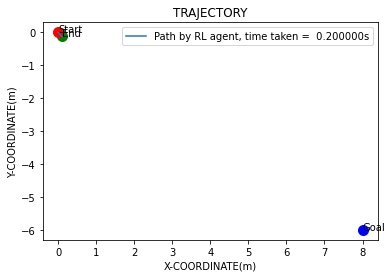

EP_REWARD:2.5


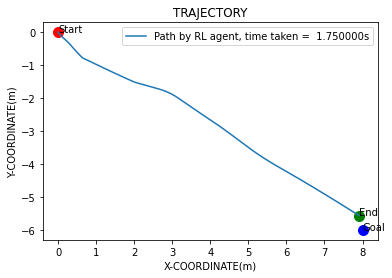

EP_REWARD:2.5


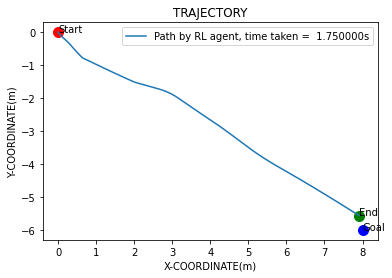

EP_REWARD:2.5


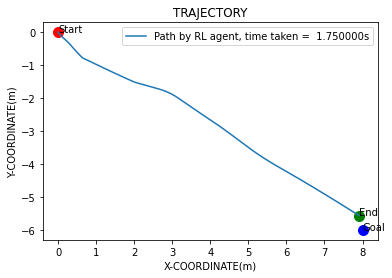

EP_REWARD:2.5


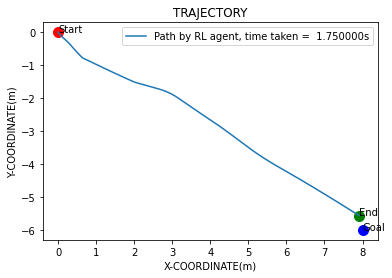

EP_REWARD:2.5


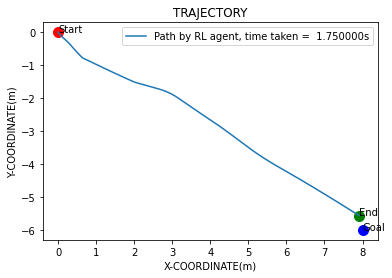

Eval num_timesteps=55000, episode_reward=-112.89 +/- 0.00
Episode length: 175.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 175      |
|    mean_reward     | -113     |
| time/              |          |
|    total_timesteps | 55000    |
| train/             |          |
|    actor_loss      | 12.5     |
|    critic_loss     | 2.92     |
|    learning_rate   | 0.001    |
|    n_updates       | 5097     |
---------------------------------
New best mean reward!
EP_REWARD:2.4000000000000004


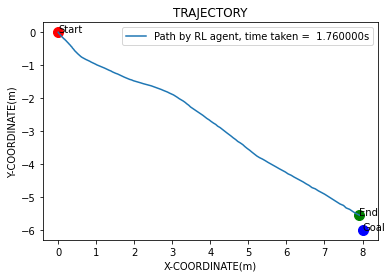

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 181      |
|    ep_rew_mean     | -160     |
| time/              |          |
|    episodes        | 291      |
|    fps             | 260      |
|    time_elapsed    | 211      |
|    total_timesteps | 55176    |
---------------------------------
EP_REWARD:0.4


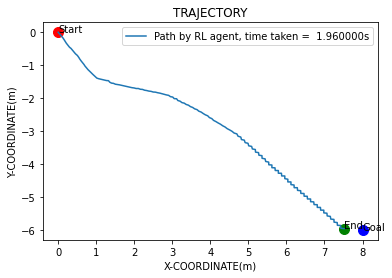

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 181      |
|    ep_rew_mean     | -160     |
| time/              |          |
|    episodes        | 292      |
|    fps             | 255      |
|    time_elapsed    | 216      |
|    total_timesteps | 55372    |
| train/             |          |
|    actor_loss      | 13       |
|    critic_loss     | 2.53     |
|    learning_rate   | 0.001    |
|    n_updates       | 5293     |
---------------------------------
EP_REWARD:-42


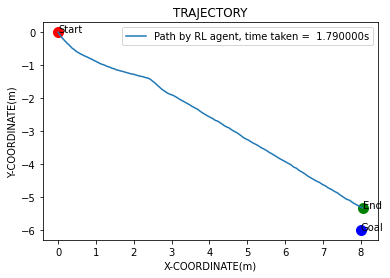

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 181      |
|    ep_rew_mean     | -160     |
| time/              |          |
|    episodes        | 293      |
|    fps             | 250      |
|    time_elapsed    | 221      |
|    total_timesteps | 55551    |
| train/             |          |
|    actor_loss      | 13.5     |
|    critic_loss     | 5.88     |
|    learning_rate   | 0.001    |
|    n_updates       | 5489     |
---------------------------------
EP_REWARD:2.6


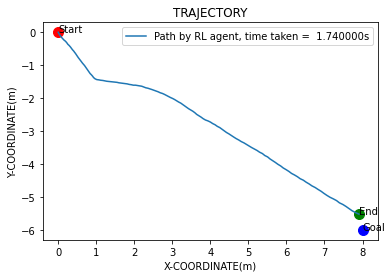

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 181      |
|    ep_rew_mean     | -160     |
| time/              |          |
|    episodes        | 294      |
|    fps             | 246      |
|    time_elapsed    | 225      |
|    total_timesteps | 55725    |
| train/             |          |
|    actor_loss      | 13.9     |
|    critic_loss     | 2.87     |
|    learning_rate   | 0.001    |
|    n_updates       | 5668     |
---------------------------------
EP_REWARD:2.4000000000000004


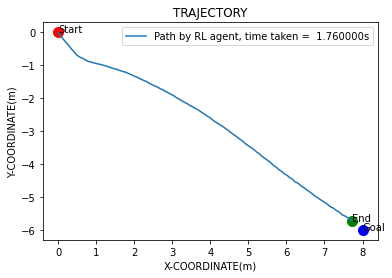

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 181      |
|    ep_rew_mean     | -159     |
| time/              |          |
|    episodes        | 295      |
|    fps             | 242      |
|    time_elapsed    | 230      |
|    total_timesteps | 55901    |
| train/             |          |
|    actor_loss      | 14.3     |
|    critic_loss     | 4.33     |
|    learning_rate   | 0.001    |
|    n_updates       | 5842     |
---------------------------------
EP_REWARD:1.4000000000000001


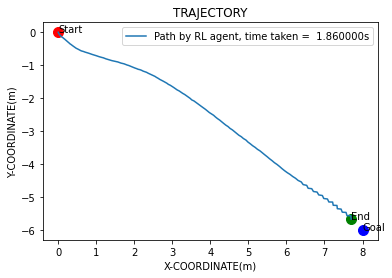

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 181      |
|    ep_rew_mean     | -159     |
| time/              |          |
|    episodes        | 296      |
|    fps             | 239      |
|    time_elapsed    | 234      |
|    total_timesteps | 56087    |
| train/             |          |
|    actor_loss      | 14.7     |
|    critic_loss     | 4.69     |
|    learning_rate   | 0.001    |
|    n_updates       | 6018     |
---------------------------------
EP_REWARD:-0.3603345493798456


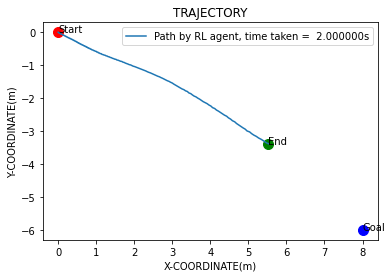

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 181      |
|    ep_rew_mean     | -159     |
| time/              |          |
|    episodes        | 297      |
|    fps             | 235      |
|    time_elapsed    | 238      |
|    total_timesteps | 56287    |
| train/             |          |
|    actor_loss      | 15.1     |
|    critic_loss     | 3.2      |
|    learning_rate   | 0.001    |
|    n_updates       | 6204     |
---------------------------------
EP_REWARD:1.1


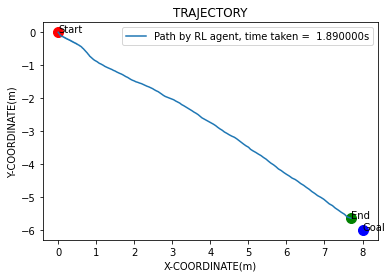

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 181      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 298      |
|    fps             | 232      |
|    time_elapsed    | 243      |
|    total_timesteps | 56476    |
| train/             |          |
|    actor_loss      | 15.5     |
|    critic_loss     | 0.991    |
|    learning_rate   | 0.001    |
|    n_updates       | 6404     |
---------------------------------
EP_REWARD:0.7000000000000001


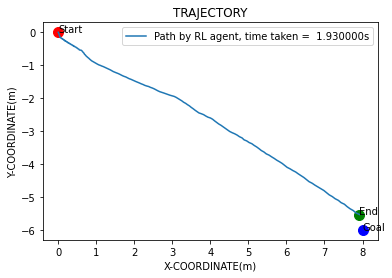

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 181      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 299      |
|    fps             | 228      |
|    time_elapsed    | 247      |
|    total_timesteps | 56669    |
| train/             |          |
|    actor_loss      | 15.9     |
|    critic_loss     | 2.23     |
|    learning_rate   | 0.001    |
|    n_updates       | 6593     |
---------------------------------
EP_REWARD:-0.11209836232370263


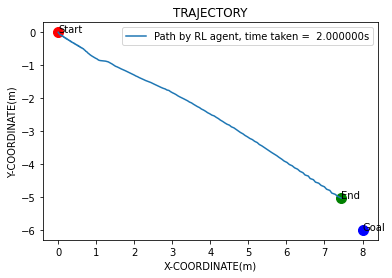

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 181      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 300      |
|    fps             | 225      |
|    time_elapsed    | 252      |
|    total_timesteps | 56869    |
| train/             |          |
|    actor_loss      | 16.4     |
|    critic_loss     | 5.2      |
|    learning_rate   | 0.001    |
|    n_updates       | 6786     |
---------------------------------
EP_REWARD:1.0


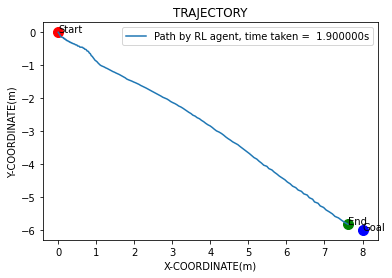

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 181      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 301      |
|    fps             | 222      |
|    time_elapsed    | 256      |
|    total_timesteps | 57059    |
| train/             |          |
|    actor_loss      | 16.7     |
|    critic_loss     | 2.34     |
|    learning_rate   | 0.001    |
|    n_updates       | 6986     |
---------------------------------
EP_REWARD:-22


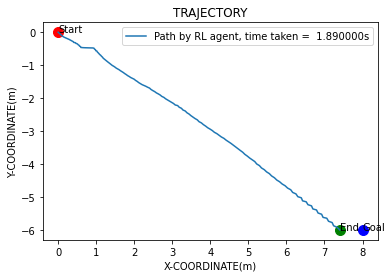

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 181      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 302      |
|    fps             | 219      |
|    time_elapsed    | 260      |
|    total_timesteps | 57248    |
| train/             |          |
|    actor_loss      | 17.1     |
|    critic_loss     | 5.34     |
|    learning_rate   | 0.001    |
|    n_updates       | 7176     |
---------------------------------
EP_REWARD:-0.2238579544335591


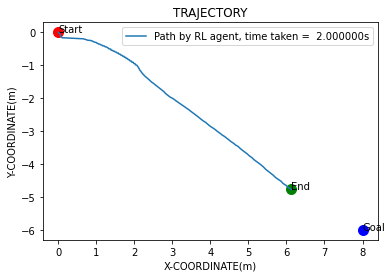

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 181      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 303      |
|    fps             | 216      |
|    time_elapsed    | 265      |
|    total_timesteps | 57448    |
| train/             |          |
|    actor_loss      | 17.5     |
|    critic_loss     | 2.57     |
|    learning_rate   | 0.001    |
|    n_updates       | 7365     |
---------------------------------
EP_REWARD:-0.4727433201372387


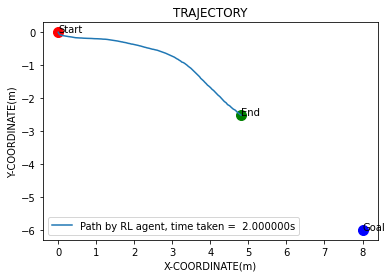

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 181      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 304      |
|    fps             | 213      |
|    time_elapsed    | 269      |
|    total_timesteps | 57648    |
| train/             |          |
|    actor_loss      | 17.9     |
|    critic_loss     | 2.8      |
|    learning_rate   | 0.001    |
|    n_updates       | 7565     |
---------------------------------
EP_REWARD:-0.553657582868498


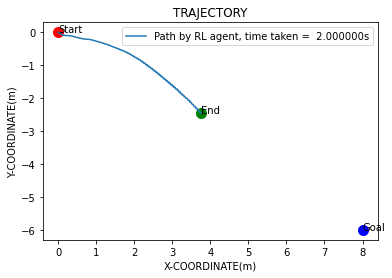

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 181      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 305      |
|    fps             | 211      |
|    time_elapsed    | 274      |
|    total_timesteps | 57848    |
| train/             |          |
|    actor_loss      | 18.2     |
|    critic_loss     | 1.86     |
|    learning_rate   | 0.001    |
|    n_updates       | 7765     |
---------------------------------
EP_REWARD:-0.49641906397865476


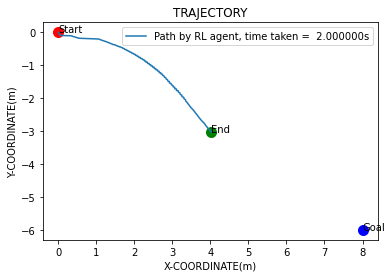

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 182      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 306      |
|    fps             | 208      |
|    time_elapsed    | 278      |
|    total_timesteps | 58048    |
| train/             |          |
|    actor_loss      | 18.5     |
|    critic_loss     | 3.03     |
|    learning_rate   | 0.001    |
|    n_updates       | 7965     |
---------------------------------
EP_REWARD:-0.7286659365698195


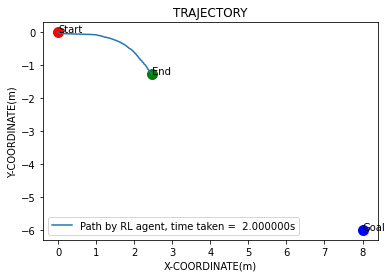

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 182      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 307      |
|    fps             | 205      |
|    time_elapsed    | 282      |
|    total_timesteps | 58248    |
| train/             |          |
|    actor_loss      | 18.9     |
|    critic_loss     | 3.65     |
|    learning_rate   | 0.001    |
|    n_updates       | 8165     |
---------------------------------
EP_REWARD:-0.9231410601232318


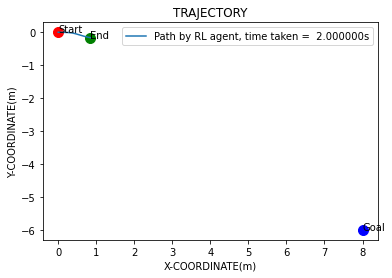

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 182      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 308      |
|    fps             | 203      |
|    time_elapsed    | 287      |
|    total_timesteps | 58448    |
| train/             |          |
|    actor_loss      | 19.2     |
|    critic_loss     | 2.76     |
|    learning_rate   | 0.001    |
|    n_updates       | 8365     |
---------------------------------
EP_REWARD:-0.07806842870143023


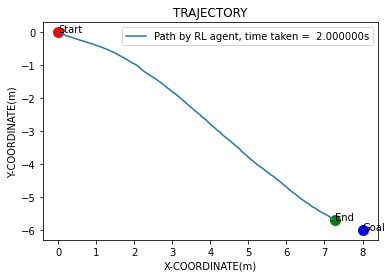

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 182      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 309      |
|    fps             | 200      |
|    time_elapsed    | 291      |
|    total_timesteps | 58648    |
| train/             |          |
|    actor_loss      | 19.6     |
|    critic_loss     | 3.73     |
|    learning_rate   | 0.001    |
|    n_updates       | 8565     |
---------------------------------
EP_REWARD:-0.09783852105045864


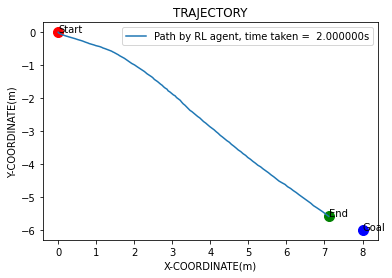

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 182      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 310      |
|    fps             | 198      |
|    time_elapsed    | 296      |
|    total_timesteps | 58848    |
| train/             |          |
|    actor_loss      | 19.8     |
|    critic_loss     | 2.35     |
|    learning_rate   | 0.001    |
|    n_updates       | 8765     |
---------------------------------
EP_REWARD:-0.10624994133605198


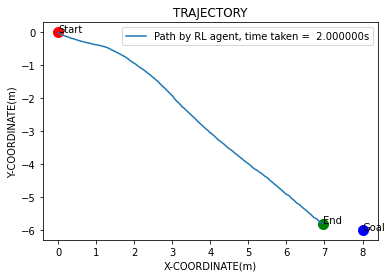

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 182      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 311      |
|    fps             | 196      |
|    time_elapsed    | 300      |
|    total_timesteps | 59048    |
| train/             |          |
|    actor_loss      | 20.2     |
|    critic_loss     | 1.8      |
|    learning_rate   | 0.001    |
|    n_updates       | 8965     |
---------------------------------
EP_REWARD:-0.18923152352465902


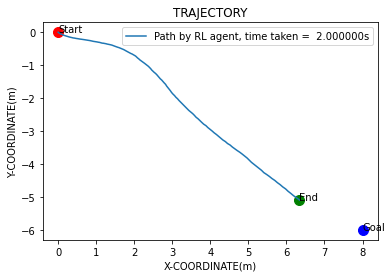

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 182      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 312      |
|    fps             | 194      |
|    time_elapsed    | 305      |
|    total_timesteps | 59248    |
| train/             |          |
|    actor_loss      | 20.3     |
|    critic_loss     | 3.25     |
|    learning_rate   | 0.001    |
|    n_updates       | 9165     |
---------------------------------
EP_REWARD:-0.36711631345263335


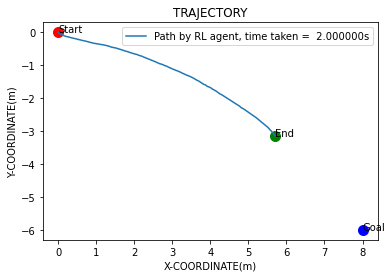

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 182      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 313      |
|    fps             | 191      |
|    time_elapsed    | 309      |
|    total_timesteps | 59448    |
| train/             |          |
|    actor_loss      | 20.7     |
|    critic_loss     | 3.53     |
|    learning_rate   | 0.001    |
|    n_updates       | 9365     |
---------------------------------
EP_REWARD:-0.09654530371424865


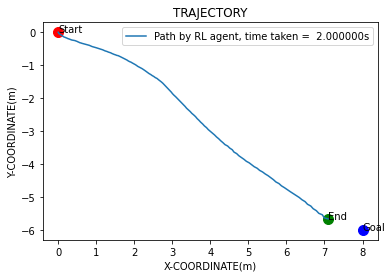

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 182      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 314      |
|    fps             | 189      |
|    time_elapsed    | 314      |
|    total_timesteps | 59648    |
| train/             |          |
|    actor_loss      | 21       |
|    critic_loss     | 3.07     |
|    learning_rate   | 0.001    |
|    n_updates       | 9565     |
---------------------------------
EP_REWARD:-0.17846139698835442


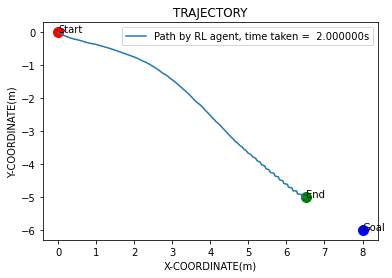

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 182      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 315      |
|    fps             | 187      |
|    time_elapsed    | 318      |
|    total_timesteps | 59848    |
| train/             |          |
|    actor_loss      | 21.3     |
|    critic_loss     | 2.21     |
|    learning_rate   | 0.001    |
|    n_updates       | 9765     |
---------------------------------
EP_REWARD:-0.9503489884429133


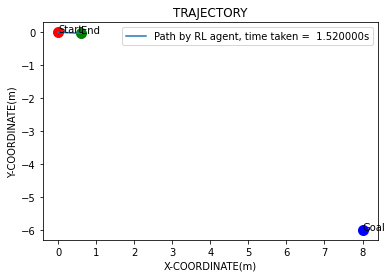

EP_REWARD:-0.931264455982921


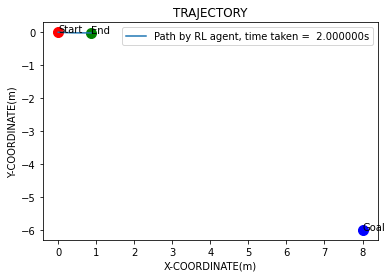

EP_REWARD:-0.931264455982921


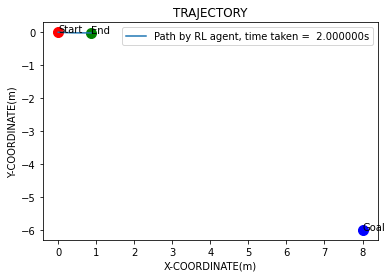

EP_REWARD:-0.931264455982921


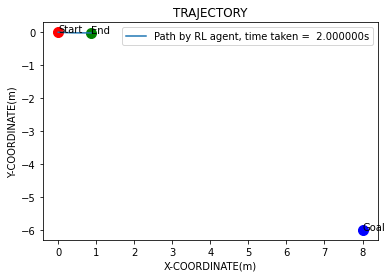

EP_REWARD:-0.931264455982921


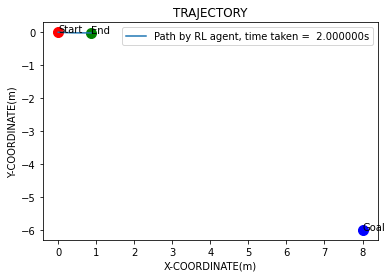

EP_REWARD:-0.931264455982921


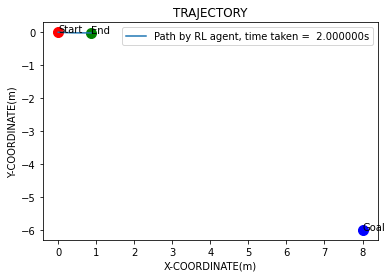

Eval num_timesteps=60000, episode_reward=-194.82 +/- 0.00
Episode length: 200.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 200      |
|    mean_reward     | -195     |
| time/              |          |
|    total_timesteps | 60000    |
| train/             |          |
|    actor_loss      | 21.7     |
|    critic_loss     | 3.29     |
|    learning_rate   | 0.001    |
|    n_updates       | 9965     |
---------------------------------
EP_REWARD:-0.9143106788265154


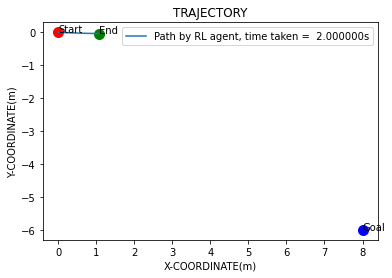

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 182      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 316      |
|    fps             | 185      |
|    time_elapsed    | 324      |
|    total_timesteps | 60200    |
---------------------------------
EP_REWARD:-0.9441863777596136


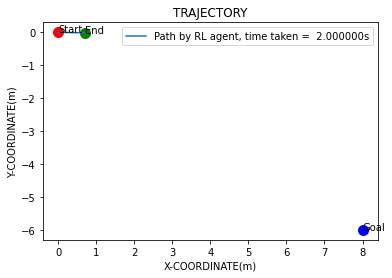

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 182      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 317      |
|    fps             | 181      |
|    time_elapsed    | 332      |
|    total_timesteps | 60400    |
| train/             |          |
|    actor_loss      | 22.3     |
|    critic_loss     | 2.7      |
|    learning_rate   | 0.001    |
|    n_updates       | 10317    |
---------------------------------
EP_REWARD:-0.9557784973527357


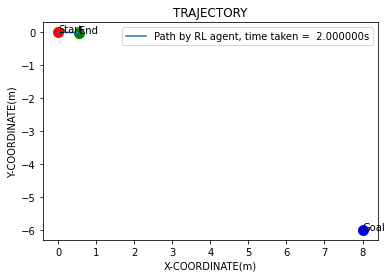

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 183      |
|    ep_rew_mean     | -159     |
| time/              |          |
|    episodes        | 318      |
|    fps             | 179      |
|    time_elapsed    | 337      |
|    total_timesteps | 60600    |
| train/             |          |
|    actor_loss      | 23.2     |
|    critic_loss     | 2.17     |
|    learning_rate   | 0.001    |
|    n_updates       | 10517    |
---------------------------------
EP_REWARD:-0.9534395383158953


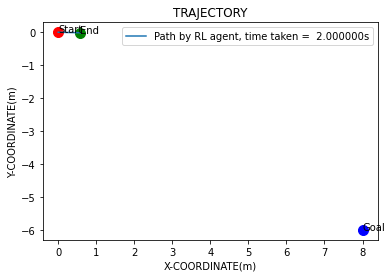

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 183      |
|    ep_rew_mean     | -159     |
| time/              |          |
|    episodes        | 319      |
|    fps             | 178      |
|    time_elapsed    | 341      |
|    total_timesteps | 60800    |
| train/             |          |
|    actor_loss      | 23.6     |
|    critic_loss     | 2.89     |
|    learning_rate   | 0.001    |
|    n_updates       | 10717    |
---------------------------------
EP_REWARD:-0.9426435444831456


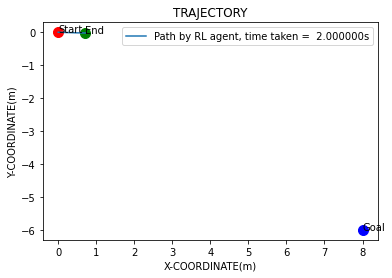

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 183      |
|    ep_rew_mean     | -159     |
| time/              |          |
|    episodes        | 320      |
|    fps             | 176      |
|    time_elapsed    | 345      |
|    total_timesteps | 61000    |
| train/             |          |
|    actor_loss      | 24.2     |
|    critic_loss     | 2.05     |
|    learning_rate   | 0.001    |
|    n_updates       | 10917    |
---------------------------------
EP_REWARD:-0.9510657542826956


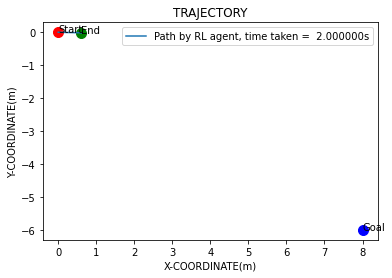

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 183      |
|    ep_rew_mean     | -159     |
| time/              |          |
|    episodes        | 321      |
|    fps             | 174      |
|    time_elapsed    | 350      |
|    total_timesteps | 61200    |
| train/             |          |
|    actor_loss      | 24.8     |
|    critic_loss     | 2.47     |
|    learning_rate   | 0.001    |
|    n_updates       | 11117    |
---------------------------------
EP_REWARD:-0.9485417837561956


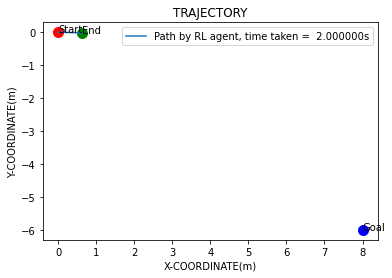

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 183      |
|    ep_rew_mean     | -160     |
| time/              |          |
|    episodes        | 322      |
|    fps             | 172      |
|    time_elapsed    | 354      |
|    total_timesteps | 61400    |
| train/             |          |
|    actor_loss      | 25.3     |
|    critic_loss     | 1.31     |
|    learning_rate   | 0.001    |
|    n_updates       | 11317    |
---------------------------------
EP_REWARD:-0.9488033813059549


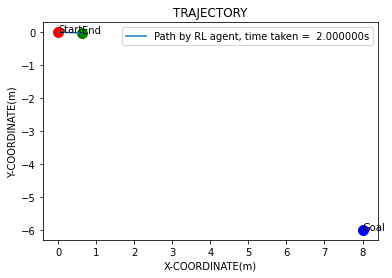

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 183      |
|    ep_rew_mean     | -160     |
| time/              |          |
|    episodes        | 323      |
|    fps             | 171      |
|    time_elapsed    | 359      |
|    total_timesteps | 61600    |
| train/             |          |
|    actor_loss      | 25.9     |
|    critic_loss     | 2.44     |
|    learning_rate   | 0.001    |
|    n_updates       | 11517    |
---------------------------------
EP_REWARD:-0.8287166497935452


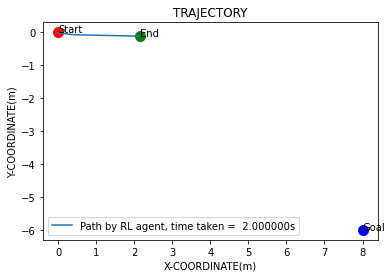

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 184      |
|    ep_rew_mean     | -160     |
| time/              |          |
|    episodes        | 324      |
|    fps             | 169      |
|    time_elapsed    | 363      |
|    total_timesteps | 61800    |
| train/             |          |
|    actor_loss      | 26.4     |
|    critic_loss     | 3.74     |
|    learning_rate   | 0.001    |
|    n_updates       | 11717    |
---------------------------------
EP_REWARD:-0.8776810105565563


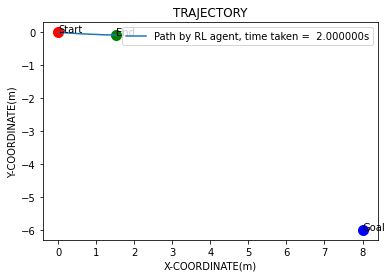

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 184      |
|    ep_rew_mean     | -161     |
| time/              |          |
|    episodes        | 325      |
|    fps             | 168      |
|    time_elapsed    | 368      |
|    total_timesteps | 62000    |
| train/             |          |
|    actor_loss      | 26.8     |
|    critic_loss     | 2.96     |
|    learning_rate   | 0.001    |
|    n_updates       | 11917    |
---------------------------------
EP_REWARD:-0.7044349431546719


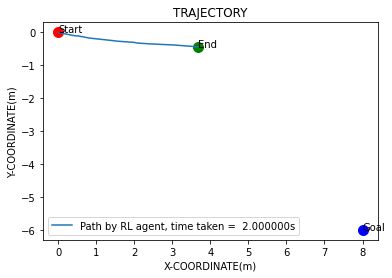

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 184      |
|    ep_rew_mean     | -161     |
| time/              |          |
|    episodes        | 326      |
|    fps             | 166      |
|    time_elapsed    | 372      |
|    total_timesteps | 62200    |
| train/             |          |
|    actor_loss      | 27.4     |
|    critic_loss     | 2.08     |
|    learning_rate   | 0.001    |
|    n_updates       | 12117    |
---------------------------------
EP_REWARD:-0.36151970714699555


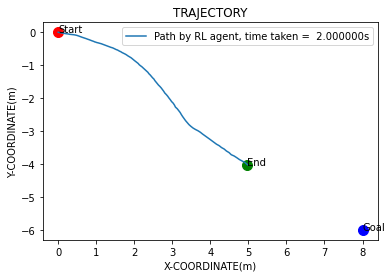

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 184      |
|    ep_rew_mean     | -161     |
| time/              |          |
|    episodes        | 327      |
|    fps             | 165      |
|    time_elapsed    | 377      |
|    total_timesteps | 62400    |
| train/             |          |
|    actor_loss      | 27.6     |
|    critic_loss     | 2.4      |
|    learning_rate   | 0.001    |
|    n_updates       | 12317    |
---------------------------------
EP_REWARD:-0.3158784932807703


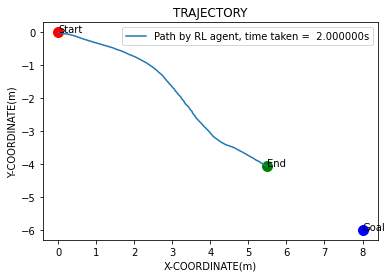

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 184      |
|    ep_rew_mean     | -161     |
| time/              |          |
|    episodes        | 328      |
|    fps             | 163      |
|    time_elapsed    | 381      |
|    total_timesteps | 62600    |
| train/             |          |
|    actor_loss      | 28       |
|    critic_loss     | 2.18     |
|    learning_rate   | 0.001    |
|    n_updates       | 12517    |
---------------------------------
EP_REWARD:-0.09774371740771794


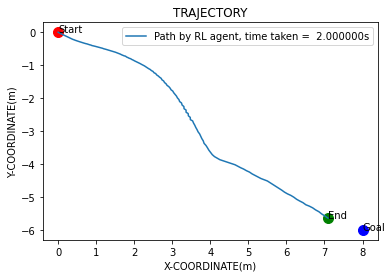

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 184      |
|    ep_rew_mean     | -161     |
| time/              |          |
|    episodes        | 329      |
|    fps             | 162      |
|    time_elapsed    | 386      |
|    total_timesteps | 62800    |
| train/             |          |
|    actor_loss      | 28.2     |
|    critic_loss     | 2.41     |
|    learning_rate   | 0.001    |
|    n_updates       | 12717    |
---------------------------------
EP_REWARD:-0.14260443785676444


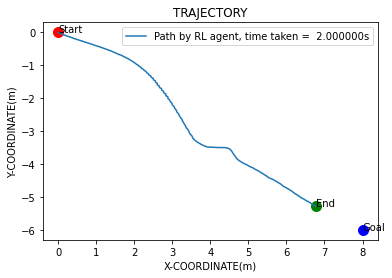

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 184      |
|    ep_rew_mean     | -160     |
| time/              |          |
|    episodes        | 330      |
|    fps             | 161      |
|    time_elapsed    | 390      |
|    total_timesteps | 63000    |
| train/             |          |
|    actor_loss      | 28.7     |
|    critic_loss     | 2        |
|    learning_rate   | 0.001    |
|    n_updates       | 12917    |
---------------------------------
EP_REWARD:-0.3883658938760022


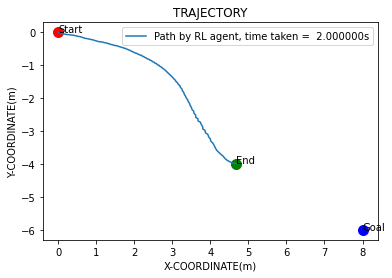

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 185      |
|    ep_rew_mean     | -160     |
| time/              |          |
|    episodes        | 331      |
|    fps             | 159      |
|    time_elapsed    | 395      |
|    total_timesteps | 63200    |
| train/             |          |
|    actor_loss      | 29       |
|    critic_loss     | 2.73     |
|    learning_rate   | 0.001    |
|    n_updates       | 13117    |
---------------------------------
EP_REWARD:-0.16526452143724377


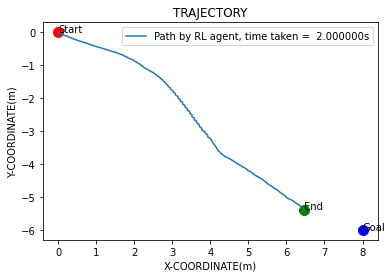

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 185      |
|    ep_rew_mean     | -160     |
| time/              |          |
|    episodes        | 332      |
|    fps             | 158      |
|    time_elapsed    | 399      |
|    total_timesteps | 63400    |
| train/             |          |
|    actor_loss      | 29.3     |
|    critic_loss     | 2.34     |
|    learning_rate   | 0.001    |
|    n_updates       | 13317    |
---------------------------------
EP_REWARD:-0.1844000613058464


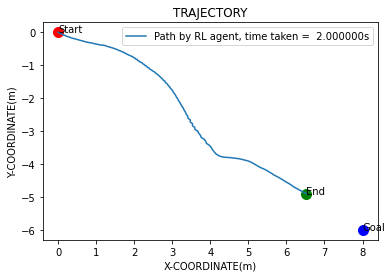

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 185      |
|    ep_rew_mean     | -160     |
| time/              |          |
|    episodes        | 333      |
|    fps             | 157      |
|    time_elapsed    | 404      |
|    total_timesteps | 63600    |
| train/             |          |
|    actor_loss      | 29.6     |
|    critic_loss     | 1.38     |
|    learning_rate   | 0.001    |
|    n_updates       | 13517    |
---------------------------------
EP_REWARD:-0.2762215774187254


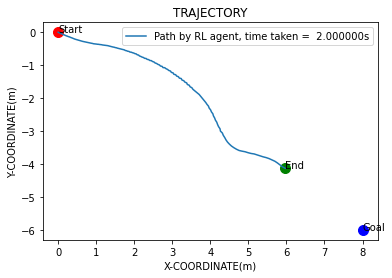

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 185      |
|    ep_rew_mean     | -160     |
| time/              |          |
|    episodes        | 334      |
|    fps             | 156      |
|    time_elapsed    | 408      |
|    total_timesteps | 63800    |
| train/             |          |
|    actor_loss      | 29.9     |
|    critic_loss     | 2.71     |
|    learning_rate   | 0.001    |
|    n_updates       | 13717    |
---------------------------------
EP_REWARD:-8


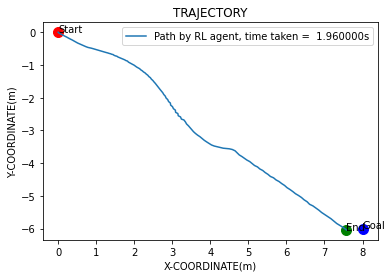

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 185      |
|    ep_rew_mean     | -159     |
| time/              |          |
|    episodes        | 335      |
|    fps             | 154      |
|    time_elapsed    | 413      |
|    total_timesteps | 63996    |
| train/             |          |
|    actor_loss      | 30.1     |
|    critic_loss     | 3.43     |
|    learning_rate   | 0.001    |
|    n_updates       | 13917    |
---------------------------------
EP_REWARD:-0.15743125758325371


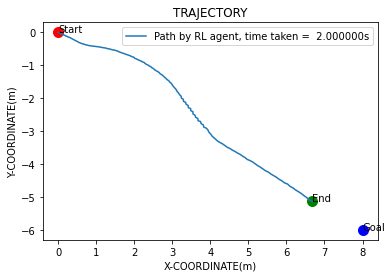

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 185      |
|    ep_rew_mean     | -159     |
| time/              |          |
|    episodes        | 336      |
|    fps             | 153      |
|    time_elapsed    | 417      |
|    total_timesteps | 64196    |
| train/             |          |
|    actor_loss      | 30.4     |
|    critic_loss     | 1.71     |
|    learning_rate   | 0.001    |
|    n_updates       | 14113    |
---------------------------------
EP_REWARD:-0.16919366465938304


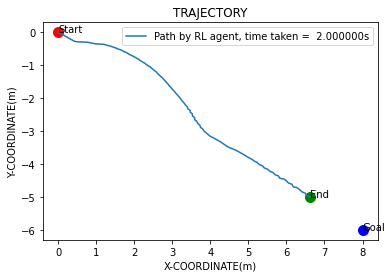

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 185      |
|    ep_rew_mean     | -159     |
| time/              |          |
|    episodes        | 337      |
|    fps             | 152      |
|    time_elapsed    | 422      |
|    total_timesteps | 64396    |
| train/             |          |
|    actor_loss      | 30.7     |
|    critic_loss     | 2.32     |
|    learning_rate   | 0.001    |
|    n_updates       | 14313    |
---------------------------------
EP_REWARD:-0.0556919509710018


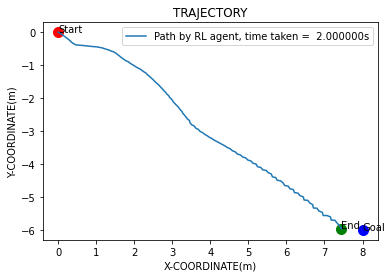

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 185      |
|    ep_rew_mean     | -159     |
| time/              |          |
|    episodes        | 338      |
|    fps             | 151      |
|    time_elapsed    | 426      |
|    total_timesteps | 64596    |
| train/             |          |
|    actor_loss      | 30.9     |
|    critic_loss     | 1.82     |
|    learning_rate   | 0.001    |
|    n_updates       | 14513    |
---------------------------------
EP_REWARD:0.7000000000000001


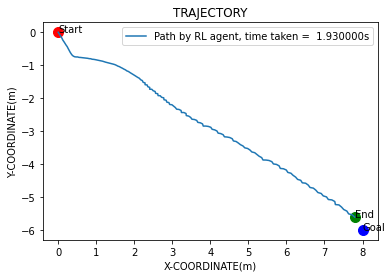

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 186      |
|    ep_rew_mean     | -159     |
| time/              |          |
|    episodes        | 339      |
|    fps             | 150      |
|    time_elapsed    | 431      |
|    total_timesteps | 64789    |
| train/             |          |
|    actor_loss      | 31.3     |
|    critic_loss     | 2.18     |
|    learning_rate   | 0.001    |
|    n_updates       | 14713    |
---------------------------------
EP_REWARD:-0.15403866683746137


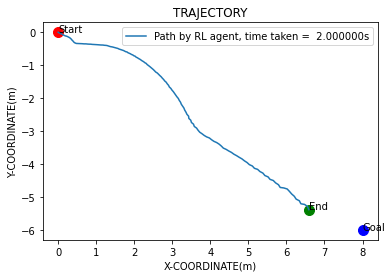

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 186      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 340      |
|    fps             | 149      |
|    time_elapsed    | 435      |
|    total_timesteps | 64989    |
| train/             |          |
|    actor_loss      | 31.4     |
|    critic_loss     | 3.07     |
|    learning_rate   | 0.001    |
|    n_updates       | 14906    |
---------------------------------
EP_REWARD:-0.9976273301239026


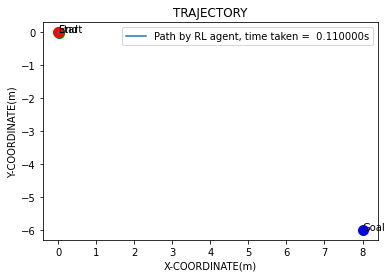

EP_REWARD:-0.21863238939822877


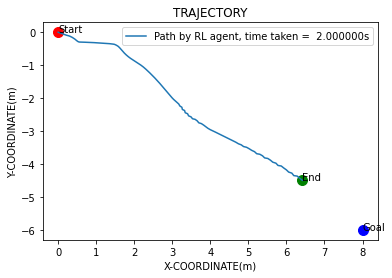

EP_REWARD:-0.21863238939822877


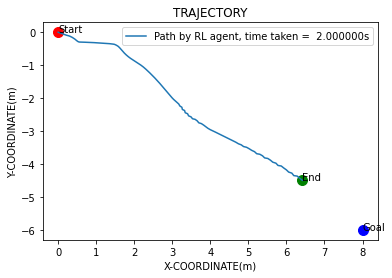

EP_REWARD:-0.21863238939822877


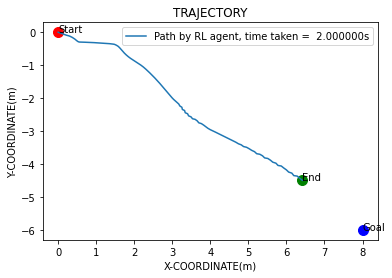

EP_REWARD:-0.21863238939822877


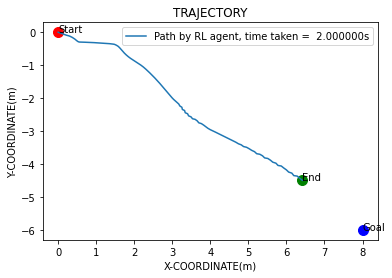

EP_REWARD:-0.21863238939822877


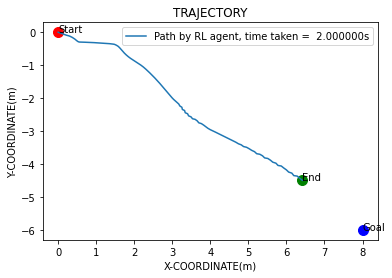

Eval num_timesteps=65000, episode_reward=-151.86 +/- 0.00
Episode length: 200.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 200      |
|    mean_reward     | -152     |
| time/              |          |
|    total_timesteps | 65000    |
| train/             |          |
|    actor_loss      | 31.7     |
|    critic_loss     | 2.08     |
|    learning_rate   | 0.001    |
|    n_updates       | 15106    |
---------------------------------
EP_REWARD:-0.23670119921834926


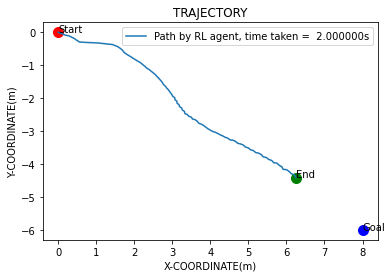

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 186      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 341      |
|    fps             | 147      |
|    time_elapsed    | 441      |
|    total_timesteps | 65200    |
---------------------------------
EP_REWARD:0.1


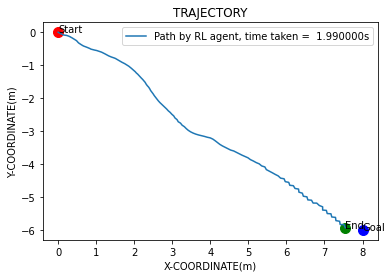

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 186      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 342      |
|    fps             | 146      |
|    time_elapsed    | 446      |
|    total_timesteps | 65399    |
| train/             |          |
|    actor_loss      | 31.8     |
|    critic_loss     | 2.37     |
|    learning_rate   | 0.001    |
|    n_updates       | 15317    |
---------------------------------
EP_REWARD:-0.13678011544506039


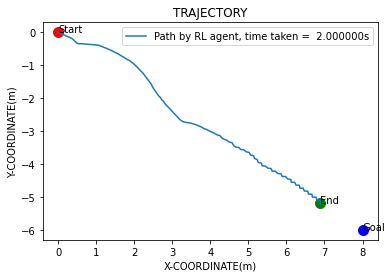

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 186      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 343      |
|    fps             | 145      |
|    time_elapsed    | 451      |
|    total_timesteps | 65599    |
| train/             |          |
|    actor_loss      | 32.2     |
|    critic_loss     | 2.71     |
|    learning_rate   | 0.001    |
|    n_updates       | 15516    |
---------------------------------
EP_REWARD:-0.24614343802271874


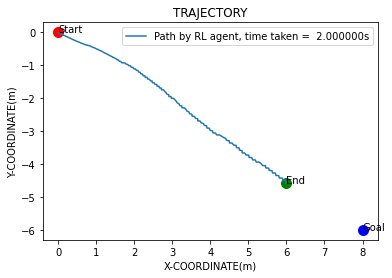

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 186      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 344      |
|    fps             | 144      |
|    time_elapsed    | 456      |
|    total_timesteps | 65799    |
| train/             |          |
|    actor_loss      | 32.5     |
|    critic_loss     | 3.05     |
|    learning_rate   | 0.001    |
|    n_updates       | 15716    |
---------------------------------
EP_REWARD:-0.3027265121742153


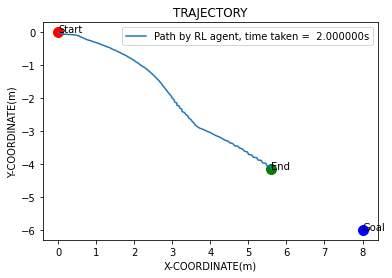

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 186      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 345      |
|    fps             | 143      |
|    time_elapsed    | 460      |
|    total_timesteps | 65999    |
| train/             |          |
|    actor_loss      | 32.9     |
|    critic_loss     | 2        |
|    learning_rate   | 0.001    |
|    n_updates       | 15916    |
---------------------------------
EP_REWARD:-6


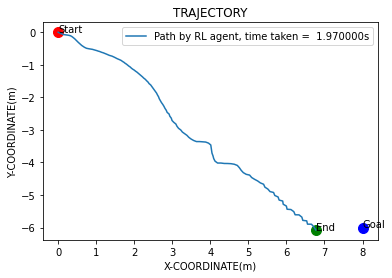

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 186      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 346      |
|    fps             | 142      |
|    time_elapsed    | 465      |
|    total_timesteps | 66196    |
| train/             |          |
|    actor_loss      | 33.1     |
|    critic_loss     | 2.63     |
|    learning_rate   | 0.001    |
|    n_updates       | 16116    |
---------------------------------
EP_REWARD:-0.243620193802245


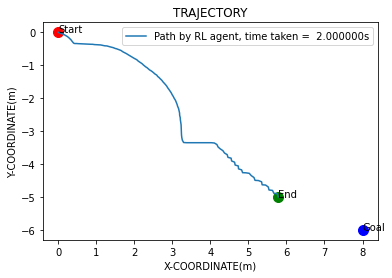

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 187      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 347      |
|    fps             | 141      |
|    time_elapsed    | 469      |
|    total_timesteps | 66396    |
| train/             |          |
|    actor_loss      | 33.4     |
|    critic_loss     | 3.09     |
|    learning_rate   | 0.001    |
|    n_updates       | 16313    |
---------------------------------
EP_REWARD:-0.2561877808555299


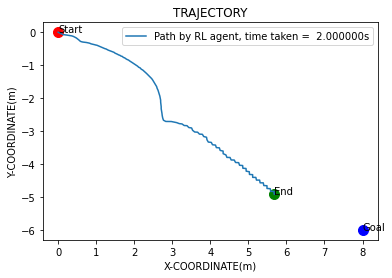

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 187      |
|    ep_rew_mean     | -158     |
| time/              |          |
|    episodes        | 348      |
|    fps             | 140      |
|    time_elapsed    | 474      |
|    total_timesteps | 66596    |
| train/             |          |
|    actor_loss      | 33.4     |
|    critic_loss     | 2        |
|    learning_rate   | 0.001    |
|    n_updates       | 16513    |
---------------------------------
EP_REWARD:-0.3028412603849031


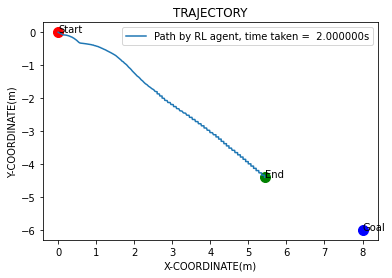

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 187      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 349      |
|    fps             | 139      |
|    time_elapsed    | 478      |
|    total_timesteps | 66796    |
| train/             |          |
|    actor_loss      | 33.7     |
|    critic_loss     | 2.37     |
|    learning_rate   | 0.001    |
|    n_updates       | 16713    |
---------------------------------
EP_REWARD:-0.1416535103170203


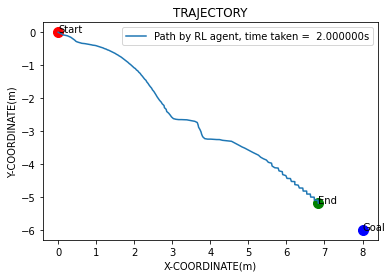

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 187      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 350      |
|    fps             | 138      |
|    time_elapsed    | 483      |
|    total_timesteps | 66996    |
| train/             |          |
|    actor_loss      | 34.2     |
|    critic_loss     | 2.45     |
|    learning_rate   | 0.001    |
|    n_updates       | 16913    |
---------------------------------
EP_REWARD:-22


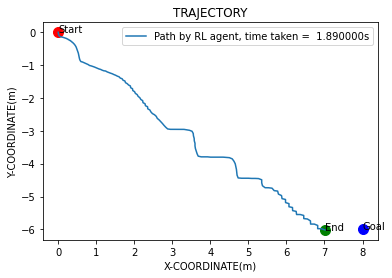

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 187      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 351      |
|    fps             | 137      |
|    time_elapsed    | 487      |
|    total_timesteps | 67185    |
| train/             |          |
|    actor_loss      | 34.3     |
|    critic_loss     | 3.2      |
|    learning_rate   | 0.001    |
|    n_updates       | 17113    |
---------------------------------
EP_REWARD:-0.22689447923032594


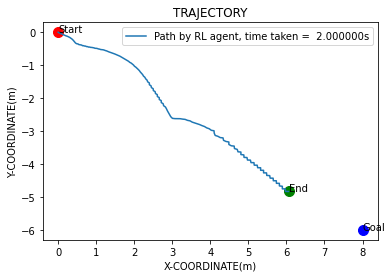

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 187      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 352      |
|    fps             | 136      |
|    time_elapsed    | 491      |
|    total_timesteps | 67385    |
| train/             |          |
|    actor_loss      | 34.7     |
|    critic_loss     | 1.45     |
|    learning_rate   | 0.001    |
|    n_updates       | 17302    |
---------------------------------
EP_REWARD:-0.2662887383651759


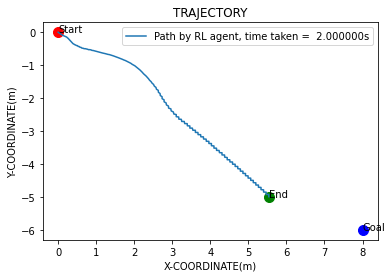

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 187      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 353      |
|    fps             | 136      |
|    time_elapsed    | 496      |
|    total_timesteps | 67585    |
| train/             |          |
|    actor_loss      | 34.8     |
|    critic_loss     | 3.02     |
|    learning_rate   | 0.001    |
|    n_updates       | 17502    |
---------------------------------
EP_REWARD:-0.17428170928616638


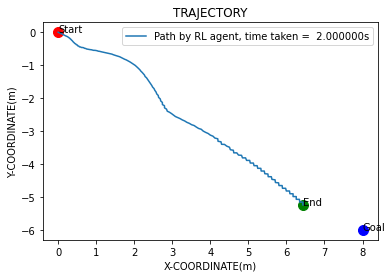

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 187      |
|    ep_rew_mean     | -157     |
| time/              |          |
|    episodes        | 354      |
|    fps             | 135      |
|    time_elapsed    | 501      |
|    total_timesteps | 67785    |
| train/             |          |
|    actor_loss      | 35.1     |
|    critic_loss     | 1.63     |
|    learning_rate   | 0.001    |
|    n_updates       | 17702    |
---------------------------------
EP_REWARD:-0.14723257641317583


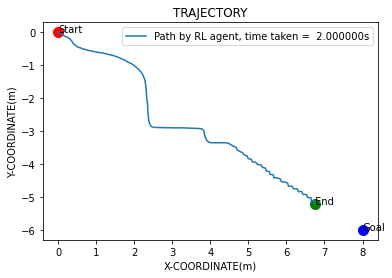

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 187      |
|    ep_rew_mean     | -156     |
| time/              |          |
|    episodes        | 355      |
|    fps             | 134      |
|    time_elapsed    | 505      |
|    total_timesteps | 67985    |
| train/             |          |
|    actor_loss      | 35.3     |
|    critic_loss     | 2.36     |
|    learning_rate   | 0.001    |
|    n_updates       | 17902    |
---------------------------------
EP_REWARD:-0.14803463662865163


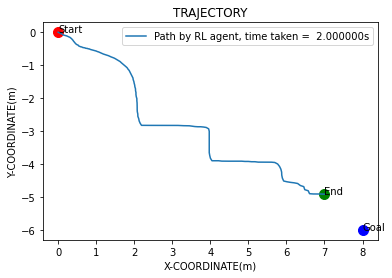

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 188      |
|    ep_rew_mean     | -156     |
| time/              |          |
|    episodes        | 356      |
|    fps             | 133      |
|    time_elapsed    | 510      |
|    total_timesteps | 68185    |
| train/             |          |
|    actor_loss      | 35.6     |
|    critic_loss     | 1.4      |
|    learning_rate   | 0.001    |
|    n_updates       | 18102    |
---------------------------------
EP_REWARD:-0.07557046572980008


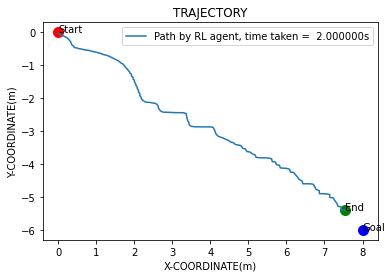

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 188      |
|    ep_rew_mean     | -156     |
| time/              |          |
|    episodes        | 357      |
|    fps             | 132      |
|    time_elapsed    | 514      |
|    total_timesteps | 68385    |
| train/             |          |
|    actor_loss      | 35.6     |
|    critic_loss     | 2.12     |
|    learning_rate   | 0.001    |
|    n_updates       | 18302    |
---------------------------------
EP_REWARD:-0.13975742398474875


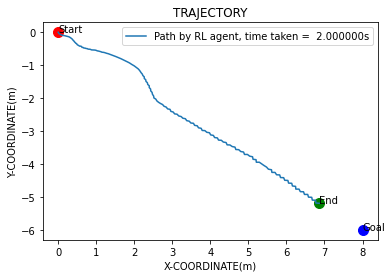

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 188      |
|    ep_rew_mean     | -156     |
| time/              |          |
|    episodes        | 358      |
|    fps             | 132      |
|    time_elapsed    | 519      |
|    total_timesteps | 68585    |
| train/             |          |
|    actor_loss      | 36       |
|    critic_loss     | 2.06     |
|    learning_rate   | 0.001    |
|    n_updates       | 18502    |
---------------------------------
EP_REWARD:-0.07875241006185996


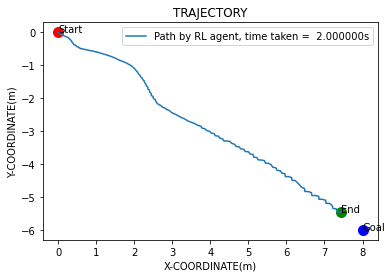

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 188      |
|    ep_rew_mean     | -155     |
| time/              |          |
|    episodes        | 359      |
|    fps             | 131      |
|    time_elapsed    | 523      |
|    total_timesteps | 68785    |
| train/             |          |
|    actor_loss      | 36       |
|    critic_loss     | 3.52     |
|    learning_rate   | 0.001    |
|    n_updates       | 18702    |
---------------------------------
EP_REWARD:-0.298567194183057


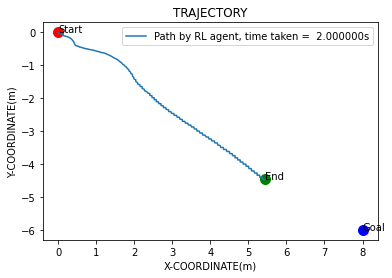

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 188      |
|    ep_rew_mean     | -155     |
| time/              |          |
|    episodes        | 360      |
|    fps             | 130      |
|    time_elapsed    | 528      |
|    total_timesteps | 68985    |
| train/             |          |
|    actor_loss      | 36.5     |
|    critic_loss     | 2.89     |
|    learning_rate   | 0.001    |
|    n_updates       | 18902    |
---------------------------------
EP_REWARD:-0.32857738777460527


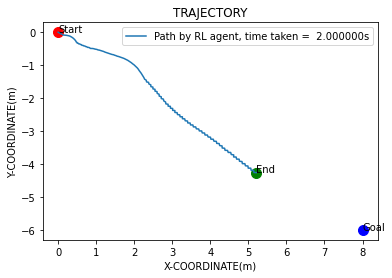

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -154     |
| time/              |          |
|    episodes        | 361      |
|    fps             | 129      |
|    time_elapsed    | 532      |
|    total_timesteps | 69185    |
| train/             |          |
|    actor_loss      | 36.6     |
|    critic_loss     | 2.22     |
|    learning_rate   | 0.001    |
|    n_updates       | 19102    |
---------------------------------
EP_REWARD:-8


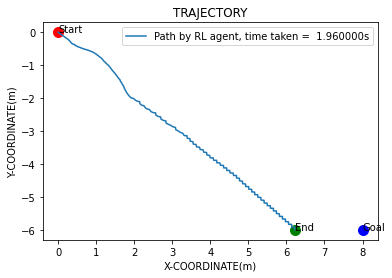

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -153     |
| time/              |          |
|    episodes        | 362      |
|    fps             | 129      |
|    time_elapsed    | 537      |
|    total_timesteps | 69381    |
| train/             |          |
|    actor_loss      | 36.9     |
|    critic_loss     | 3.2      |
|    learning_rate   | 0.001    |
|    n_updates       | 19302    |
---------------------------------
EP_REWARD:-0.11016504013519873


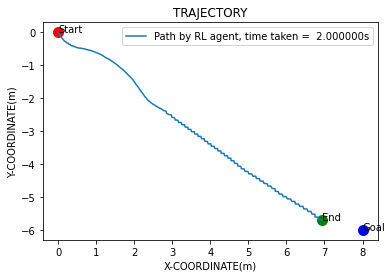

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 191      |
|    ep_rew_mean     | -151     |
| time/              |          |
|    episodes        | 363      |
|    fps             | 128      |
|    time_elapsed    | 542      |
|    total_timesteps | 69581    |
| train/             |          |
|    actor_loss      | 37.2     |
|    critic_loss     | 3.44     |
|    learning_rate   | 0.001    |
|    n_updates       | 19498    |
---------------------------------
EP_REWARD:-0.2310904175698838


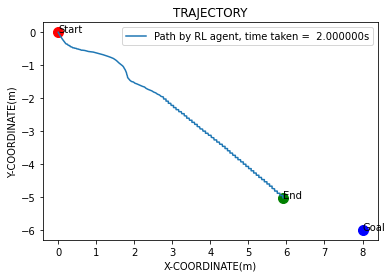

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 191      |
|    ep_rew_mean     | -150     |
| time/              |          |
|    episodes        | 364      |
|    fps             | 127      |
|    time_elapsed    | 546      |
|    total_timesteps | 69781    |
| train/             |          |
|    actor_loss      | 37.3     |
|    critic_loss     | 2.92     |
|    learning_rate   | 0.001    |
|    n_updates       | 19698    |
---------------------------------
EP_REWARD:-0.36047263557100373


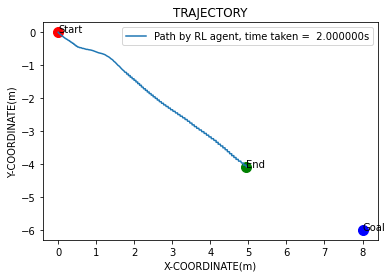

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 192      |
|    ep_rew_mean     | -149     |
| time/              |          |
|    episodes        | 365      |
|    fps             | 126      |
|    time_elapsed    | 551      |
|    total_timesteps | 69981    |
| train/             |          |
|    actor_loss      | 37.6     |
|    critic_loss     | 2.56     |
|    learning_rate   | 0.001    |
|    n_updates       | 19898    |
---------------------------------
EP_REWARD:-0.9890462676888494


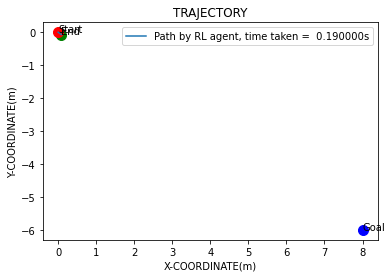

EP_REWARD:-0.11248340591214552


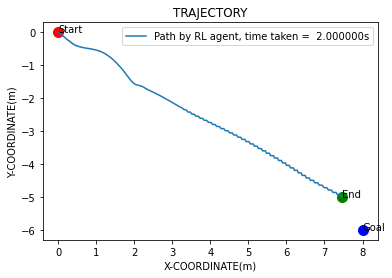

EP_REWARD:-0.11248340591214552


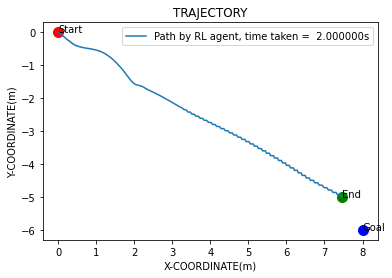

EP_REWARD:-0.11248340591214552


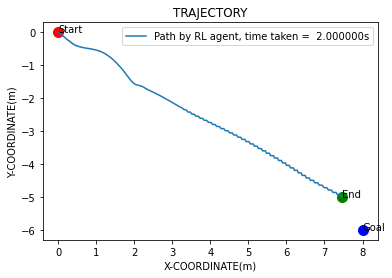

EP_REWARD:-0.11248340591214552


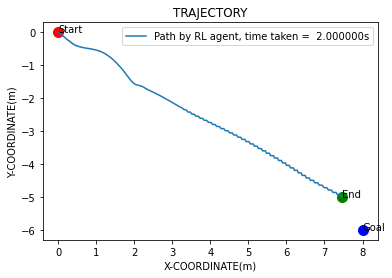

EP_REWARD:-0.11248340591214552


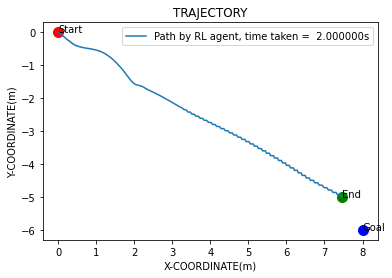

Eval num_timesteps=70000, episode_reward=-133.69 +/- 0.00
Episode length: 200.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 200      |
|    mean_reward     | -134     |
| time/              |          |
|    total_timesteps | 70000    |
| train/             |          |
|    actor_loss      | 37.7     |
|    critic_loss     | 2.13     |
|    learning_rate   | 0.001    |
|    n_updates       | 20098    |
---------------------------------
EP_REWARD:-0.11630954538617798


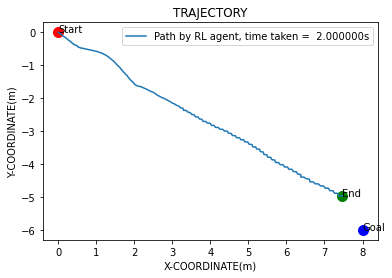

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 193      |
|    ep_rew_mean     | -148     |
| time/              |          |
|    episodes        | 366      |
|    fps             | 125      |
|    time_elapsed    | 557      |
|    total_timesteps | 70200    |
---------------------------------
EP_REWARD:2.2


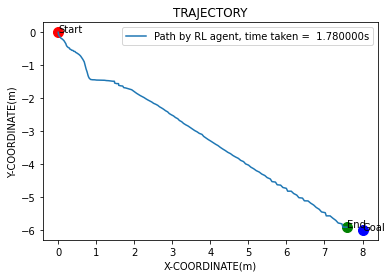

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 193      |
|    ep_rew_mean     | -147     |
| time/              |          |
|    episodes        | 367      |
|    fps             | 125      |
|    time_elapsed    | 562      |
|    total_timesteps | 70378    |
| train/             |          |
|    actor_loss      | 38       |
|    critic_loss     | 2.29     |
|    learning_rate   | 0.001    |
|    n_updates       | 20317    |
---------------------------------
EP_REWARD:1.3


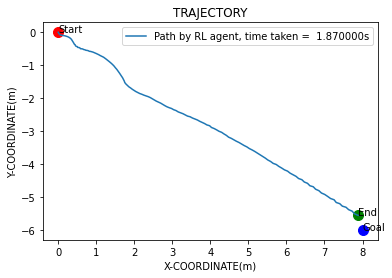

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 193      |
|    ep_rew_mean     | -147     |
| time/              |          |
|    episodes        | 368      |
|    fps             | 124      |
|    time_elapsed    | 566      |
|    total_timesteps | 70565    |
| train/             |          |
|    actor_loss      | 37.8     |
|    critic_loss     | 3.38     |
|    learning_rate   | 0.001    |
|    n_updates       | 20495    |
---------------------------------
EP_REWARD:-46


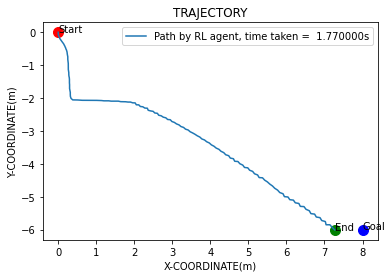

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 193      |
|    ep_rew_mean     | -147     |
| time/              |          |
|    episodes        | 369      |
|    fps             | 123      |
|    time_elapsed    | 570      |
|    total_timesteps | 70742    |
| train/             |          |
|    actor_loss      | 38.1     |
|    critic_loss     | 3.11     |
|    learning_rate   | 0.001    |
|    n_updates       | 20682    |
---------------------------------
EP_REWARD:1.8


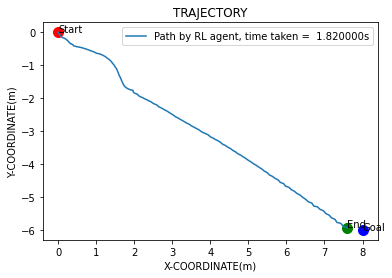

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 193      |
|    ep_rew_mean     | -146     |
| time/              |          |
|    episodes        | 370      |
|    fps             | 123      |
|    time_elapsed    | 574      |
|    total_timesteps | 70924    |
| train/             |          |
|    actor_loss      | 38.8     |
|    critic_loss     | 2.63     |
|    learning_rate   | 0.001    |
|    n_updates       | 20859    |
---------------------------------
EP_REWARD:-0.7337637058757198


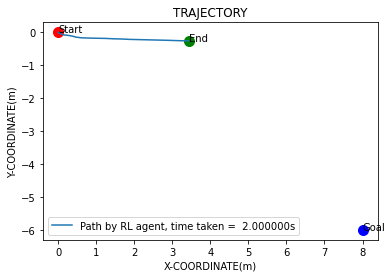

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 194      |
|    ep_rew_mean     | -146     |
| time/              |          |
|    episodes        | 371      |
|    fps             | 122      |
|    time_elapsed    | 578      |
|    total_timesteps | 71124    |
| train/             |          |
|    actor_loss      | 38.5     |
|    critic_loss     | 4.03     |
|    learning_rate   | 0.001    |
|    n_updates       | 21041    |
---------------------------------
EP_REWARD:0.5


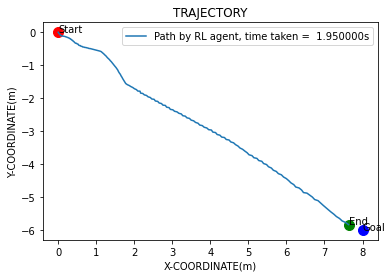

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 194      |
|    ep_rew_mean     | -146     |
| time/              |          |
|    episodes        | 372      |
|    fps             | 122      |
|    time_elapsed    | 583      |
|    total_timesteps | 71319    |
| train/             |          |
|    actor_loss      | 38.5     |
|    critic_loss     | 2        |
|    learning_rate   | 0.001    |
|    n_updates       | 21241    |
---------------------------------
EP_REWARD:-16


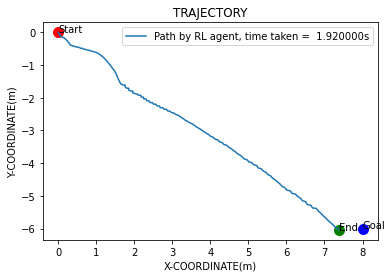

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 194      |
|    ep_rew_mean     | -147     |
| time/              |          |
|    episodes        | 373      |
|    fps             | 121      |
|    time_elapsed    | 587      |
|    total_timesteps | 71511    |
| train/             |          |
|    actor_loss      | 38.9     |
|    critic_loss     | 1.57     |
|    learning_rate   | 0.001    |
|    n_updates       | 21436    |
---------------------------------
EP_REWARD:1.0


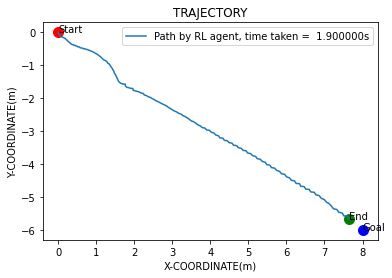

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 194      |
|    ep_rew_mean     | -146     |
| time/              |          |
|    episodes        | 374      |
|    fps             | 121      |
|    time_elapsed    | 591      |
|    total_timesteps | 71701    |
| train/             |          |
|    actor_loss      | 39       |
|    critic_loss     | 1.52     |
|    learning_rate   | 0.001    |
|    n_updates       | 21628    |
---------------------------------
EP_REWARD:1.9000000000000001


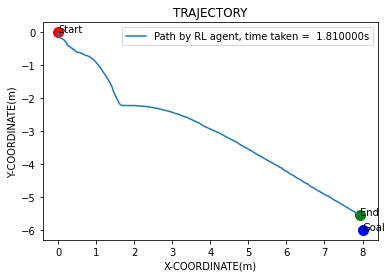

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 194      |
|    ep_rew_mean     | -146     |
| time/              |          |
|    episodes        | 375      |
|    fps             | 120      |
|    time_elapsed    | 596      |
|    total_timesteps | 71882    |
| train/             |          |
|    actor_loss      | 39.1     |
|    critic_loss     | 3.71     |
|    learning_rate   | 0.001    |
|    n_updates       | 21818    |
---------------------------------
EP_REWARD:0.5


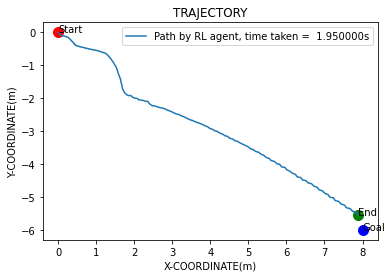

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 194      |
|    ep_rew_mean     | -146     |
| time/              |          |
|    episodes        | 376      |
|    fps             | 120      |
|    time_elapsed    | 600      |
|    total_timesteps | 72077    |
| train/             |          |
|    actor_loss      | 39.4     |
|    critic_loss     | 2.98     |
|    learning_rate   | 0.001    |
|    n_updates       | 21999    |
---------------------------------
EP_REWARD:0.5


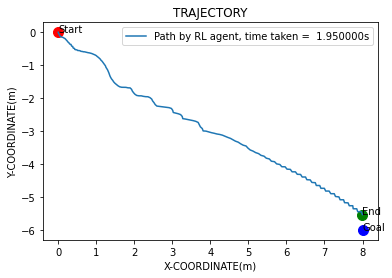

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 195      |
|    ep_rew_mean     | -146     |
| time/              |          |
|    episodes        | 377      |
|    fps             | 119      |
|    time_elapsed    | 604      |
|    total_timesteps | 72272    |
| train/             |          |
|    actor_loss      | 39.4     |
|    critic_loss     | 3.18     |
|    learning_rate   | 0.001    |
|    n_updates       | 22194    |
---------------------------------
EP_REWARD:-30


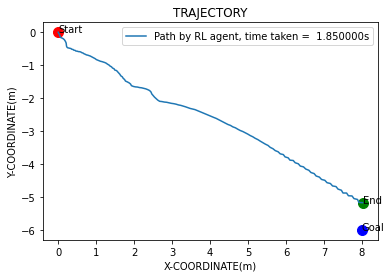

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 194      |
|    ep_rew_mean     | -146     |
| time/              |          |
|    episodes        | 378      |
|    fps             | 118      |
|    time_elapsed    | 608      |
|    total_timesteps | 72457    |
| train/             |          |
|    actor_loss      | 39.8     |
|    critic_loss     | 1.38     |
|    learning_rate   | 0.001    |
|    n_updates       | 22389    |
---------------------------------
EP_REWARD:-0.06954711883717761


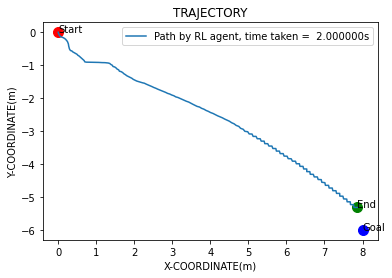

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 195      |
|    ep_rew_mean     | -147     |
| time/              |          |
|    episodes        | 379      |
|    fps             | 118      |
|    time_elapsed    | 613      |
|    total_timesteps | 72657    |
| train/             |          |
|    actor_loss      | 39.9     |
|    critic_loss     | 2.73     |
|    learning_rate   | 0.001    |
|    n_updates       | 22574    |
---------------------------------
EP_REWARD:-8


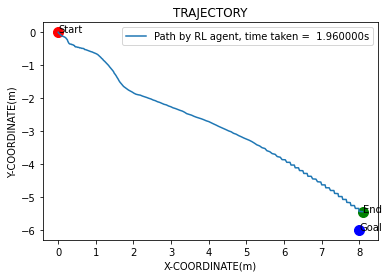

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 195      |
|    ep_rew_mean     | -146     |
| time/              |          |
|    episodes        | 380      |
|    fps             | 117      |
|    time_elapsed    | 617      |
|    total_timesteps | 72853    |
| train/             |          |
|    actor_loss      | 39.9     |
|    critic_loss     | 2.38     |
|    learning_rate   | 0.001    |
|    n_updates       | 22774    |
---------------------------------
EP_REWARD:1.0


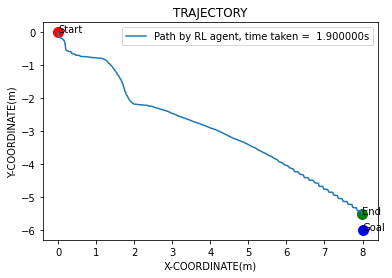

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 195      |
|    ep_rew_mean     | -146     |
| time/              |          |
|    episodes        | 381      |
|    fps             | 117      |
|    time_elapsed    | 622      |
|    total_timesteps | 73043    |
| train/             |          |
|    actor_loss      | 40.2     |
|    critic_loss     | 3.18     |
|    learning_rate   | 0.001    |
|    n_updates       | 22970    |
---------------------------------
EP_REWARD:1.5


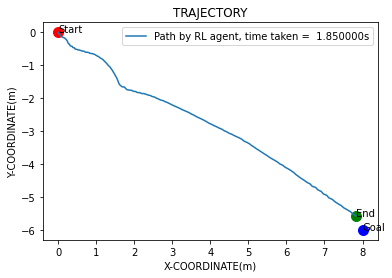

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 195      |
|    ep_rew_mean     | -146     |
| time/              |          |
|    episodes        | 382      |
|    fps             | 116      |
|    time_elapsed    | 626      |
|    total_timesteps | 73228    |
| train/             |          |
|    actor_loss      | 40.3     |
|    critic_loss     | 3.08     |
|    learning_rate   | 0.001    |
|    n_updates       | 23160    |
---------------------------------
EP_REWARD:1.9000000000000001


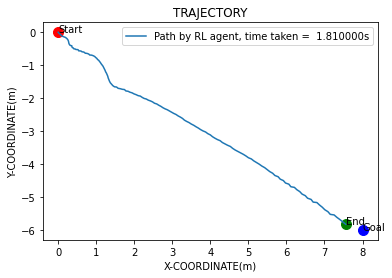

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 195      |
|    ep_rew_mean     | -147     |
| time/              |          |
|    episodes        | 383      |
|    fps             | 116      |
|    time_elapsed    | 630      |
|    total_timesteps | 73409    |
| train/             |          |
|    actor_loss      | 40.2     |
|    critic_loss     | 3.22     |
|    learning_rate   | 0.001    |
|    n_updates       | 23345    |
---------------------------------
EP_REWARD:2.0


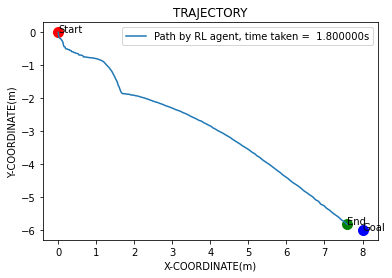

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 195      |
|    ep_rew_mean     | -147     |
| time/              |          |
|    episodes        | 384      |
|    fps             | 115      |
|    time_elapsed    | 634      |
|    total_timesteps | 73589    |
| train/             |          |
|    actor_loss      | 40.6     |
|    critic_loss     | 1.85     |
|    learning_rate   | 0.001    |
|    n_updates       | 23526    |
---------------------------------
EP_REWARD:2.3000000000000003


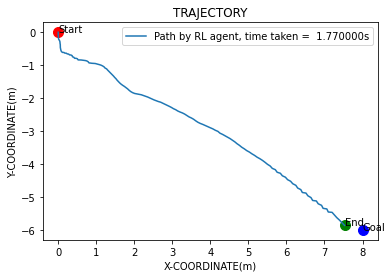

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 195      |
|    ep_rew_mean     | -146     |
| time/              |          |
|    episodes        | 385      |
|    fps             | 115      |
|    time_elapsed    | 638      |
|    total_timesteps | 73766    |
| train/             |          |
|    actor_loss      | 40.3     |
|    critic_loss     | 2.47     |
|    learning_rate   | 0.001    |
|    n_updates       | 23706    |
---------------------------------
EP_REWARD:1.0


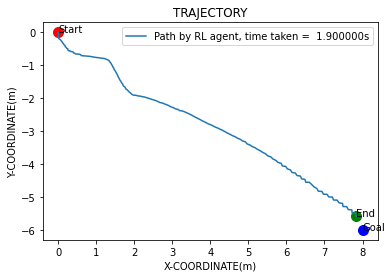

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 195      |
|    ep_rew_mean     | -146     |
| time/              |          |
|    episodes        | 386      |
|    fps             | 115      |
|    time_elapsed    | 642      |
|    total_timesteps | 73956    |
| train/             |          |
|    actor_loss      | 40.7     |
|    critic_loss     | 1.49     |
|    learning_rate   | 0.001    |
|    n_updates       | 23883    |
---------------------------------
EP_REWARD:0.30000000000000004


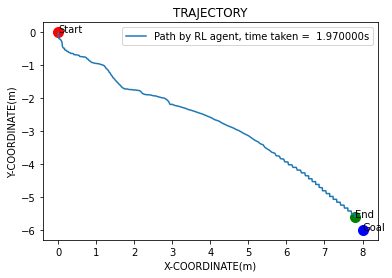

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 195      |
|    ep_rew_mean     | -146     |
| time/              |          |
|    episodes        | 387      |
|    fps             | 114      |
|    time_elapsed    | 647      |
|    total_timesteps | 74153    |
| train/             |          |
|    actor_loss      | 40.9     |
|    critic_loss     | 1.83     |
|    learning_rate   | 0.001    |
|    n_updates       | 24073    |
---------------------------------
EP_REWARD:1.4000000000000001


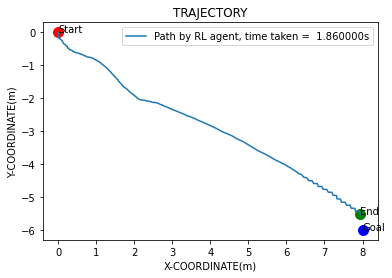

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 195      |
|    ep_rew_mean     | -147     |
| time/              |          |
|    episodes        | 388      |
|    fps             | 114      |
|    time_elapsed    | 651      |
|    total_timesteps | 74339    |
| train/             |          |
|    actor_loss      | 41       |
|    critic_loss     | 2.93     |
|    learning_rate   | 0.001    |
|    n_updates       | 24270    |
---------------------------------
EP_REWARD:1.5


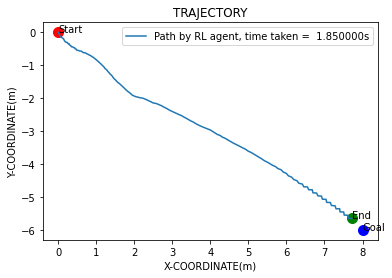

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 195      |
|    ep_rew_mean     | -147     |
| time/              |          |
|    episodes        | 389      |
|    fps             | 113      |
|    time_elapsed    | 655      |
|    total_timesteps | 74524    |
| train/             |          |
|    actor_loss      | 41       |
|    critic_loss     | 4.36     |
|    learning_rate   | 0.001    |
|    n_updates       | 24456    |
---------------------------------
EP_REWARD:1.6


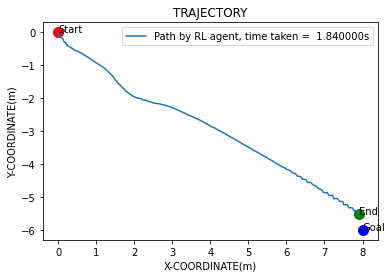

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 195      |
|    ep_rew_mean     | -146     |
| time/              |          |
|    episodes        | 390      |
|    fps             | 113      |
|    time_elapsed    | 660      |
|    total_timesteps | 74708    |
| train/             |          |
|    actor_loss      | 40.7     |
|    critic_loss     | 2.33     |
|    learning_rate   | 0.001    |
|    n_updates       | 24641    |
---------------------------------
EP_REWARD:2.5


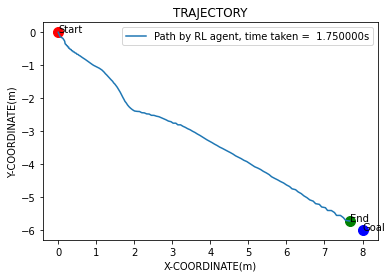

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 195      |
|    ep_rew_mean     | -146     |
| time/              |          |
|    episodes        | 391      |
|    fps             | 112      |
|    time_elapsed    | 664      |
|    total_timesteps | 74883    |
| train/             |          |
|    actor_loss      | 41.1     |
|    critic_loss     | 1.65     |
|    learning_rate   | 0.001    |
|    n_updates       | 24825    |
---------------------------------
EP_REWARD:-0.5749839284908268


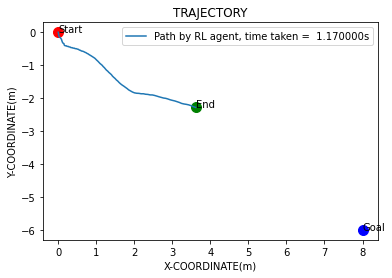

EP_REWARD:-32


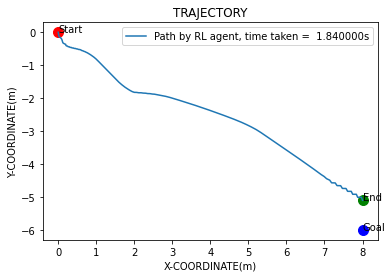

EP_REWARD:-32


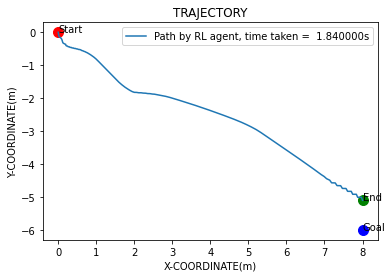

EP_REWARD:-32


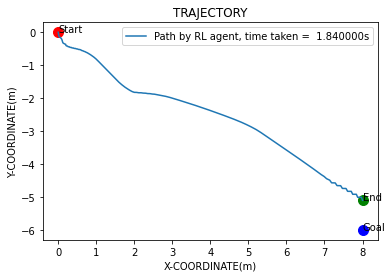

EP_REWARD:-32


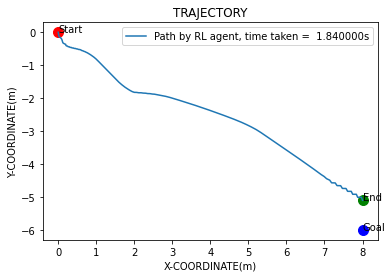

EP_REWARD:-32


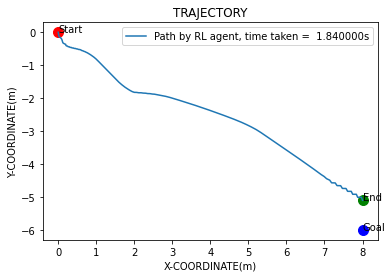

Eval num_timesteps=75000, episode_reward=-153.64 +/- 0.00
Episode length: 184.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 184      |
|    mean_reward     | -154     |
| time/              |          |
|    total_timesteps | 75000    |
| train/             |          |
|    actor_loss      | 41.3     |
|    critic_loss     | 3.32     |
|    learning_rate   | 0.001    |
|    n_updates       | 25000    |
---------------------------------
EP_REWARD:-14


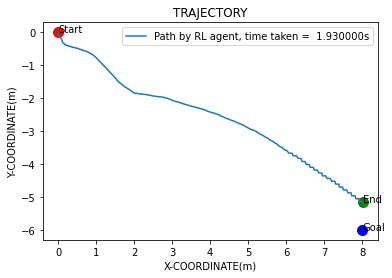

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 195      |
|    ep_rew_mean     | -146     |
| time/              |          |
|    episodes        | 392      |
|    fps             | 112      |
|    time_elapsed    | 669      |
|    total_timesteps | 75193    |
---------------------------------
EP_REWARD:-0.06909662655453193


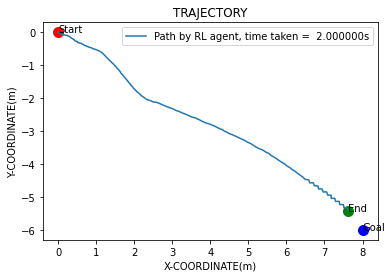

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 195      |
|    ep_rew_mean     | -146     |
| time/              |          |
|    episodes        | 393      |
|    fps             | 111      |
|    time_elapsed    | 676      |
|    total_timesteps | 75393    |
| train/             |          |
|    actor_loss      | 41.1     |
|    critic_loss     | 2.61     |
|    learning_rate   | 0.001    |
|    n_updates       | 25310    |
---------------------------------
EP_REWARD:0.7000000000000001


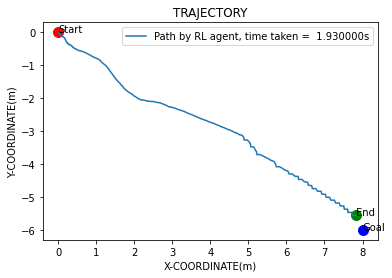

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 196      |
|    ep_rew_mean     | -146     |
| time/              |          |
|    episodes        | 394      |
|    fps             | 110      |
|    time_elapsed    | 681      |
|    total_timesteps | 75586    |
| train/             |          |
|    actor_loss      | 41.4     |
|    critic_loss     | 2.32     |
|    learning_rate   | 0.001    |
|    n_updates       | 25510    |
---------------------------------
EP_REWARD:-42


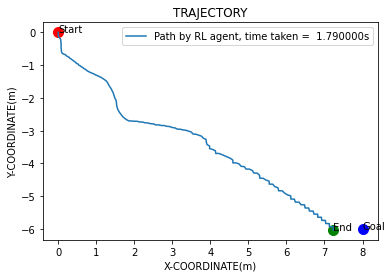

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 196      |
|    ep_rew_mean     | -147     |
| time/              |          |
|    episodes        | 395      |
|    fps             | 110      |
|    time_elapsed    | 685      |
|    total_timesteps | 75765    |
| train/             |          |
|    actor_loss      | 41.6     |
|    critic_loss     | 3.37     |
|    learning_rate   | 0.001    |
|    n_updates       | 25703    |
---------------------------------
EP_REWARD:1.2000000000000002


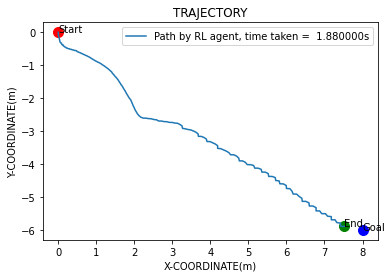

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 196      |
|    ep_rew_mean     | -147     |
| time/              |          |
|    episodes        | 396      |
|    fps             | 110      |
|    time_elapsed    | 689      |
|    total_timesteps | 75953    |
| train/             |          |
|    actor_loss      | 41.4     |
|    critic_loss     | 2.31     |
|    learning_rate   | 0.001    |
|    n_updates       | 25882    |
---------------------------------
EP_REWARD:-44


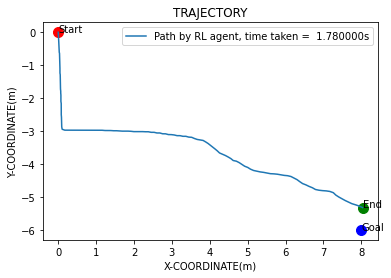

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 195      |
|    ep_rew_mean     | -147     |
| time/              |          |
|    episodes        | 397      |
|    fps             | 109      |
|    time_elapsed    | 696      |
|    total_timesteps | 76131    |
| train/             |          |
|    actor_loss      | 41.6     |
|    critic_loss     | 3.94     |
|    learning_rate   | 0.001    |
|    n_updates       | 26070    |
---------------------------------
EP_REWARD:-0.11412430194931494


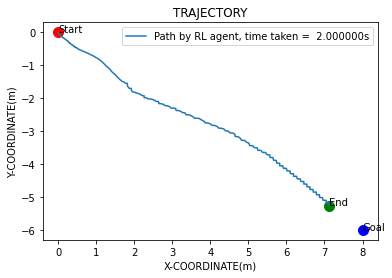

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 196      |
|    ep_rew_mean     | -147     |
| time/              |          |
|    episodes        | 398      |
|    fps             | 13       |
|    time_elapsed    | 5747     |
|    total_timesteps | 76331    |
| train/             |          |
|    actor_loss      | 42       |
|    critic_loss     | 2.88     |
|    learning_rate   | 0.001    |
|    n_updates       | 26248    |
---------------------------------
EP_REWARD:-0.06708332378807369


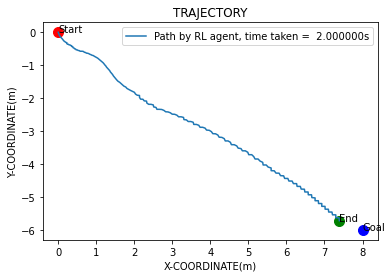

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 196      |
|    ep_rew_mean     | -147     |
| time/              |          |
|    episodes        | 399      |
|    fps             | 13       |
|    time_elapsed    | 5753     |
|    total_timesteps | 76531    |
| train/             |          |
|    actor_loss      | 41.9     |
|    critic_loss     | 2.76     |
|    learning_rate   | 0.001    |
|    n_updates       | 26448    |
---------------------------------
EP_REWARD:0.6000000000000001


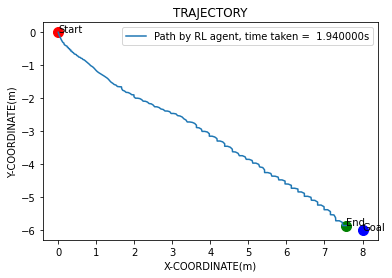

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 196      |
|    ep_rew_mean     | -147     |
| time/              |          |
|    episodes        | 400      |
|    fps             | 13       |
|    time_elapsed    | 5758     |
|    total_timesteps | 76725    |
| train/             |          |
|    actor_loss      | 41.9     |
|    critic_loss     | 2.28     |
|    learning_rate   | 0.001    |
|    n_updates       | 26648    |
---------------------------------
EP_REWARD:-0.13594985743561058


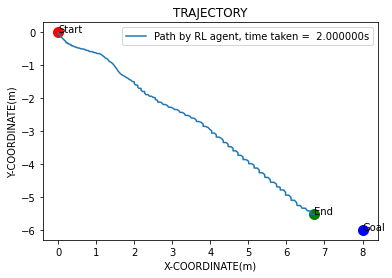

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 196      |
|    ep_rew_mean     | -147     |
| time/              |          |
|    episodes        | 401      |
|    fps             | 13       |
|    time_elapsed    | 5762     |
|    total_timesteps | 76925    |
| train/             |          |
|    actor_loss      | 42.1     |
|    critic_loss     | 2.85     |
|    learning_rate   | 0.001    |
|    n_updates       | 26842    |
---------------------------------
EP_REWARD:-0.21033239802092052


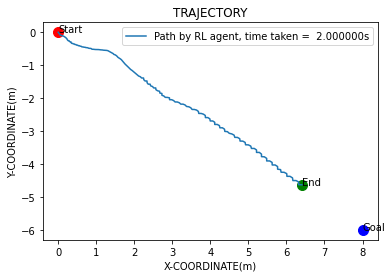

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 196      |
|    ep_rew_mean     | -147     |
| time/              |          |
|    episodes        | 402      |
|    fps             | 13       |
|    time_elapsed    | 5767     |
|    total_timesteps | 77125    |
| train/             |          |
|    actor_loss      | 42.3     |
|    critic_loss     | 3.4      |
|    learning_rate   | 0.001    |
|    n_updates       | 27042    |
---------------------------------
EP_REWARD:-0.13504856339690002


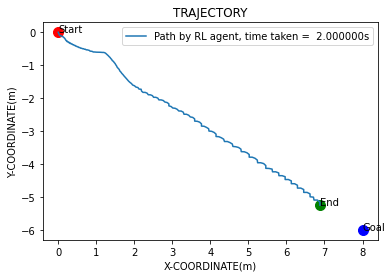

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 196      |
|    ep_rew_mean     | -146     |
| time/              |          |
|    episodes        | 403      |
|    fps             | 13       |
|    time_elapsed    | 5770     |
|    total_timesteps | 77325    |
| train/             |          |
|    actor_loss      | 42.6     |
|    critic_loss     | 2.23     |
|    learning_rate   | 0.001    |
|    n_updates       | 27242    |
---------------------------------
EP_REWARD:-0.16076018055556865


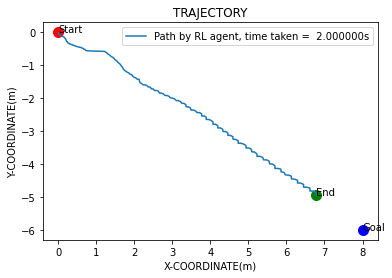

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 196      |
|    ep_rew_mean     | -146     |
| time/              |          |
|    episodes        | 404      |
|    fps             | 13       |
|    time_elapsed    | 5774     |
|    total_timesteps | 77525    |
| train/             |          |
|    actor_loss      | 42.3     |
|    critic_loss     | 2.58     |
|    learning_rate   | 0.001    |
|    n_updates       | 27442    |
---------------------------------
EP_REWARD:-0.09815793042738541


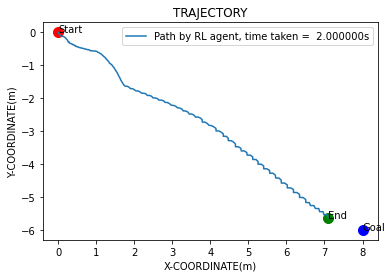

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 196      |
|    ep_rew_mean     | -146     |
| time/              |          |
|    episodes        | 405      |
|    fps             | 13       |
|    time_elapsed    | 5778     |
|    total_timesteps | 77725    |
| train/             |          |
|    actor_loss      | 42.3     |
|    critic_loss     | 4.63     |
|    learning_rate   | 0.001    |
|    n_updates       | 27642    |
---------------------------------
EP_REWARD:-0.12662402027941552


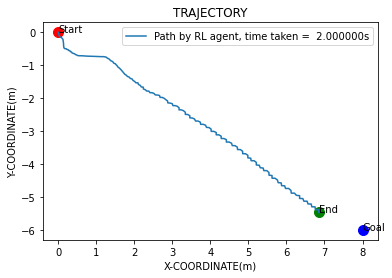

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 196      |
|    ep_rew_mean     | -146     |
| time/              |          |
|    episodes        | 406      |
|    fps             | 13       |
|    time_elapsed    | 5782     |
|    total_timesteps | 77925    |
| train/             |          |
|    actor_loss      | 42.5     |
|    critic_loss     | 3.69     |
|    learning_rate   | 0.001    |
|    n_updates       | 27842    |
---------------------------------
EP_REWARD:-0.09568637937611453


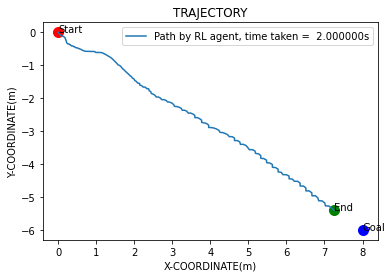

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 196      |
|    ep_rew_mean     | -145     |
| time/              |          |
|    episodes        | 407      |
|    fps             | 13       |
|    time_elapsed    | 5786     |
|    total_timesteps | 78125    |
| train/             |          |
|    actor_loss      | 42.7     |
|    critic_loss     | 2.85     |
|    learning_rate   | 0.001    |
|    n_updates       | 28042    |
---------------------------------
EP_REWARD:0.2


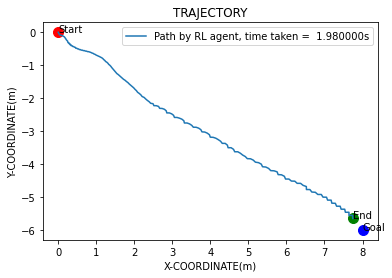

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 196      |
|    ep_rew_mean     | -144     |
| time/              |          |
|    episodes        | 408      |
|    fps             | 13       |
|    time_elapsed    | 5790     |
|    total_timesteps | 78323    |
| train/             |          |
|    actor_loss      | 43.1     |
|    critic_loss     | 3.36     |
|    learning_rate   | 0.001    |
|    n_updates       | 28242    |
---------------------------------
EP_REWARD:-16


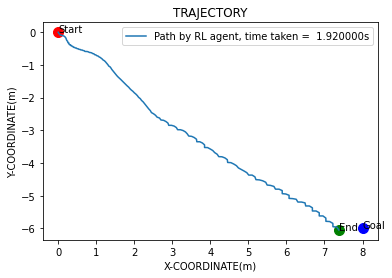

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 196      |
|    ep_rew_mean     | -144     |
| time/              |          |
|    episodes        | 409      |
|    fps             | 13       |
|    time_elapsed    | 5793     |
|    total_timesteps | 78515    |
| train/             |          |
|    actor_loss      | 42.7     |
|    critic_loss     | 3.15     |
|    learning_rate   | 0.001    |
|    n_updates       | 28440    |
---------------------------------
EP_REWARD:-0.1449351376383812


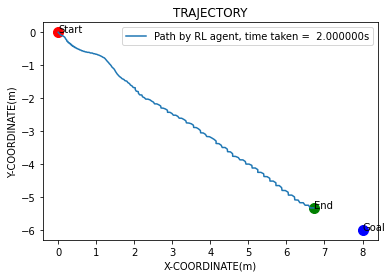

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 196      |
|    ep_rew_mean     | -144     |
| time/              |          |
|    episodes        | 410      |
|    fps             | 13       |
|    time_elapsed    | 5798     |
|    total_timesteps | 78715    |
| train/             |          |
|    actor_loss      | 43       |
|    critic_loss     | 3.07     |
|    learning_rate   | 0.001    |
|    n_updates       | 28632    |
---------------------------------
EP_REWARD:-10


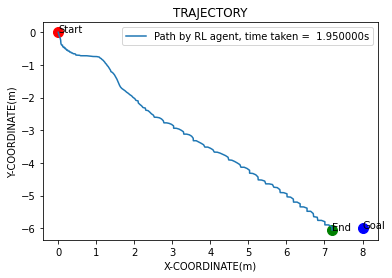

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 196      |
|    ep_rew_mean     | -144     |
| time/              |          |
|    episodes        | 411      |
|    fps             | 13       |
|    time_elapsed    | 5802     |
|    total_timesteps | 78910    |
| train/             |          |
|    actor_loss      | 43       |
|    critic_loss     | 2.7      |
|    learning_rate   | 0.001    |
|    n_updates       | 28832    |
---------------------------------
EP_REWARD:-0.14538759327691078


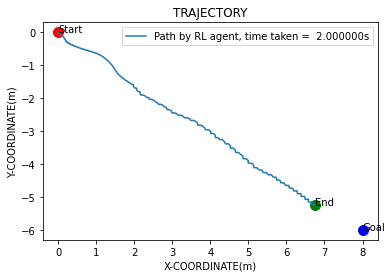

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 196      |
|    ep_rew_mean     | -144     |
| time/              |          |
|    episodes        | 412      |
|    fps             | 13       |
|    time_elapsed    | 5806     |
|    total_timesteps | 79110    |
| train/             |          |
|    actor_loss      | 43.2     |
|    critic_loss     | 3.47     |
|    learning_rate   | 0.001    |
|    n_updates       | 29027    |
---------------------------------
EP_REWARD:-0.25865203904219924


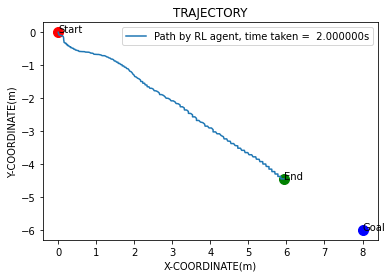

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 196      |
|    ep_rew_mean     | -144     |
| time/              |          |
|    episodes        | 413      |
|    fps             | 13       |
|    time_elapsed    | 5810     |
|    total_timesteps | 79310    |
| train/             |          |
|    actor_loss      | 43.2     |
|    critic_loss     | 3.12     |
|    learning_rate   | 0.001    |
|    n_updates       | 29227    |
---------------------------------
EP_REWARD:-0.1252884276217238


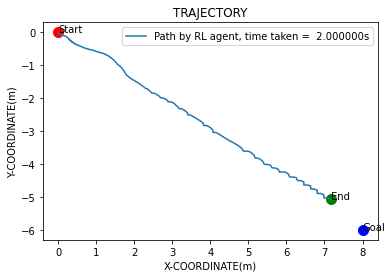

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 196      |
|    ep_rew_mean     | -144     |
| time/              |          |
|    episodes        | 414      |
|    fps             | 13       |
|    time_elapsed    | 5815     |
|    total_timesteps | 79510    |
| train/             |          |
|    actor_loss      | 43.1     |
|    critic_loss     | 2.83     |
|    learning_rate   | 0.001    |
|    n_updates       | 29427    |
---------------------------------
EP_REWARD:-0.12546085873552748


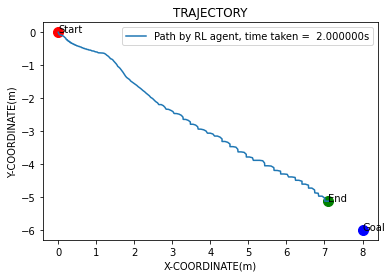

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 196      |
|    ep_rew_mean     | -144     |
| time/              |          |
|    episodes        | 415      |
|    fps             | 13       |
|    time_elapsed    | 5820     |
|    total_timesteps | 79710    |
| train/             |          |
|    actor_loss      | 43.3     |
|    critic_loss     | 2.46     |
|    learning_rate   | 0.001    |
|    n_updates       | 29627    |
---------------------------------
EP_REWARD:0.2


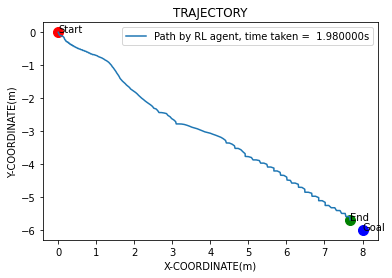

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 196      |
|    ep_rew_mean     | -143     |
| time/              |          |
|    episodes        | 416      |
|    fps             | 13       |
|    time_elapsed    | 5825     |
|    total_timesteps | 79908    |
| train/             |          |
|    actor_loss      | 43.3     |
|    critic_loss     | 2.75     |
|    learning_rate   | 0.001    |
|    n_updates       | 29827    |
---------------------------------
EP_REWARD:-0.8008543391355121


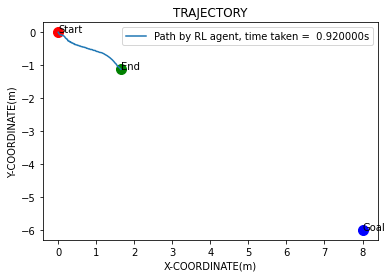

EP_REWARD:-0.05425911116652574


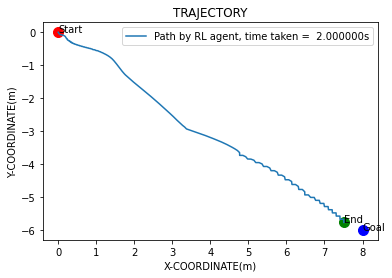

EP_REWARD:-0.05425911116652574


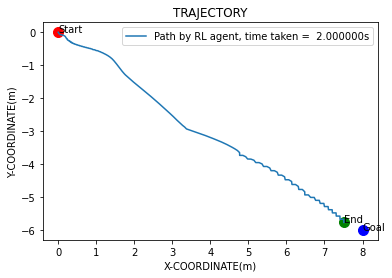

EP_REWARD:-0.05425911116652574


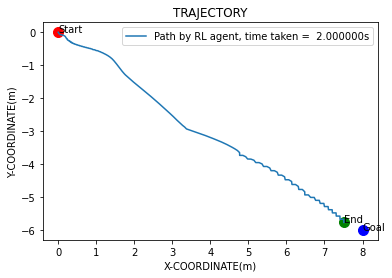

EP_REWARD:-0.05425911116652574


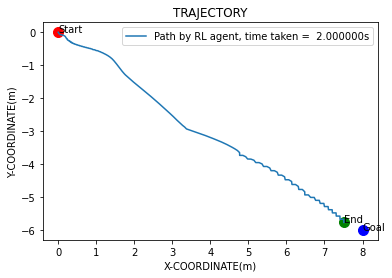

EP_REWARD:-0.05425911116652574


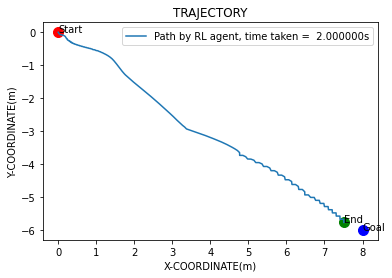

Eval num_timesteps=80000, episode_reward=-133.83 +/- 0.00
Episode length: 200.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 200      |
|    mean_reward     | -134     |
| time/              |          |
|    total_timesteps | 80000    |
| train/             |          |
|    actor_loss      | 43.5     |
|    critic_loss     | 1.86     |
|    learning_rate   | 0.001    |
|    n_updates       | 30025    |
---------------------------------
EP_REWARD:-0.08313583946859356


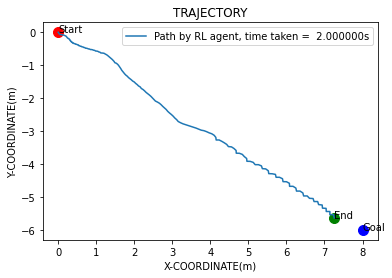

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 196      |
|    ep_rew_mean     | -143     |
| time/              |          |
|    episodes        | 417      |
|    fps             | 13       |
|    time_elapsed    | 5831     |
|    total_timesteps | 80200    |
---------------------------------
EP_REWARD:-4


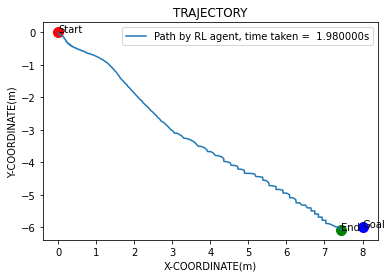

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 196      |
|    ep_rew_mean     | -142     |
| time/              |          |
|    episodes        | 418      |
|    fps             | 13       |
|    time_elapsed    | 5838     |
|    total_timesteps | 80398    |
| train/             |          |
|    actor_loss      | 43.5     |
|    critic_loss     | 3.45     |
|    learning_rate   | 0.001    |
|    n_updates       | 30317    |
---------------------------------
EP_REWARD:-0.09162529332279933


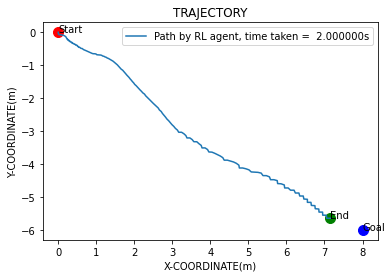

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 196      |
|    ep_rew_mean     | -141     |
| time/              |          |
|    episodes        | 419      |
|    fps             | 13       |
|    time_elapsed    | 5843     |
|    total_timesteps | 80598    |
| train/             |          |
|    actor_loss      | 43.8     |
|    critic_loss     | 2.28     |
|    learning_rate   | 0.001    |
|    n_updates       | 30515    |
---------------------------------
EP_REWARD:0.30000000000000004


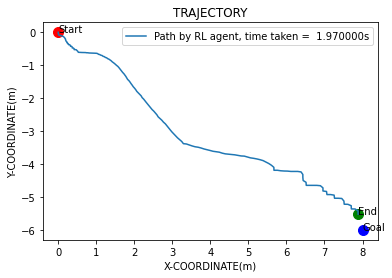

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 196      |
|    ep_rew_mean     | -141     |
| time/              |          |
|    episodes        | 420      |
|    fps             | 13       |
|    time_elapsed    | 5848     |
|    total_timesteps | 80795    |
| train/             |          |
|    actor_loss      | 43.6     |
|    critic_loss     | 2.67     |
|    learning_rate   | 0.001    |
|    n_updates       | 30715    |
---------------------------------
EP_REWARD:-0.13321148741123265


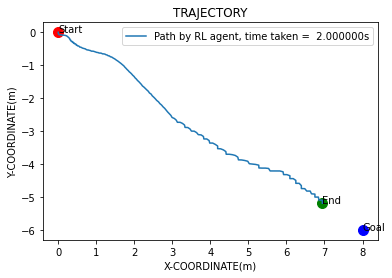

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 196      |
|    ep_rew_mean     | -140     |
| time/              |          |
|    episodes        | 421      |
|    fps             | 13       |
|    time_elapsed    | 5852     |
|    total_timesteps | 80995    |
| train/             |          |
|    actor_loss      | 43.8     |
|    critic_loss     | 4.28     |
|    learning_rate   | 0.001    |
|    n_updates       | 30912    |
---------------------------------
EP_REWARD:-0.06282097818793243


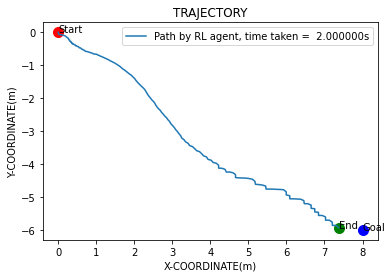

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 196      |
|    ep_rew_mean     | -140     |
| time/              |          |
|    episodes        | 422      |
|    fps             | 13       |
|    time_elapsed    | 5857     |
|    total_timesteps | 81195    |
| train/             |          |
|    actor_loss      | 44.3     |
|    critic_loss     | 2.63     |
|    learning_rate   | 0.001    |
|    n_updates       | 31112    |
---------------------------------
EP_REWARD:-0.0808342308847113


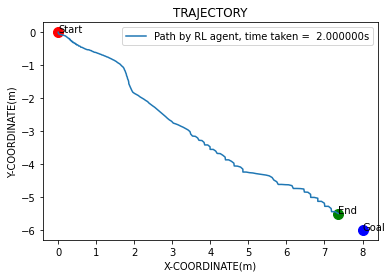

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 196      |
|    ep_rew_mean     | -139     |
| time/              |          |
|    episodes        | 423      |
|    fps             | 13       |
|    time_elapsed    | 5862     |
|    total_timesteps | 81395    |
| train/             |          |
|    actor_loss      | 43.9     |
|    critic_loss     | 2.28     |
|    learning_rate   | 0.001    |
|    n_updates       | 31312    |
---------------------------------
EP_REWARD:-0.06121849035398596


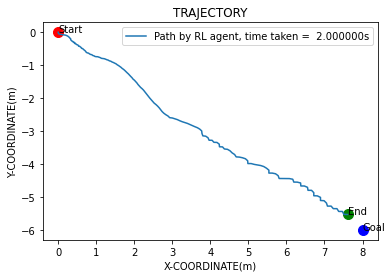

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 196      |
|    ep_rew_mean     | -138     |
| time/              |          |
|    episodes        | 424      |
|    fps             | 13       |
|    time_elapsed    | 5866     |
|    total_timesteps | 81595    |
| train/             |          |
|    actor_loss      | 44.1     |
|    critic_loss     | 1.7      |
|    learning_rate   | 0.001    |
|    n_updates       | 31512    |
---------------------------------
EP_REWARD:-0.12245884241257693


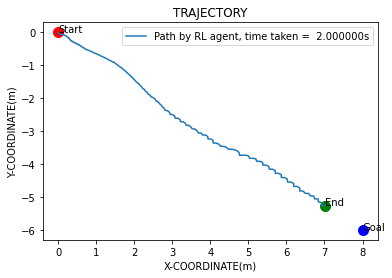

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 196      |
|    ep_rew_mean     | -138     |
| time/              |          |
|    episodes        | 425      |
|    fps             | 13       |
|    time_elapsed    | 5871     |
|    total_timesteps | 81795    |
| train/             |          |
|    actor_loss      | 44.1     |
|    critic_loss     | 2.62     |
|    learning_rate   | 0.001    |
|    n_updates       | 31712    |
---------------------------------
EP_REWARD:0.8


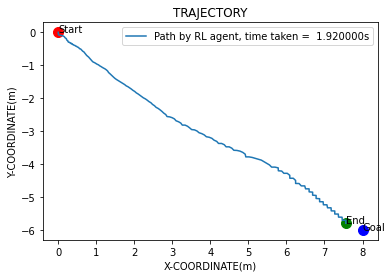

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 195      |
|    ep_rew_mean     | -137     |
| time/              |          |
|    episodes        | 426      |
|    fps             | 13       |
|    time_elapsed    | 5876     |
|    total_timesteps | 81987    |
| train/             |          |
|    actor_loss      | 44       |
|    critic_loss     | 3.16     |
|    learning_rate   | 0.001    |
|    n_updates       | 31912    |
---------------------------------
EP_REWARD:0.0


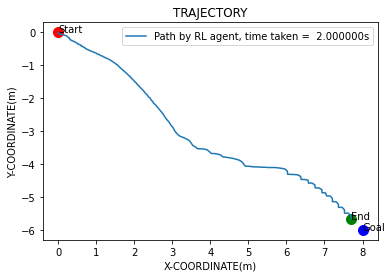

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 195      |
|    ep_rew_mean     | -137     |
| time/              |          |
|    episodes        | 427      |
|    fps             | 13       |
|    time_elapsed    | 5880     |
|    total_timesteps | 82187    |
| train/             |          |
|    actor_loss      | 44.3     |
|    critic_loss     | 1.98     |
|    learning_rate   | 0.001    |
|    n_updates       | 32104    |
---------------------------------
EP_REWARD:-24


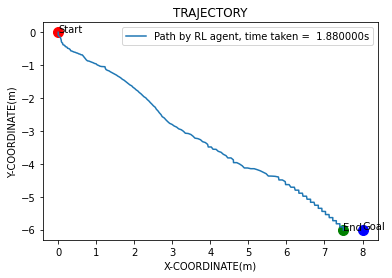

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 195      |
|    ep_rew_mean     | -137     |
| time/              |          |
|    episodes        | 428      |
|    fps             | 13       |
|    time_elapsed    | 5885     |
|    total_timesteps | 82375    |
| train/             |          |
|    actor_loss      | 44       |
|    critic_loss     | 3.01     |
|    learning_rate   | 0.001    |
|    n_updates       | 32304    |
---------------------------------
EP_REWARD:0.9


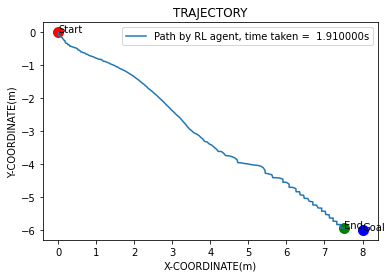

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 195      |
|    ep_rew_mean     | -137     |
| time/              |          |
|    episodes        | 429      |
|    fps             | 14       |
|    time_elapsed    | 5889     |
|    total_timesteps | 82566    |
| train/             |          |
|    actor_loss      | 44.2     |
|    critic_loss     | 3.21     |
|    learning_rate   | 0.001    |
|    n_updates       | 32492    |
---------------------------------
EP_REWARD:-0.07922632518791356


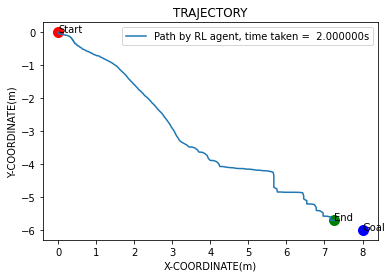

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 195      |
|    ep_rew_mean     | -137     |
| time/              |          |
|    episodes        | 430      |
|    fps             | 14       |
|    time_elapsed    | 5894     |
|    total_timesteps | 82766    |
| train/             |          |
|    actor_loss      | 44.2     |
|    critic_loss     | 2.63     |
|    learning_rate   | 0.001    |
|    n_updates       | 32683    |
---------------------------------
EP_REWARD:-46


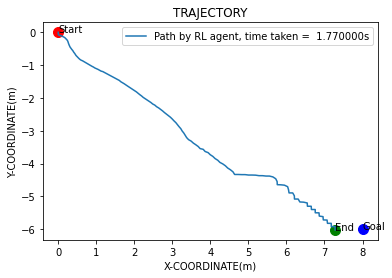

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 195      |
|    ep_rew_mean     | -137     |
| time/              |          |
|    episodes        | 431      |
|    fps             | 14       |
|    time_elapsed    | 5899     |
|    total_timesteps | 82943    |
| train/             |          |
|    actor_loss      | 44.4     |
|    critic_loss     | 2.8      |
|    learning_rate   | 0.001    |
|    n_updates       | 32883    |
---------------------------------
EP_REWARD:-0.058068558710108575


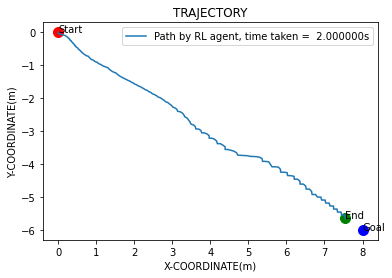

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 195      |
|    ep_rew_mean     | -136     |
| time/              |          |
|    episodes        | 432      |
|    fps             | 14       |
|    time_elapsed    | 5903     |
|    total_timesteps | 83143    |
| train/             |          |
|    actor_loss      | 44.3     |
|    critic_loss     | 2.85     |
|    learning_rate   | 0.001    |
|    n_updates       | 33060    |
---------------------------------
EP_REWARD:2.1


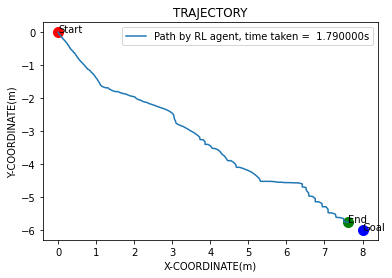

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 195      |
|    ep_rew_mean     | -136     |
| time/              |          |
|    episodes        | 433      |
|    fps             | 14       |
|    time_elapsed    | 5908     |
|    total_timesteps | 83322    |
| train/             |          |
|    actor_loss      | 44.6     |
|    critic_loss     | 2.51     |
|    learning_rate   | 0.001    |
|    n_updates       | 33260    |
---------------------------------
EP_REWARD:0.7000000000000001


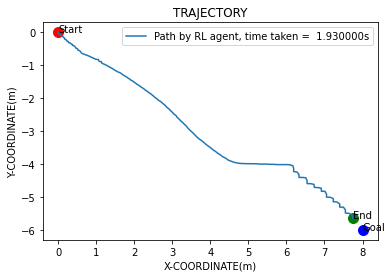

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 195      |
|    ep_rew_mean     | -136     |
| time/              |          |
|    episodes        | 434      |
|    fps             | 14       |
|    time_elapsed    | 5913     |
|    total_timesteps | 83515    |
| train/             |          |
|    actor_loss      | 44.2     |
|    critic_loss     | 2.81     |
|    learning_rate   | 0.001    |
|    n_updates       | 33439    |
---------------------------------
EP_REWARD:1.2000000000000002


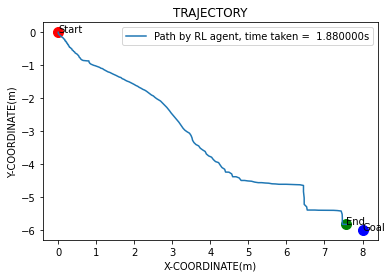

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 195      |
|    ep_rew_mean     | -136     |
| time/              |          |
|    episodes        | 435      |
|    fps             | 14       |
|    time_elapsed    | 5918     |
|    total_timesteps | 83703    |
| train/             |          |
|    actor_loss      | 44.6     |
|    critic_loss     | 2.6      |
|    learning_rate   | 0.001    |
|    n_updates       | 33632    |
---------------------------------
EP_REWARD:0.4


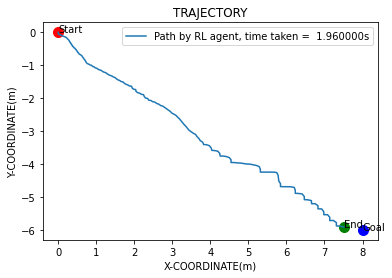

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 195      |
|    ep_rew_mean     | -135     |
| time/              |          |
|    episodes        | 436      |
|    fps             | 14       |
|    time_elapsed    | 5923     |
|    total_timesteps | 83899    |
| train/             |          |
|    actor_loss      | 45.1     |
|    critic_loss     | 3.52     |
|    learning_rate   | 0.001    |
|    n_updates       | 33820    |
---------------------------------
EP_REWARD:0.4


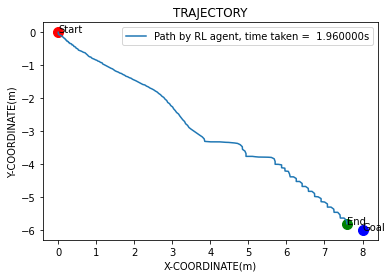

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 195      |
|    ep_rew_mean     | -135     |
| time/              |          |
|    episodes        | 437      |
|    fps             | 14       |
|    time_elapsed    | 5928     |
|    total_timesteps | 84095    |
| train/             |          |
|    actor_loss      | 44.9     |
|    critic_loss     | 2.14     |
|    learning_rate   | 0.001    |
|    n_updates       | 34016    |
---------------------------------
EP_REWARD:0.0


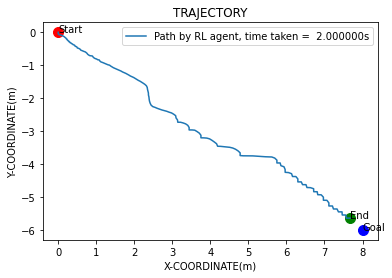

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 195      |
|    ep_rew_mean     | -135     |
| time/              |          |
|    episodes        | 438      |
|    fps             | 14       |
|    time_elapsed    | 5933     |
|    total_timesteps | 84295    |
| train/             |          |
|    actor_loss      | 45.3     |
|    critic_loss     | 2.97     |
|    learning_rate   | 0.001    |
|    n_updates       | 34212    |
---------------------------------
EP_REWARD:0.9


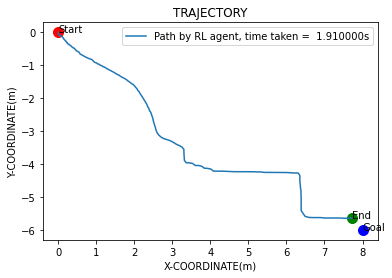

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 195      |
|    ep_rew_mean     | -135     |
| time/              |          |
|    episodes        | 439      |
|    fps             | 14       |
|    time_elapsed    | 5938     |
|    total_timesteps | 84486    |
| train/             |          |
|    actor_loss      | 45.2     |
|    critic_loss     | 2.92     |
|    learning_rate   | 0.001    |
|    n_updates       | 34412    |
---------------------------------
EP_REWARD:-0.0697358358971775


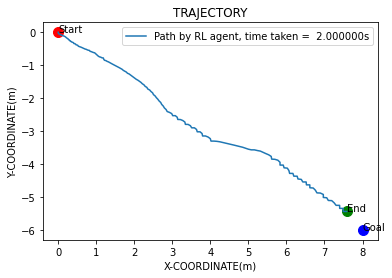

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 195      |
|    ep_rew_mean     | -135     |
| time/              |          |
|    episodes        | 440      |
|    fps             | 14       |
|    time_elapsed    | 5943     |
|    total_timesteps | 84686    |
| train/             |          |
|    actor_loss      | 44.7     |
|    critic_loss     | 2.72     |
|    learning_rate   | 0.001    |
|    n_updates       | 34603    |
---------------------------------
EP_REWARD:0.8


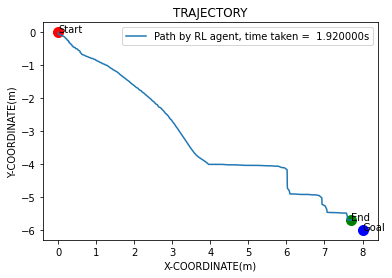

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 194      |
|    ep_rew_mean     | -135     |
| time/              |          |
|    episodes        | 441      |
|    fps             | 14       |
|    time_elapsed    | 5948     |
|    total_timesteps | 84878    |
| train/             |          |
|    actor_loss      | 44.9     |
|    critic_loss     | 2.63     |
|    learning_rate   | 0.001    |
|    n_updates       | 34803    |
---------------------------------
EP_REWARD:-0.6011861179497977


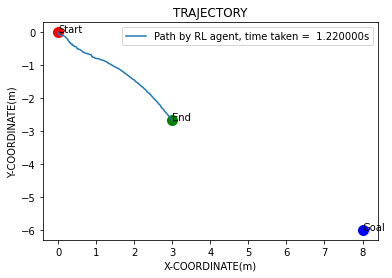

EP_REWARD:0.4


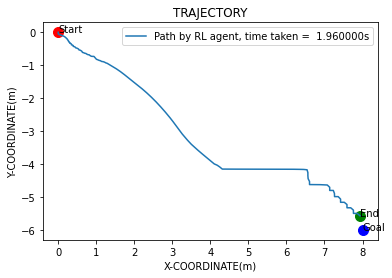

EP_REWARD:0.4


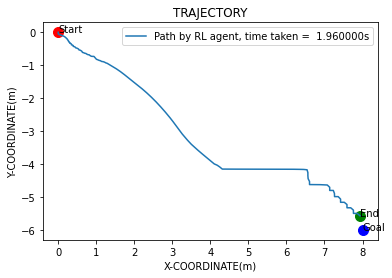

EP_REWARD:0.4


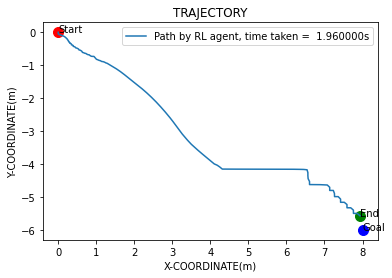

EP_REWARD:0.4


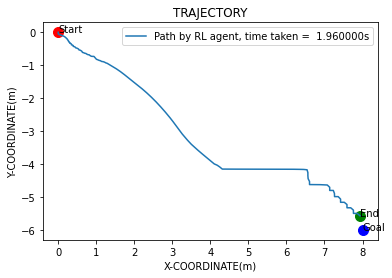

EP_REWARD:0.4


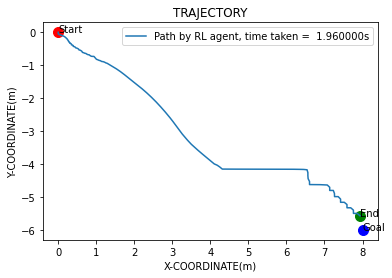

Eval num_timesteps=85000, episode_reward=-127.41 +/- 0.00
Episode length: 196.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 196      |
|    mean_reward     | -127     |
| time/              |          |
|    total_timesteps | 85000    |
| train/             |          |
|    actor_loss      | 45.2     |
|    critic_loss     | 2.05     |
|    learning_rate   | 0.001    |
|    n_updates       | 34995    |
---------------------------------
EP_REWARD:0.30000000000000004


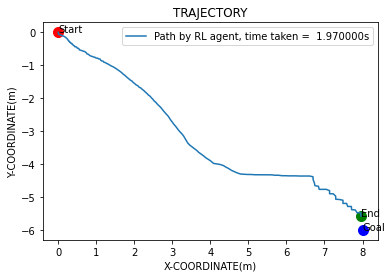

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 194      |
|    ep_rew_mean     | -135     |
| time/              |          |
|    episodes        | 442      |
|    fps             | 14       |
|    time_elapsed    | 5955     |
|    total_timesteps | 85197    |
---------------------------------
EP_REWARD:1.3


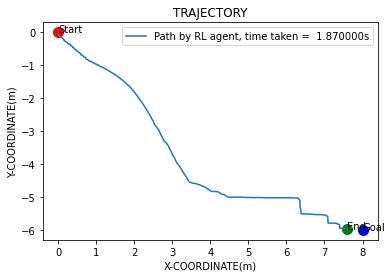

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 194      |
|    ep_rew_mean     | -134     |
| time/              |          |
|    episodes        | 443      |
|    fps             | 14       |
|    time_elapsed    | 5963     |
|    total_timesteps | 85384    |
| train/             |          |
|    actor_loss      | 45.3     |
|    critic_loss     | 2.61     |
|    learning_rate   | 0.001    |
|    n_updates       | 35314    |
---------------------------------
EP_REWARD:-6


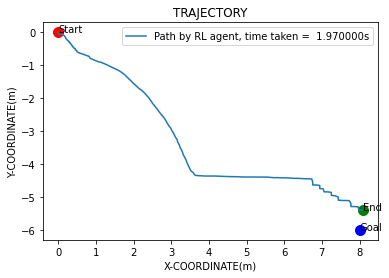

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 194      |
|    ep_rew_mean     | -134     |
| time/              |          |
|    episodes        | 444      |
|    fps             | 14       |
|    time_elapsed    | 5968     |
|    total_timesteps | 85581    |
| train/             |          |
|    actor_loss      | 44.8     |
|    critic_loss     | 3.05     |
|    learning_rate   | 0.001    |
|    n_updates       | 35501    |
---------------------------------
EP_REWARD:-14


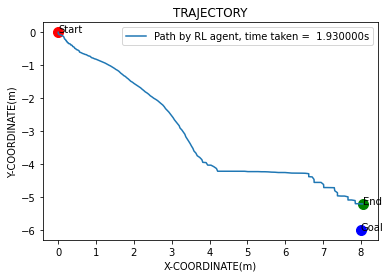

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 194      |
|    ep_rew_mean     | -134     |
| time/              |          |
|    episodes        | 445      |
|    fps             | 14       |
|    time_elapsed    | 5973     |
|    total_timesteps | 85774    |
| train/             |          |
|    actor_loss      | 44.8     |
|    critic_loss     | 1.42     |
|    learning_rate   | 0.001    |
|    n_updates       | 35698    |
---------------------------------
EP_REWARD:1.2000000000000002


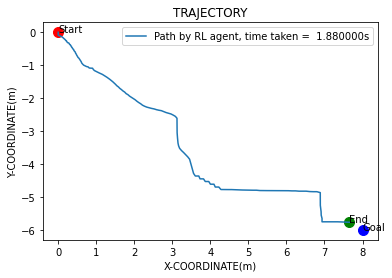

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 194      |
|    ep_rew_mean     | -134     |
| time/              |          |
|    episodes        | 446      |
|    fps             | 14       |
|    time_elapsed    | 5978     |
|    total_timesteps | 85962    |
| train/             |          |
|    actor_loss      | 45.4     |
|    critic_loss     | 2.48     |
|    learning_rate   | 0.001    |
|    n_updates       | 35891    |
---------------------------------
EP_REWARD:0.8


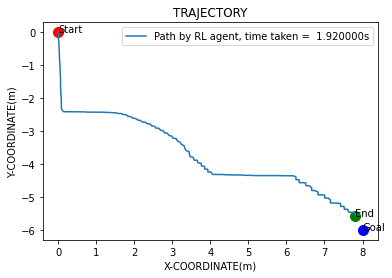

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 194      |
|    ep_rew_mean     | -134     |
| time/              |          |
|    episodes        | 447      |
|    fps             | 14       |
|    time_elapsed    | 5983     |
|    total_timesteps | 86154    |
| train/             |          |
|    actor_loss      | 45.2     |
|    critic_loss     | 4.59     |
|    learning_rate   | 0.001    |
|    n_updates       | 36079    |
---------------------------------
EP_REWARD:-4


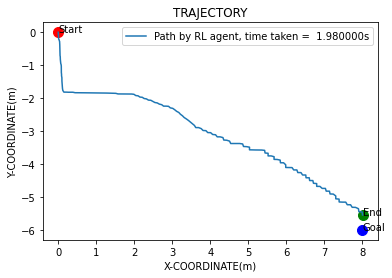

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 194      |
|    ep_rew_mean     | -133     |
| time/              |          |
|    episodes        | 448      |
|    fps             | 14       |
|    time_elapsed    | 5988     |
|    total_timesteps | 86352    |
| train/             |          |
|    actor_loss      | 45.1     |
|    critic_loss     | 2.32     |
|    learning_rate   | 0.001    |
|    n_updates       | 36271    |
---------------------------------
EP_REWARD:-10


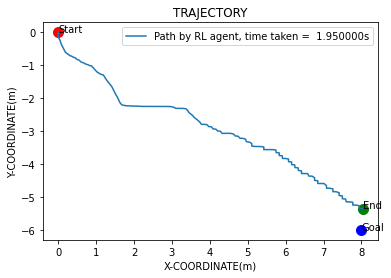

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 194      |
|    ep_rew_mean     | -133     |
| time/              |          |
|    episodes        | 449      |
|    fps             | 14       |
|    time_elapsed    | 5993     |
|    total_timesteps | 86547    |
| train/             |          |
|    actor_loss      | 45.7     |
|    critic_loss     | 2.38     |
|    learning_rate   | 0.001    |
|    n_updates       | 36469    |
---------------------------------
EP_REWARD:0


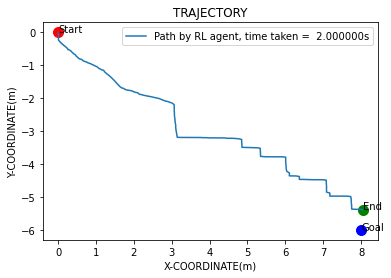

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 194      |
|    ep_rew_mean     | -133     |
| time/              |          |
|    episodes        | 450      |
|    fps             | 14       |
|    time_elapsed    | 5998     |
|    total_timesteps | 86747    |
| train/             |          |
|    actor_loss      | 45.4     |
|    critic_loss     | 3.32     |
|    learning_rate   | 0.001    |
|    n_updates       | 36664    |
---------------------------------
EP_REWARD:0.30000000000000004


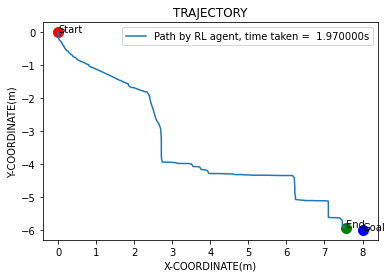

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 194      |
|    ep_rew_mean     | -133     |
| time/              |          |
|    episodes        | 451      |
|    fps             | 14       |
|    time_elapsed    | 6004     |
|    total_timesteps | 86944    |
| train/             |          |
|    actor_loss      | 45.5     |
|    critic_loss     | 3.44     |
|    learning_rate   | 0.001    |
|    n_updates       | 36864    |
---------------------------------
EP_REWARD:-0.13357400728472546


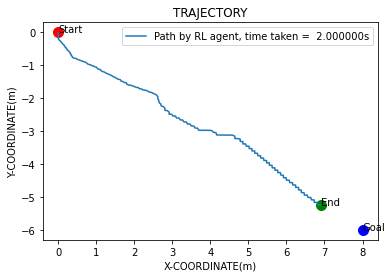

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 194      |
|    ep_rew_mean     | -133     |
| time/              |          |
|    episodes        | 452      |
|    fps             | 14       |
|    time_elapsed    | 6009     |
|    total_timesteps | 87144    |
| train/             |          |
|    actor_loss      | 45.7     |
|    critic_loss     | 1.77     |
|    learning_rate   | 0.001    |
|    n_updates       | 37061    |
---------------------------------
EP_REWARD:1.1


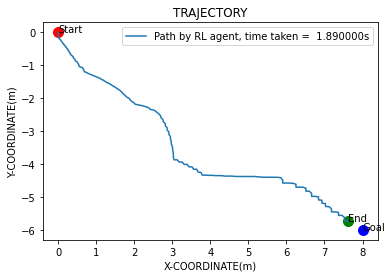

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 194      |
|    ep_rew_mean     | -132     |
| time/              |          |
|    episodes        | 453      |
|    fps             | 14       |
|    time_elapsed    | 6014     |
|    total_timesteps | 87333    |
| train/             |          |
|    actor_loss      | 45.8     |
|    critic_loss     | 2.64     |
|    learning_rate   | 0.001    |
|    n_updates       | 37261    |
---------------------------------
EP_REWARD:0.1


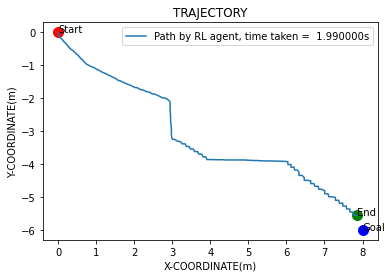

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 194      |
|    ep_rew_mean     | -132     |
| time/              |          |
|    episodes        | 454      |
|    fps             | 14       |
|    time_elapsed    | 6019     |
|    total_timesteps | 87532    |
| train/             |          |
|    actor_loss      | 45.5     |
|    critic_loss     | 2.21     |
|    learning_rate   | 0.001    |
|    n_updates       | 37450    |
---------------------------------
EP_REWARD:1.3


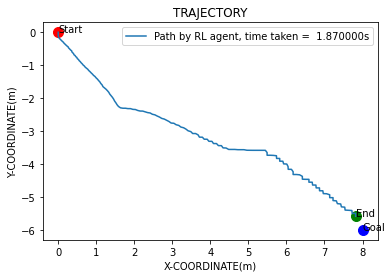

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 194      |
|    ep_rew_mean     | -132     |
| time/              |          |
|    episodes        | 455      |
|    fps             | 14       |
|    time_elapsed    | 6024     |
|    total_timesteps | 87719    |
| train/             |          |
|    actor_loss      | 45.5     |
|    critic_loss     | 1.94     |
|    learning_rate   | 0.001    |
|    n_updates       | 37649    |
---------------------------------
EP_REWARD:0.6000000000000001


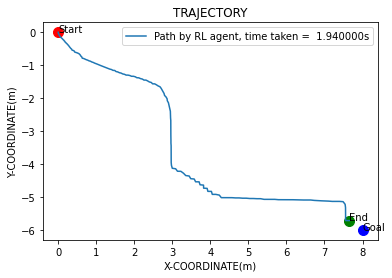

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 194      |
|    ep_rew_mean     | -132     |
| time/              |          |
|    episodes        | 456      |
|    fps             | 14       |
|    time_elapsed    | 6029     |
|    total_timesteps | 87913    |
| train/             |          |
|    actor_loss      | 45.6     |
|    critic_loss     | 3.18     |
|    learning_rate   | 0.001    |
|    n_updates       | 37836    |
---------------------------------
EP_REWARD:-10


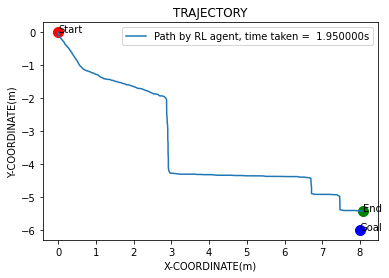

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 194      |
|    ep_rew_mean     | -132     |
| time/              |          |
|    episodes        | 457      |
|    fps             | 14       |
|    time_elapsed    | 6034     |
|    total_timesteps | 88108    |
| train/             |          |
|    actor_loss      | 46.3     |
|    critic_loss     | 2.24     |
|    learning_rate   | 0.001    |
|    n_updates       | 38030    |
---------------------------------
EP_REWARD:-28


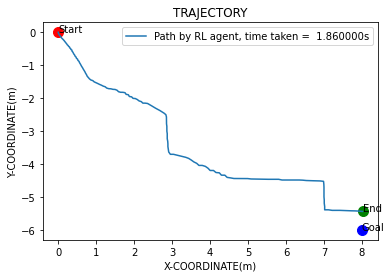

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 194      |
|    ep_rew_mean     | -132     |
| time/              |          |
|    episodes        | 458      |
|    fps             | 14       |
|    time_elapsed    | 6041     |
|    total_timesteps | 88294    |
| train/             |          |
|    actor_loss      | 46       |
|    critic_loss     | 2.69     |
|    learning_rate   | 0.001    |
|    n_updates       | 38225    |
---------------------------------
EP_REWARD:1.0


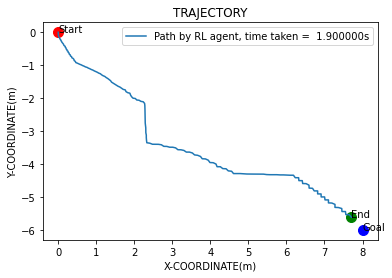

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 193      |
|    ep_rew_mean     | -132     |
| time/              |          |
|    episodes        | 459      |
|    fps             | 14       |
|    time_elapsed    | 6047     |
|    total_timesteps | 88484    |
| train/             |          |
|    actor_loss      | 46       |
|    critic_loss     | 2.05     |
|    learning_rate   | 0.001    |
|    n_updates       | 38411    |
---------------------------------
EP_REWARD:0.8


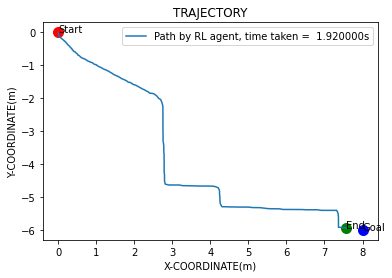

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 193      |
|    ep_rew_mean     | -132     |
| time/              |          |
|    episodes        | 460      |
|    fps             | 14       |
|    time_elapsed    | 6053     |
|    total_timesteps | 88676    |
| train/             |          |
|    actor_loss      | 46.2     |
|    critic_loss     | 5.01     |
|    learning_rate   | 0.001    |
|    n_updates       | 38601    |
---------------------------------
EP_REWARD:1.5


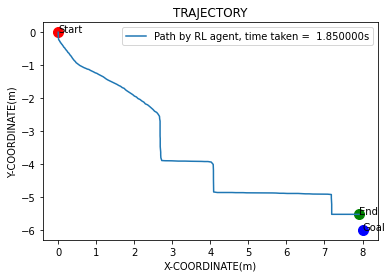

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 193      |
|    ep_rew_mean     | -131     |
| time/              |          |
|    episodes        | 461      |
|    fps             | 14       |
|    time_elapsed    | 6059     |
|    total_timesteps | 88861    |
| train/             |          |
|    actor_loss      | 46.3     |
|    critic_loss     | 2.71     |
|    learning_rate   | 0.001    |
|    n_updates       | 38793    |
---------------------------------
EP_REWARD:1.2000000000000002


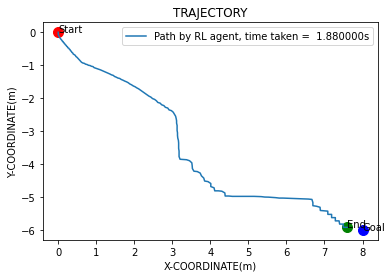

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 193      |
|    ep_rew_mean     | -131     |
| time/              |          |
|    episodes        | 462      |
|    fps             | 14       |
|    time_elapsed    | 6064     |
|    total_timesteps | 89049    |
| train/             |          |
|    actor_loss      | 45.5     |
|    critic_loss     | 2.12     |
|    learning_rate   | 0.001    |
|    n_updates       | 38978    |
---------------------------------
EP_REWARD:0.4


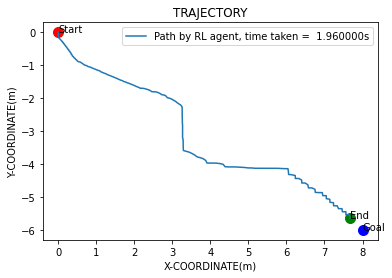

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 193      |
|    ep_rew_mean     | -131     |
| time/              |          |
|    episodes        | 463      |
|    fps             | 14       |
|    time_elapsed    | 6070     |
|    total_timesteps | 89245    |
| train/             |          |
|    actor_loss      | 46.1     |
|    critic_loss     | 2        |
|    learning_rate   | 0.001    |
|    n_updates       | 39166    |
---------------------------------
EP_REWARD:0.7000000000000001


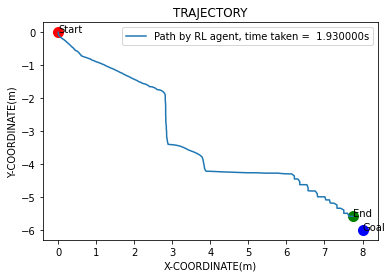

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 193      |
|    ep_rew_mean     | -131     |
| time/              |          |
|    episodes        | 464      |
|    fps             | 14       |
|    time_elapsed    | 6075     |
|    total_timesteps | 89438    |
| train/             |          |
|    actor_loss      | 46       |
|    critic_loss     | 3.61     |
|    learning_rate   | 0.001    |
|    n_updates       | 39362    |
---------------------------------
EP_REWARD:-0.05956462841060191


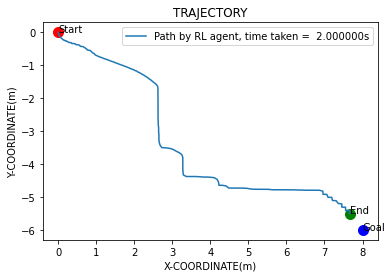

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 193      |
|    ep_rew_mean     | -131     |
| time/              |          |
|    episodes        | 465      |
|    fps             | 14       |
|    time_elapsed    | 6081     |
|    total_timesteps | 89638    |
| train/             |          |
|    actor_loss      | 45.9     |
|    critic_loss     | 3.5      |
|    learning_rate   | 0.001    |
|    n_updates       | 39555    |
---------------------------------
EP_REWARD:0.7000000000000001


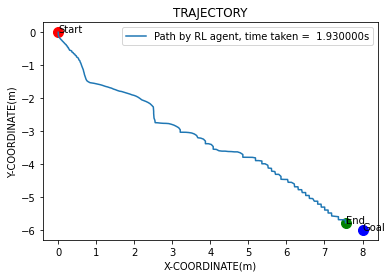

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 193      |
|    ep_rew_mean     | -131     |
| time/              |          |
|    episodes        | 466      |
|    fps             | 14       |
|    time_elapsed    | 6086     |
|    total_timesteps | 89831    |
| train/             |          |
|    actor_loss      | 46.4     |
|    critic_loss     | 4.11     |
|    learning_rate   | 0.001    |
|    n_updates       | 39755    |
---------------------------------
EP_REWARD:-0.1375357820243649


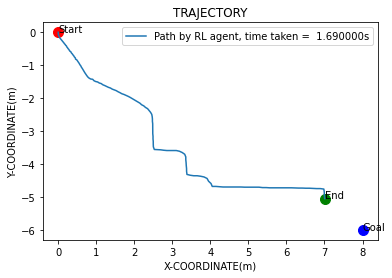

EP_REWARD:1.7000000000000002


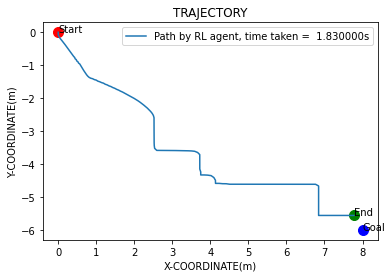

EP_REWARD:1.7000000000000002


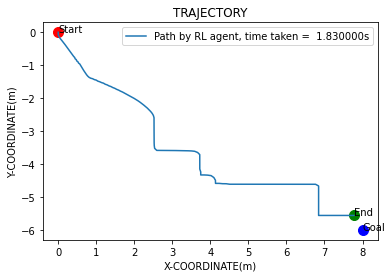

EP_REWARD:1.7000000000000002


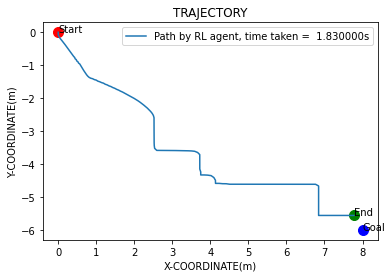

EP_REWARD:1.7000000000000002


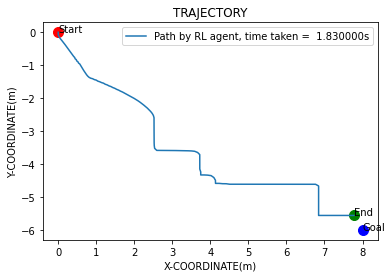

EP_REWARD:1.7000000000000002


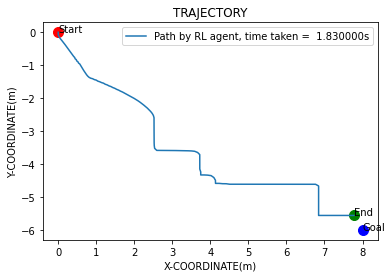

Eval num_timesteps=90000, episode_reward=-113.98 +/- 0.00
Episode length: 183.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 183      |
|    mean_reward     | -114     |
| time/              |          |
|    total_timesteps | 90000    |
| train/             |          |
|    actor_loss      | 46.3     |
|    critic_loss     | 2.71     |
|    learning_rate   | 0.001    |
|    n_updates       | 39948    |
---------------------------------
EP_REWARD:1.7000000000000002


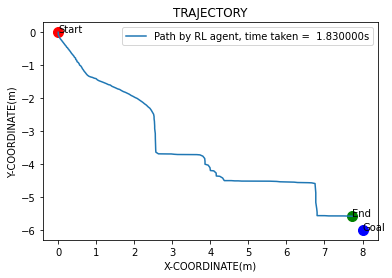

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 193      |
|    ep_rew_mean     | -131     |
| time/              |          |
|    episodes        | 467      |
|    fps             | 14       |
|    time_elapsed    | 6093     |
|    total_timesteps | 90183    |
---------------------------------
EP_REWARD:-26


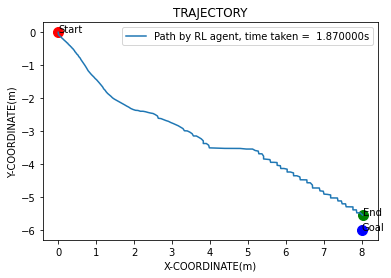

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 193      |
|    ep_rew_mean     | -131     |
| time/              |          |
|    episodes        | 468      |
|    fps             | 14       |
|    time_elapsed    | 6103     |
|    total_timesteps | 90370    |
| train/             |          |
|    actor_loss      | 46.1     |
|    critic_loss     | 3.45     |
|    learning_rate   | 0.001    |
|    n_updates       | 40300    |
---------------------------------
EP_REWARD:1.8


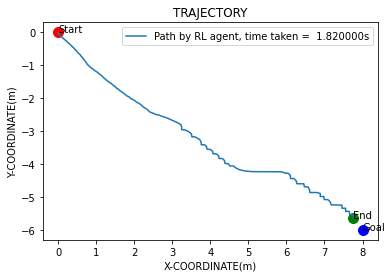

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 193      |
|    ep_rew_mean     | -130     |
| time/              |          |
|    episodes        | 469      |
|    fps             | 14       |
|    time_elapsed    | 6108     |
|    total_timesteps | 90552    |
| train/             |          |
|    actor_loss      | 45.6     |
|    critic_loss     | 2.76     |
|    learning_rate   | 0.001    |
|    n_updates       | 40487    |
---------------------------------
EP_REWARD:1.0


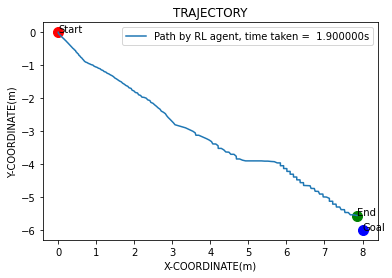

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 193      |
|    ep_rew_mean     | -130     |
| time/              |          |
|    episodes        | 470      |
|    fps             | 14       |
|    time_elapsed    | 6113     |
|    total_timesteps | 90742    |
| train/             |          |
|    actor_loss      | 46.1     |
|    critic_loss     | 3.5      |
|    learning_rate   | 0.001    |
|    n_updates       | 40669    |
---------------------------------
EP_REWARD:2.0


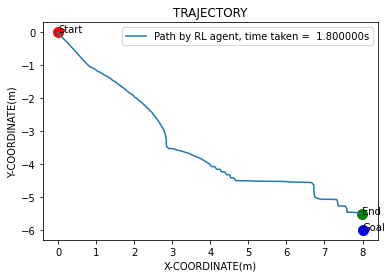

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 193      |
|    ep_rew_mean     | -130     |
| time/              |          |
|    episodes        | 471      |
|    fps             | 14       |
|    time_elapsed    | 6118     |
|    total_timesteps | 90922    |
| train/             |          |
|    actor_loss      | 45.7     |
|    critic_loss     | 1.85     |
|    learning_rate   | 0.001    |
|    n_updates       | 40859    |
---------------------------------
EP_REWARD:2.2


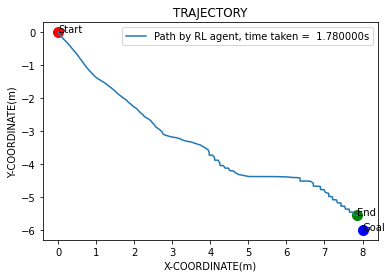

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 193      |
|    ep_rew_mean     | -129     |
| time/              |          |
|    episodes        | 472      |
|    fps             | 14       |
|    time_elapsed    | 6123     |
|    total_timesteps | 91100    |
| train/             |          |
|    actor_loss      | 45.7     |
|    critic_loss     | 3.68     |
|    learning_rate   | 0.001    |
|    n_updates       | 41039    |
---------------------------------
EP_REWARD:-20


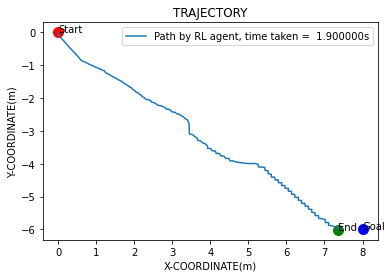

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 193      |
|    ep_rew_mean     | -129     |
| time/              |          |
|    episodes        | 473      |
|    fps             | 14       |
|    time_elapsed    | 6128     |
|    total_timesteps | 91290    |
| train/             |          |
|    actor_loss      | 45.8     |
|    critic_loss     | 2.17     |
|    learning_rate   | 0.001    |
|    n_updates       | 41217    |
---------------------------------
EP_REWARD:1.9000000000000001


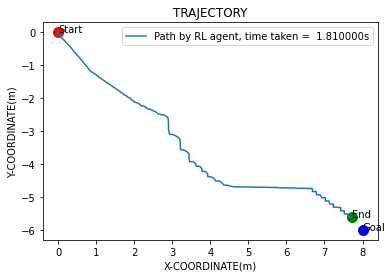

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 193      |
|    ep_rew_mean     | -129     |
| time/              |          |
|    episodes        | 474      |
|    fps             | 14       |
|    time_elapsed    | 6133     |
|    total_timesteps | 91471    |
| train/             |          |
|    actor_loss      | 45.9     |
|    critic_loss     | 1.4      |
|    learning_rate   | 0.001    |
|    n_updates       | 41407    |
---------------------------------
EP_REWARD:2.2


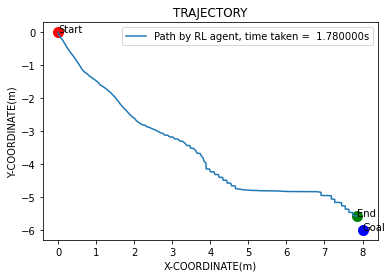

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 193      |
|    ep_rew_mean     | -129     |
| time/              |          |
|    episodes        | 475      |
|    fps             | 14       |
|    time_elapsed    | 6138     |
|    total_timesteps | 91649    |
| train/             |          |
|    actor_loss      | 45.9     |
|    critic_loss     | 2.9      |
|    learning_rate   | 0.001    |
|    n_updates       | 41588    |
---------------------------------
EP_REWARD:0.6000000000000001


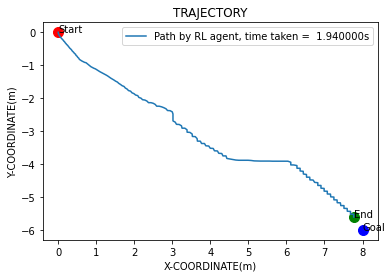

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 193      |
|    ep_rew_mean     | -129     |
| time/              |          |
|    episodes        | 476      |
|    fps             | 14       |
|    time_elapsed    | 6143     |
|    total_timesteps | 91843    |
| train/             |          |
|    actor_loss      | 45.7     |
|    critic_loss     | 2.18     |
|    learning_rate   | 0.001    |
|    n_updates       | 41766    |
---------------------------------
EP_REWARD:1.7000000000000002


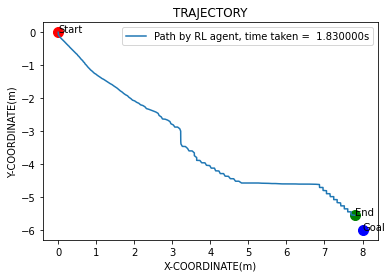

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 193      |
|    ep_rew_mean     | -129     |
| time/              |          |
|    episodes        | 477      |
|    fps             | 14       |
|    time_elapsed    | 6148     |
|    total_timesteps | 92026    |
| train/             |          |
|    actor_loss      | 45.7     |
|    critic_loss     | 3.64     |
|    learning_rate   | 0.001    |
|    n_updates       | 41960    |
---------------------------------
EP_REWARD:1.6


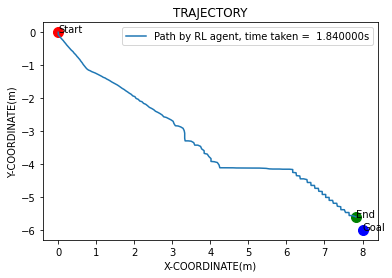

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 193      |
|    ep_rew_mean     | -128     |
| time/              |          |
|    episodes        | 478      |
|    fps             | 14       |
|    time_elapsed    | 6153     |
|    total_timesteps | 92210    |
| train/             |          |
|    actor_loss      | 46.1     |
|    critic_loss     | 3.7      |
|    learning_rate   | 0.001    |
|    n_updates       | 42143    |
---------------------------------
EP_REWARD:2.7


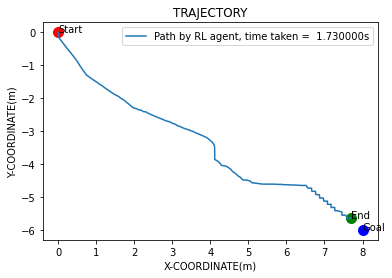

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 192      |
|    ep_rew_mean     | -128     |
| time/              |          |
|    episodes        | 479      |
|    fps             | 14       |
|    time_elapsed    | 6158     |
|    total_timesteps | 92383    |
| train/             |          |
|    actor_loss      | 45.4     |
|    critic_loss     | 2.65     |
|    learning_rate   | 0.001    |
|    n_updates       | 42327    |
---------------------------------
EP_REWARD:1.5


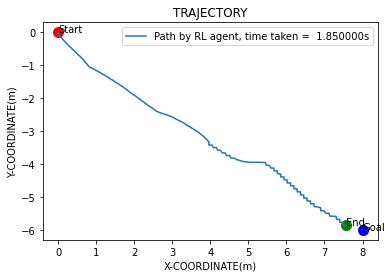

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 192      |
|    ep_rew_mean     | -128     |
| time/              |          |
|    episodes        | 480      |
|    fps             | 15       |
|    time_elapsed    | 6163     |
|    total_timesteps | 92568    |
| train/             |          |
|    actor_loss      | 45.8     |
|    critic_loss     | 1.84     |
|    learning_rate   | 0.001    |
|    n_updates       | 42500    |
---------------------------------
EP_REWARD:1.2000000000000002


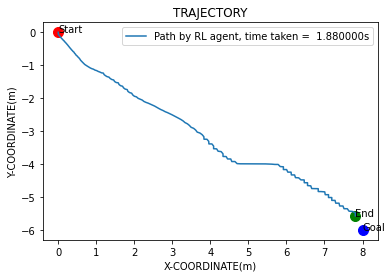

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 192      |
|    ep_rew_mean     | -128     |
| time/              |          |
|    episodes        | 481      |
|    fps             | 15       |
|    time_elapsed    | 6168     |
|    total_timesteps | 92756    |
| train/             |          |
|    actor_loss      | 46       |
|    critic_loss     | 1.75     |
|    learning_rate   | 0.001    |
|    n_updates       | 42685    |
---------------------------------
EP_REWARD:2.4000000000000004


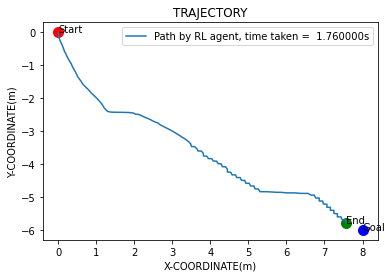

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 192      |
|    ep_rew_mean     | -128     |
| time/              |          |
|    episodes        | 482      |
|    fps             | 15       |
|    time_elapsed    | 6174     |
|    total_timesteps | 92932    |
| train/             |          |
|    actor_loss      | 45.7     |
|    critic_loss     | 2.9      |
|    learning_rate   | 0.001    |
|    n_updates       | 42873    |
---------------------------------
EP_REWARD:2.4000000000000004


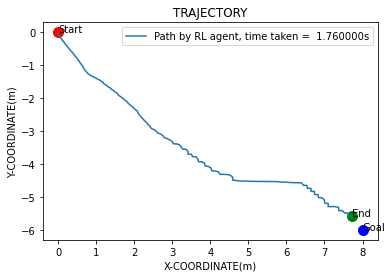

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 192      |
|    ep_rew_mean     | -128     |
| time/              |          |
|    episodes        | 483      |
|    fps             | 15       |
|    time_elapsed    | 6179     |
|    total_timesteps | 93108    |
| train/             |          |
|    actor_loss      | 46.2     |
|    critic_loss     | 4.31     |
|    learning_rate   | 0.001    |
|    n_updates       | 43049    |
---------------------------------
EP_REWARD:1.4000000000000001


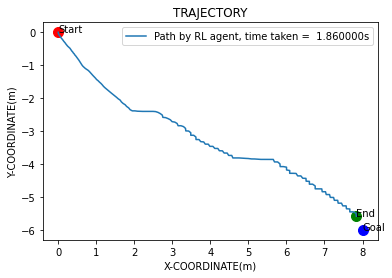

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 192      |
|    ep_rew_mean     | -128     |
| time/              |          |
|    episodes        | 484      |
|    fps             | 15       |
|    time_elapsed    | 6184     |
|    total_timesteps | 93294    |
| train/             |          |
|    actor_loss      | 45.7     |
|    critic_loss     | 3.34     |
|    learning_rate   | 0.001    |
|    n_updates       | 43225    |
---------------------------------
EP_REWARD:1.8


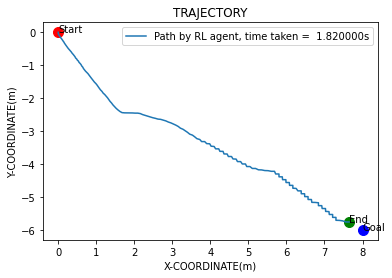

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 192      |
|    ep_rew_mean     | -128     |
| time/              |          |
|    episodes        | 485      |
|    fps             | 15       |
|    time_elapsed    | 6189     |
|    total_timesteps | 93476    |
| train/             |          |
|    actor_loss      | 45.9     |
|    critic_loss     | 3.25     |
|    learning_rate   | 0.001    |
|    n_updates       | 43411    |
---------------------------------
EP_REWARD:2.6


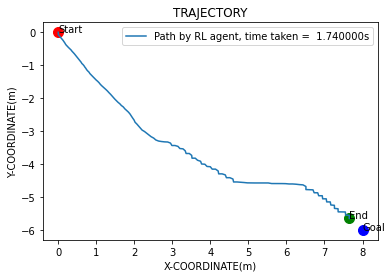

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 192      |
|    ep_rew_mean     | -127     |
| time/              |          |
|    episodes        | 486      |
|    fps             | 15       |
|    time_elapsed    | 6194     |
|    total_timesteps | 93650    |
| train/             |          |
|    actor_loss      | 45.3     |
|    critic_loss     | 2.79     |
|    learning_rate   | 0.001    |
|    n_updates       | 43593    |
---------------------------------
EP_REWARD:2.2


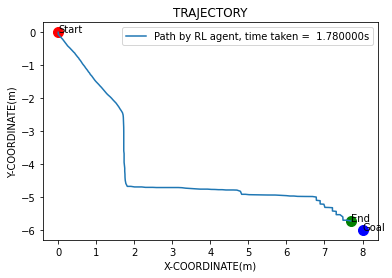

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 192      |
|    ep_rew_mean     | -127     |
| time/              |          |
|    episodes        | 487      |
|    fps             | 15       |
|    time_elapsed    | 6198     |
|    total_timesteps | 93828    |
| train/             |          |
|    actor_loss      | 46.2     |
|    critic_loss     | 1.75     |
|    learning_rate   | 0.001    |
|    n_updates       | 43767    |
---------------------------------
EP_REWARD:2.4000000000000004


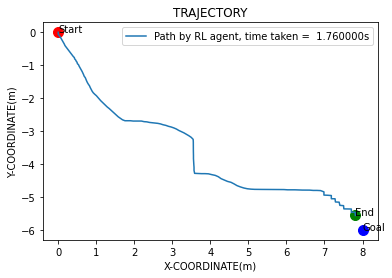

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 192      |
|    ep_rew_mean     | -127     |
| time/              |          |
|    episodes        | 488      |
|    fps             | 15       |
|    time_elapsed    | 6203     |
|    total_timesteps | 94004    |
| train/             |          |
|    actor_loss      | 45.9     |
|    critic_loss     | 1.95     |
|    learning_rate   | 0.001    |
|    n_updates       | 43945    |
---------------------------------
EP_REWARD:2.1


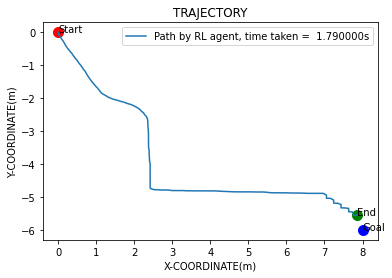

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 192      |
|    ep_rew_mean     | -127     |
| time/              |          |
|    episodes        | 489      |
|    fps             | 15       |
|    time_elapsed    | 6208     |
|    total_timesteps | 94183    |
| train/             |          |
|    actor_loss      | 45.7     |
|    critic_loss     | 1.59     |
|    learning_rate   | 0.001    |
|    n_updates       | 44121    |
---------------------------------
EP_REWARD:1.9000000000000001


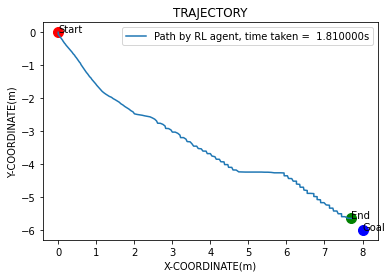

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 192      |
|    ep_rew_mean     | -127     |
| time/              |          |
|    episodes        | 490      |
|    fps             | 15       |
|    time_elapsed    | 6213     |
|    total_timesteps | 94364    |
| train/             |          |
|    actor_loss      | 45.6     |
|    critic_loss     | 2.11     |
|    learning_rate   | 0.001    |
|    n_updates       | 44300    |
---------------------------------
EP_REWARD:2.2


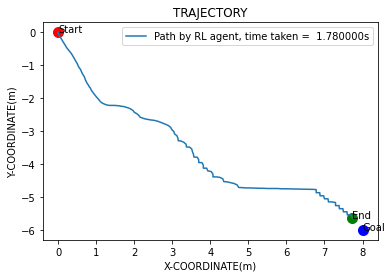

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 192      |
|    ep_rew_mean     | -127     |
| time/              |          |
|    episodes        | 491      |
|    fps             | 15       |
|    time_elapsed    | 6218     |
|    total_timesteps | 94542    |
| train/             |          |
|    actor_loss      | 45.2     |
|    critic_loss     | 1.73     |
|    learning_rate   | 0.001    |
|    n_updates       | 44481    |
---------------------------------
EP_REWARD:1.7000000000000002


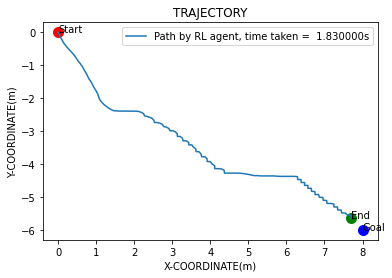

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 191      |
|    ep_rew_mean     | -127     |
| time/              |          |
|    episodes        | 492      |
|    fps             | 15       |
|    time_elapsed    | 6224     |
|    total_timesteps | 94725    |
| train/             |          |
|    actor_loss      | 45.4     |
|    critic_loss     | 4.26     |
|    learning_rate   | 0.001    |
|    n_updates       | 44659    |
---------------------------------
EP_REWARD:1.2000000000000002


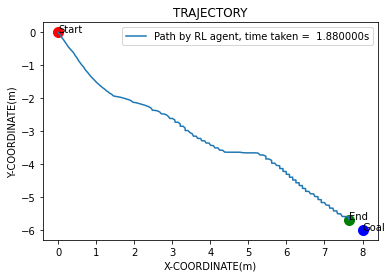

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 191      |
|    ep_rew_mean     | -127     |
| time/              |          |
|    episodes        | 493      |
|    fps             | 15       |
|    time_elapsed    | 6229     |
|    total_timesteps | 94913    |
| train/             |          |
|    actor_loss      | 45       |
|    critic_loss     | 1.97     |
|    learning_rate   | 0.001    |
|    n_updates       | 44842    |
---------------------------------
EP_REWARD:-0.6999057105284944


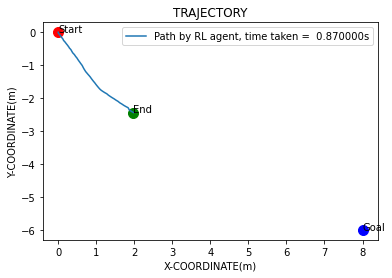

EP_REWARD:1.2000000000000002


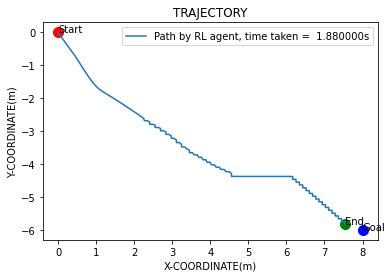

EP_REWARD:1.2000000000000002


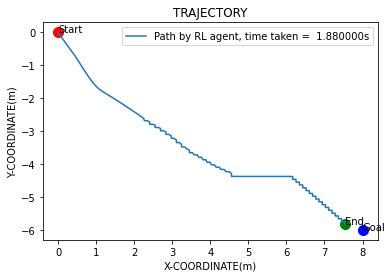

EP_REWARD:1.2000000000000002


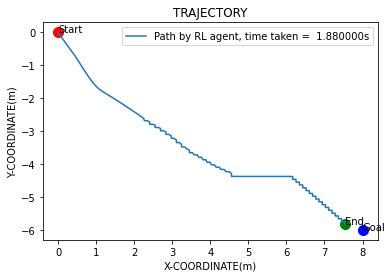

EP_REWARD:1.2000000000000002


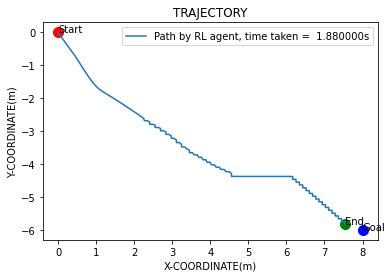

EP_REWARD:1.2000000000000002


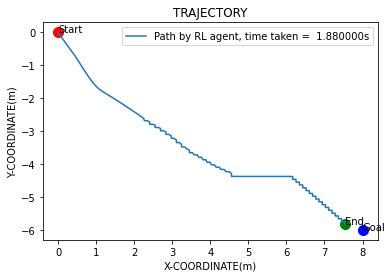

Eval num_timesteps=95000, episode_reward=-113.74 +/- 0.00
Episode length: 188.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 188      |
|    mean_reward     | -114     |
| time/              |          |
|    total_timesteps | 95000    |
| train/             |          |
|    actor_loss      | 45.1     |
|    critic_loss     | 3.03     |
|    learning_rate   | 0.001    |
|    n_updates       | 45030    |
---------------------------------
EP_REWARD:1.0


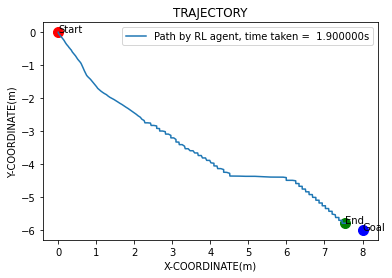

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 191      |
|    ep_rew_mean     | -127     |
| time/              |          |
|    episodes        | 494      |
|    fps             | 15       |
|    time_elapsed    | 6238     |
|    total_timesteps | 95190    |
---------------------------------
EP_REWARD:2.1


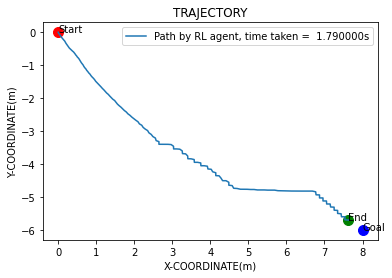

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 191      |
|    ep_rew_mean     | -126     |
| time/              |          |
|    episodes        | 495      |
|    fps             | 15       |
|    time_elapsed    | 6247     |
|    total_timesteps | 95369    |
| train/             |          |
|    actor_loss      | 45.2     |
|    critic_loss     | 2.2      |
|    learning_rate   | 0.001    |
|    n_updates       | 45307    |
---------------------------------
EP_REWARD:1.7000000000000002


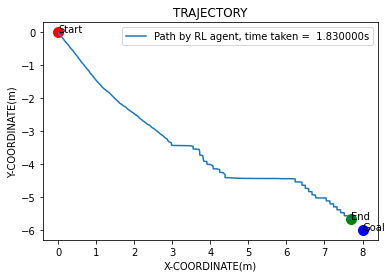

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 191      |
|    ep_rew_mean     | -126     |
| time/              |          |
|    episodes        | 496      |
|    fps             | 15       |
|    time_elapsed    | 6253     |
|    total_timesteps | 95552    |
| train/             |          |
|    actor_loss      | 45.1     |
|    critic_loss     | 1.98     |
|    learning_rate   | 0.001    |
|    n_updates       | 45486    |
---------------------------------
EP_REWARD:1.2000000000000002


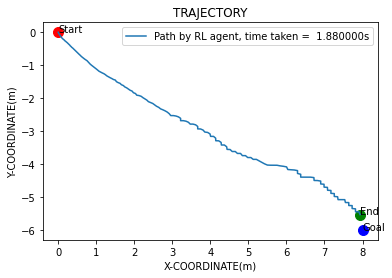

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 191      |
|    ep_rew_mean     | -125     |
| time/              |          |
|    episodes        | 497      |
|    fps             | 15       |
|    time_elapsed    | 6259     |
|    total_timesteps | 95740    |
| train/             |          |
|    actor_loss      | 45       |
|    critic_loss     | 3.27     |
|    learning_rate   | 0.001    |
|    n_updates       | 45669    |
---------------------------------
EP_REWARD:2.0


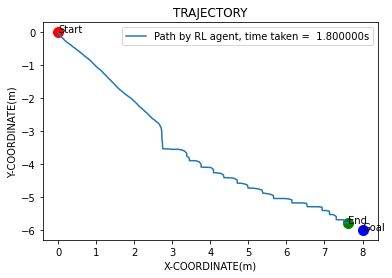

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 191      |
|    ep_rew_mean     | -125     |
| time/              |          |
|    episodes        | 498      |
|    fps             | 15       |
|    time_elapsed    | 6266     |
|    total_timesteps | 95920    |
| train/             |          |
|    actor_loss      | 45.5     |
|    critic_loss     | 4.24     |
|    learning_rate   | 0.001    |
|    n_updates       | 45857    |
---------------------------------
EP_REWARD:1.7000000000000002


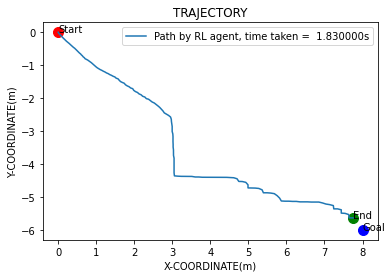

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 191      |
|    ep_rew_mean     | -125     |
| time/              |          |
|    episodes        | 499      |
|    fps             | 15       |
|    time_elapsed    | 6272     |
|    total_timesteps | 96103    |
| train/             |          |
|    actor_loss      | 45.3     |
|    critic_loss     | 3.73     |
|    learning_rate   | 0.001    |
|    n_updates       | 46037    |
---------------------------------
EP_REWARD:2.4000000000000004


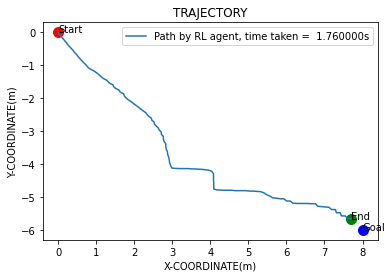

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 191      |
|    ep_rew_mean     | -125     |
| time/              |          |
|    episodes        | 500      |
|    fps             | 15       |
|    time_elapsed    | 6279     |
|    total_timesteps | 96279    |
| train/             |          |
|    actor_loss      | 45.7     |
|    critic_loss     | 2.26     |
|    learning_rate   | 0.001    |
|    n_updates       | 46220    |
---------------------------------
EP_REWARD:2.1


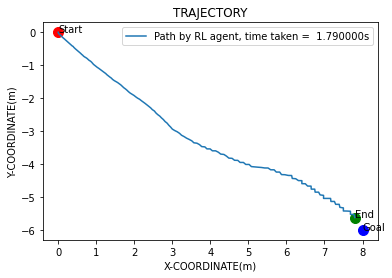

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 191      |
|    ep_rew_mean     | -125     |
| time/              |          |
|    episodes        | 501      |
|    fps             | 15       |
|    time_elapsed    | 6284     |
|    total_timesteps | 96458    |
| train/             |          |
|    actor_loss      | 45.4     |
|    critic_loss     | 3.05     |
|    learning_rate   | 0.001    |
|    n_updates       | 46396    |
---------------------------------
EP_REWARD:2.2


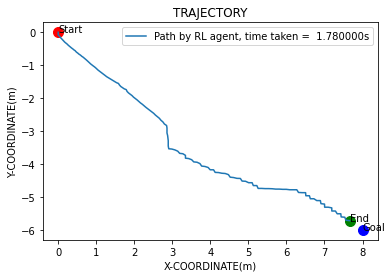

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -125     |
| time/              |          |
|    episodes        | 502      |
|    fps             | 15       |
|    time_elapsed    | 6290     |
|    total_timesteps | 96636    |
| train/             |          |
|    actor_loss      | 45.6     |
|    critic_loss     | 2.48     |
|    learning_rate   | 0.001    |
|    n_updates       | 46575    |
---------------------------------
EP_REWARD:1.6


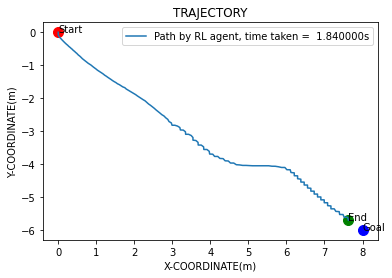

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -124     |
| time/              |          |
|    episodes        | 503      |
|    fps             | 15       |
|    time_elapsed    | 6297     |
|    total_timesteps | 96820    |
| train/             |          |
|    actor_loss      | 45.3     |
|    critic_loss     | 1.92     |
|    learning_rate   | 0.001    |
|    n_updates       | 46753    |
---------------------------------
EP_REWARD:1.7000000000000002


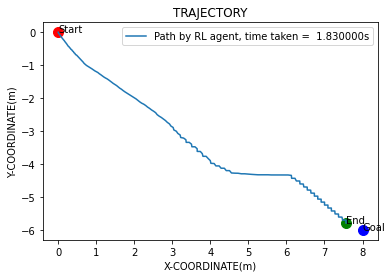

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -124     |
| time/              |          |
|    episodes        | 504      |
|    fps             | 15       |
|    time_elapsed    | 6304     |
|    total_timesteps | 97003    |
| train/             |          |
|    actor_loss      | 45.7     |
|    critic_loss     | 0.89     |
|    learning_rate   | 0.001    |
|    n_updates       | 46937    |
---------------------------------
EP_REWARD:1.9000000000000001


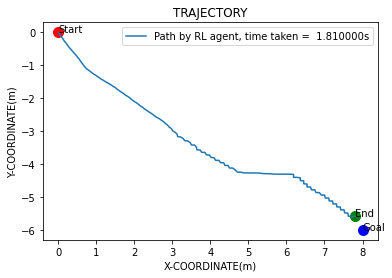

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -124     |
| time/              |          |
|    episodes        | 505      |
|    fps             | 15       |
|    time_elapsed    | 6311     |
|    total_timesteps | 97184    |
| train/             |          |
|    actor_loss      | 45.5     |
|    critic_loss     | 2.02     |
|    learning_rate   | 0.001    |
|    n_updates       | 47120    |
---------------------------------
EP_REWARD:2.6


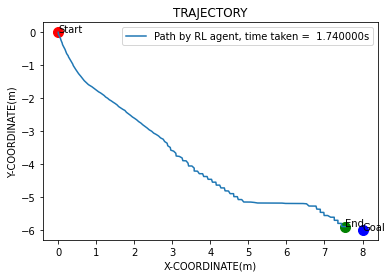

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -124     |
| time/              |          |
|    episodes        | 506      |
|    fps             | 15       |
|    time_elapsed    | 6318     |
|    total_timesteps | 97358    |
| train/             |          |
|    actor_loss      | 45.4     |
|    critic_loss     | 4.01     |
|    learning_rate   | 0.001    |
|    n_updates       | 47301    |
---------------------------------
EP_REWARD:0.2


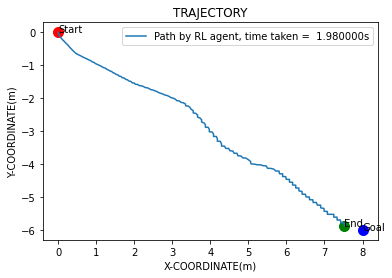

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -123     |
| time/              |          |
|    episodes        | 507      |
|    fps             | 15       |
|    time_elapsed    | 6323     |
|    total_timesteps | 97556    |
| train/             |          |
|    actor_loss      | 45.5     |
|    critic_loss     | 2.55     |
|    learning_rate   | 0.001    |
|    n_updates       | 47475    |
---------------------------------
EP_REWARD:1.1


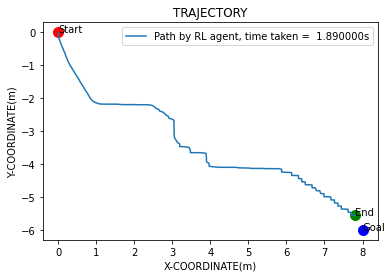

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 190      |
|    ep_rew_mean     | -123     |
| time/              |          |
|    episodes        | 508      |
|    fps             | 15       |
|    time_elapsed    | 6329     |
|    total_timesteps | 97745    |
| train/             |          |
|    actor_loss      | 45.1     |
|    critic_loss     | 4.6      |
|    learning_rate   | 0.001    |
|    n_updates       | 47673    |
---------------------------------
EP_REWARD:-22


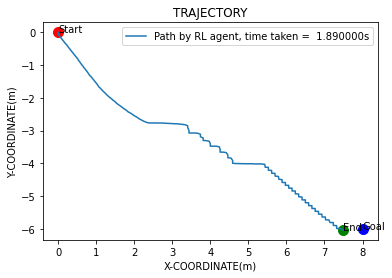

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -123     |
| time/              |          |
|    episodes        | 509      |
|    fps             | 15       |
|    time_elapsed    | 6336     |
|    total_timesteps | 97934    |
| train/             |          |
|    actor_loss      | 45.3     |
|    critic_loss     | 4.74     |
|    learning_rate   | 0.001    |
|    n_updates       | 47862    |
---------------------------------
EP_REWARD:1.9000000000000001


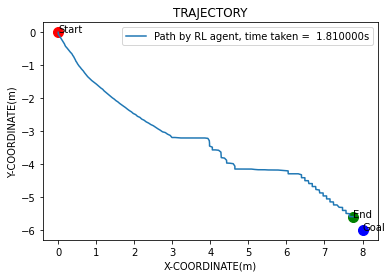

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -123     |
| time/              |          |
|    episodes        | 510      |
|    fps             | 15       |
|    time_elapsed    | 6341     |
|    total_timesteps | 98115    |
| train/             |          |
|    actor_loss      | 45       |
|    critic_loss     | 2.29     |
|    learning_rate   | 0.001    |
|    n_updates       | 48051    |
---------------------------------
EP_REWARD:-10


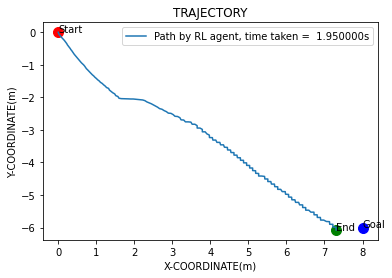

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -123     |
| time/              |          |
|    episodes        | 511      |
|    fps             | 15       |
|    time_elapsed    | 6348     |
|    total_timesteps | 98310    |
| train/             |          |
|    actor_loss      | 44.7     |
|    critic_loss     | 4.9      |
|    learning_rate   | 0.001    |
|    n_updates       | 48232    |
---------------------------------
EP_REWARD:0.6000000000000001


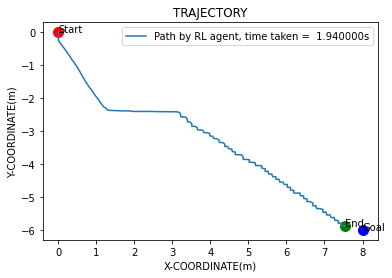

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -123     |
| time/              |          |
|    episodes        | 512      |
|    fps             | 15       |
|    time_elapsed    | 6354     |
|    total_timesteps | 98504    |
| train/             |          |
|    actor_loss      | 45.1     |
|    critic_loss     | 3.81     |
|    learning_rate   | 0.001    |
|    n_updates       | 48427    |
---------------------------------
EP_REWARD:-26


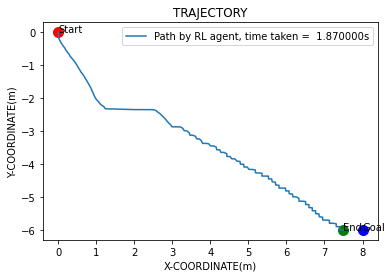

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -123     |
| time/              |          |
|    episodes        | 513      |
|    fps             | 15       |
|    time_elapsed    | 6360     |
|    total_timesteps | 98691    |
| train/             |          |
|    actor_loss      | 45       |
|    critic_loss     | 4.61     |
|    learning_rate   | 0.001    |
|    n_updates       | 48621    |
---------------------------------
EP_REWARD:1.0


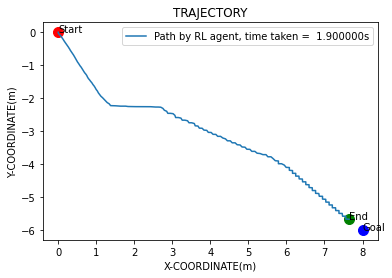

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -122     |
| time/              |          |
|    episodes        | 514      |
|    fps             | 15       |
|    time_elapsed    | 6366     |
|    total_timesteps | 98881    |
| train/             |          |
|    actor_loss      | 44.6     |
|    critic_loss     | 2.66     |
|    learning_rate   | 0.001    |
|    n_updates       | 48808    |
---------------------------------
EP_REWARD:0.7000000000000001


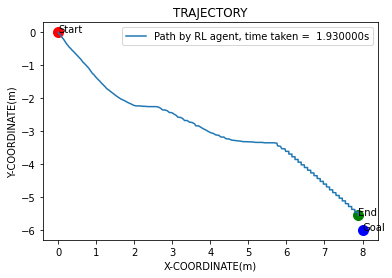

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -122     |
| time/              |          |
|    episodes        | 515      |
|    fps             | 15       |
|    time_elapsed    | 6372     |
|    total_timesteps | 99074    |
| train/             |          |
|    actor_loss      | 44.6     |
|    critic_loss     | 2.17     |
|    learning_rate   | 0.001    |
|    n_updates       | 48998    |
---------------------------------
EP_REWARD:-0.11329098108163267


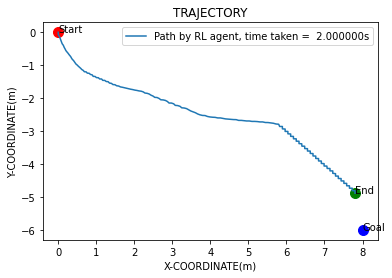

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -122     |
| time/              |          |
|    episodes        | 516      |
|    fps             | 15       |
|    time_elapsed    | 6377     |
|    total_timesteps | 99274    |
| train/             |          |
|    actor_loss      | 44.7     |
|    critic_loss     | 2.89     |
|    learning_rate   | 0.001    |
|    n_updates       | 49191    |
---------------------------------
EP_REWARD:1.5


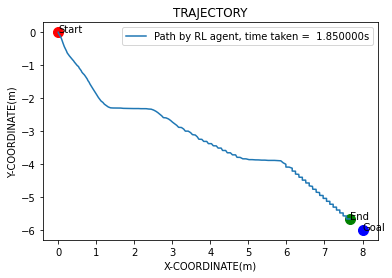

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -122     |
| time/              |          |
|    episodes        | 517      |
|    fps             | 15       |
|    time_elapsed    | 6383     |
|    total_timesteps | 99459    |
| train/             |          |
|    actor_loss      | 44.7     |
|    critic_loss     | 3.83     |
|    learning_rate   | 0.001    |
|    n_updates       | 49391    |
---------------------------------
EP_REWARD:2.4000000000000004


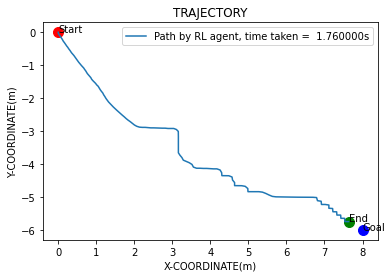

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 189      |
|    ep_rew_mean     | -122     |
| time/              |          |
|    episodes        | 518      |
|    fps             | 15       |
|    time_elapsed    | 6389     |
|    total_timesteps | 99635    |
| train/             |          |
|    actor_loss      | 45.5     |
|    critic_loss     | 3.41     |
|    learning_rate   | 0.001    |
|    n_updates       | 49576    |
---------------------------------
EP_REWARD:2.7


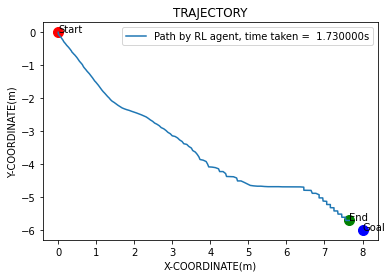

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 188      |
|    ep_rew_mean     | -121     |
| time/              |          |
|    episodes        | 519      |
|    fps             | 15       |
|    time_elapsed    | 6395     |
|    total_timesteps | 99808    |
| train/             |          |
|    actor_loss      | 44.5     |
|    critic_loss     | 1.92     |
|    learning_rate   | 0.001    |
|    n_updates       | 49752    |
---------------------------------
EP_REWARD:2.8000000000000003


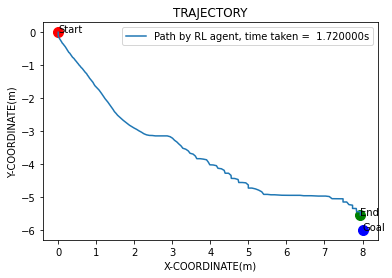

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 188      |
|    ep_rew_mean     | -121     |
| time/              |          |
|    episodes        | 520      |
|    fps             | 15       |
|    time_elapsed    | 6400     |
|    total_timesteps | 99980    |
| train/             |          |
|    actor_loss      | 44.4     |
|    critic_loss     | 3.16     |
|    learning_rate   | 0.001    |
|    n_updates       | 49925    |
---------------------------------
EP_REWARD:-0.986339034000091


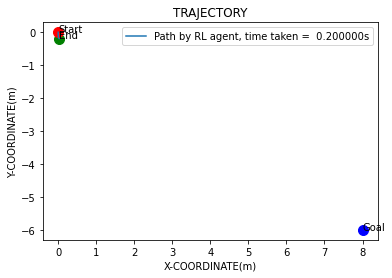

EP_REWARD:2.0


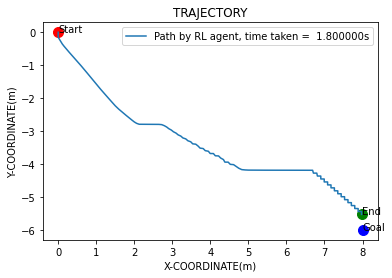

EP_REWARD:2.0


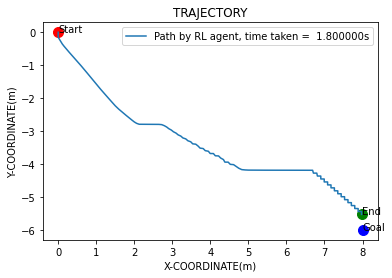

EP_REWARD:2.0


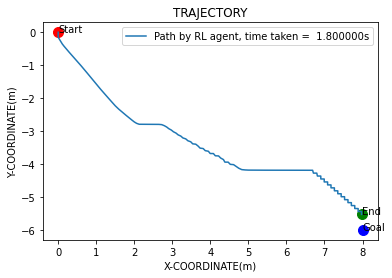

EP_REWARD:2.0


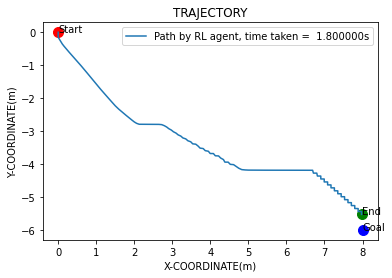

EP_REWARD:2.0


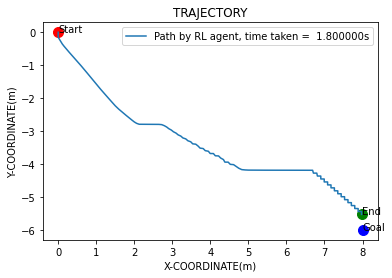

Eval num_timesteps=100000, episode_reward=-108.44 +/- 0.00
Episode length: 180.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 180      |
|    mean_reward     | -108     |
| time/              |          |
|    total_timesteps | 100000   |
| train/             |          |
|    actor_loss      | 44.4     |
|    critic_loss     | 3        |
|    learning_rate   | 0.001    |
|    n_updates       | 50097    |
---------------------------------
New best mean reward!
EP_REWARD:-42


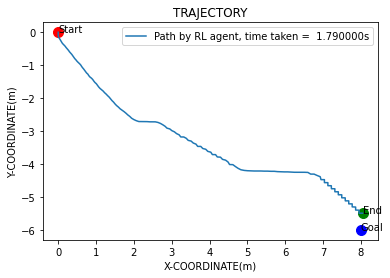

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 188      |
|    ep_rew_mean     | -121     |
| time/              |          |
|    episodes        | 521      |
|    fps             | 15       |
|    time_elapsed    | 6407     |
|    total_timesteps | 100179   |
---------------------------------
EP_REWARD:-40


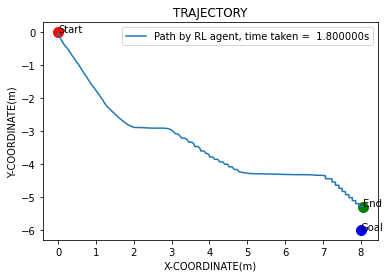

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 188      |
|    ep_rew_mean     | -121     |
| time/              |          |
|    episodes        | 522      |
|    fps             | 15       |
|    time_elapsed    | 6413     |
|    total_timesteps | 100359   |
| train/             |          |
|    actor_loss      | 44.6     |
|    critic_loss     | 2.24     |
|    learning_rate   | 0.001    |
|    n_updates       | 50296    |
---------------------------------
EP_REWARD:-52


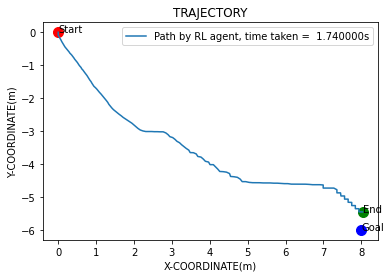

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 187      |
|    ep_rew_mean     | -122     |
| time/              |          |
|    episodes        | 523      |
|    fps             | 15       |
|    time_elapsed    | 6418     |
|    total_timesteps | 100533   |
| train/             |          |
|    actor_loss      | 44.7     |
|    critic_loss     | 1.94     |
|    learning_rate   | 0.001    |
|    n_updates       | 50476    |
---------------------------------
EP_REWARD:-48


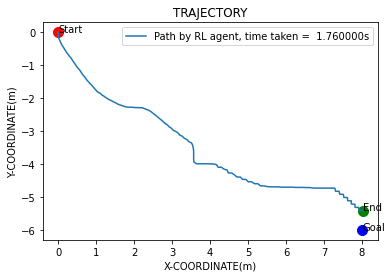

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 187      |
|    ep_rew_mean     | -122     |
| time/              |          |
|    episodes        | 524      |
|    fps             | 15       |
|    time_elapsed    | 6426     |
|    total_timesteps | 100709   |
| train/             |          |
|    actor_loss      | 44.6     |
|    critic_loss     | 2.7      |
|    learning_rate   | 0.001    |
|    n_updates       | 50650    |
---------------------------------
EP_REWARD:1.6


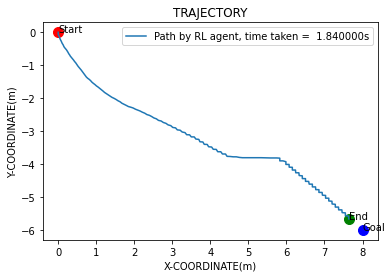

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 187      |
|    ep_rew_mean     | -122     |
| time/              |          |
|    episodes        | 525      |
|    fps             | 15       |
|    time_elapsed    | 6432     |
|    total_timesteps | 100893   |
| train/             |          |
|    actor_loss      | 44.4     |
|    critic_loss     | 2.45     |
|    learning_rate   | 0.001    |
|    n_updates       | 50826    |
---------------------------------
EP_REWARD:3.1


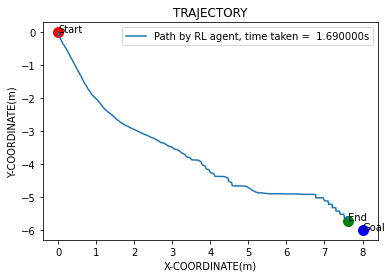

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 187      |
|    ep_rew_mean     | -121     |
| time/              |          |
|    episodes        | 526      |
|    fps             | 15       |
|    time_elapsed    | 6438     |
|    total_timesteps | 101062   |
| train/             |          |
|    actor_loss      | 44.4     |
|    critic_loss     | 2.63     |
|    learning_rate   | 0.001    |
|    n_updates       | 51010    |
---------------------------------
EP_REWARD:2.0


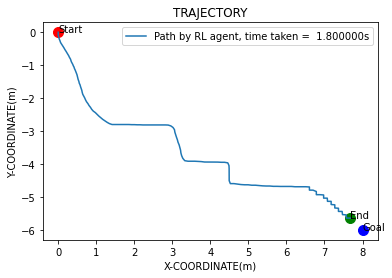

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 187      |
|    ep_rew_mean     | -121     |
| time/              |          |
|    episodes        | 527      |
|    fps             | 15       |
|    time_elapsed    | 6444     |
|    total_timesteps | 101242   |
| train/             |          |
|    actor_loss      | 44.2     |
|    critic_loss     | 5.57     |
|    learning_rate   | 0.001    |
|    n_updates       | 51179    |
---------------------------------
EP_REWARD:2.6


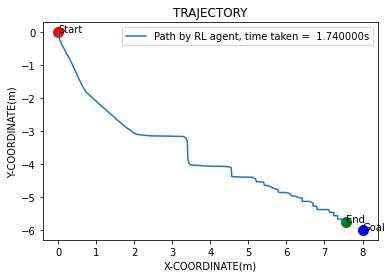

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 186      |
|    ep_rew_mean     | -121     |
| time/              |          |
|    episodes        | 528      |
|    fps             | 15       |
|    time_elapsed    | 6450     |
|    total_timesteps | 101416   |
| train/             |          |
|    actor_loss      | 44.4     |
|    critic_loss     | 2.69     |
|    learning_rate   | 0.001    |
|    n_updates       | 51359    |
---------------------------------
EP_REWARD:2.3000000000000003


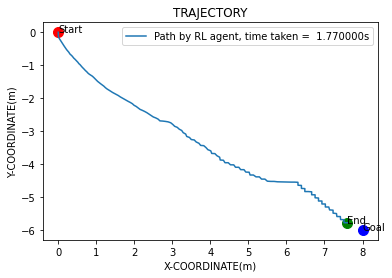

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 186      |
|    ep_rew_mean     | -121     |
| time/              |          |
|    episodes        | 529      |
|    fps             | 15       |
|    time_elapsed    | 6456     |
|    total_timesteps | 101593   |
| train/             |          |
|    actor_loss      | 44       |
|    critic_loss     | 2.43     |
|    learning_rate   | 0.001    |
|    n_updates       | 51533    |
---------------------------------
EP_REWARD:2.0


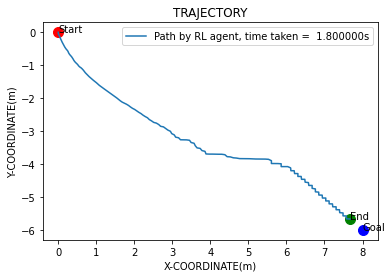

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 186      |
|    ep_rew_mean     | -120     |
| time/              |          |
|    episodes        | 530      |
|    fps             | 15       |
|    time_elapsed    | 6461     |
|    total_timesteps | 101773   |
| train/             |          |
|    actor_loss      | 44.4     |
|    critic_loss     | 3.1      |
|    learning_rate   | 0.001    |
|    n_updates       | 51710    |
---------------------------------
EP_REWARD:1.1


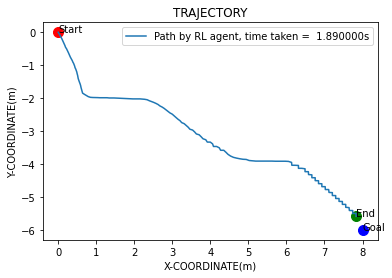

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 186      |
|    ep_rew_mean     | -120     |
| time/              |          |
|    episodes        | 531      |
|    fps             | 15       |
|    time_elapsed    | 6467     |
|    total_timesteps | 101962   |
| train/             |          |
|    actor_loss      | 44.4     |
|    critic_loss     | 4.97     |
|    learning_rate   | 0.001    |
|    n_updates       | 51890    |
---------------------------------
EP_REWARD:2.1


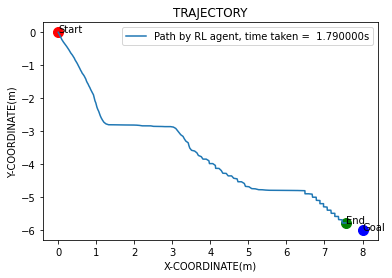

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 186      |
|    ep_rew_mean     | -120     |
| time/              |          |
|    episodes        | 532      |
|    fps             | 15       |
|    time_elapsed    | 6473     |
|    total_timesteps | 102141   |
| train/             |          |
|    actor_loss      | 43.8     |
|    critic_loss     | 2.3      |
|    learning_rate   | 0.001    |
|    n_updates       | 52079    |
---------------------------------
EP_REWARD:-32


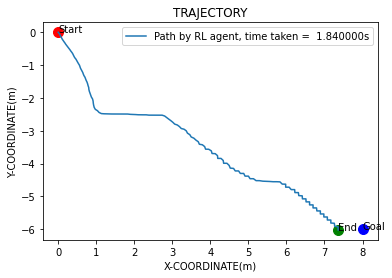

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 186      |
|    ep_rew_mean     | -120     |
| time/              |          |
|    episodes        | 533      |
|    fps             | 15       |
|    time_elapsed    | 6479     |
|    total_timesteps | 102325   |
| train/             |          |
|    actor_loss      | 43.7     |
|    critic_loss     | 2.86     |
|    learning_rate   | 0.001    |
|    n_updates       | 52258    |
---------------------------------
EP_REWARD:1.9000000000000001


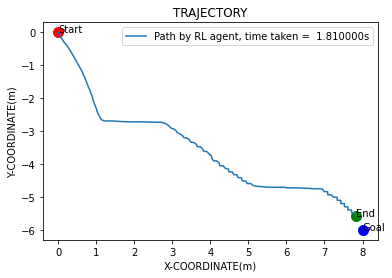

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 186      |
|    ep_rew_mean     | -120     |
| time/              |          |
|    episodes        | 534      |
|    fps             | 15       |
|    time_elapsed    | 6485     |
|    total_timesteps | 102506   |
| train/             |          |
|    actor_loss      | 44.1     |
|    critic_loss     | 2.36     |
|    learning_rate   | 0.001    |
|    n_updates       | 52442    |
---------------------------------
EP_REWARD:1.7000000000000002


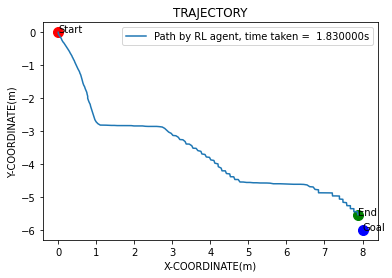

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 186      |
|    ep_rew_mean     | -120     |
| time/              |          |
|    episodes        | 535      |
|    fps             | 15       |
|    time_elapsed    | 6492     |
|    total_timesteps | 102689   |
| train/             |          |
|    actor_loss      | 43.6     |
|    critic_loss     | 3.29     |
|    learning_rate   | 0.001    |
|    n_updates       | 52623    |
---------------------------------
EP_REWARD:2.0


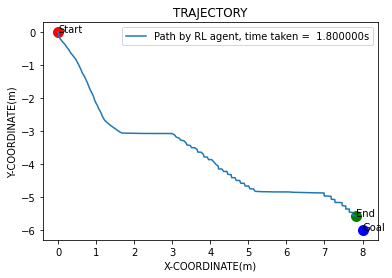

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 186      |
|    ep_rew_mean     | -120     |
| time/              |          |
|    episodes        | 536      |
|    fps             | 15       |
|    time_elapsed    | 6498     |
|    total_timesteps | 102869   |
| train/             |          |
|    actor_loss      | 43.7     |
|    critic_loss     | 2.43     |
|    learning_rate   | 0.001    |
|    n_updates       | 52806    |
---------------------------------
EP_REWARD:1.6


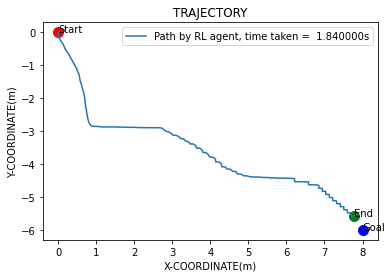

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 186      |
|    ep_rew_mean     | -120     |
| time/              |          |
|    episodes        | 537      |
|    fps             | 15       |
|    time_elapsed    | 6504     |
|    total_timesteps | 103053   |
| train/             |          |
|    actor_loss      | 43.7     |
|    critic_loss     | 1.65     |
|    learning_rate   | 0.001    |
|    n_updates       | 52986    |
---------------------------------
EP_REWARD:-42


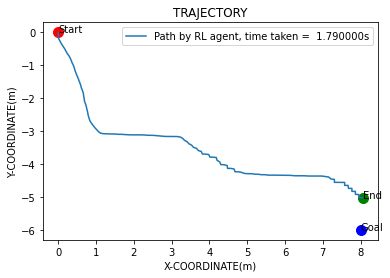

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 185      |
|    ep_rew_mean     | -120     |
| time/              |          |
|    episodes        | 538      |
|    fps             | 15       |
|    time_elapsed    | 6510     |
|    total_timesteps | 103232   |
| train/             |          |
|    actor_loss      | 43.6     |
|    critic_loss     | 3.49     |
|    learning_rate   | 0.001    |
|    n_updates       | 53170    |
---------------------------------
EP_REWARD:1.5


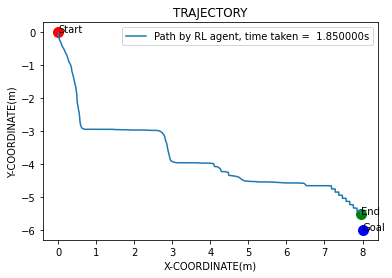

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 185      |
|    ep_rew_mean     | -120     |
| time/              |          |
|    episodes        | 539      |
|    fps             | 15       |
|    time_elapsed    | 6516     |
|    total_timesteps | 103417   |
| train/             |          |
|    actor_loss      | 43.4     |
|    critic_loss     | 2.99     |
|    learning_rate   | 0.001    |
|    n_updates       | 53349    |
---------------------------------
EP_REWARD:-32


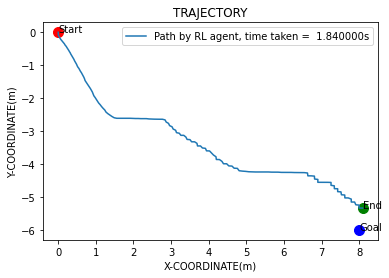

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 185      |
|    ep_rew_mean     | -120     |
| time/              |          |
|    episodes        | 540      |
|    fps             | 15       |
|    time_elapsed    | 6522     |
|    total_timesteps | 103601   |
| train/             |          |
|    actor_loss      | 43.7     |
|    critic_loss     | 3.35     |
|    learning_rate   | 0.001    |
|    n_updates       | 53534    |
---------------------------------
EP_REWARD:-36


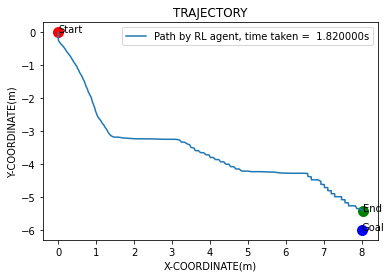

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 185      |
|    ep_rew_mean     | -120     |
| time/              |          |
|    episodes        | 541      |
|    fps             | 15       |
|    time_elapsed    | 6528     |
|    total_timesteps | 103783   |
| train/             |          |
|    actor_loss      | 43.2     |
|    critic_loss     | 2.84     |
|    learning_rate   | 0.001    |
|    n_updates       | 53718    |
---------------------------------
EP_REWARD:1.6


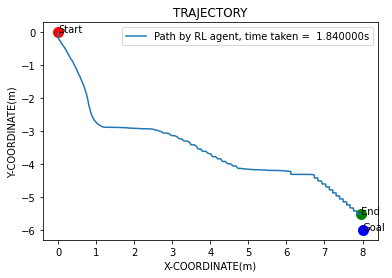

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 185      |
|    ep_rew_mean     | -120     |
| time/              |          |
|    episodes        | 542      |
|    fps             | 15       |
|    time_elapsed    | 6535     |
|    total_timesteps | 103967   |
| train/             |          |
|    actor_loss      | 42.9     |
|    critic_loss     | 2.72     |
|    learning_rate   | 0.001    |
|    n_updates       | 53900    |
---------------------------------
EP_REWARD:-42


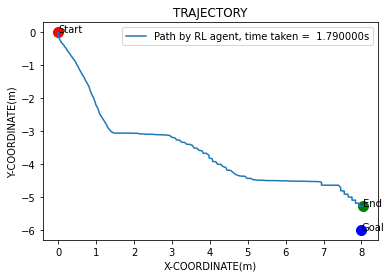

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 185      |
|    ep_rew_mean     | -120     |
| time/              |          |
|    episodes        | 543      |
|    fps             | 15       |
|    time_elapsed    | 6541     |
|    total_timesteps | 104146   |
| train/             |          |
|    actor_loss      | 43.2     |
|    critic_loss     | 1.57     |
|    learning_rate   | 0.001    |
|    n_updates       | 54084    |
---------------------------------
EP_REWARD:1.7000000000000002


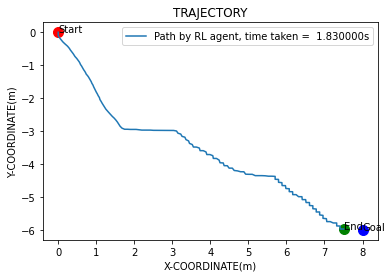

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 185      |
|    ep_rew_mean     | -120     |
| time/              |          |
|    episodes        | 544      |
|    fps             | 15       |
|    time_elapsed    | 6547     |
|    total_timesteps | 104329   |
| train/             |          |
|    actor_loss      | 42.8     |
|    critic_loss     | 4.55     |
|    learning_rate   | 0.001    |
|    n_updates       | 54263    |
---------------------------------
EP_REWARD:-46


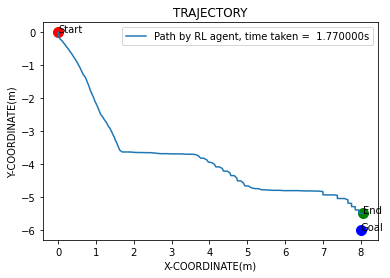

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 185      |
|    ep_rew_mean     | -120     |
| time/              |          |
|    episodes        | 545      |
|    fps             | 15       |
|    time_elapsed    | 6553     |
|    total_timesteps | 104506   |
| train/             |          |
|    actor_loss      | 42.7     |
|    critic_loss     | 2.29     |
|    learning_rate   | 0.001    |
|    n_updates       | 54446    |
---------------------------------
EP_REWARD:1.9000000000000001


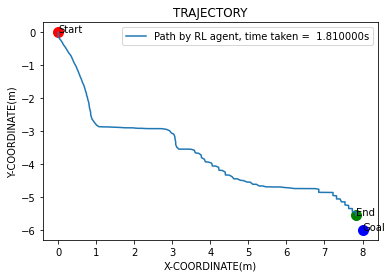

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 184      |
|    ep_rew_mean     | -120     |
| time/              |          |
|    episodes        | 546      |
|    fps             | 15       |
|    time_elapsed    | 6559     |
|    total_timesteps | 104687   |
| train/             |          |
|    actor_loss      | 42.7     |
|    critic_loss     | 2.11     |
|    learning_rate   | 0.001    |
|    n_updates       | 54623    |
---------------------------------
EP_REWARD:-44


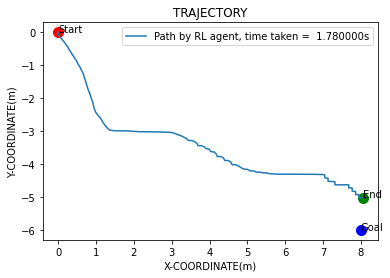

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 184      |
|    ep_rew_mean     | -121     |
| time/              |          |
|    episodes        | 547      |
|    fps             | 15       |
|    time_elapsed    | 6565     |
|    total_timesteps | 104865   |
| train/             |          |
|    actor_loss      | 42.7     |
|    critic_loss     | 1.56     |
|    learning_rate   | 0.001    |
|    n_updates       | 54804    |
---------------------------------
EP_REWARD:-0.4138246382436296


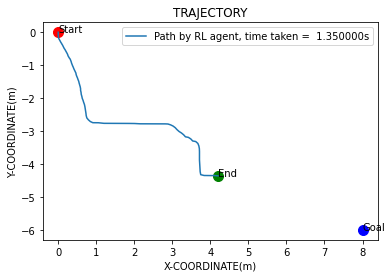

EP_REWARD:-44


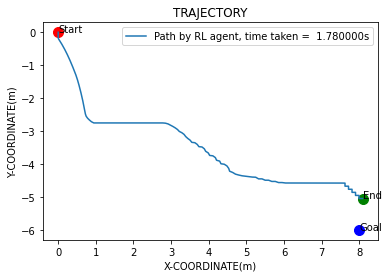

EP_REWARD:-44


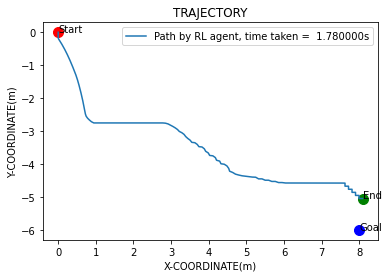

EP_REWARD:-44


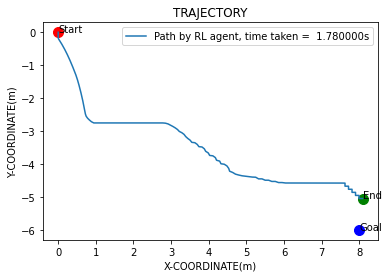

EP_REWARD:-44


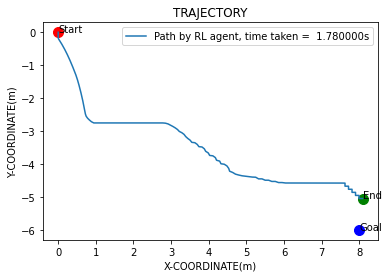

EP_REWARD:-44


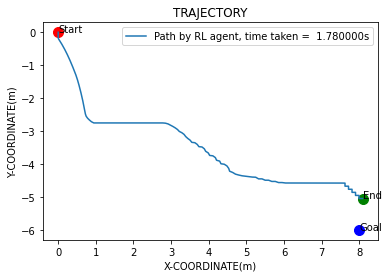

Eval num_timesteps=105000, episode_reward=-158.56 +/- 0.00
Episode length: 178.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 178      |
|    mean_reward     | -159     |
| time/              |          |
|    total_timesteps | 105000   |
| train/             |          |
|    actor_loss      | 42.9     |
|    critic_loss     | 2.93     |
|    learning_rate   | 0.001    |
|    n_updates       | 54982    |
---------------------------------
EP_REWARD:-44


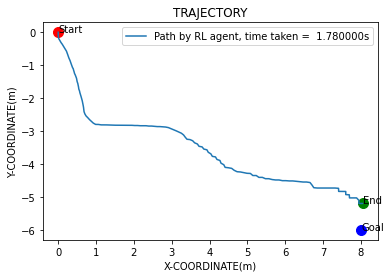

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 184      |
|    ep_rew_mean     | -121     |
| time/              |          |
|    episodes        | 548      |
|    fps             | 16       |
|    time_elapsed    | 6573     |
|    total_timesteps | 105178   |
---------------------------------
EP_REWARD:2.1


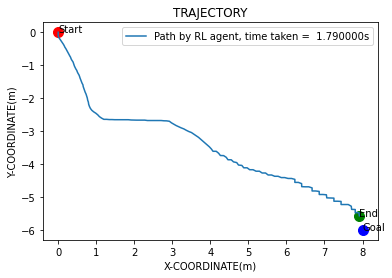

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 184      |
|    ep_rew_mean     | -121     |
| time/              |          |
|    episodes        | 549      |
|    fps             | 16       |
|    time_elapsed    | 6583     |
|    total_timesteps | 105357   |
| train/             |          |
|    actor_loss      | 42.6     |
|    critic_loss     | 2.65     |
|    learning_rate   | 0.001    |
|    n_updates       | 55295    |
---------------------------------
EP_REWARD:2.9000000000000004


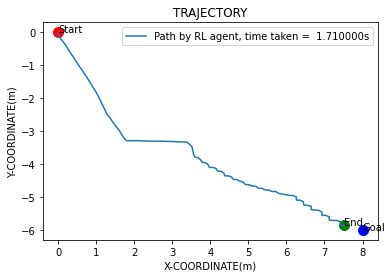

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 184      |
|    ep_rew_mean     | -121     |
| time/              |          |
|    episodes        | 550      |
|    fps             | 16       |
|    time_elapsed    | 6589     |
|    total_timesteps | 105528   |
| train/             |          |
|    actor_loss      | 42.2     |
|    critic_loss     | 2.47     |
|    learning_rate   | 0.001    |
|    n_updates       | 55474    |
---------------------------------
EP_REWARD:3.4000000000000004


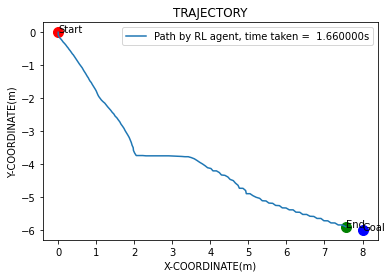

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 183      |
|    ep_rew_mean     | -120     |
| time/              |          |
|    episodes        | 551      |
|    fps             | 16       |
|    time_elapsed    | 6594     |
|    total_timesteps | 105694   |
| train/             |          |
|    actor_loss      | 42.7     |
|    critic_loss     | 2.31     |
|    learning_rate   | 0.001    |
|    n_updates       | 55645    |
---------------------------------
EP_REWARD:-46


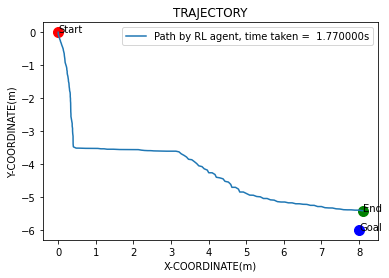

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 183      |
|    ep_rew_mean     | -121     |
| time/              |          |
|    episodes        | 552      |
|    fps             | 16       |
|    time_elapsed    | 6600     |
|    total_timesteps | 105871   |
| train/             |          |
|    actor_loss      | 42.6     |
|    critic_loss     | 3.99     |
|    learning_rate   | 0.001    |
|    n_updates       | 55811    |
---------------------------------
EP_REWARD:-36


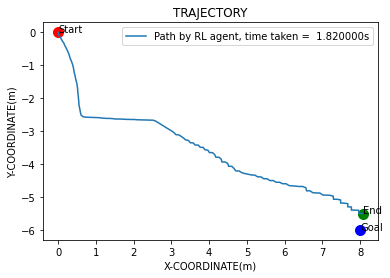

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 183      |
|    ep_rew_mean     | -121     |
| time/              |          |
|    episodes        | 553      |
|    fps             | 16       |
|    time_elapsed    | 6606     |
|    total_timesteps | 106053   |
| train/             |          |
|    actor_loss      | 42.6     |
|    critic_loss     | 2.61     |
|    learning_rate   | 0.001    |
|    n_updates       | 55988    |
---------------------------------
EP_REWARD:-44


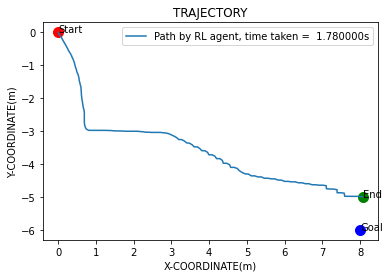

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 183      |
|    ep_rew_mean     | -121     |
| time/              |          |
|    episodes        | 554      |
|    fps             | 16       |
|    time_elapsed    | 6613     |
|    total_timesteps | 106231   |
| train/             |          |
|    actor_loss      | 42.4     |
|    critic_loss     | 3.45     |
|    learning_rate   | 0.001    |
|    n_updates       | 56170    |
---------------------------------
EP_REWARD:-46


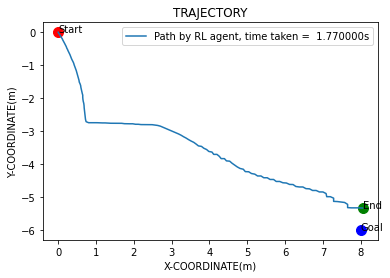

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 183      |
|    ep_rew_mean     | -122     |
| time/              |          |
|    episodes        | 555      |
|    fps             | 16       |
|    time_elapsed    | 6619     |
|    total_timesteps | 106408   |
| train/             |          |
|    actor_loss      | 42.4     |
|    critic_loss     | 2.37     |
|    learning_rate   | 0.001    |
|    n_updates       | 56348    |
---------------------------------
EP_REWARD:2.4000000000000004


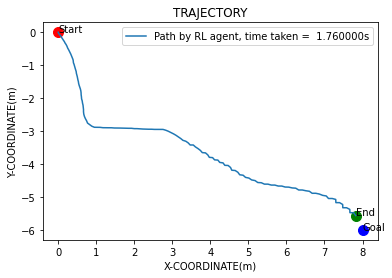

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 183      |
|    ep_rew_mean     | -122     |
| time/              |          |
|    episodes        | 556      |
|    fps             | 16       |
|    time_elapsed    | 6625     |
|    total_timesteps | 106584   |
| train/             |          |
|    actor_loss      | 42.6     |
|    critic_loss     | 2.95     |
|    learning_rate   | 0.001    |
|    n_updates       | 56525    |
---------------------------------
EP_REWARD:2.3000000000000003


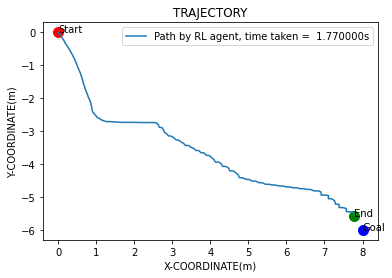

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 182      |
|    ep_rew_mean     | -122     |
| time/              |          |
|    episodes        | 557      |
|    fps             | 16       |
|    time_elapsed    | 6632     |
|    total_timesteps | 106761   |
| train/             |          |
|    actor_loss      | 42.7     |
|    critic_loss     | 1.95     |
|    learning_rate   | 0.001    |
|    n_updates       | 56701    |
---------------------------------
EP_REWARD:-42


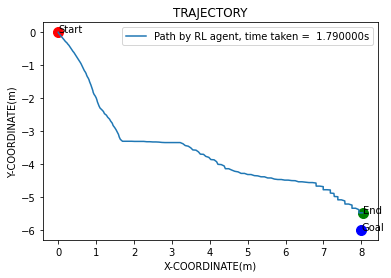

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 182      |
|    ep_rew_mean     | -122     |
| time/              |          |
|    episodes        | 558      |
|    fps             | 16       |
|    time_elapsed    | 6638     |
|    total_timesteps | 106940   |
| train/             |          |
|    actor_loss      | 42.2     |
|    critic_loss     | 3.68     |
|    learning_rate   | 0.001    |
|    n_updates       | 56878    |
---------------------------------
EP_REWARD:2.1


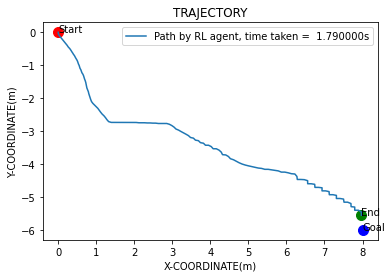

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 182      |
|    ep_rew_mean     | -122     |
| time/              |          |
|    episodes        | 559      |
|    fps             | 16       |
|    time_elapsed    | 6644     |
|    total_timesteps | 107119   |
| train/             |          |
|    actor_loss      | 42       |
|    critic_loss     | 3.99     |
|    learning_rate   | 0.001    |
|    n_updates       | 57057    |
---------------------------------
EP_REWARD:2.2


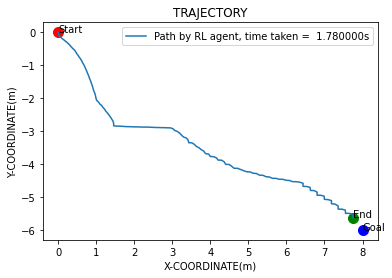

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 182      |
|    ep_rew_mean     | -121     |
| time/              |          |
|    episodes        | 560      |
|    fps             | 16       |
|    time_elapsed    | 6651     |
|    total_timesteps | 107297   |
| train/             |          |
|    actor_loss      | 42.6     |
|    critic_loss     | 2.43     |
|    learning_rate   | 0.001    |
|    n_updates       | 57236    |
---------------------------------
EP_REWARD:2.9000000000000004


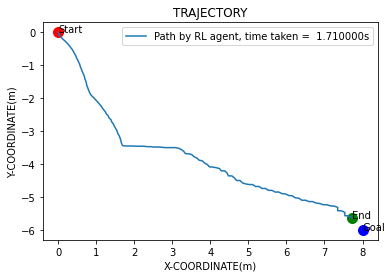

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 182      |
|    ep_rew_mean     | -121     |
| time/              |          |
|    episodes        | 561      |
|    fps             | 16       |
|    time_elapsed    | 6656     |
|    total_timesteps | 107468   |
| train/             |          |
|    actor_loss      | 42.8     |
|    critic_loss     | 1.83     |
|    learning_rate   | 0.001    |
|    n_updates       | 57414    |
---------------------------------
EP_REWARD:-46


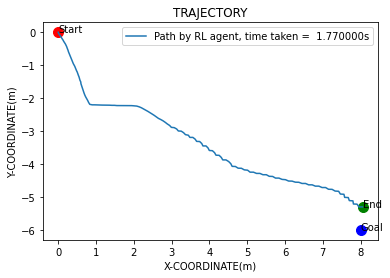

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 182      |
|    ep_rew_mean     | -122     |
| time/              |          |
|    episodes        | 562      |
|    fps             | 16       |
|    time_elapsed    | 6662     |
|    total_timesteps | 107645   |
| train/             |          |
|    actor_loss      | 42.3     |
|    critic_loss     | 3.58     |
|    learning_rate   | 0.001    |
|    n_updates       | 57585    |
---------------------------------
EP_REWARD:-44


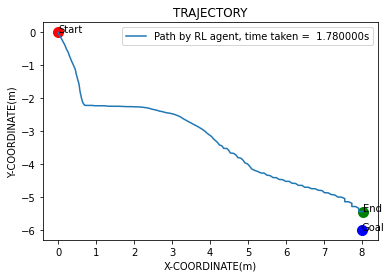

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 182      |
|    ep_rew_mean     | -122     |
| time/              |          |
|    episodes        | 563      |
|    fps             | 16       |
|    time_elapsed    | 6668     |
|    total_timesteps | 107823   |
| train/             |          |
|    actor_loss      | 42.7     |
|    critic_loss     | 2.49     |
|    learning_rate   | 0.001    |
|    n_updates       | 57762    |
---------------------------------
EP_REWARD:2.5


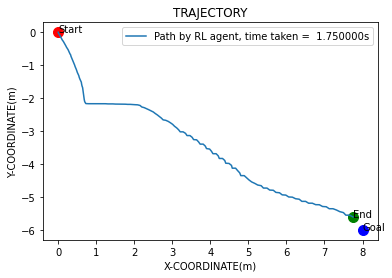

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 181      |
|    ep_rew_mean     | -122     |
| time/              |          |
|    episodes        | 564      |
|    fps             | 16       |
|    time_elapsed    | 6675     |
|    total_timesteps | 107998   |
| train/             |          |
|    actor_loss      | 42.8     |
|    critic_loss     | 2.19     |
|    learning_rate   | 0.001    |
|    n_updates       | 57940    |
---------------------------------
EP_REWARD:2.7


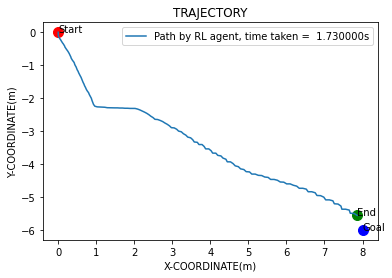

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 181      |
|    ep_rew_mean     | -122     |
| time/              |          |
|    episodes        | 565      |
|    fps             | 16       |
|    time_elapsed    | 6681     |
|    total_timesteps | 108171   |
| train/             |          |
|    actor_loss      | 42.5     |
|    critic_loss     | 2.96     |
|    learning_rate   | 0.001    |
|    n_updates       | 58115    |
---------------------------------
EP_REWARD:2.2


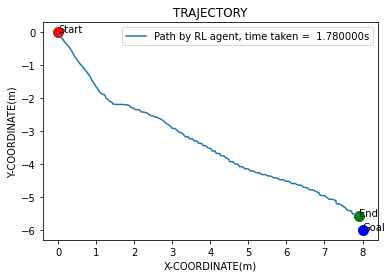

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 181      |
|    ep_rew_mean     | -122     |
| time/              |          |
|    episodes        | 566      |
|    fps             | 16       |
|    time_elapsed    | 6687     |
|    total_timesteps | 108349   |
| train/             |          |
|    actor_loss      | 43.1     |
|    critic_loss     | 2.55     |
|    learning_rate   | 0.001    |
|    n_updates       | 58288    |
---------------------------------
EP_REWARD:3.0


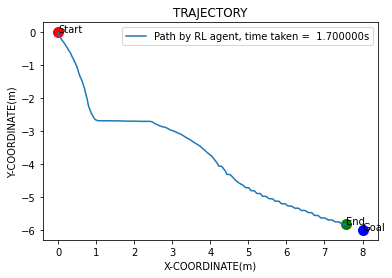

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 181      |
|    ep_rew_mean     | -122     |
| time/              |          |
|    episodes        | 567      |
|    fps             | 16       |
|    time_elapsed    | 6694     |
|    total_timesteps | 108519   |
| train/             |          |
|    actor_loss      | 42.7     |
|    critic_loss     | 3.53     |
|    learning_rate   | 0.001    |
|    n_updates       | 58466    |
---------------------------------
EP_REWARD:3.1


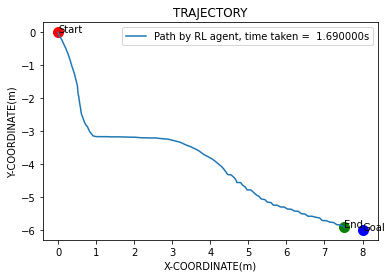

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 181      |
|    ep_rew_mean     | -121     |
| time/              |          |
|    episodes        | 568      |
|    fps             | 16       |
|    time_elapsed    | 6701     |
|    total_timesteps | 108688   |
| train/             |          |
|    actor_loss      | 42.3     |
|    critic_loss     | 2.6      |
|    learning_rate   | 0.001    |
|    n_updates       | 58636    |
---------------------------------
EP_REWARD:-70


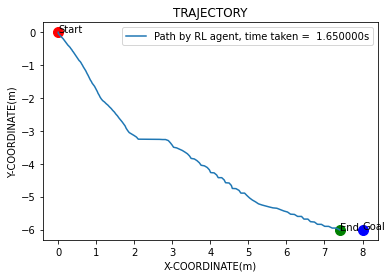

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 181      |
|    ep_rew_mean     | -122     |
| time/              |          |
|    episodes        | 569      |
|    fps             | 16       |
|    time_elapsed    | 6706     |
|    total_timesteps | 108853   |
| train/             |          |
|    actor_loss      | 42.2     |
|    critic_loss     | 3.75     |
|    learning_rate   | 0.001    |
|    n_updates       | 58805    |
---------------------------------
EP_REWARD:-80


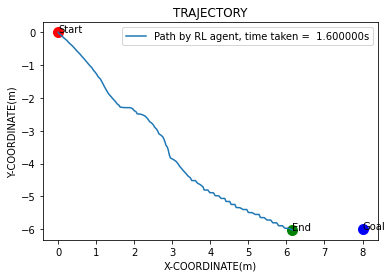

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 180      |
|    ep_rew_mean     | -123     |
| time/              |          |
|    episodes        | 570      |
|    fps             | 16       |
|    time_elapsed    | 6712     |
|    total_timesteps | 109013   |
| train/             |          |
|    actor_loss      | 42.9     |
|    critic_loss     | 4.04     |
|    learning_rate   | 0.001    |
|    n_updates       | 58970    |
---------------------------------
EP_REWARD:-46


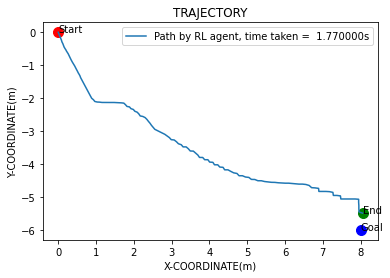

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 180      |
|    ep_rew_mean     | -123     |
| time/              |          |
|    episodes        | 571      |
|    fps             | 16       |
|    time_elapsed    | 6718     |
|    total_timesteps | 109190   |
| train/             |          |
|    actor_loss      | 42.8     |
|    critic_loss     | 3.33     |
|    learning_rate   | 0.001    |
|    n_updates       | 59130    |
---------------------------------
EP_REWARD:2.6


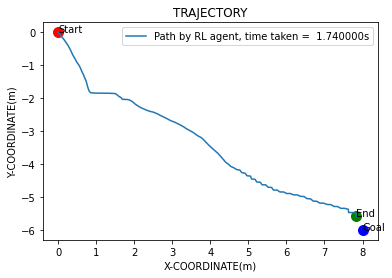

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 180      |
|    ep_rew_mean     | -123     |
| time/              |          |
|    episodes        | 572      |
|    fps             | 16       |
|    time_elapsed    | 6724     |
|    total_timesteps | 109364   |
| train/             |          |
|    actor_loss      | 42.6     |
|    critic_loss     | 3.81     |
|    learning_rate   | 0.001    |
|    n_updates       | 59307    |
---------------------------------
EP_REWARD:2.8000000000000003


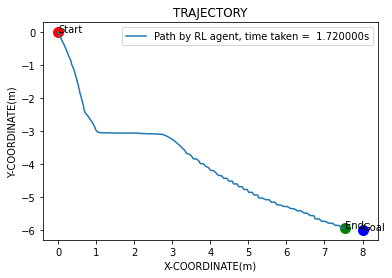

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 180      |
|    ep_rew_mean     | -123     |
| time/              |          |
|    episodes        | 573      |
|    fps             | 16       |
|    time_elapsed    | 6730     |
|    total_timesteps | 109536   |
| train/             |          |
|    actor_loss      | 42.7     |
|    critic_loss     | 2.99     |
|    learning_rate   | 0.001    |
|    n_updates       | 59481    |
---------------------------------
EP_REWARD:-76


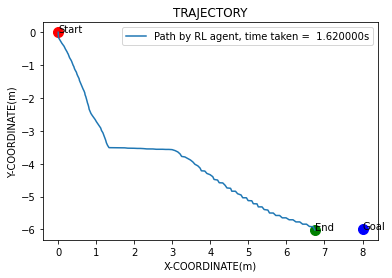

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 180      |
|    ep_rew_mean     | -124     |
| time/              |          |
|    episodes        | 574      |
|    fps             | 16       |
|    time_elapsed    | 6737     |
|    total_timesteps | 109698   |
| train/             |          |
|    actor_loss      | 42.9     |
|    critic_loss     | 2.95     |
|    learning_rate   | 0.001    |
|    n_updates       | 59653    |
---------------------------------
EP_REWARD:-66


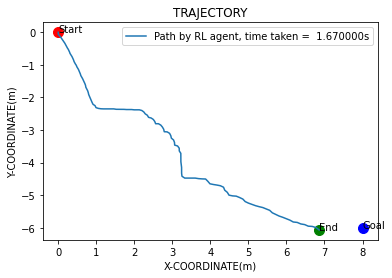

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 180      |
|    ep_rew_mean     | -124     |
| time/              |          |
|    episodes        | 575      |
|    fps             | 16       |
|    time_elapsed    | 6742     |
|    total_timesteps | 109865   |
| train/             |          |
|    actor_loss      | 43.3     |
|    critic_loss     | 1.45     |
|    learning_rate   | 0.001    |
|    n_updates       | 59815    |
---------------------------------
EP_REWARD:-0.38928213991362853


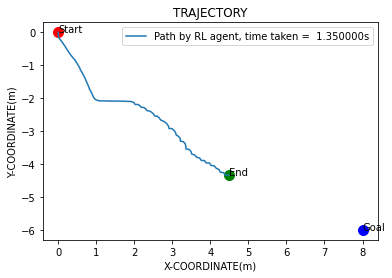

EP_REWARD:2.1


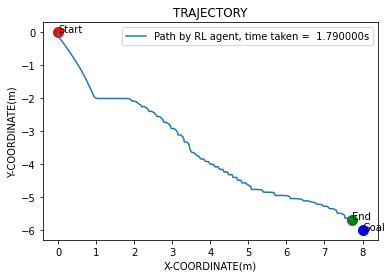

EP_REWARD:2.1


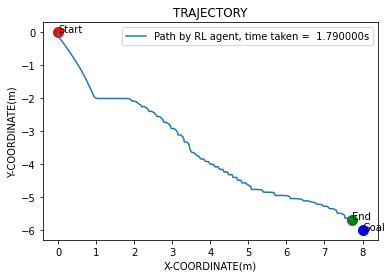

EP_REWARD:2.1


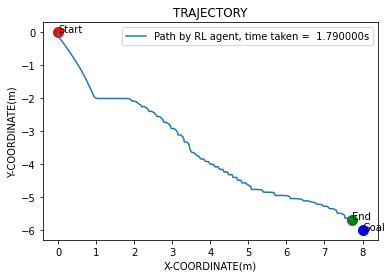

EP_REWARD:2.1


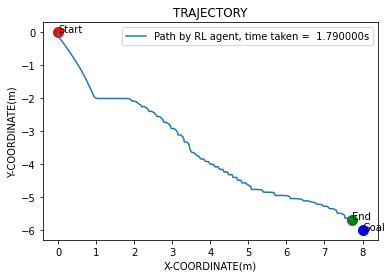

EP_REWARD:2.1


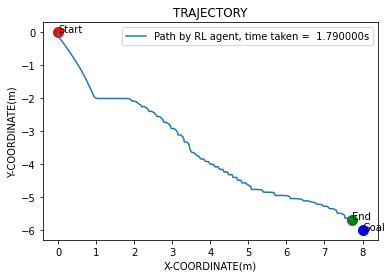

Eval num_timesteps=110000, episode_reward=-112.60 +/- 0.00
Episode length: 179.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 179      |
|    mean_reward     | -113     |
| time/              |          |
|    total_timesteps | 110000   |
| train/             |          |
|    actor_loss      | 42.5     |
|    critic_loss     | 3.73     |
|    learning_rate   | 0.001    |
|    n_updates       | 59982    |
---------------------------------
EP_REWARD:2.1


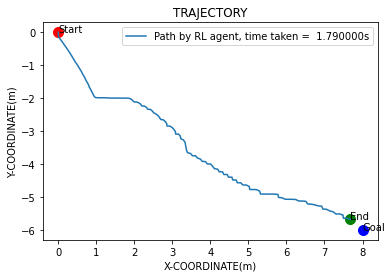

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 180      |
|    ep_rew_mean     | -124     |
| time/              |          |
|    episodes        | 576      |
|    fps             | 16       |
|    time_elapsed    | 6750     |
|    total_timesteps | 110179   |
---------------------------------
EP_REWARD:2.2


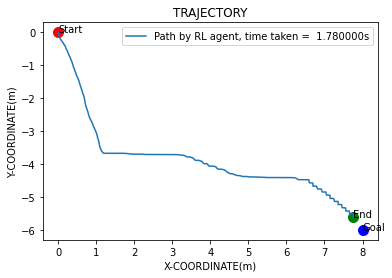

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 180      |
|    ep_rew_mean     | -124     |
| time/              |          |
|    episodes        | 577      |
|    fps             | 16       |
|    time_elapsed    | 6760     |
|    total_timesteps | 110357   |
| train/             |          |
|    actor_loss      | 42.7     |
|    critic_loss     | 2.58     |
|    learning_rate   | 0.001    |
|    n_updates       | 60296    |
---------------------------------
EP_REWARD:2.1


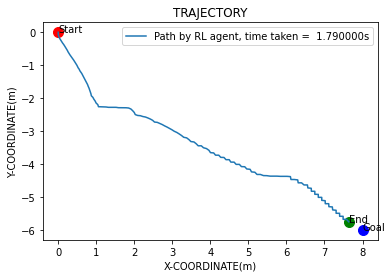

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 179      |
|    ep_rew_mean     | -124     |
| time/              |          |
|    episodes        | 578      |
|    fps             | 16       |
|    time_elapsed    | 6767     |
|    total_timesteps | 110536   |
| train/             |          |
|    actor_loss      | 43.2     |
|    critic_loss     | 4.15     |
|    learning_rate   | 0.001    |
|    n_updates       | 60474    |
---------------------------------
EP_REWARD:-46


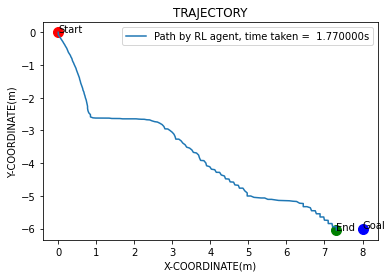

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 180      |
|    ep_rew_mean     | -125     |
| time/              |          |
|    episodes        | 579      |
|    fps             | 16       |
|    time_elapsed    | 6774     |
|    total_timesteps | 110713   |
| train/             |          |
|    actor_loss      | 43.2     |
|    critic_loss     | 3.68     |
|    learning_rate   | 0.001    |
|    n_updates       | 60653    |
---------------------------------
EP_REWARD:3.0


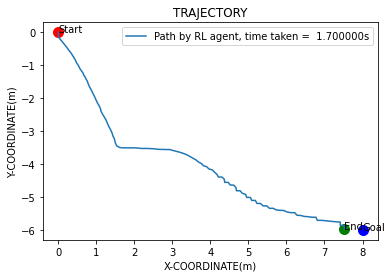

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 179      |
|    ep_rew_mean     | -125     |
| time/              |          |
|    episodes        | 580      |
|    fps             | 16       |
|    time_elapsed    | 6780     |
|    total_timesteps | 110883   |
| train/             |          |
|    actor_loss      | 43       |
|    critic_loss     | 2.85     |
|    learning_rate   | 0.001    |
|    n_updates       | 60830    |
---------------------------------
EP_REWARD:3.0


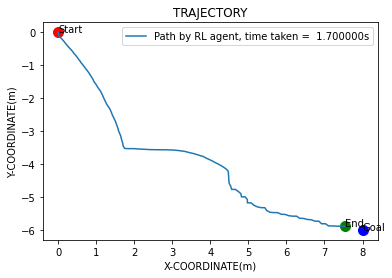

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 179      |
|    ep_rew_mean     | -125     |
| time/              |          |
|    episodes        | 581      |
|    fps             | 16       |
|    time_elapsed    | 6786     |
|    total_timesteps | 111053   |
| train/             |          |
|    actor_loss      | 42.4     |
|    critic_loss     | 2.51     |
|    learning_rate   | 0.001    |
|    n_updates       | 61000    |
---------------------------------
EP_REWARD:2.7


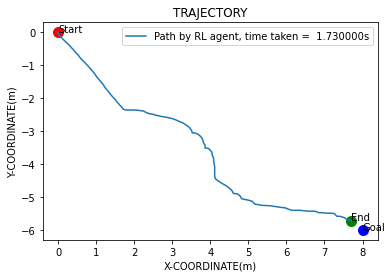

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 179      |
|    ep_rew_mean     | -125     |
| time/              |          |
|    episodes        | 582      |
|    fps             | 16       |
|    time_elapsed    | 6792     |
|    total_timesteps | 111226   |
| train/             |          |
|    actor_loss      | 43.3     |
|    critic_loss     | 2.23     |
|    learning_rate   | 0.001    |
|    n_updates       | 61170    |
---------------------------------
EP_REWARD:2.7


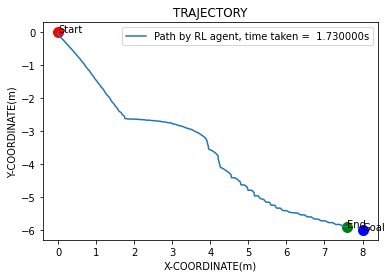

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 179      |
|    ep_rew_mean     | -125     |
| time/              |          |
|    episodes        | 583      |
|    fps             | 16       |
|    time_elapsed    | 6798     |
|    total_timesteps | 111399   |
| train/             |          |
|    actor_loss      | 42.9     |
|    critic_loss     | 1.86     |
|    learning_rate   | 0.001    |
|    n_updates       | 61343    |
---------------------------------
EP_REWARD:3.1


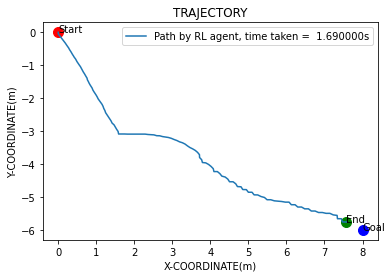

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 179      |
|    ep_rew_mean     | -125     |
| time/              |          |
|    episodes        | 584      |
|    fps             | 16       |
|    time_elapsed    | 6804     |
|    total_timesteps | 111568   |
| train/             |          |
|    actor_loss      | 43       |
|    critic_loss     | 2.41     |
|    learning_rate   | 0.001    |
|    n_updates       | 61516    |
---------------------------------
EP_REWARD:2.7


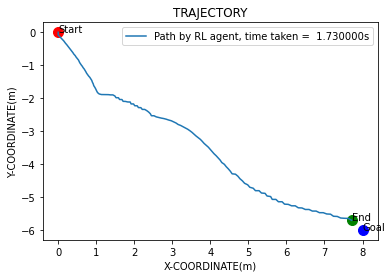

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 179      |
|    ep_rew_mean     | -125     |
| time/              |          |
|    episodes        | 585      |
|    fps             | 16       |
|    time_elapsed    | 6809     |
|    total_timesteps | 111741   |
| train/             |          |
|    actor_loss      | 43       |
|    critic_loss     | 3.6      |
|    learning_rate   | 0.001    |
|    n_updates       | 61685    |
---------------------------------
EP_REWARD:2.9000000000000004


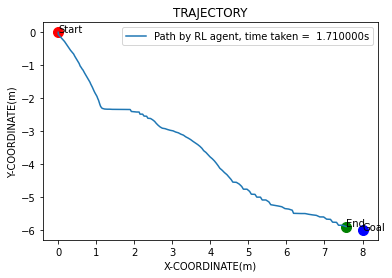

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 179      |
|    ep_rew_mean     | -125     |
| time/              |          |
|    episodes        | 586      |
|    fps             | 16       |
|    time_elapsed    | 6815     |
|    total_timesteps | 111912   |
| train/             |          |
|    actor_loss      | 42.5     |
|    critic_loss     | 1.7      |
|    learning_rate   | 0.001    |
|    n_updates       | 61858    |
---------------------------------
EP_REWARD:3.5


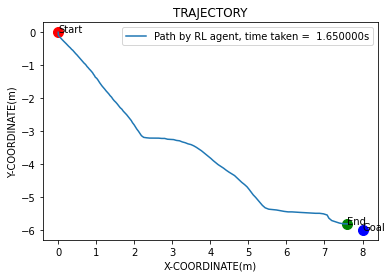

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 179      |
|    ep_rew_mean     | -125     |
| time/              |          |
|    episodes        | 587      |
|    fps             | 16       |
|    time_elapsed    | 6822     |
|    total_timesteps | 112077   |
| train/             |          |
|    actor_loss      | 42.6     |
|    critic_loss     | 6.11     |
|    learning_rate   | 0.001    |
|    n_updates       | 62029    |
---------------------------------
EP_REWARD:1.5


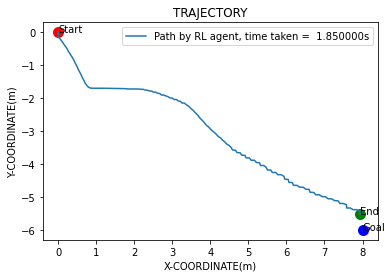

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 179      |
|    ep_rew_mean     | -125     |
| time/              |          |
|    episodes        | 588      |
|    fps             | 16       |
|    time_elapsed    | 6828     |
|    total_timesteps | 112262   |
| train/             |          |
|    actor_loss      | 43.1     |
|    critic_loss     | 2.6      |
|    learning_rate   | 0.001    |
|    n_updates       | 62194    |
---------------------------------
EP_REWARD:2.6


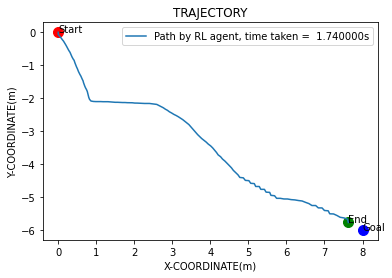

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 179      |
|    ep_rew_mean     | -125     |
| time/              |          |
|    episodes        | 589      |
|    fps             | 16       |
|    time_elapsed    | 6835     |
|    total_timesteps | 112436   |
| train/             |          |
|    actor_loss      | 43.2     |
|    critic_loss     | 3.66     |
|    learning_rate   | 0.001    |
|    n_updates       | 62379    |
---------------------------------
EP_REWARD:-56


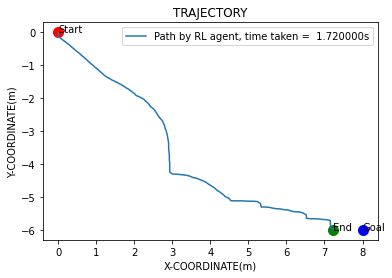

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 179      |
|    ep_rew_mean     | -125     |
| time/              |          |
|    episodes        | 590      |
|    fps             | 16       |
|    time_elapsed    | 6842     |
|    total_timesteps | 112608   |
| train/             |          |
|    actor_loss      | 43       |
|    critic_loss     | 4.03     |
|    learning_rate   | 0.001    |
|    n_updates       | 62553    |
---------------------------------
EP_REWARD:2.4000000000000004


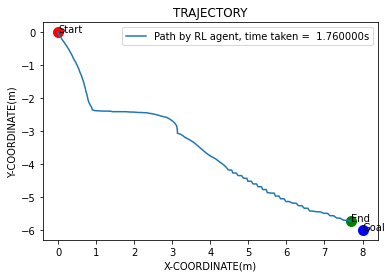

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 179      |
|    ep_rew_mean     | -125     |
| time/              |          |
|    episodes        | 591      |
|    fps             | 16       |
|    time_elapsed    | 6849     |
|    total_timesteps | 112784   |
| train/             |          |
|    actor_loss      | 42.8     |
|    critic_loss     | 3.74     |
|    learning_rate   | 0.001    |
|    n_updates       | 62725    |
---------------------------------
EP_REWARD:2.3000000000000003


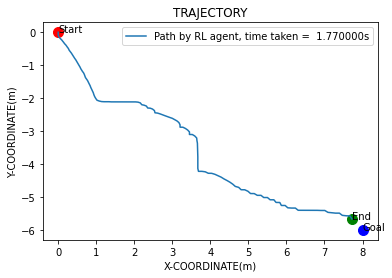

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 179      |
|    ep_rew_mean     | -125     |
| time/              |          |
|    episodes        | 592      |
|    fps             | 16       |
|    time_elapsed    | 6856     |
|    total_timesteps | 112961   |
| train/             |          |
|    actor_loss      | 43.3     |
|    critic_loss     | 2.45     |
|    learning_rate   | 0.001    |
|    n_updates       | 62901    |
---------------------------------
EP_REWARD:2.6


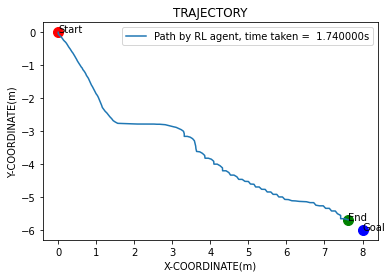

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 178      |
|    ep_rew_mean     | -125     |
| time/              |          |
|    episodes        | 593      |
|    fps             | 16       |
|    time_elapsed    | 6862     |
|    total_timesteps | 113135   |
| train/             |          |
|    actor_loss      | 42.9     |
|    critic_loss     | 3.63     |
|    learning_rate   | 0.001    |
|    n_updates       | 63078    |
---------------------------------
EP_REWARD:2.7


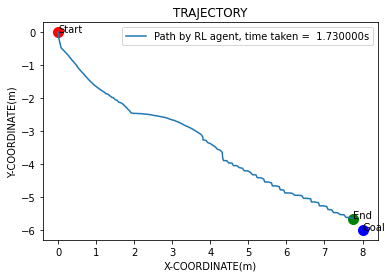

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 178      |
|    ep_rew_mean     | -125     |
| time/              |          |
|    episodes        | 594      |
|    fps             | 16       |
|    time_elapsed    | 6869     |
|    total_timesteps | 113308   |
| train/             |          |
|    actor_loss      | 43       |
|    critic_loss     | 3.55     |
|    learning_rate   | 0.001    |
|    n_updates       | 63252    |
---------------------------------
EP_REWARD:2.8000000000000003


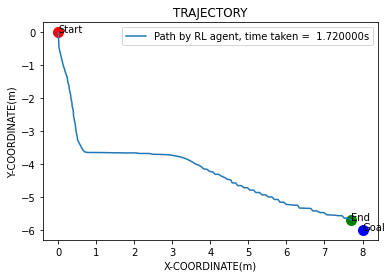

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 178      |
|    ep_rew_mean     | -125     |
| time/              |          |
|    episodes        | 595      |
|    fps             | 16       |
|    time_elapsed    | 6875     |
|    total_timesteps | 113480   |
| train/             |          |
|    actor_loss      | 43       |
|    critic_loss     | 4.32     |
|    learning_rate   | 0.001    |
|    n_updates       | 63425    |
---------------------------------
EP_REWARD:-50


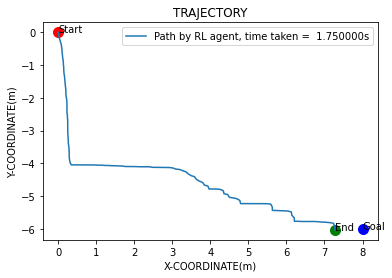

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 178      |
|    ep_rew_mean     | -126     |
| time/              |          |
|    episodes        | 596      |
|    fps             | 16       |
|    time_elapsed    | 6882     |
|    total_timesteps | 113655   |
| train/             |          |
|    actor_loss      | 42.8     |
|    critic_loss     | 3.25     |
|    learning_rate   | 0.001    |
|    n_updates       | 63597    |
---------------------------------
EP_REWARD:1.9000000000000001


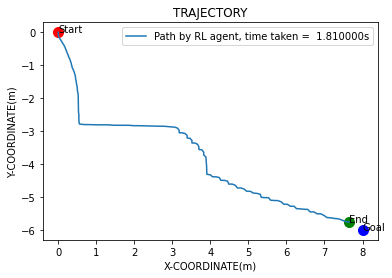

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 178      |
|    ep_rew_mean     | -126     |
| time/              |          |
|    episodes        | 597      |
|    fps             | 16       |
|    time_elapsed    | 6889     |
|    total_timesteps | 113836   |
| train/             |          |
|    actor_loss      | 42.9     |
|    critic_loss     | 4.62     |
|    learning_rate   | 0.001    |
|    n_updates       | 63772    |
---------------------------------
EP_REWARD:2.5


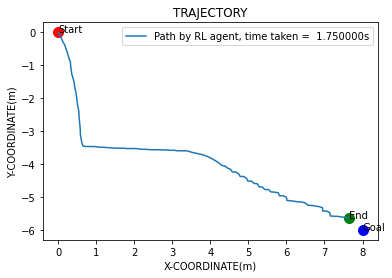

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 178      |
|    ep_rew_mean     | -126     |
| time/              |          |
|    episodes        | 598      |
|    fps             | 16       |
|    time_elapsed    | 6896     |
|    total_timesteps | 114011   |
| train/             |          |
|    actor_loss      | 43       |
|    critic_loss     | 1.71     |
|    learning_rate   | 0.001    |
|    n_updates       | 63953    |
---------------------------------
EP_REWARD:2.4000000000000004


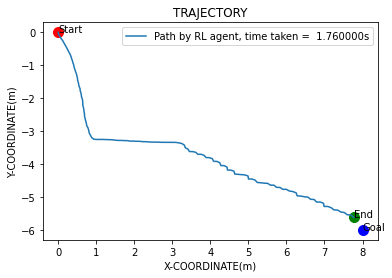

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 178      |
|    ep_rew_mean     | -126     |
| time/              |          |
|    episodes        | 599      |
|    fps             | 16       |
|    time_elapsed    | 6902     |
|    total_timesteps | 114187   |
| train/             |          |
|    actor_loss      | 42.8     |
|    critic_loss     | 2.16     |
|    learning_rate   | 0.001    |
|    n_updates       | 64128    |
---------------------------------
EP_REWARD:2.2


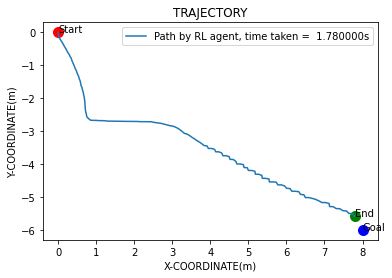

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 178      |
|    ep_rew_mean     | -126     |
| time/              |          |
|    episodes        | 600      |
|    fps             | 16       |
|    time_elapsed    | 6909     |
|    total_timesteps | 114365   |
| train/             |          |
|    actor_loss      | 43.1     |
|    critic_loss     | 3.79     |
|    learning_rate   | 0.001    |
|    n_updates       | 64304    |
---------------------------------
EP_REWARD:2.3000000000000003


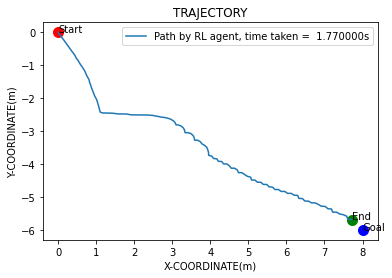

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 178      |
|    ep_rew_mean     | -126     |
| time/              |          |
|    episodes        | 601      |
|    fps             | 16       |
|    time_elapsed    | 6915     |
|    total_timesteps | 114542   |
| train/             |          |
|    actor_loss      | 42.8     |
|    critic_loss     | 2.55     |
|    learning_rate   | 0.001    |
|    n_updates       | 64482    |
---------------------------------
EP_REWARD:2.4000000000000004


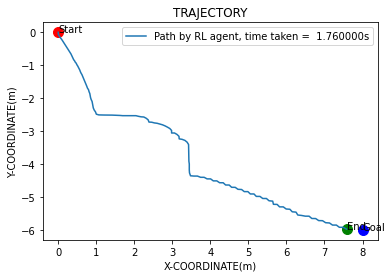

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 178      |
|    ep_rew_mean     | -126     |
| time/              |          |
|    episodes        | 602      |
|    fps             | 16       |
|    time_elapsed    | 6922     |
|    total_timesteps | 114718   |
| train/             |          |
|    actor_loss      | 43       |
|    critic_loss     | 2.56     |
|    learning_rate   | 0.001    |
|    n_updates       | 64659    |
---------------------------------
EP_REWARD:2.6


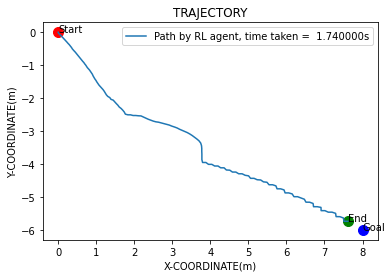

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 178      |
|    ep_rew_mean     | -126     |
| time/              |          |
|    episodes        | 603      |
|    fps             | 16       |
|    time_elapsed    | 6928     |
|    total_timesteps | 114892   |
| train/             |          |
|    actor_loss      | 42.9     |
|    critic_loss     | 3.6      |
|    learning_rate   | 0.001    |
|    n_updates       | 64835    |
---------------------------------
EP_REWARD:-0.5791574733464299


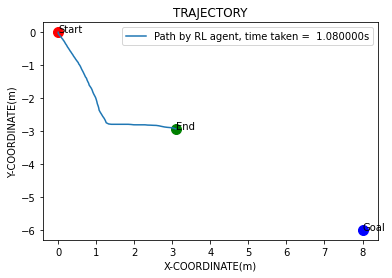

EP_REWARD:-58


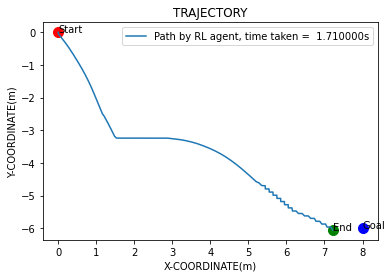

EP_REWARD:-58


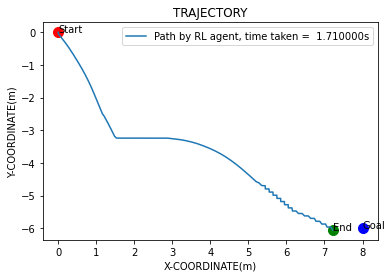

EP_REWARD:-58


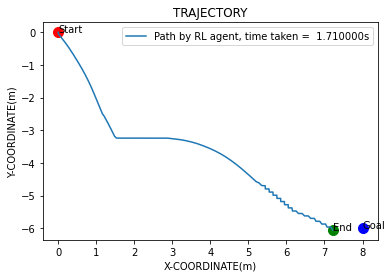

EP_REWARD:-58


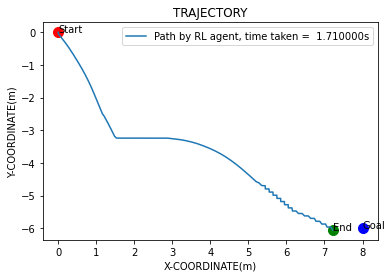

EP_REWARD:-58


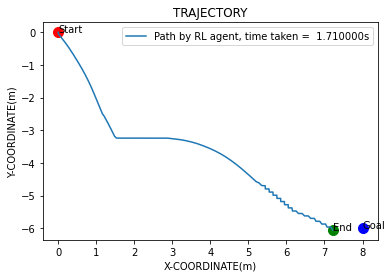

Eval num_timesteps=115000, episode_reward=-169.83 +/- 0.00
Episode length: 171.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 171      |
|    mean_reward     | -170     |
| time/              |          |
|    total_timesteps | 115000   |
| train/             |          |
|    actor_loss      | 42.9     |
|    critic_loss     | 2.13     |
|    learning_rate   | 0.001    |
|    n_updates       | 65009    |
---------------------------------
EP_REWARD:-42


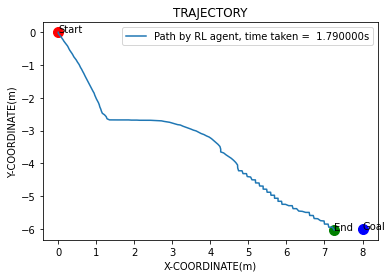

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 178      |
|    ep_rew_mean     | -126     |
| time/              |          |
|    episodes        | 604      |
|    fps             | 16       |
|    time_elapsed    | 6938     |
|    total_timesteps | 115179   |
---------------------------------
EP_REWARD:3.4000000000000004


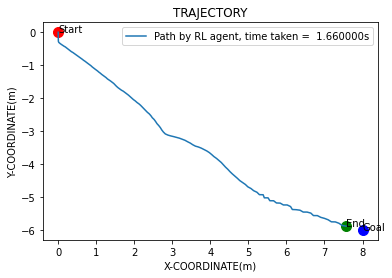

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 178      |
|    ep_rew_mean     | -126     |
| time/              |          |
|    episodes        | 605      |
|    fps             | 16       |
|    time_elapsed    | 6948     |
|    total_timesteps | 115345   |
| train/             |          |
|    actor_loss      | 43       |
|    critic_loss     | 2.65     |
|    learning_rate   | 0.001    |
|    n_updates       | 65296    |
---------------------------------
EP_REWARD:2.9000000000000004


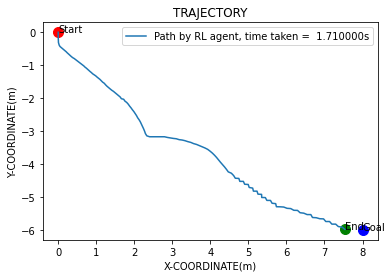

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 178      |
|    ep_rew_mean     | -126     |
| time/              |          |
|    episodes        | 606      |
|    fps             | 16       |
|    time_elapsed    | 6954     |
|    total_timesteps | 115516   |
| train/             |          |
|    actor_loss      | 42.8     |
|    critic_loss     | 4.35     |
|    learning_rate   | 0.001    |
|    n_updates       | 65462    |
---------------------------------
EP_REWARD:2.8000000000000003


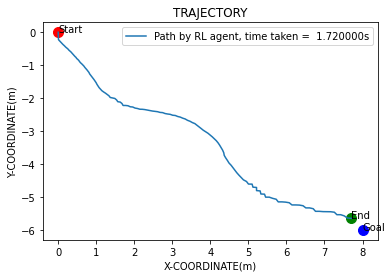

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 177      |
|    ep_rew_mean     | -126     |
| time/              |          |
|    episodes        | 607      |
|    fps             | 16       |
|    time_elapsed    | 6960     |
|    total_timesteps | 115688   |
| train/             |          |
|    actor_loss      | 43.2     |
|    critic_loss     | 3.41     |
|    learning_rate   | 0.001    |
|    n_updates       | 65633    |
---------------------------------
EP_REWARD:1.9000000000000001


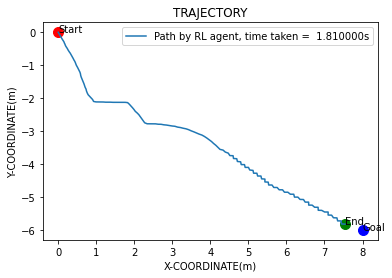

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 177      |
|    ep_rew_mean     | -126     |
| time/              |          |
|    episodes        | 608      |
|    fps             | 16       |
|    time_elapsed    | 6967     |
|    total_timesteps | 115869   |
| train/             |          |
|    actor_loss      | 42.9     |
|    critic_loss     | 3.44     |
|    learning_rate   | 0.001    |
|    n_updates       | 65805    |
---------------------------------
EP_REWARD:2.2


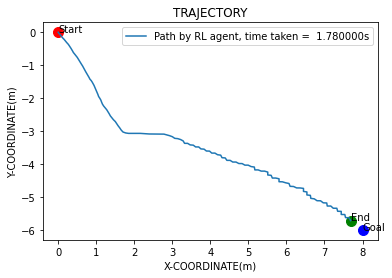

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 177      |
|    ep_rew_mean     | -126     |
| time/              |          |
|    episodes        | 609      |
|    fps             | 16       |
|    time_elapsed    | 6973     |
|    total_timesteps | 116047   |
| train/             |          |
|    actor_loss      | 43.2     |
|    critic_loss     | 4.63     |
|    learning_rate   | 0.001    |
|    n_updates       | 65986    |
---------------------------------
EP_REWARD:2.1


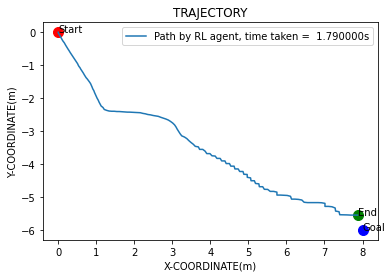

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 177      |
|    ep_rew_mean     | -126     |
| time/              |          |
|    episodes        | 610      |
|    fps             | 16       |
|    time_elapsed    | 6980     |
|    total_timesteps | 116226   |
| train/             |          |
|    actor_loss      | 42.9     |
|    critic_loss     | 2.37     |
|    learning_rate   | 0.001    |
|    n_updates       | 66164    |
---------------------------------
EP_REWARD:2.6


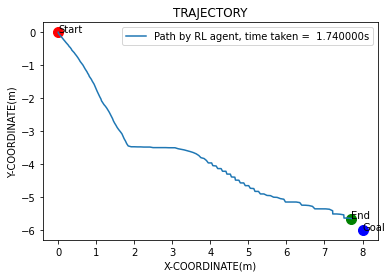

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 177      |
|    ep_rew_mean     | -126     |
| time/              |          |
|    episodes        | 611      |
|    fps             | 16       |
|    time_elapsed    | 6987     |
|    total_timesteps | 116400   |
| train/             |          |
|    actor_loss      | 43.3     |
|    critic_loss     | 3.03     |
|    learning_rate   | 0.001    |
|    n_updates       | 66343    |
---------------------------------
EP_REWARD:1.9000000000000001


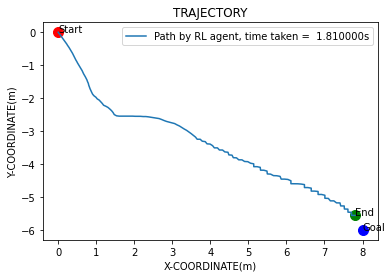

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 177      |
|    ep_rew_mean     | -126     |
| time/              |          |
|    episodes        | 612      |
|    fps             | 16       |
|    time_elapsed    | 6993     |
|    total_timesteps | 116581   |
| train/             |          |
|    actor_loss      | 43.2     |
|    critic_loss     | 2.18     |
|    learning_rate   | 0.001    |
|    n_updates       | 66517    |
---------------------------------
EP_REWARD:2.9000000000000004


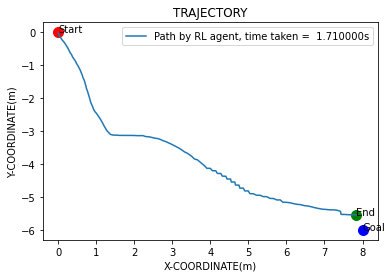

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 177      |
|    ep_rew_mean     | -125     |
| time/              |          |
|    episodes        | 613      |
|    fps             | 16       |
|    time_elapsed    | 7000     |
|    total_timesteps | 116752   |
| train/             |          |
|    actor_loss      | 42.8     |
|    critic_loss     | 2.57     |
|    learning_rate   | 0.001    |
|    n_updates       | 66698    |
---------------------------------
EP_REWARD:-68


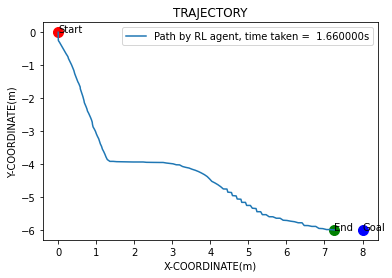

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 176      |
|    ep_rew_mean     | -126     |
| time/              |          |
|    episodes        | 614      |
|    fps             | 16       |
|    time_elapsed    | 7007     |
|    total_timesteps | 116918   |
| train/             |          |
|    actor_loss      | 42.9     |
|    critic_loss     | 2.51     |
|    learning_rate   | 0.001    |
|    n_updates       | 66869    |
---------------------------------
EP_REWARD:2.2


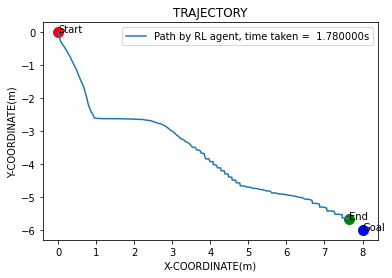

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 176      |
|    ep_rew_mean     | -126     |
| time/              |          |
|    episodes        | 615      |
|    fps             | 16       |
|    time_elapsed    | 7013     |
|    total_timesteps | 117096   |
| train/             |          |
|    actor_loss      | 43.1     |
|    critic_loss     | 3.99     |
|    learning_rate   | 0.001    |
|    n_updates       | 67035    |
---------------------------------
EP_REWARD:2.5


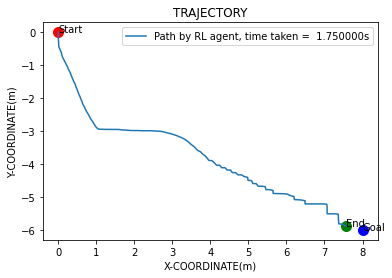

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 176      |
|    ep_rew_mean     | -126     |
| time/              |          |
|    episodes        | 616      |
|    fps             | 16       |
|    time_elapsed    | 7019     |
|    total_timesteps | 117271   |
| train/             |          |
|    actor_loss      | 42.9     |
|    critic_loss     | 2.92     |
|    learning_rate   | 0.001    |
|    n_updates       | 67213    |
---------------------------------
EP_REWARD:1.5


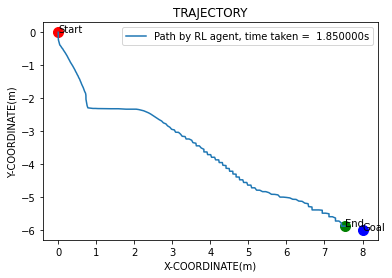

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 176      |
|    ep_rew_mean     | -126     |
| time/              |          |
|    episodes        | 617      |
|    fps             | 16       |
|    time_elapsed    | 7025     |
|    total_timesteps | 117456   |
| train/             |          |
|    actor_loss      | 43       |
|    critic_loss     | 2.7      |
|    learning_rate   | 0.001    |
|    n_updates       | 67388    |
---------------------------------
EP_REWARD:-46


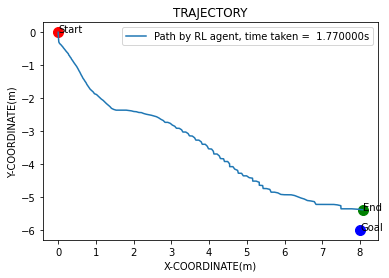

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 176      |
|    ep_rew_mean     | -126     |
| time/              |          |
|    episodes        | 618      |
|    fps             | 16       |
|    time_elapsed    | 7032     |
|    total_timesteps | 117633   |
| train/             |          |
|    actor_loss      | 43.2     |
|    critic_loss     | 2.8      |
|    learning_rate   | 0.001    |
|    n_updates       | 67573    |
---------------------------------
EP_REWARD:2.1


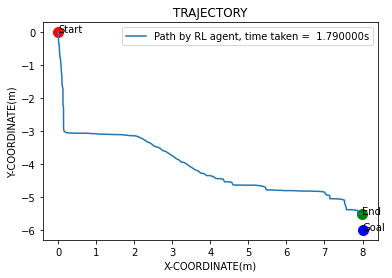

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 176      |
|    ep_rew_mean     | -126     |
| time/              |          |
|    episodes        | 619      |
|    fps             | 16       |
|    time_elapsed    | 7039     |
|    total_timesteps | 117812   |
| train/             |          |
|    actor_loss      | 43       |
|    critic_loss     | 5.11     |
|    learning_rate   | 0.001    |
|    n_updates       | 67750    |
---------------------------------
EP_REWARD:2.7


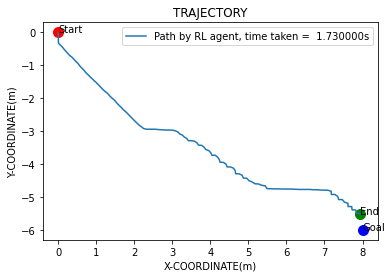

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 176      |
|    ep_rew_mean     | -126     |
| time/              |          |
|    episodes        | 620      |
|    fps             | 16       |
|    time_elapsed    | 7045     |
|    total_timesteps | 117985   |
| train/             |          |
|    actor_loss      | 42.9     |
|    critic_loss     | 2.34     |
|    learning_rate   | 0.001    |
|    n_updates       | 67929    |
---------------------------------
EP_REWARD:3.2


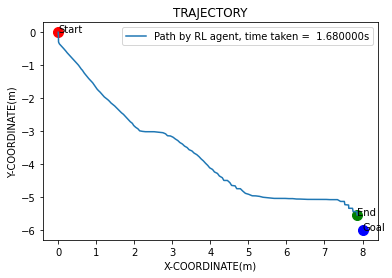

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 176      |
|    ep_rew_mean     | -126     |
| time/              |          |
|    episodes        | 621      |
|    fps             | 16       |
|    time_elapsed    | 7052     |
|    total_timesteps | 118153   |
| train/             |          |
|    actor_loss      | 43.3     |
|    critic_loss     | 2.25     |
|    learning_rate   | 0.001    |
|    n_updates       | 68102    |
---------------------------------
EP_REWARD:3.0


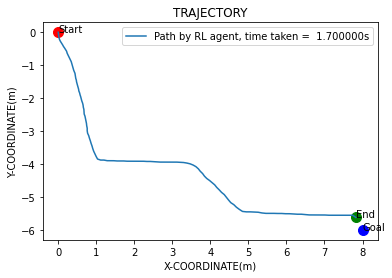

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 176      |
|    ep_rew_mean     | -125     |
| time/              |          |
|    episodes        | 622      |
|    fps             | 16       |
|    time_elapsed    | 7058     |
|    total_timesteps | 118323   |
| train/             |          |
|    actor_loss      | 43.1     |
|    critic_loss     | 3.85     |
|    learning_rate   | 0.001    |
|    n_updates       | 68270    |
---------------------------------
EP_REWARD:2.5


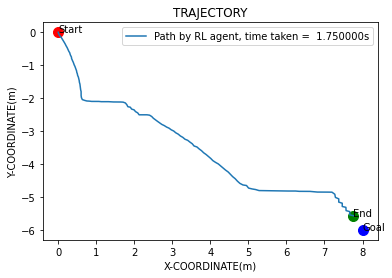

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 176      |
|    ep_rew_mean     | -125     |
| time/              |          |
|    episodes        | 623      |
|    fps             | 16       |
|    time_elapsed    | 7065     |
|    total_timesteps | 118498   |
| train/             |          |
|    actor_loss      | 42.9     |
|    critic_loss     | 3.27     |
|    learning_rate   | 0.001    |
|    n_updates       | 68440    |
---------------------------------
EP_REWARD:2.6


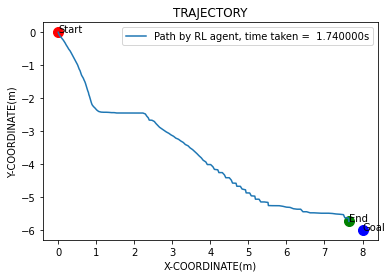

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 176      |
|    ep_rew_mean     | -124     |
| time/              |          |
|    episodes        | 624      |
|    fps             | 16       |
|    time_elapsed    | 7071     |
|    total_timesteps | 118672   |
| train/             |          |
|    actor_loss      | 42.7     |
|    critic_loss     | 3.08     |
|    learning_rate   | 0.001    |
|    n_updates       | 68615    |
---------------------------------
EP_REWARD:2.8000000000000003


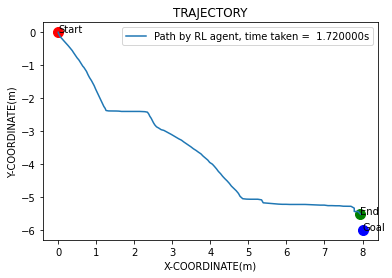

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 176      |
|    ep_rew_mean     | -124     |
| time/              |          |
|    episodes        | 625      |
|    fps             | 16       |
|    time_elapsed    | 7078     |
|    total_timesteps | 118844   |
| train/             |          |
|    actor_loss      | 43       |
|    critic_loss     | 3.06     |
|    learning_rate   | 0.001    |
|    n_updates       | 68789    |
---------------------------------
EP_REWARD:-34


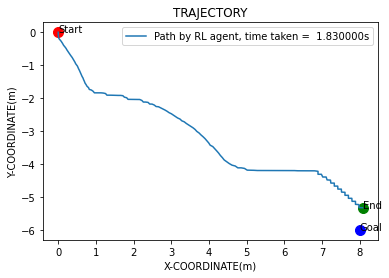

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 176      |
|    ep_rew_mean     | -125     |
| time/              |          |
|    episodes        | 626      |
|    fps             | 16       |
|    time_elapsed    | 7085     |
|    total_timesteps | 119027   |
| train/             |          |
|    actor_loss      | 43       |
|    critic_loss     | 2.96     |
|    learning_rate   | 0.001    |
|    n_updates       | 68961    |
---------------------------------
EP_REWARD:3.2


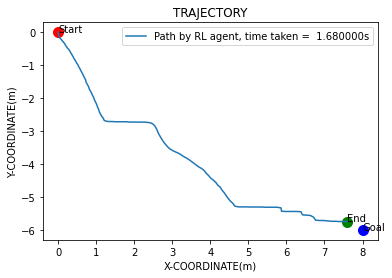

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 176      |
|    ep_rew_mean     | -125     |
| time/              |          |
|    episodes        | 627      |
|    fps             | 16       |
|    time_elapsed    | 7093     |
|    total_timesteps | 119195   |
| train/             |          |
|    actor_loss      | 43.1     |
|    critic_loss     | 3.08     |
|    learning_rate   | 0.001    |
|    n_updates       | 69144    |
---------------------------------
EP_REWARD:3.0


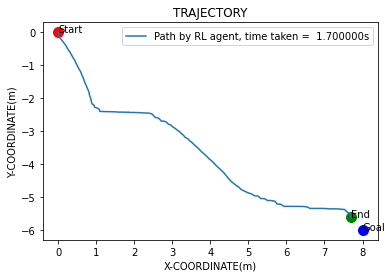

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 176      |
|    ep_rew_mean     | -125     |
| time/              |          |
|    episodes        | 628      |
|    fps             | 16       |
|    time_elapsed    | 7100     |
|    total_timesteps | 119365   |
| train/             |          |
|    actor_loss      | 43       |
|    critic_loss     | 2.94     |
|    learning_rate   | 0.001    |
|    n_updates       | 69312    |
---------------------------------
EP_REWARD:3.0


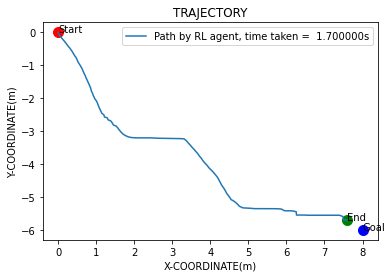

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 176      |
|    ep_rew_mean     | -125     |
| time/              |          |
|    episodes        | 629      |
|    fps             | 16       |
|    time_elapsed    | 7107     |
|    total_timesteps | 119535   |
| train/             |          |
|    actor_loss      | 43.2     |
|    critic_loss     | 3.09     |
|    learning_rate   | 0.001    |
|    n_updates       | 69482    |
---------------------------------
EP_REWARD:2.3000000000000003


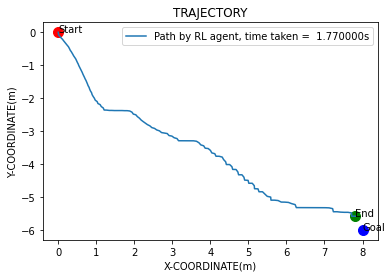

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 176      |
|    ep_rew_mean     | -125     |
| time/              |          |
|    episodes        | 630      |
|    fps             | 16       |
|    time_elapsed    | 7114     |
|    total_timesteps | 119712   |
| train/             |          |
|    actor_loss      | 43       |
|    critic_loss     | 2.94     |
|    learning_rate   | 0.001    |
|    n_updates       | 69652    |
---------------------------------
EP_REWARD:2.4000000000000004


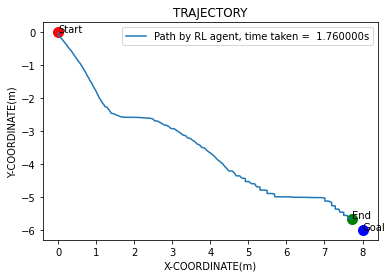

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 175      |
|    ep_rew_mean     | -125     |
| time/              |          |
|    episodes        | 631      |
|    fps             | 16       |
|    time_elapsed    | 7121     |
|    total_timesteps | 119888   |
| train/             |          |
|    actor_loss      | 43.1     |
|    critic_loss     | 2.05     |
|    learning_rate   | 0.001    |
|    n_updates       | 69829    |
---------------------------------
EP_REWARD:-0.5652260302896213


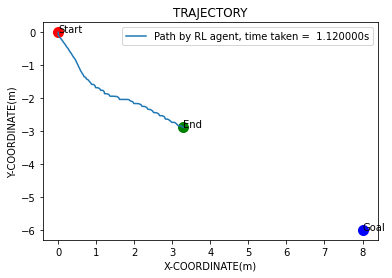

EP_REWARD:1.3


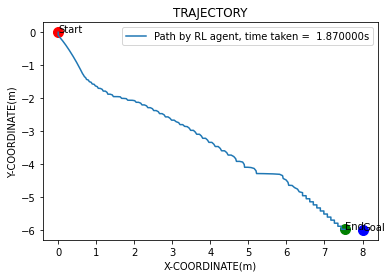

EP_REWARD:1.3


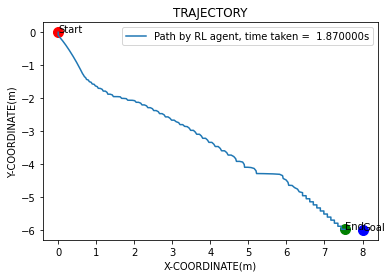

EP_REWARD:1.3


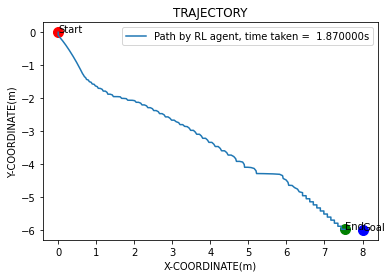

EP_REWARD:1.3


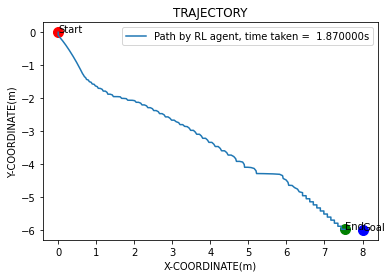

EP_REWARD:1.3


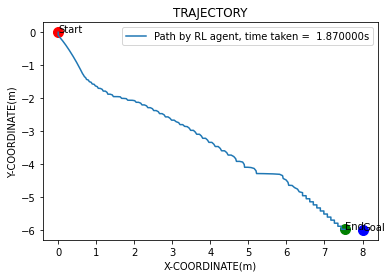

Eval num_timesteps=120000, episode_reward=-115.13 +/- 0.00
Episode length: 187.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 187      |
|    mean_reward     | -115     |
| time/              |          |
|    total_timesteps | 120000   |
| train/             |          |
|    actor_loss      | 43.4     |
|    critic_loss     | 1.2      |
|    learning_rate   | 0.001    |
|    n_updates       | 70005    |
---------------------------------
EP_REWARD:-24


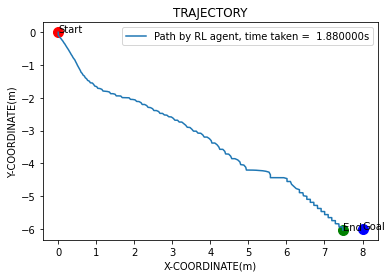

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 176      |
|    ep_rew_mean     | -125     |
| time/              |          |
|    episodes        | 632      |
|    fps             | 16       |
|    time_elapsed    | 7130     |
|    total_timesteps | 120188   |
---------------------------------
EP_REWARD:2.7


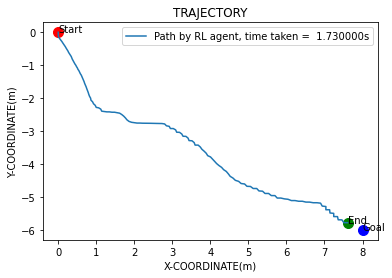

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 175      |
|    ep_rew_mean     | -125     |
| time/              |          |
|    episodes        | 633      |
|    fps             | 16       |
|    time_elapsed    | 7141     |
|    total_timesteps | 120361   |
| train/             |          |
|    actor_loss      | 43.2     |
|    critic_loss     | 2.66     |
|    learning_rate   | 0.001    |
|    n_updates       | 70305    |
---------------------------------
EP_REWARD:2.1


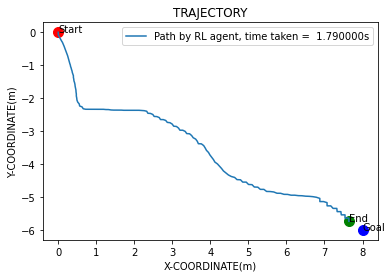

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 175      |
|    ep_rew_mean     | -125     |
| time/              |          |
|    episodes        | 634      |
|    fps             | 16       |
|    time_elapsed    | 7147     |
|    total_timesteps | 120540   |
| train/             |          |
|    actor_loss      | 43.5     |
|    critic_loss     | 2.95     |
|    learning_rate   | 0.001    |
|    n_updates       | 70478    |
---------------------------------
EP_REWARD:2.1


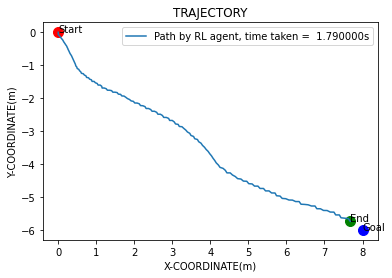

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 175      |
|    ep_rew_mean     | -125     |
| time/              |          |
|    episodes        | 635      |
|    fps             | 16       |
|    time_elapsed    | 7155     |
|    total_timesteps | 120719   |
| train/             |          |
|    actor_loss      | 43.1     |
|    critic_loss     | 3.36     |
|    learning_rate   | 0.001    |
|    n_updates       | 70657    |
---------------------------------
EP_REWARD:2.6


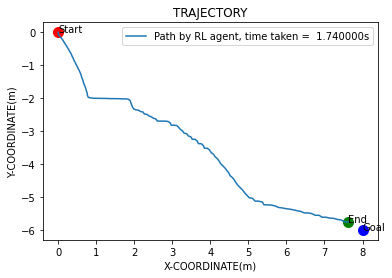

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 175      |
|    ep_rew_mean     | -125     |
| time/              |          |
|    episodes        | 636      |
|    fps             | 16       |
|    time_elapsed    | 7170     |
|    total_timesteps | 120893   |
| train/             |          |
|    actor_loss      | 43.4     |
|    critic_loss     | 2.74     |
|    learning_rate   | 0.001    |
|    n_updates       | 70836    |
---------------------------------
EP_REWARD:3.5


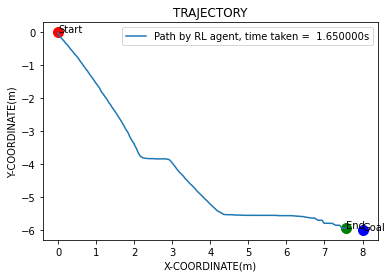

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 175      |
|    ep_rew_mean     | -125     |
| time/              |          |
|    episodes        | 637      |
|    fps             | 16       |
|    time_elapsed    | 7178     |
|    total_timesteps | 121058   |
| train/             |          |
|    actor_loss      | 43.8     |
|    critic_loss     | 3.48     |
|    learning_rate   | 0.001    |
|    n_updates       | 71010    |
---------------------------------
EP_REWARD:3.0


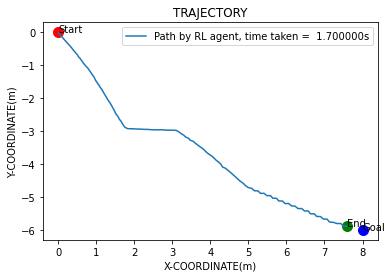

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 175      |
|    ep_rew_mean     | -124     |
| time/              |          |
|    episodes        | 638      |
|    fps             | 16       |
|    time_elapsed    | 7186     |
|    total_timesteps | 121228   |
| train/             |          |
|    actor_loss      | 43.8     |
|    critic_loss     | 2.67     |
|    learning_rate   | 0.001    |
|    n_updates       | 71175    |
---------------------------------
EP_REWARD:2.7


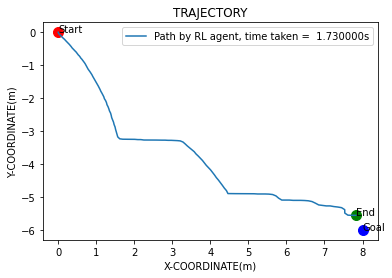

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 175      |
|    ep_rew_mean     | -124     |
| time/              |          |
|    episodes        | 639      |
|    fps             | 16       |
|    time_elapsed    | 7194     |
|    total_timesteps | 121401   |
| train/             |          |
|    actor_loss      | 43.5     |
|    critic_loss     | 4.88     |
|    learning_rate   | 0.001    |
|    n_updates       | 71345    |
---------------------------------
EP_REWARD:3.5


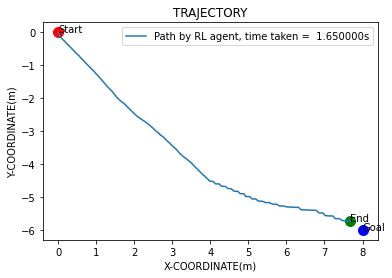

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 175      |
|    ep_rew_mean     | -124     |
| time/              |          |
|    episodes        | 640      |
|    fps             | 16       |
|    time_elapsed    | 7202     |
|    total_timesteps | 121566   |
| train/             |          |
|    actor_loss      | 43.1     |
|    critic_loss     | 3.51     |
|    learning_rate   | 0.001    |
|    n_updates       | 71518    |
---------------------------------
EP_REWARD:2.1


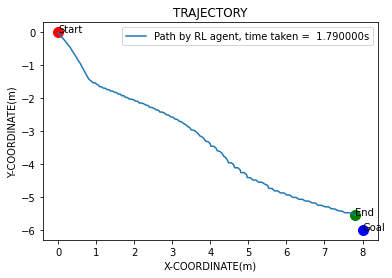

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 175      |
|    ep_rew_mean     | -123     |
| time/              |          |
|    episodes        | 641      |
|    fps             | 16       |
|    time_elapsed    | 7208     |
|    total_timesteps | 121745   |
| train/             |          |
|    actor_loss      | 43.2     |
|    critic_loss     | 2.94     |
|    learning_rate   | 0.001    |
|    n_updates       | 71683    |
---------------------------------
EP_REWARD:2.6


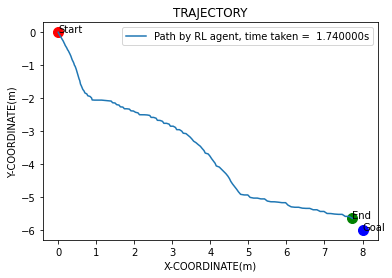

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 175      |
|    ep_rew_mean     | -123     |
| time/              |          |
|    episodes        | 642      |
|    fps             | 16       |
|    time_elapsed    | 7222     |
|    total_timesteps | 121919   |
| train/             |          |
|    actor_loss      | 43.6     |
|    critic_loss     | 1.69     |
|    learning_rate   | 0.001    |
|    n_updates       | 71862    |
---------------------------------
EP_REWARD:3.2


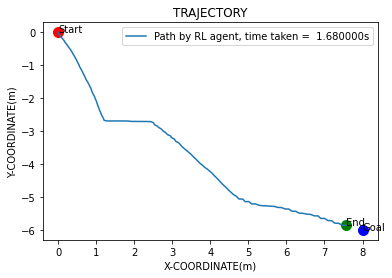

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 175      |
|    ep_rew_mean     | -123     |
| time/              |          |
|    episodes        | 643      |
|    fps             | 16       |
|    time_elapsed    | 7232     |
|    total_timesteps | 122087   |
| train/             |          |
|    actor_loss      | 43.6     |
|    critic_loss     | 2.63     |
|    learning_rate   | 0.001    |
|    n_updates       | 72036    |
---------------------------------
EP_REWARD:2.0


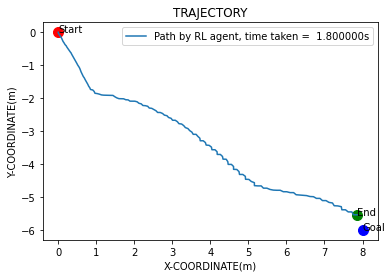

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 174      |
|    ep_rew_mean     | -123     |
| time/              |          |
|    episodes        | 644      |
|    fps             | 16       |
|    time_elapsed    | 7240     |
|    total_timesteps | 122267   |
| train/             |          |
|    actor_loss      | 44       |
|    critic_loss     | 2.72     |
|    learning_rate   | 0.001    |
|    n_updates       | 72204    |
---------------------------------
EP_REWARD:2.7


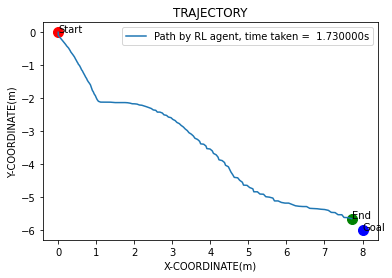

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 174      |
|    ep_rew_mean     | -122     |
| time/              |          |
|    episodes        | 645      |
|    fps             | 16       |
|    time_elapsed    | 7247     |
|    total_timesteps | 122440   |
| train/             |          |
|    actor_loss      | 43.5     |
|    critic_loss     | 4.24     |
|    learning_rate   | 0.001    |
|    n_updates       | 72384    |
---------------------------------
EP_REWARD:2.3000000000000003


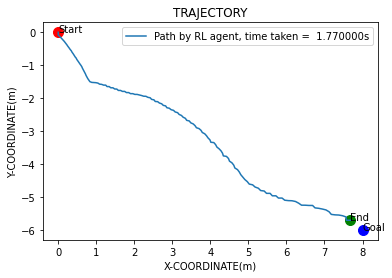

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 174      |
|    ep_rew_mean     | -122     |
| time/              |          |
|    episodes        | 646      |
|    fps             | 16       |
|    time_elapsed    | 7255     |
|    total_timesteps | 122617   |
| train/             |          |
|    actor_loss      | 44.1     |
|    critic_loss     | 3.35     |
|    learning_rate   | 0.001    |
|    n_updates       | 72557    |
---------------------------------
EP_REWARD:2.6


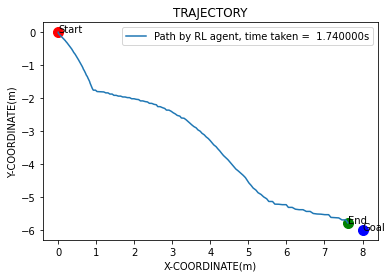

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 174      |
|    ep_rew_mean     | -122     |
| time/              |          |
|    episodes        | 647      |
|    fps             | 16       |
|    time_elapsed    | 7262     |
|    total_timesteps | 122791   |
| train/             |          |
|    actor_loss      | 43.7     |
|    critic_loss     | 2.11     |
|    learning_rate   | 0.001    |
|    n_updates       | 72734    |
---------------------------------
EP_REWARD:3.1


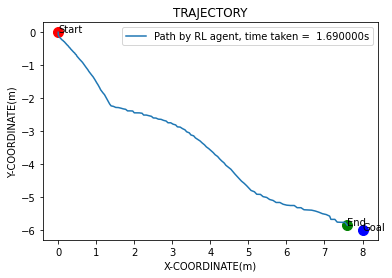

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 174      |
|    ep_rew_mean     | -121     |
| time/              |          |
|    episodes        | 648      |
|    fps             | 16       |
|    time_elapsed    | 7271     |
|    total_timesteps | 122960   |
| train/             |          |
|    actor_loss      | 43.7     |
|    critic_loss     | 4.26     |
|    learning_rate   | 0.001    |
|    n_updates       | 72908    |
---------------------------------
EP_REWARD:3.0


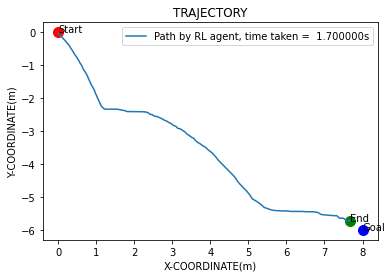

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 174      |
|    ep_rew_mean     | -121     |
| time/              |          |
|    episodes        | 649      |
|    fps             | 16       |
|    time_elapsed    | 7277     |
|    total_timesteps | 123130   |
| train/             |          |
|    actor_loss      | 44       |
|    critic_loss     | 2.21     |
|    learning_rate   | 0.001    |
|    n_updates       | 73077    |
---------------------------------
EP_REWARD:2.0


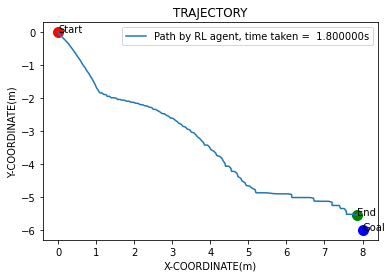

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 174      |
|    ep_rew_mean     | -121     |
| time/              |          |
|    episodes        | 650      |
|    fps             | 16       |
|    time_elapsed    | 7283     |
|    total_timesteps | 123310   |
| train/             |          |
|    actor_loss      | 43.8     |
|    critic_loss     | 0.868    |
|    learning_rate   | 0.001    |
|    n_updates       | 73247    |
---------------------------------
EP_REWARD:2.5


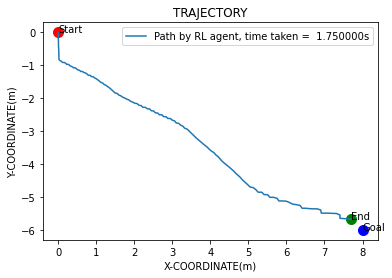

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 174      |
|    ep_rew_mean     | -121     |
| time/              |          |
|    episodes        | 651      |
|    fps             | 16       |
|    time_elapsed    | 7290     |
|    total_timesteps | 123485   |
| train/             |          |
|    actor_loss      | 43.7     |
|    critic_loss     | 5.09     |
|    learning_rate   | 0.001    |
|    n_updates       | 73427    |
---------------------------------
EP_REWARD:3.7


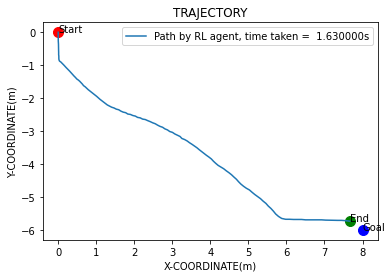

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 174      |
|    ep_rew_mean     | -121     |
| time/              |          |
|    episodes        | 652      |
|    fps             | 16       |
|    time_elapsed    | 7296     |
|    total_timesteps | 123648   |
| train/             |          |
|    actor_loss      | 43.8     |
|    critic_loss     | 3.74     |
|    learning_rate   | 0.001    |
|    n_updates       | 73602    |
---------------------------------
EP_REWARD:3.7


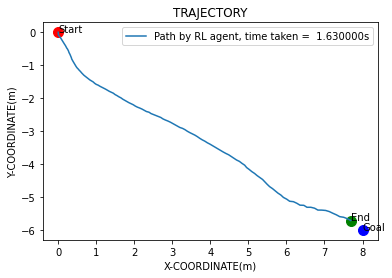

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 174      |
|    ep_rew_mean     | -120     |
| time/              |          |
|    episodes        | 653      |
|    fps             | 16       |
|    time_elapsed    | 7303     |
|    total_timesteps | 123811   |
| train/             |          |
|    actor_loss      | 43.6     |
|    critic_loss     | 1.4      |
|    learning_rate   | 0.001    |
|    n_updates       | 73765    |
---------------------------------
EP_REWARD:3.2


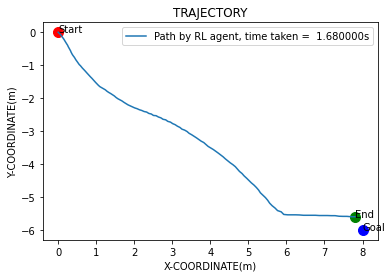

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 174      |
|    ep_rew_mean     | -120     |
| time/              |          |
|    episodes        | 654      |
|    fps             | 16       |
|    time_elapsed    | 7309     |
|    total_timesteps | 123979   |
| train/             |          |
|    actor_loss      | 43.9     |
|    critic_loss     | 1.97     |
|    learning_rate   | 0.001    |
|    n_updates       | 73928    |
---------------------------------
EP_REWARD:3.2


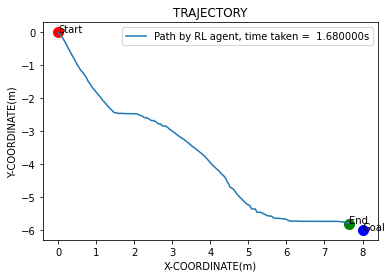

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 174      |
|    ep_rew_mean     | -119     |
| time/              |          |
|    episodes        | 655      |
|    fps             | 16       |
|    time_elapsed    | 7316     |
|    total_timesteps | 124147   |
| train/             |          |
|    actor_loss      | 43.6     |
|    critic_loss     | 5.52     |
|    learning_rate   | 0.001    |
|    n_updates       | 74096    |
---------------------------------
EP_REWARD:-62


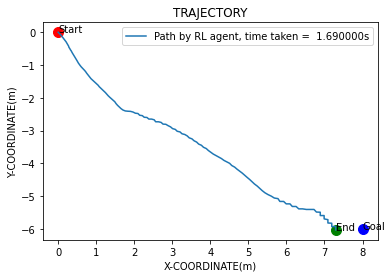

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 174      |
|    ep_rew_mean     | -120     |
| time/              |          |
|    episodes        | 656      |
|    fps             | 16       |
|    time_elapsed    | 7322     |
|    total_timesteps | 124316   |
| train/             |          |
|    actor_loss      | 44.1     |
|    critic_loss     | 2.49     |
|    learning_rate   | 0.001    |
|    n_updates       | 74264    |
---------------------------------
EP_REWARD:3.2


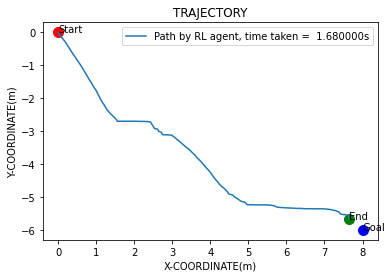

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 174      |
|    ep_rew_mean     | -120     |
| time/              |          |
|    episodes        | 657      |
|    fps             | 16       |
|    time_elapsed    | 7329     |
|    total_timesteps | 124484   |
| train/             |          |
|    actor_loss      | 43.3     |
|    critic_loss     | 3.51     |
|    learning_rate   | 0.001    |
|    n_updates       | 74433    |
---------------------------------


KeyboardInterrupt: 

In [ ]:
env = Brachistochrone_Env()
print(env.target_pos)
env = make_vec_env(lambda: env, n_envs=1)

n_actions = env.action_space.shape[-1]
action_noise = NormalActionNoise(mean = np.zeros(n_actions), 
                                sigma=0.1*np.ones(n_actions)) #add noise to maximize exploration

eval_callback = EvalCallback(env, best_model_save_path,
                             log_path, eval_freq=5000,
                             deterministic=True, render=False)

model = DDPG('MlpPolicy', env =env, action_noise=action_noise, verbose=1,
            gamma= 0.9999, buffer_size = 200000, learning_starts = 50000,
             gradient_steps = -1, learning_rate=0.001,
            policy_kwargs= dict(net_arch=[300, 400, 300]), train_freq = (1, "episode"), tensorboard_log="./barchistostrone_ddpg_tensorboard/generalized_6")

os.system('spd-say "your program has started"')


model.learn(total_timesteps=650000, log_interval=1, callback=eval_callback)

os.system('spd-say "your program has finished"')

max_epsiodes = 1
position= []
x = []
y = []

for ep in range(max_epsiodes):
    print("Episode {}".format(ep + 1))
    episodic_reward = []
    steps = 0

    obs = env.reset()
    print("Inital obs: "  +str(obs))
    while True:
        action, _ = model.predict(obs, deterministic = True)
        obs, reward, done, info = env.step(action)
        position.append((obs[0][0], obs[0][1]))
        x.append(obs[0][0])
        y.append(obs[0][1])
        episodic_reward.append(reward)

        steps+=1
        #print('obs=', obs, 'reward=', reward, 'done=', done)
        if done:
            print("Goal reached!", "episodic-reward=", np.sum(episodic_reward))
            print("Steps taken: " + str(steps))
            #print()
            break

In [ ]:
#save model
env = Brachistochrone_Env()
print(env.target_pos)
env = make_vec_env(lambda: env, n_envs=1)
model = DDPG.load("./saved_models/generalized_5/best_model", env=env)
model.learn(total_timesteps=300000, log_interval=100, callback=eval_callback)
#model.save("./saved_models/generalized_5/")

[ 8. -6.]


PermissionError: [Errno 13] Permission denied: 'saved_models\\generalized_5'

In [ ]:
def cycloid(P1,P2,N):
    """Return the path of Brachistochrone curve from (0,0) to (x2, y2).
    The Brachistochrone curve is the path down which a bead will fall without
    friction between two points in the least time (an arc of a cycloid).
    It is returned as an array of N values of (x,y) between (0,0) and (x2,y2).
    """

    # First find theta2 from (x2, y2) numerically (by Newton-Rapheson).
    f = lambda theta: -P2[1]/P2[0] - (1-np.cos(theta))/(theta-np.sin(theta))
    theta2 = newton(f, np.pi/2)

    # The radius of the circle generating the cycloid.
    R = -P2[1] / (1 - np.cos(theta2))

    theta = np.linspace(0, theta2, N)
    x = R * (theta - np.sin(theta))
    y = R * (1 - np.cos(theta))

    # The time of travel
    T = theta2 * np.sqrt(R / 9.8)
    return x, y, T

def rect(P1,P2,N):
    """Return the rectilinear straight path from (0,0) to (x2, y2)."""
    x_interval = np.linspace(P1[0],P2[0],N)
    m = float(P2[1] - P1[1])/(P2[0]-P1[0])
    q = P1[1] - (m*P1[0])
    f_y = lambda x: m*x+q
    y = [f_y(x) for x in x_interval]
    T_rett = math.sqrt(2*(P2[0]**2+P2[1]**2)/(Brachistochrone_Env.g*P2[1]))
    return x_interval,y,T_rett

def plot_solution(x,y,goal):
            len_x = len(x)
            len_y = len(y)
            if (len_x==len_y):
                time_taken = len_x/100
                x = np.array(x)
                y = np.array(y)
                plt.plot(x,y , label = 'Path by RL agent, time taken =  %fs' %time_taken)
                plt.scatter(x[-1], y[-1], color = 'green', s = 100.0)
                plt.scatter(x[0], y[0], color = 'red', s = 100.0)
                plt.scatter(goal[0], goal[1], color = 'blue', s=100.0)
                plt.annotate('Start', (x[0], y[0]))
                plt.annotate('End', (x[-1], y[-1]))
                plt.annotate('Goal', goal)
                plt.legend()
                plt.xlabel('X-COORDINATE(m)')
                plt.ylabel('Y-COORDINATE(m)')
                plt.title('TRAJECTORY')
                plt.show()
            else:
                print("inconsistent dimensions")
                

<title>DA QUI COMINCIA IL CODICE CUSTOM PER FARE UN AGENT TARGET AWARE</title>

C:\Users\Gianmarco Petrelli\AppData\Roaming\Python\Python39\site-packages\gym\spaces\box.py:73: UserWarning: WARN: Box bound precision lowered by casting to float32
  logger.warn(


Inital obs: [[  0.   0.   0. -45.]]


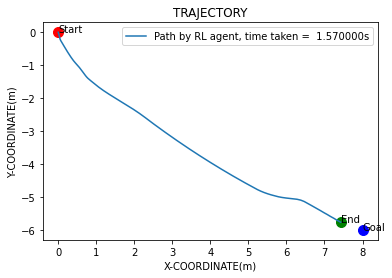

Goal reached! episodic-reward= -101.007286
Steps taken: 159
Time taken:  1.59


In [ ]:
#building found optimal path
env = Brachistochrone_Env()
env = make_vec_env(lambda: env, n_envs=1)
model = DDPG.load("./saved_models/generalized_5/best_model", env=env)

"""SET GOAL"""
goal = (8.0, -6.0)
""""""""""""""""""

position= [] #list of tuples containing subsequent positions
x = [] # x steps
y = [] #y values associated
steps = 0
actions = []
observations = []
#BUILD SOLUTION
#print("Episode {}".format(ep + 1))
episodic_reward = []


#we have to force target into environment as it must be constant and specified to AI agent
obs = env.reset()
print("Inital obs: "  +str(obs))
while True:
    action= model.predict(obs, deterministic = False)
    #print("azione:",action)
    #print("prima",obs)
    obs, reward, done, info = env.step(action)
    observations.append(obs)
    #print("dopo",obs)
    new_value = obs[0] #the array from which to extract new piece of path information
    """new_value[1]: pos_x new_value[2]: pos_y"""
    position.append((new_value[0],new_value[1]))
    if done==False:
        x.append(new_value[0])
        y.append(new_value[1])
    episodic_reward.append(reward)
    actions.append(action)
    steps+=1
    #print('obs=', obs, 'reward=', reward, 'done=', done)
    if done:
        #print(env.get_attr("video"))
        x.pop()
        y.pop()
        position.pop()
        plot_solution(x,y,goal)
        print("Goal reached!", "episodic-reward=", np.sum(episodic_reward))
        print("Steps taken: " + str(steps))
        print("Time taken: " , steps/100)

        break
            


In [ ]:
#defining custom environment for agent training
#TODO parametrizzare i confini (x,y) della mappa

class Brachistochrone_Env(gym.Env):
    g = -9.8 #HYP
    dt = 0.01 #HYP
    renderOnReset = True #set to false to speed up training
    
    """finding the optimal value for this target_ep_duration parameter is hard: ideally we should set a value that allows the model learning how to reach the target while not overfitting focusing to the fixed one""" 
    target_ep_duration = 1 #we define the period across wich we maintein target fixed ?1?
    
    def __init__(self):
        super(Brachistochrone_Env, self).__init__()
        target = Brachistochrone_Env.target_position_from_circular_neibourghood() #2 modals for target selection
        self.states = np.array([0.0, 0.0, float(target[0]), float(target[1]), 0.0 ,-45.0]) #time pos_x pos_y target_x target_y vel theta
        self.target_pos = np.array(target)#HYP: y-coordinates of end-points
        #init rl params
        self.reward = 0.0
        self.time_steps = 0
        self.ep_counter = 0
        self.target_steps = Brachistochrone_Env.target_steps_bounder(self.target_pos)  #? ...HYP
        self.action_seq = []
        #define analytic measures
        self.lossTimeSeries = []
        #for rendering purpose
        self.x_ep = [0]
        self.y_ep = [0]
        self.video = [(0,0)]

        #defining action space
        act_val_high = np.array([0.0])
        act_val_low = np.array([-90.0])
        #the action defines the angle between horizontal axis and line connecting two consecutive points
        self.action_space = spaces.Box(low = act_val_low, high = act_val_high, shape = (1,), dtype=np.float32)

        #given the theoretical approach observable params are equal to state 
        obs_val_high = np.array([100.0, 100.0, 100.0, 100.0, 1000.0, 0.0]) #time pos_x pos_y target_x target_y vel theta
        obs_val_low = np.array([-100.0, -100.0, -100.0, -100.0, -1000.0,-90.0]) 
        self.observation_space = spaces.Box(low= obs_val_low, high = obs_val_high, shape=(6,), dtype=np.float32)

    """the idea is to discretize the fall between two points binding the step function to a specified dt:HYP"""
    def step(self, action):
        # action corresponds to theta angle fixed for an infinitesimal period of time
        final_theta = action
        original_theta = self.states[5]
        #Basic descrete mechanic computations to find new velocity and acceleration and making the environment evolve
        original_vel = self.states[4]
        initial_vel_x = original_vel*math.cos(math.radians(original_theta))
        initial_vel_y = original_vel*math.sin(math.radians(original_theta))

        acceleration = Brachistochrone_Env.g *math.sin(math.radians(final_theta)) # always positive
        acceleration_x = acceleration*math.cos(math.radians(final_theta)) #always positive
        acceleration_y = acceleration*math.sin(math.radians(final_theta)) # always negative
        #print("y accelerazione:"+str(acceleration_y))

        displacement_x = (initial_vel_x*Brachistochrone_Env.dt) + (0.5*acceleration_x*(Brachistochrone_Env.dt**2))
        displacement_y = (initial_vel_y*Brachistochrone_Env.dt) + (0.5*acceleration_y*(Brachistochrone_Env.dt**2))
        #print("scostamento lungo y"+str(displacement_y))
        displacement = math.sqrt(displacement_x**2 + displacement_y**2)

        final_vel_x = initial_vel_x + acceleration_x*Brachistochrone_Env.dt
        final_vel_y = initial_vel_y + acceleration_y*Brachistochrone_Env.dt

        final_x = self.states[0] + displacement_x
        final_y = self.states[1] + displacement_y
        final_vel = math.sqrt(final_vel_x**2 + final_vel_y**2)
        
        #updating states
        #self.states[0] = self.time_steps + 1.0
        self.states[0] = final_x
        self.states[1] = final_y
        self.states[2] = self.target_pos[0]
        self.states[3] = self.target_pos[1]
        self.states[4] = final_vel
        self.states[5] = final_theta
        
        #updating path
        self.x_ep.append(final_x)
        self.y_ep.append(final_y)
        self.video.append((final_x,final_y))
        
        #euclidean distance as a measure of error
        err_position = math.sqrt((self.states[0] - self.target_pos[0])**2 + (self.states[1] - self.target_pos[1])**2)
        print(err_position)
        #apply reward as a function of error
        #we want a reward: << err_position & << number of steps
        
        """policy"""
        k = -math.log(err_position, 1.2)
        self.reward += k*((self.target_steps  - self.time_steps)**2) #penalty for distance
        #self.reward += 0.5*(self.target_steps  - self.time_steps) # reward for being fast
        done=False
        self.time_steps+=1 #update time counter
        if self.time_steps>=self.target_steps or err_position<=0.1:
            done = True
        #if err_position<=0.5:
            #when te agent succeeded to find target needs to improve time efficiency
            #self.reward  = 0.5*(self.target_steps  - self.time_steps)
        if self.states[0]>self.target_pos[0] or self.states[0]<0.0 or self.states[1]>0.0 or self.states[1]<self.target_pos[1]:
            #give an higher penalty to early out-of-map agents
            #self.reward = -2*(self.target_steps - self.time_steps)
            done = True

        info = {'g_component':acceleration}
        #print("time_steps:"+str(self.states[0]))
        return self.states, self.reward, done, info
    
    @staticmethod
    def target_steps_bounder(target_pos: tuple):
        """trying to cut all sub-optimal solutions dinamically selecting max. steps per episode from trivial linear solution"""
        if (target_pos[1]>=0):
            raise Exception("error: unfeasible path given")
        L = target_pos[0] #we suppose paths are built between (0,0) and (x_t,y_t) for normalization reasons
        H = target_pos[1]
        T_rett = math.sqrt(2*(L**2+H**2)/(Brachistochrone_Env.g*H))
        #this method must return number of maximum steps
        N_target_steps = T_rett/Brachistochrone_Env.dt
        return int(math.ceil(N_target_steps))+50
    @staticmethod   
    def target_position_from_uniform_2D_sample():
        """define a target strip on which to sample different goal points in order to train the agent to generalize"""
        """We train our agent in order to be able to reach effectively and efficiently a GOAL map in [5;50]:[-5;-50]"""
        return (int(np.random.uniform(5,50)),int(np.random.uniform(-5,-50)))
    
    @staticmethod
    def target_position_from_circular_neibourghood(c_c = (6,-8)):
        center = c_c
        length = np.sqrt(np.random.uniform(0, 1))
        angle = np.pi * np.random.uniform(0, 2)

        x = center[0] + length * np.cos(angle)
        y = center[1] + length * np.sin(angle)
        return (x,y)
    
    @staticmethod
    def target_position_from_uniform_strip_sample():
        xt = np.random.uniform(5,50)
        if (xt<40):
            yt = np.random.uniform(-50,-30)
        else:
            yt = np.random.uniform(-50,-5)
        return (xt,yt)
    
    
    """we suppose to use this function only for tests and practical use of the agent"""
    def reset_set_target(self,target:tuple):
        #fix a target for trained agent
        self.target_pos = target
        self.target_steps = Brachistochrone_Env.target_steps_bounder(self.target_pos)
        self.states = np.array([0.0, 0.0, float(self.target_pos[0]), float(self.target_pos[1]), 0.0 ,-45.0])
        return self.states

    def reset(self):
        
        #render and reset trace
        if (Brachistochrone_Env.renderOnReset== True):
            print("EP_REWARD:"+str(self.reward))
            self.render(mode="auto")
        self.x_ep.clear()
        self.y_ep.clear()
        
        #self.video.clear()
        self.time_steps = 0
        self.reward = 0.0
        
        #counting whenever an episode ends
        self.ep_counter +=1

        #change goal when target duration is reached- on episode reset
        if (self.ep_counter >= Brachistochrone_Env.target_ep_duration):
            self.target_pos = np.array(Brachistochrone_Env.target_position_from_circular_neibourghood())
            #print("target switch to:",self.target_pos)
            #print("new boundary:",Brachistochrone_Env.target_steps_bounder(self.target_pos))
            self.target_steps = Brachistochrone_Env.target_steps_bounder(self.target_pos)
            self.ep_counter = 0
            
        #updating state as a last thing    
        self.states = np.array([0.0, 0.0, float(self.target_pos[0]), float(self.target_pos[1]), 0.0 ,-45.0])

        return self.states
    
    def animate(self,frame_num):
        """
        x,y = zip(*self.video)
        x = list(x)
        y = list(y)
        """
        x = (x[0] for x in self.video[0])
        y = (x[1] for x in self.video[0])
        line.set_data((x, y))
        return line
    
    def render(self,mode='human'):
        
        """call it at the end of an episode"""
        """
        fig, ax = plt.subplots()
        line, = ax.plot([])     # A tuple unpacking to unpack the only plot
        x_goal = self.target_pos[0]
        y_goal = self.target_pos[1]
        #setting plot boundary
        ax.set_xlim(0, x_goal +1)
        ax.set_ylim(y_goal -1,1)
        anim = FuncAnimation(fig, self.animate, frames=100, interval=20)

        video = anim.to_html5_video()
        html = display.HTML(video)
        display.display(html)
        plt.close()
        """
        if (len(self.x_ep)!=0):
            time_taken = self.time_steps/100
            x = np.array(self.x_ep)
            y = np.array(self.y_ep)
            plt.plot(x,y , label = 'Path by RL agent, time taken =  %fs' %time_taken)
            goal = self.target_pos
            plt.scatter(x[-1], y[-1], color = 'green', s = 100.0)
            plt.scatter(x[0], y[0], color = 'red', s = 100.0)
            plt.scatter(goal[0], goal[1], color = 'blue', s=100.0)
            plt.annotate('Start', (x[0], y[0]))
            plt.annotate('End', (x[-1], y[-1]))
            plt.annotate('Goal', goal)
            plt.legend()
            plt.xlabel('X-COORDINATE(m)')
            plt.ylabel('Y-COORDINATE(m)')
            plt.title('TRAJECTORY')
            plt.show()

    
    


EP_REWARD:0.0
EP_REWARD:-10


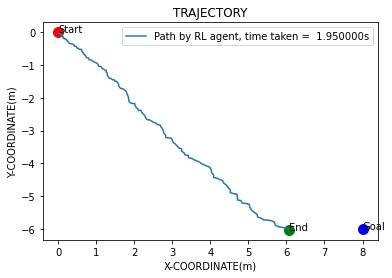

EP_REWARD:-0.13054715662224126


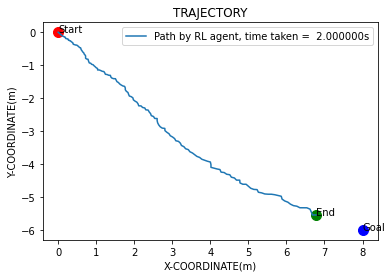

EP_REWARD:-36


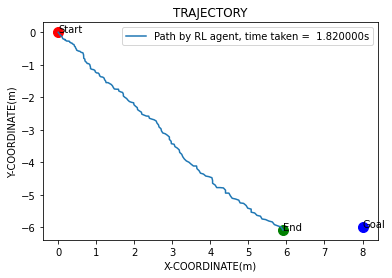

EP_REWARD:-36


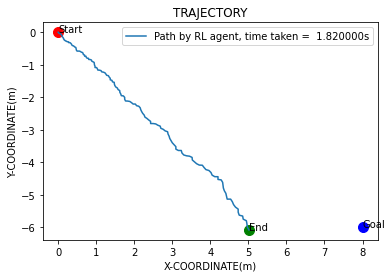

EP_REWARD:-0.9933123984890639


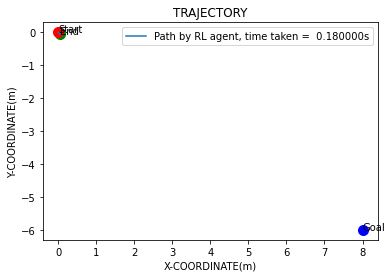

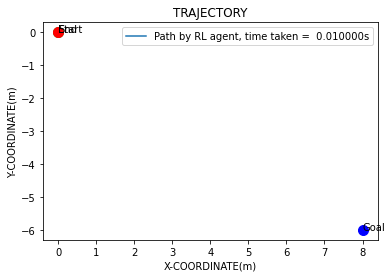

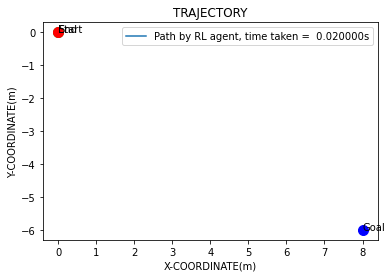

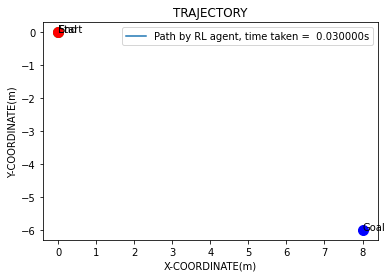

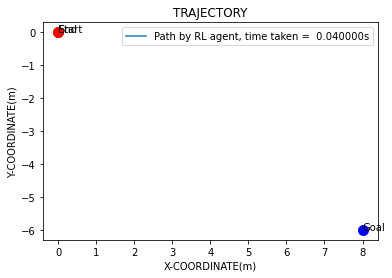

...

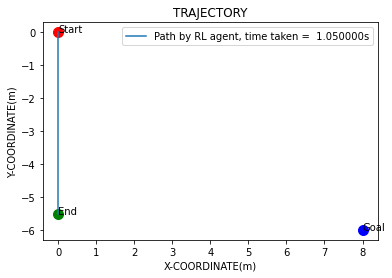

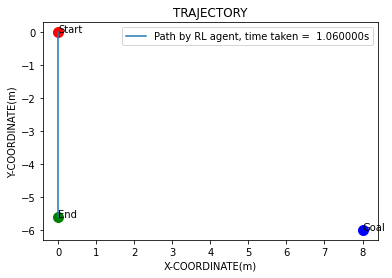

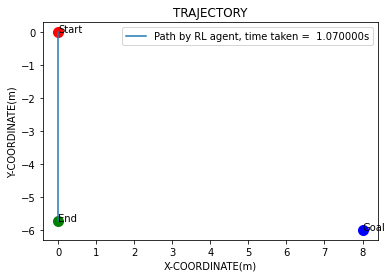

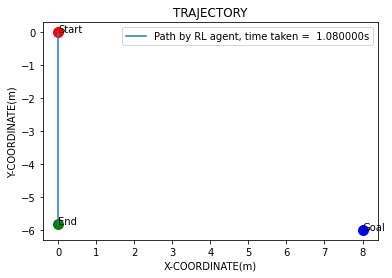

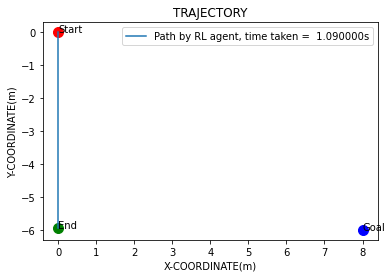

EP_REWARD:-180


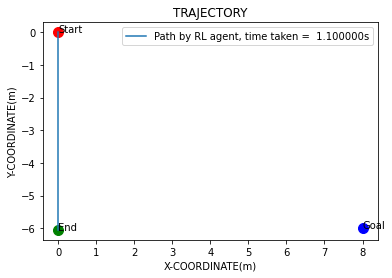

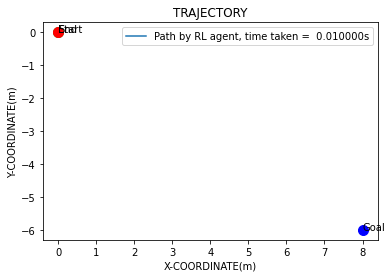

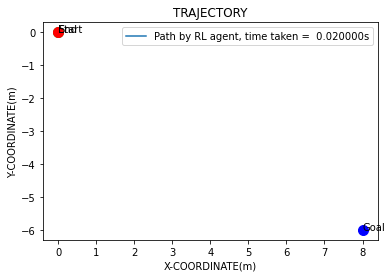

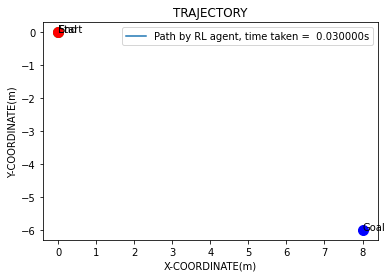

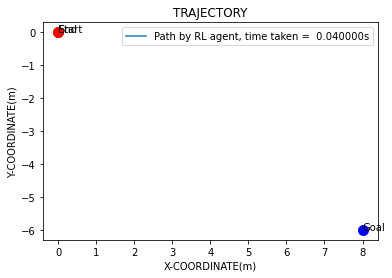

...

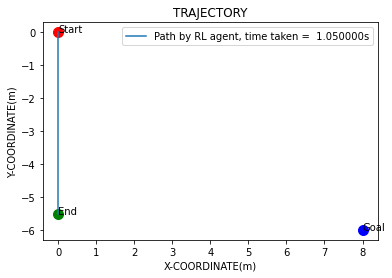

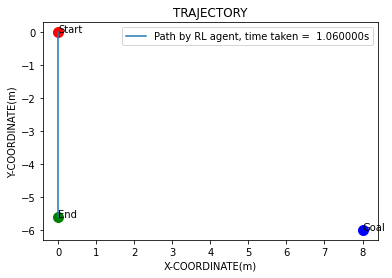

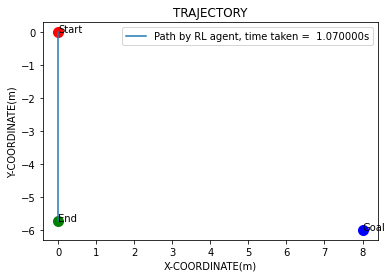

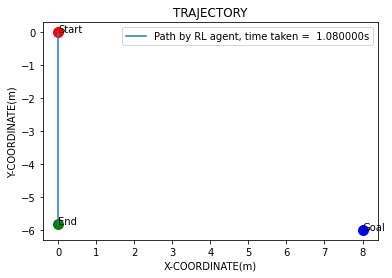

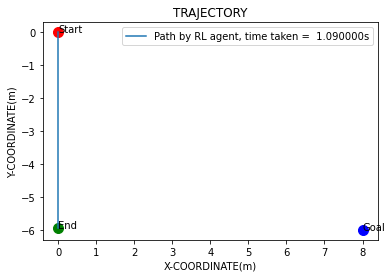

EP_REWARD:-180


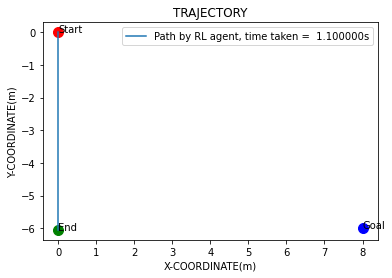

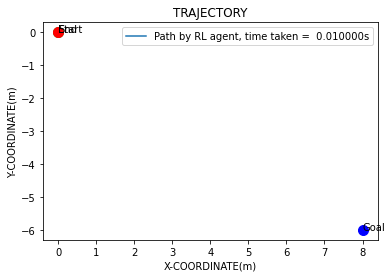

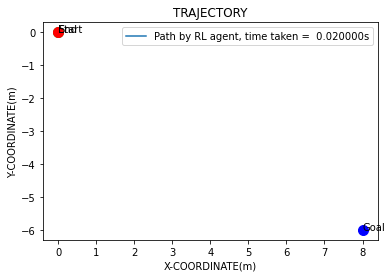

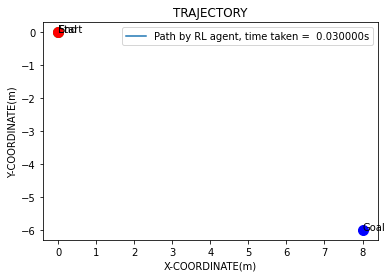

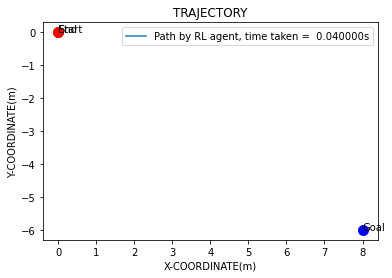

...

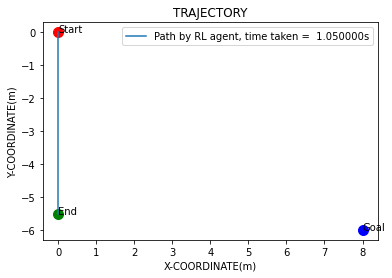

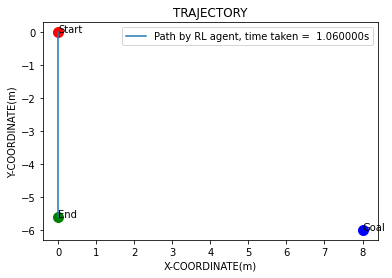

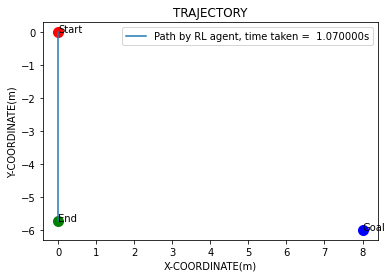

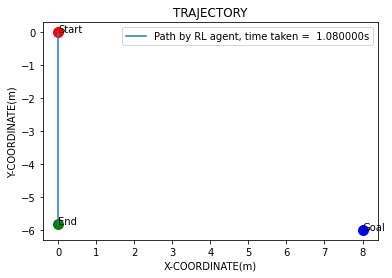

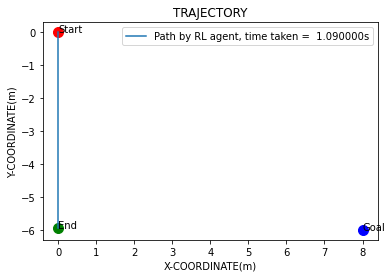

EP_REWARD:-180


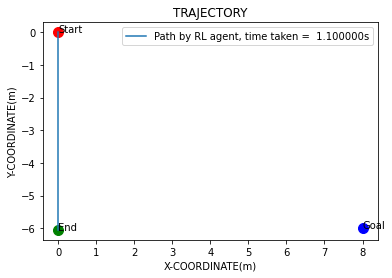

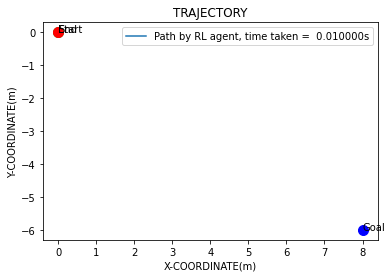

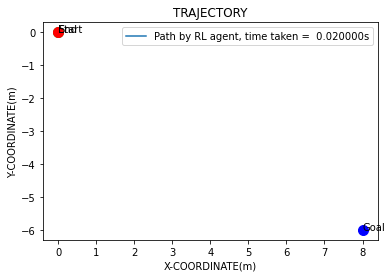

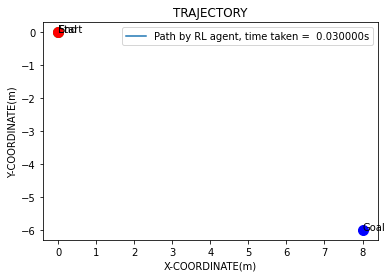

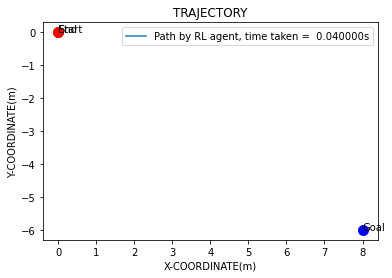

...

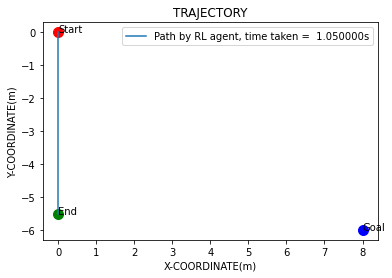

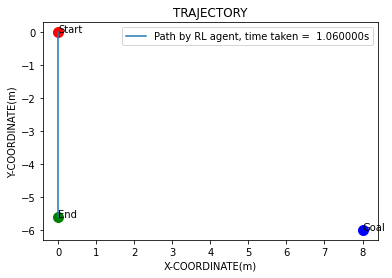

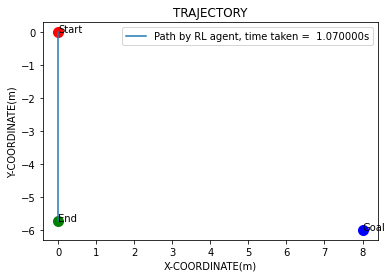

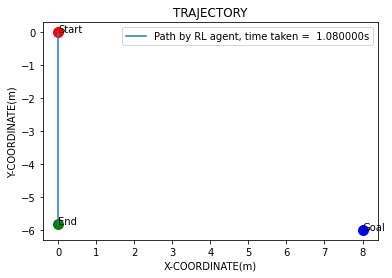

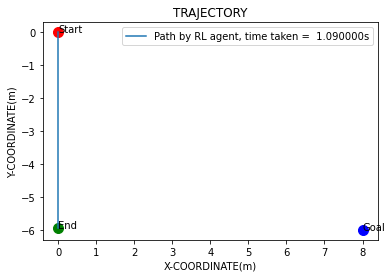

EP_REWARD:-180


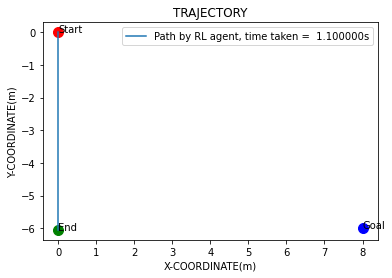

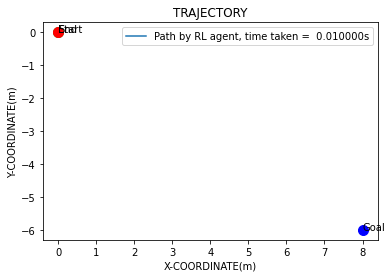

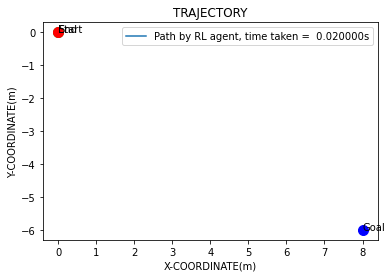

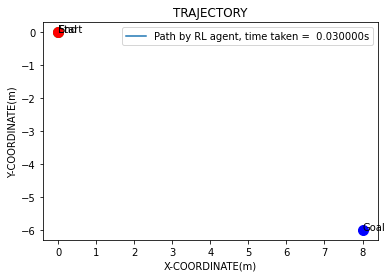

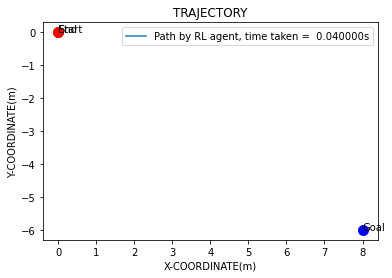

...

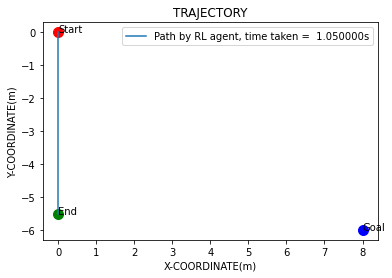

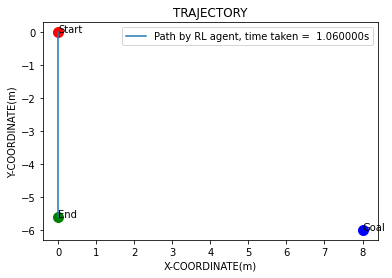

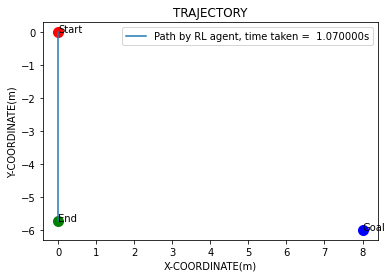

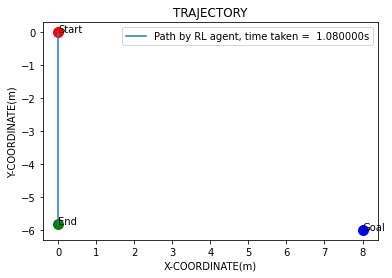

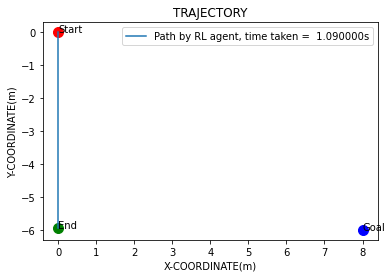

EP_REWARD:-180


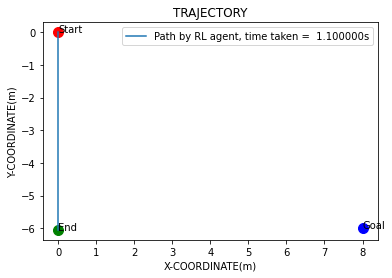

Eval num_timesteps=777, episode_reward=-279.09 +/- 0.00
Episode length: 110.00 +/- 0.00
New best mean reward!
EP_REWARD:-0.13968698829848536


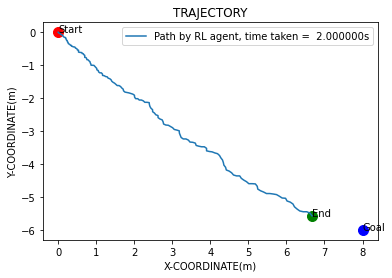

EP_REWARD:-148


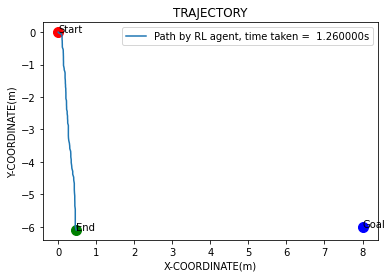

EP_REWARD:-178


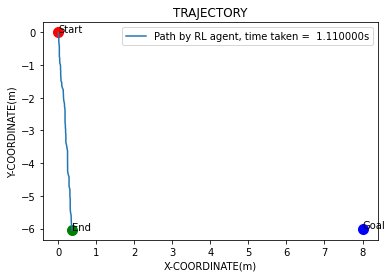

EP_REWARD:-176


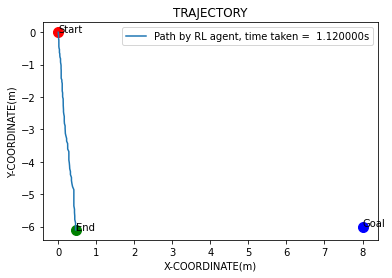

EP_REWARD:-178


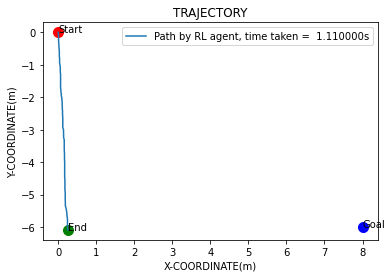

EP_REWARD:-178


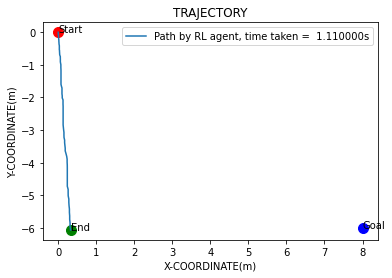

EP_REWARD:-178


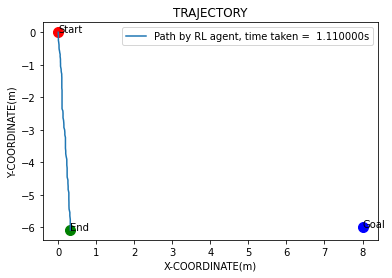

EP_REWARD:-176


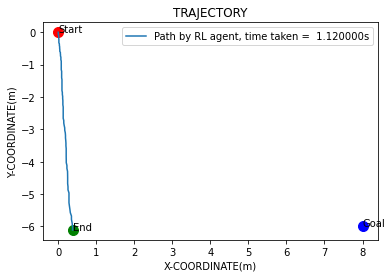

EP_REWARD:-178


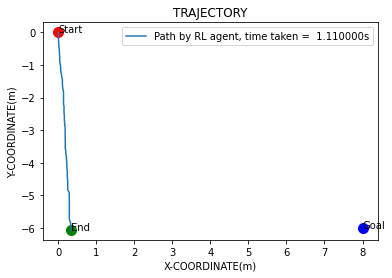

EP_REWARD:-178


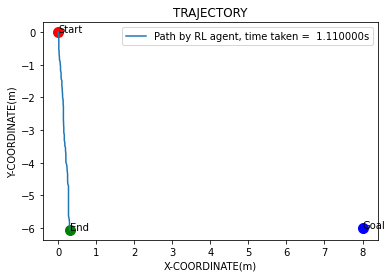

EP_REWARD:-178


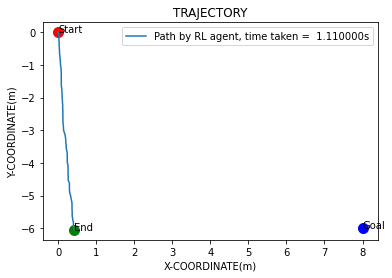

EP_REWARD:-178


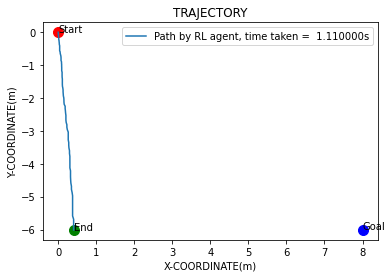

EP_REWARD:-178


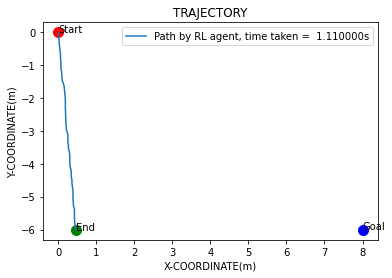

EP_REWARD:-178


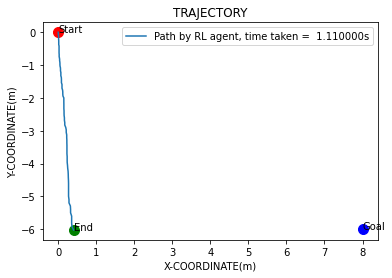

EP_REWARD:-178


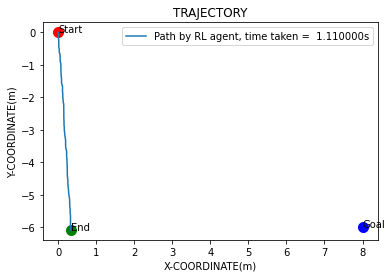

EP_REWARD:-178


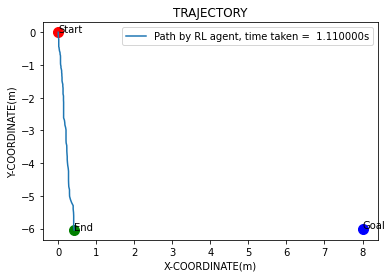

EP_REWARD:-178


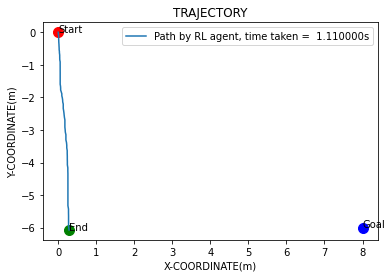

EP_REWARD:-178


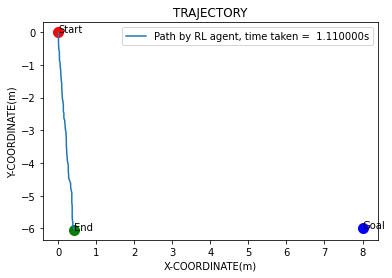

EP_REWARD:-178


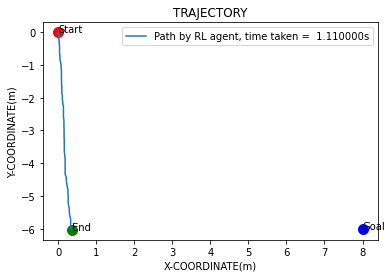

EP_REWARD:-178


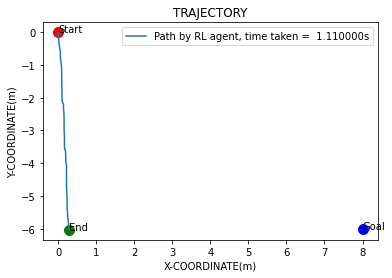

[ 6 -8]
EP_REWARD:0.0


C:\Users\Gianmarco Petrelli\AppData\Roaming\Python\Python39\site-packages\gym\spaces\box.py:73: UserWarning: WARN: Box bound precision lowered by casting to float32
  logger.warn(


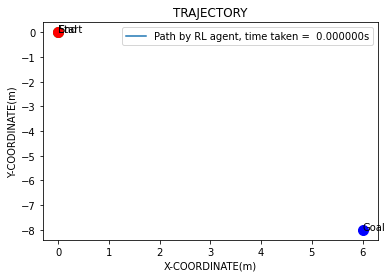

EP_REWARD:-38


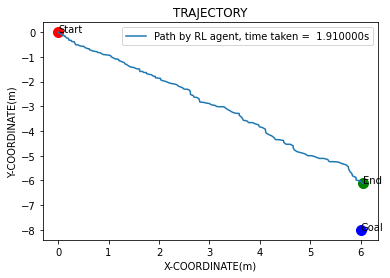

EP_REWARD:-34


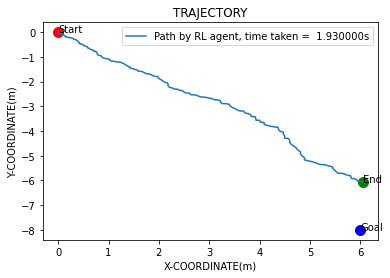

EP_REWARD:-36


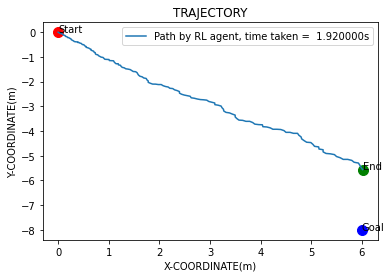

EP_REWARD:-26


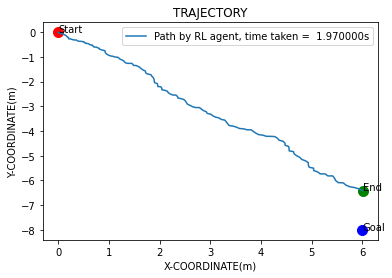

EP_REWARD:-44


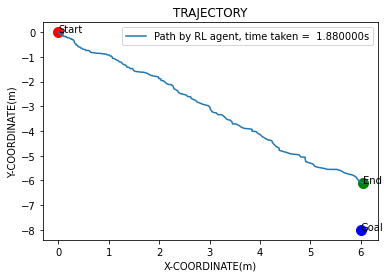

EP_REWARD:-124


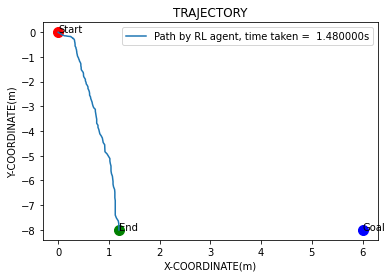

In [ ]:
"""MODEL TRAINING"""
TIMESTEPS=1000
""""""
env = Brachistochrone_Env()
print(env.target_pos)
#wrapping the environment to speed up training
env = make_vec_env(lambda: env, n_envs=1)

n_actions = env.action_space.shape[-1]
# this can help for hard exploration problem
action_noise = NormalActionNoise(mean = np.zeros(n_actions), 
                                sigma=0.2*np.ones(n_actions))

#using callback to actuate performance check improving periodically the model in a  "verify and save model" approach
eval_callback = EvalCallback(env, best_model_save_path='./saved_models/generalized2_3',
                             log_path='./logs/generalized2_3', eval_freq=5000,
                             deterministic=True, render=True)

#config. a dynamic learning rate
#sched_LR = LinearSchedule(TIMESTEPS, 0.001, 0.0000125)

#we keep "gamma" discount factor high to strengthen exploration 
model = DDPG('MlpPolicy', env =env, action_noise=action_noise, verbose=0,
            gamma= 0.9999, learning_starts = 1000,
             gradient_steps = -1, learning_rate=0.1,
            policy_kwargs= dict(net_arch=[400, 600, 400]), train_freq = (1, "episode"), tensorboard_log="./barchistostrone_ddpg_tensorboard/generalized2")

os.system('spd-say "your program has started"')


model.learn(total_timesteps=TIMESTEPS, log_interval=1, callback=eval_callback)


In [ ]:
def cycloid(P1,P2,N):
    """Return the path of Brachistochrone curve from (0,0) to (x2, y2).
    The Brachistochrone curve is the path down which a bead will fall without
    friction between two points in the least time (an arc of a cycloid).
    It is returned as an array of N values of (x,y) between (0,0) and (x2,y2).
    """

    # First find theta2 from (x2, y2) numerically (by Newton-Rapheson).
    f = lambda theta: -P2[1]/P2[0] - (1-np.cos(theta))/(theta-np.sin(theta))
    theta2 = newton(f, np.pi/2)

    # The radius of the circle generating the cycloid.
    R = -P2[1] / (1 - np.cos(theta2))

    theta = np.linspace(0, theta2, N)
    x = R * (theta - np.sin(theta))
    y = R * (1 - np.cos(theta))

    # The time of travel
    T = theta2 * np.sqrt(R / 9.8)
    return x, y, T

def rect(P1,P2,N):
    """Return the rectilinear straight path from (0,0) to (x2, y2)."""
    x_interval = np.linspace(P1[0],P2[0],N)
    m = float(P2[1] - P1[1])/(P2[0]-P1[0])
    q = P1[1] - (m*P1[0])
    f_y = lambda x: m*x+q
    y = [f_y(x) for x in x_interval]
    T_rett = math.sqrt(2*(P2[0]**2+P2[1]**2)/(-9.8*P2[1]))
    return x_interval,y,T_rett

In [ ]:
#building found optimal path
env = Brachistochrone_Env()
env = make_vec_env(lambda: env, n_envs=1)
model = DDPG.load("saved_models/generalized2_2/best_model", env=env)

"""SET GOAL"""
goal = (8.0, -6.0)
""""""""""""""""""

position= [] #list of tuples containing subsequent positions
x = [] # x steps
y = [] #y values associated
steps = 0
actions = []
observations = []
#BUILD SOLUTION
#print("Episode {}".format(ep + 1))
episodic_reward = []


#we have to force target into environment as it must be constant and specified to AI agent
obs = env.reset()
obs = env.env_method("reset_set_target",goal)
print("Inital obs: "  +str(obs))
while True:
    action= model.predict(obs, deterministic = False)
    #print("azione:",action)
    #print("prima",obs)
    obs, reward, done, info = env.step(action)
    observations.append(obs)
    #print("dopo",obs)
    new_value = obs[0] #the array from which to extract new piece of path information
    """new_value[1]: pos_x new_value[2]: pos_y"""
    position.append((new_value[1],new_value[2]))
    if done==False:
        x.append(new_value[1])
        y.append(new_value[2])
    episodic_reward.append(reward)
    actions.append(action)
    steps+=1
    #print('obs=', obs, 'reward=', reward, 'done=', done)
    if done:
        #print(env.get_attr("video"))
        #env.render()
        x.pop()
        y.pop()
        position.pop()
        print("Goal reached!", "episodic-reward=", np.sum(episodic_reward))
        print("Steps taken: " + str(steps))
        print("Time taken: " , steps/100)

        break
            


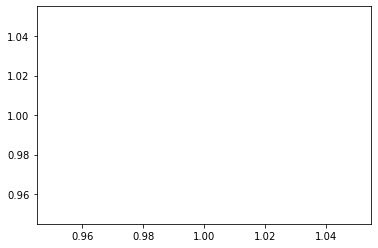

In [ ]:
"""execute this before plotting to avoid kernel dead"""
import matplotlib
import matplotlib.pyplot as plt
plt.plot(1,1)

Time taken by cycloid =  1.6071631124415775
Time taken by linear solution =  1.8442777839082938


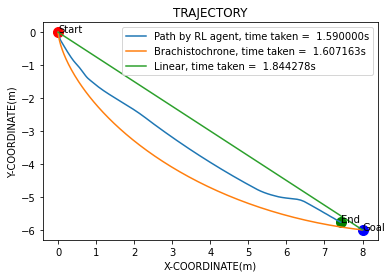

In [ ]:
#plot results
cycloid_x, cycloid_y, cycloid_T = cycloid((0,0), goal, steps)
rect_x, rect_y, rect_T = rect((0,0), goal, steps)
print('Time taken by cycloid = ', cycloid_T)
print('Time taken by linear solution = ', rect_T)

time_taken = steps/100
plt.plot(x,y , label = 'Path by RL agent, time taken =  %fs' %time_taken)
plt.plot(cycloid_x, -cycloid_y, label='Brachistochrone, time taken =  %fs' %cycloid_T)
plt.plot(rect_x, rect_y, label='Linear, time taken =  %fs' %rect_T)
plt.scatter(x[-1], y[-1], color = 'green', s = 100.0)
plt.scatter(x[0], y[0], color = 'red', s = 100.0)
plt.scatter(goal[0], goal[1], color = 'blue', s=100.0)
plt.annotate('Start', (x[0], y[0]))
plt.annotate('End', (x[-1], y[-1]))
plt.annotate('Goal', goal)
plt.legend()
plt.xlabel('X-COORDINATE(m)')
plt.ylabel('Y-COORDINATE(m)')
plt.title('TRAJECTORY')
plt.show()

In [ ]:
#further training

eval_callback = EvalCallback(env, best_model_save_path='./saved_models/final2/',
                             log_path='./logs/', eval_freq=5000,
                             deterministic=True, render=False)

model.learn(total_timesteps=400000, log_interval=1, callback=eval_callback)

In [ ]:
mu, sigma = 0, 10 # mean and standard deviation
s = np.random.normal(mu, sigma, 10000)
s

array([  7.59732866,  -1.46496075,  -8.07597509, ..., -24.01218154,
         4.53892451,  -5.67899005])

In [ ]:
t= (x for x in s if x >10)
next(t)

15.447989481354178

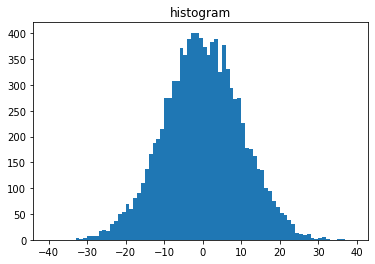

In [ ]:
bins = np.asarray([i / 10 for i in range(0, 11, 1)])
bins_idx = np.digitize(s, bins, right=False)
bin_count = np.bincount(bins_idx)
idx = np.cumsum(bin_count)
prob_bins = [s[idx[i]:idx[i + 1]] for i in range(len(idx) - 1)]
#prob_bins is an array of bins

plt.hist(s, bins = range(-40,40,1)) 
plt.title("histogram") 
plt.show()